# 'Plot_analysis,ipynb' is created by Yue on Feb 15, 2024 for ploting results about A1 and kappa.

Workflow:
1. Load u_star, A1, kappa, IST.
2. Plot an example of the log-linear fitting of u_avg and u_std.
3. Plot PDF of A1, kappa
4. Plot w_std profile
5. Plot A1 against fitting, IST_u, IST_wdir, IST_shear, H, Re.
6. Calculate Euu, Eww, Euw, Duu for the hours after filtering.

Notes:
1. input directory: /save_mask_data, /save_statistical_data, /save_fitted_data.
2. output directory: /save_fig. /save_spectrum_data.
3. fit_data_vars['var1D_uavg']['filt']: dict_keys(['u_star_mean', 'kappa_fit', 'u_star_fit', 'slope_uavg', 'intercept_uavg', 'r2_uavg', 'z0_fit'])
4. fit_data_vars['var2D_uavg']['filt']: dict_keys(['u_star_dev', 'u_star_diff'])
5. fit_data_vars['var1D_ustd']['filt']: dict_keys(['stability_parameter', 'kappa_corrected', 'A1_fit', 'slope_ustd', 'intercept_ustd', 'r2_ustd'])
6. fit_data_vars['var2D_ustd']['filt']: dict_keys(['wind_ang_convert', 'Re_plus', 'IST_u', 'IST_wdir', 'score_wstd', 'score_shear'])
7. 12 hours have very large P_avg (~1e22), so I got rid of them. There are 127 neutral cases left.

! Calculation of Structure function is very time consuming.

=========== Disable de-spike on Sep 14, 2024 and save data to /save_fig_091424,/save_spectrum_data_091424 =====

=========== Disable de-spike and do planar fit (by wind direction) on Oct 1, 2024 and save data to /save_fig_planarfit,/save_spectrum_data_planarfit =====

=========== Disable de-spike and do planar fit on Sep 19, 2024 and save data to /save_fig_092024,/save_spectrum_data_092024 =====

*** Add azimuth correction for each sensor on Oct 1, 2024 

=========== Disable de-spike and do double rotation on Oct 1, 2024 and save data to /save_processed_data_2rot =====

# Set up environment

In [1]:
# import packages
import warnings
warnings.filterwarnings('ignore')
import numpy as np
import pandas as pd
import matplotlib
import matplotlib.pyplot as plt
import os.path
import pickle
import time
from matplotlib.pyplot import figure
import scipy.io as sio
from datetime import date, timedelta
from math import *
from scipy.stats import gmean
from scipy import ndimage
from scipy import stats
from scipy import signal
from matplotlib.ticker import MaxNLocator
import seaborn as sns
import matplotlib.transforms as mtransforms
from matplotlib.lines import Line2D
from scipy.signal import butter,sosfiltfilt,filtfilt
from scipy import fftpack
from scipy.signal import welch, hann, stft
from scipy.interpolate import interp1d
from scipy.signal import savgol_filter
from scipy.signal import find_peaks
from numpy.polynomial import Polynomial
from sklearn.metrics import r2_score
import matplotlib.cm as cm
from matplotlib.colors import LinearSegmentedColormap, Normalize
from scipy import optimize

# Define parameters

In [2]:
# directories
IN_FIT_DIR = "/projectnb/urbanclimate/yueqin/idaho_ec_jupyter/save_fitted_data_091424/"
IN_STAT_DIR = "/projectnb/urbanclimate/yueqin/idaho_ec_jupyter/save_statistical_data_091424/"
IN_MSK_DIR = "/projectnb/urbanclimate/yueqin/idaho_ec_jupyter/save_mask_data_091424/"
IN_INS_DIR = "/projectnb/urbanclimate/yueqin/idaho_ec_jupyter/save_processed_data_091424/"

OUT_DIR = "/projectnb/urbanclimate/yueqin/idaho_ec_jupyter/save_spectrum_data_091424/"
OUT_PLOT_DIR = "/projectnb/urbanclimate/yueqin/idaho_ec_jupyter/save_fig_2rot/"

# List of directories to check
directories = [IN_FIT_DIR, IN_STAT_DIR, IN_MSK_DIR, IN_INS_DIR, OUT_DIR, OUT_PLOT_DIR]

# Check if directories exist, create them if they don't
for dir_path in directories:
    if not os.path.exists(dir_path):
        try:
            os.makedirs(dir_path)
            print(f"Created directory: {dir_path}")
        except Exception as e:
            print(f"An error occurred while creating directory {dir_path}: {e}")
    else:
        print(f"Directory exists: {dir_path}")

# labels
list_bot = np.array([0,1,2,3]) # bottom four levels
list_all = np.arange(0, 12, 1)
list_sel = np.array([5,6,7,8,9,10]) # from level 6 to level 11
# list_test1 = np.array([4,5,6,7,8,9,10,11])
# list_test2 = np.array([4,5,6,7,8,9,10])
# list_test3 = np.array([5,6,7,8,9,10,11])
ldg = np.array(["12.5","16.5","23","30","40","50"])
z_lbl = ["1.2","2","3.5","6","9","12.5","16.5","23","30","40","50","60"]

# global constants
sonum    =12                       # number of sonic
z  = np.array([1.2,2,3.5,6,9,12.5,16.5,23,30,40,50,60])  # height of sonic above ground, 
frequency=10                   # sampling rate, Hz
time_avg =3600                  # average time, s
rpat = time_avg*frequency           # number of lines for a loop
# Define azimuth angles for the sensors
azimuth_angles = [291.9, 298.2, 299.1, 300.8, 336.6, 337.9, 339.6, 339.6, 338.8, 337.2, 337.5, 340.3]

# physical constants (or values that are assumed constant)
Rw  = 461.5     # ideal gas constant for water vapor, J/kg*K
Rd  = 287.05    # ideal gas constant for dry air, J/kg*K
Lv  = 1000*2257 # latent heat of vaporization (water), J/kg
Cp  = 1005      # approximate constant pressure specific heat of air, J/kg*K
kappa_assumed = 0.4 # von karman constant
g   = 9.81      # acceleration of gravity, m/s^2
nu = 1.48 * 10**(-5) # kinematic viscosity, m2 /s
Ce=1.5 # Kolmogorov constants associated with the 3-dimensional wavenumber space.
Ck=18*Ce/55 # Kolmogorov constants for the 1-dimensional longitudinal velocity spectrum.
C2= 4.017*Ck
Ca = 0.1 # coefficient for delta estimation (vary from 0.1 in stable to 0.3 for unstable conditions)
# Constants
Omega = 7.2921e-5  # Earth's angular velocity in rad/s
# Latitude in degrees, minutes, seconds
latitude_deg = 43
latitude_min = 35
latitude_sec = 30

# Convert latitude to decimal degrees
latitude_decimal = latitude_deg + (latitude_min / 60) + (latitude_sec / 3600)

# Convert latitude to radians
latitude_rad = radians(latitude_decimal)

# Calculate Coriolis parameter
coriolis_param = 2 * Omega * sin(latitude_rad)

f_c = coriolis_param # Coriolis force, s-1

# input variables
in_avg = ['u_avg_ldtr', 'u_avg_filt', 'Rho_air', 'P_avg', 'stability_filt']
in_std = ['u_std_ldtr', 'u_std_filt','w_std_ldtr', 'w_std_filt']
in_flux = ['u_star_ldtr', 'H_ldtr','uw_ldtr', 'u_star_filt', 'H_filt','uw_filt']
in_other = ['n_hours', 'datetime_all', 'filter_size_all', 'wind_ang_all']
in_mask = ['mask_rnan', 'mask_dspk', 'mask_neutral', 'mask_wdir', 'mask_taylor',
           'mask_ustar_gt005', 'mask_H_gt10']
in_tur = ['u_tur_ldtr', 'w_tur_ldtr', 'u_tur_filt', 'w_tur_filt']

# input .pkl data
in_pkl = ['sel_level_u_avg_fitting_1Ddata.pkl','sel_level_u_avg_fitting_2Ddata.pkl', 
          'u_std_fitting_1Ddata.pkl','u_std_fitting_2Ddata.pkl']
in_pkl_names = ['var1D_uavg', 'var2D_uavg', 'var1D_ustd', 'var2D_ustd']

# plotting
font_size = 8
mark_size = 5
plt.rc('text', usetex=True)
# plt.rc('font', family='sans-serif')
plt.rcParams["font.family"] = "Times New Roman"
plt.rcParams["font.weight"] = "bold"
plt.rc('xtick', labelsize=font_size) 
plt.rc('ytick', labelsize=font_size)
# font_size = fnt
# ldg = np.array(['B2','B3','B4','A1','A2','A3'])
ldg = np.array(["12.5","16.5","23","30","40","50"])
# color_list=sns.color_palette("tab10")
# color_list= ['#d0d1e6','#a6bddb','#74a9cf','#3690c0','#0570b0','#034e7b']
color_list= ['#d9d9d9','#bdbdbd','#969696','#737373','#525252','#252525']
blue_color_list = ['#eff3ff','#c6dbef','#9ecae1','#6baed6','#3182bd','#08519c']

# Choose a colormap
cmap = cm.viridis
# Generate colors from the colormap
colors = [cmap(i/len(list_all)) for i in range(len(list_all))]

# Create a custom legend
custom_lines = [Line2D([0], [0], color="none", marker='o', markerfacecolor="none")]

Directory exists: /projectnb/urbanclimate/yueqin/idaho_ec_jupyter/save_fitted_data_091424/
Directory exists: /projectnb/urbanclimate/yueqin/idaho_ec_jupyter/save_statistical_data_091424/
Directory exists: /projectnb/urbanclimate/yueqin/idaho_ec_jupyter/save_mask_data_091424/
Directory exists: /projectnb/urbanclimate/yueqin/idaho_ec_jupyter/save_processed_data_091424/
Directory exists: /projectnb/urbanclimate/yueqin/idaho_ec_jupyter/save_spectrum_data_091424/
Directory exists: /projectnb/urbanclimate/yueqin/idaho_ec_jupyter/save_fig_2rot/


In [3]:
Ck,C2

(0.4909090909090909, 1.9719818181818183)

In [4]:
coriolis_param

0.00010056013140230234

# Load data

In [5]:
for var_name in in_avg+in_std+in_flux+in_other:
    globals()[var_name] = np.load(f"{IN_STAT_DIR}{var_name}.npy", allow_pickle=True)
for var_name in in_mask:
    globals()[var_name] = np.load(f"{IN_MSK_DIR}{var_name}.npy")
    
# Dictionary to hold the data with variable names as keys
fit_data_vars = {}

# Loop through each file and variable name
for file_name, var_name in zip(in_pkl, in_pkl_names):
    with open(IN_FIT_DIR+file_name, 'rb') as file:
        # Load the data from the file
        data = pickle.load(file)
        # Assign the loaded data to the corresponding variable name in the dictionary
        fit_data_vars[var_name] = data

In [6]:
fit_data_vars['var1D_ustd']['filt'].keys()

dict_keys(['stability_parameter', 'kappa_corrected', 'A1_fit', 'slope_ustd', 'intercept_ustd', 'r2_ustd', 'slope_wstd_ustar', 'r2_wstd'])

# Prepare necessary data

In [6]:
wind_ang_all.shape

(5040, 12)

In [7]:
Rho_air_mean = np.nanmean(Rho_air[:,list_sel],axis=1)
mask_rho = Rho_air_mean<1.25
# combine masks
mask = mask_rnan*mask_neutral*mask_wdir*mask_taylor*mask_rho
true_indices = np.where(mask)[0]
neutral_case = datetime_all[mask_rnan]
# wind_ang_neutral = wind_ang_all[mask]

# # convert the wind angles to range from -180 to 180
# wind_ang_converted = np.where(wind_ang_all > 180, wind_ang_all - 360, wind_ang_all)

# Correct the wind angles relative to true north
wind_ang_corrected = (wind_ang_all + azimuth_angles) % 360
wind_ang_corrected_converted = np.where(wind_ang_corrected > 180, wind_ang_corrected - 360, wind_ang_corrected)

sample_1d = fit_data_vars['var1D_ustd']['filt']
sample_2d = fit_data_vars['var2D_ustd']['filt']
sample_uavg_1d = fit_data_vars['var1D_uavg']['filt']
sample_uavg_2d = fit_data_vars['var2D_uavg']['filt']

A1_filt = sample_1d['A1_fit']
R2_A1_filt = sample_1d['r2_ustd']
kappa_filt = sample_uavg_1d['kappa_fit']
R2_kappa_filt = sample_uavg_1d['r2_uavg']
u_star_mean_filt = sample_uavg_1d['u_star_mean']
u_star_mean_ldtr = fit_data_vars['var1D_uavg']['ldtr']['u_star_mean']
u_star_dev_filt = sample_uavg_2d['u_star_dev']
u_star_dev_ldtr = fit_data_vars['var2D_uavg']['ldtr']['u_star_dev']

# Reshape u_star_mean_filt to (5040, 1) so it can broadcast with u_star_dev_filt (5040, 12)
u_star_mean_filt_reshaped = np.expand_dims(u_star_mean_filt, axis=1)
u_star_mean_ldtr_reshaped = np.expand_dims(u_star_mean_ldtr, axis=1)
# Now you can add them
u_star_filt = u_star_mean_filt_reshaped + u_star_dev_filt
u_star_ldtr = u_star_mean_ldtr_reshaped + u_star_dev_ldtr
# Define neutral mask based on geomean_median_stability parameter
mean_stability = np.nanmean(stability_filt,1)
geomean_median_stability = fit_data_vars['var1D_ustd']['filt']['stability_parameter']
mask_neutral_new = abs(geomean_median_stability)<=0.1
# Compute quality control variables
IST_u_filt = np.nanmean(sample_2d['IST_u'][:,list_sel],axis=1)
IST_wdir_filt = np.nanmean(sample_2d['IST_wdir'][:,list_sel],axis=1)
score_w_std_filt = np.nanmean(sample_2d['score_wstd'][:,list_sel],axis=1)
score_shear_wdir_filt = np.nanmean(sample_2d['score_shear_wdir'][:,list_sel],axis=1)
score_shear_wspd_filt = np.nanmean(sample_2d['score_shear_wspd'][:,list_sel],axis=1)
H_avg_filt = np.nanmean(H_filt[:,list_sel],axis=1)
Re_plus_mean_filt = np.nanmean(sample_2d['Re_plus'][:,list_sel],axis=1)

# Calculate delta~c_a*ustar/f
delta = Ca*u_star_mean_filt/f_c

# Calculate bulk Reynolds number based on the estimated delta
Re_b = delta*u_star_mean_filt/nu

# Calculate C1
C_1 = Ck*kappa_assumed**(-2/3)

# Estimate A1 based on Re-dependence (Katul et al., 2016)
A_1 = C_1*(1-3*kappa_assumed**(2/3)/Re_b**(1/2))
A_1_kappa = Ck*kappa_filt**(-2/3)*(1-3*kappa_filt**(2/3)/Re_b**(1/2))

# Define quality control filters
mask_r2 = R2_A1_filt>0.6
mask_ist_wspd = IST_u_filt<0.3
mask_re = Re_plus_mean_filt>1.5*10**6
mask_sigmaw = score_w_std_filt<0.02
mask_ISTwdir = IST_wdir_filt<15

In [8]:
Ck

0.4909090909090909

In [9]:
datetime_all[mask_rnan*mask_wdir*mask_taylor*mask_rho][50:200,:]

array([[datetime.date(2020, 9, 29), 2],
       [datetime.date(2020, 9, 29), 5],
       [datetime.date(2020, 9, 29), 6],
       [datetime.date(2020, 9, 29), 8],
       [datetime.date(2020, 9, 29), 9],
       [datetime.date(2020, 9, 29), 10],
       [datetime.date(2020, 9, 29), 15],
       [datetime.date(2020, 9, 29), 16],
       [datetime.date(2020, 9, 29), 17],
       [datetime.date(2020, 9, 29), 22],
       [datetime.date(2020, 9, 30), 1],
       [datetime.date(2020, 9, 30), 7],
       [datetime.date(2020, 9, 30), 8],
       [datetime.date(2020, 9, 30), 9],
       [datetime.date(2020, 9, 30), 16],
       [datetime.date(2020, 9, 30), 17],
       [datetime.date(2020, 10, 1), 2],
       [datetime.date(2020, 10, 1), 3],
       [datetime.date(2020, 10, 1), 5],
       [datetime.date(2020, 10, 1), 8],
       [datetime.date(2020, 10, 1), 9],
       [datetime.date(2020, 10, 1), 14],
       [datetime.date(2020, 10, 1), 15],
       [datetime.date(2020, 10, 1), 16],
       [datetime.date(2020, 10

In [10]:
np.sum(mask_re)

161

In [11]:
ustar_lim = 1.5*10**6*nu/gmean(z[list_sel])
print(f"ustar at Re=1500000: {ustar_lim:.2f}")

ustar at Re=1500000: 0.87


In [12]:
# original cases
np.sum(mask_rnan)

4788

In [13]:
# neutral cases
np.sum(mask_rnan*mask_neutral)

142

In [14]:
np.sum(mask_rnan*mask_neutral*mask_wdir)

139

In [15]:
np.sum(mask_rnan*mask_neutral*mask_wdir*mask_taylor)

134

In [15]:
np.sum(mask_rnan*mask_neutral*mask_wdir*mask_taylor*mask_rho)

120

# ****** Section 1 ******

# Plot u_star vertical deviation

In [10]:
u_star_dev_filt[mask][[0,1]]

array([[-0.06814762, -0.07874573,  0.0400572 ,  0.00100639, -0.13278199,
        -0.03584672, -0.05553758,  0.03551723,  0.04969884, -0.05592608,
         0.0620943 , -0.01115728],
       [-0.11036696, -0.06813455,  0.16088819,  0.10309344, -0.03525539,
        -0.01066208, -0.0188078 ,  0.01504333, -0.00400763, -0.02036697,
         0.03880116, -0.01172894]])

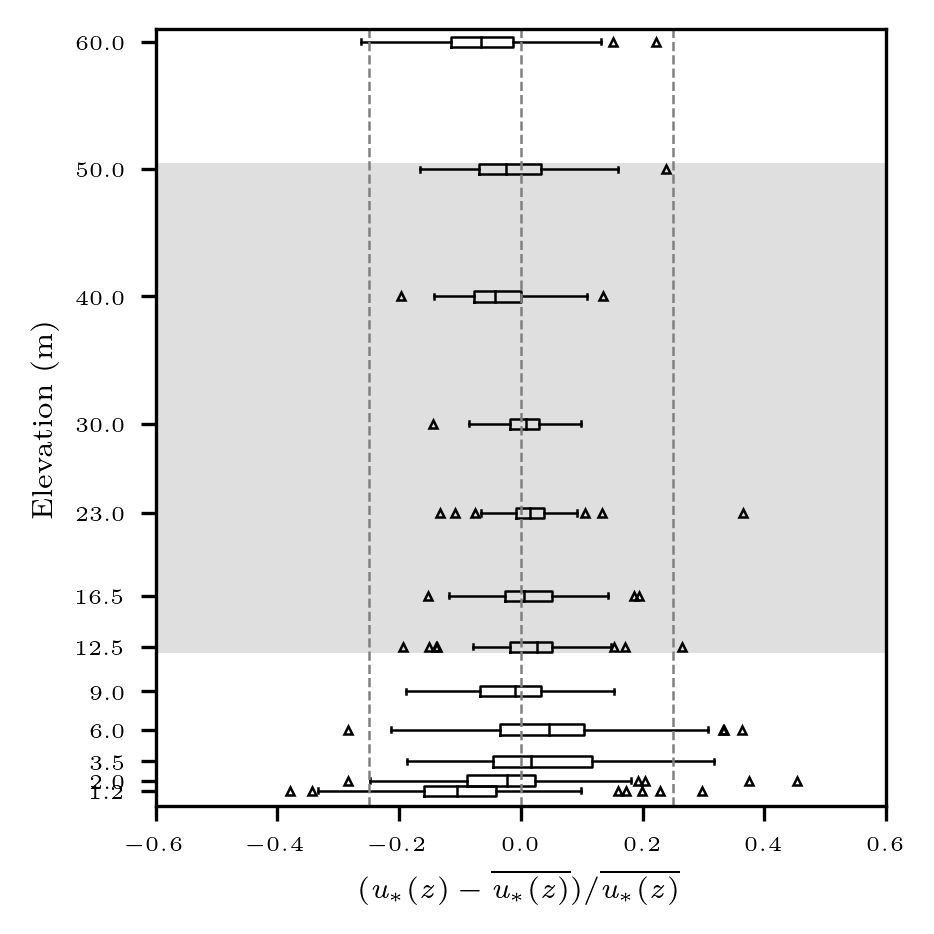

In [11]:
text_loc = [0.12, 0.88]
font_size = 5
mark_size = 2
line_width = 0.6
widths = 0.8
fig, axes = plt.subplot_mosaic([['a']], constrained_layout=True)
fig.set_size_inches(3,3)
fig.set_dpi(300)
# label physical distance in and down:
trans = mtransforms.ScaledTranslation(-20/72, 7/72, fig.dpi_scale_trans)

def plot_u_star_dev(fig_lbl,ax):
    medianprops = dict(linestyle='-', linewidth=widths, color='k')
    sample = u_star_dev_filt[mask]
    mask_ = ~np.isnan(sample) # Filter data using np.isnan
    filtered_data = [d[m] for d, m in zip(sample.T, mask_.T)]
    # filtered_data = np.array(filtered_data)
    box = ax.boxplot(filtered_data[:12],positions=z, vert=False, 
               widths=widths, medianprops=medianprops)
    # Decreasing the line width of the boxes
    for element in ['boxes', 'whiskers', 'means', 'medians', 'caps']:
        plt.setp(box[element], linewidth=line_width)
    # Specifically targeting the outliers ('fliers') to decrease their line width
    plt.setp(box['fliers'], marker='^', markersize=mark_size, markeredgewidth=line_width)  # Adjust markersize for visual preference
    # plt.setp(box['fliers'], marker='o')  # Example to change the marker style, optional
    # plt.setp(box['fliers'], linewidth=line_width-4)  # Adjusting the linewidth of the outlier markers
        
    ax.set_xlim(-0.6,0.6)
    ax.set_ylim(0,61)
    # plot reference lines
    ax.axvline(x=0, color='grey', linestyle='--', linewidth=line_width)
    ax.axvline(x=0.25, color='grey', linestyle='--', linewidth=line_width)
    ax.axvline(x=-0.25, color='grey', linestyle='--', linewidth=line_width)
    ax.axhspan(12, 50.5, facecolor='grey', alpha=0.25)

    ax.set_ylabel(r'Elevation (m)', fontsize=font_size+2)
    ax.set_xlabel(r'$\it (u_*(z)-\overline{u_*(z)})/\overline{u_*(z)}$', fontsize=font_size+2)
    
     # Adjust axis ticks
    ax.tick_params(axis='both', labelsize=font_size)
    
plot_u_star_dev('(a)',axes['a'])
# plt.savefig(OUT_PLOT_DIR+'u_star_dev.jpg',dpi=400, bbox_inches='tight')

# Filter size for high pass filtering

Text(0.5, 0, 'Filter size (s)')

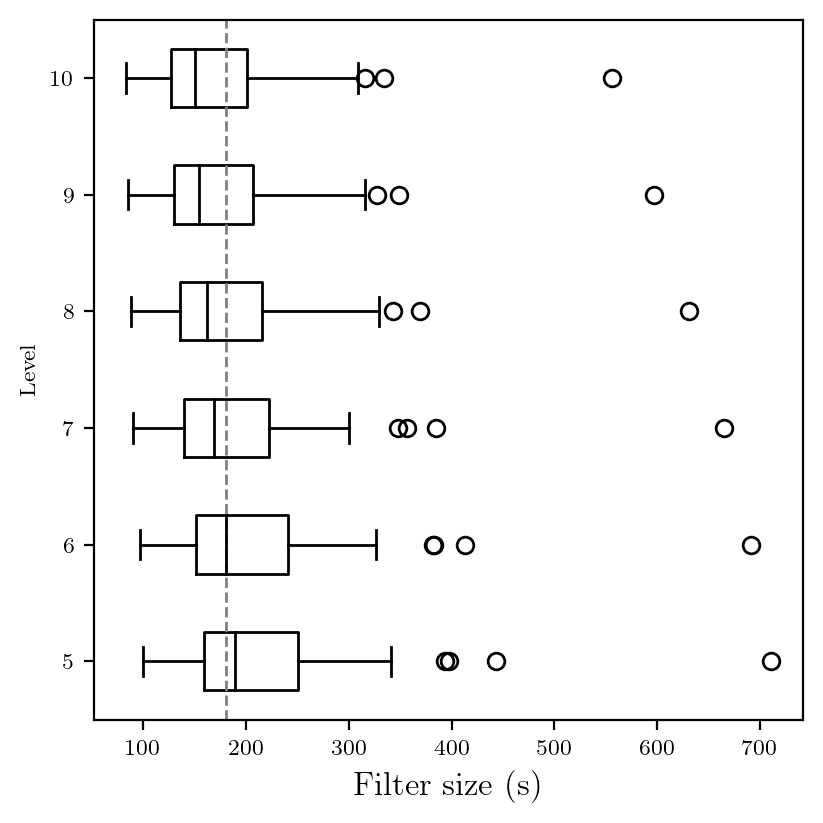

In [340]:
fig, axes = plt.subplot_mosaic([['a']], constrained_layout=True)
fig.set_size_inches(4, 4)
fig.set_dpi(200)
# label physical distance in and down:
trans = mtransforms.ScaledTranslation(-20/72, 7/72, fig.dpi_scale_trans)

# mask = ~np.isnan(filt_size_neutral) # Filter data using np.isnan
# filtered_data = [d[m] for d, m in zip(filt_size_neutral.T, mask.T)]
# new_filtered_data = np.array(filtered_data).T
# axes['a'].boxplot(new_filtered_data[[5,6,7,8,9,10]], vert=False)

# axes['a'].set_yticks(np.arange(1,7),['5','6','7','8','9','10'])
# axes['a'].axvline(x=180, color='grey', linestyle='--', linewidth=1)
# axes['a'].set_ylabel(r'\rm Level', fontsize=font_size)
# axes['a'].set_xlabel(r'Filter size (s)', fontsize=font_size+4)
# axes['a'].text(-0.05, 1, '(a)', transform=axes['a'].transAxes + trans,
#                 fontsize=14, va='bottom')
# axes['a'].set_xlim(0,500)

msk = ~np.isnan(filter_size_all[mask,:]) # Filter data using np.isnan
filtered_data = [d[m] for d, m in zip(filter_size_all[mask,:].T, msk.T)] # alreadly an array
# new_filtered_data = np.array(filtered_data).T
medianprops = dict(linestyle='-', linewidth=1, color='k')
axes['a'].boxplot(filtered_data[5:11], vert=False, 
                 medianprops=medianprops)
# axes['b'].set_xlim(50,0.6)
# # plot reference lines
axes['a'].axvline(x=180, color='grey', linestyle='--', linewidth=1)
axes['a'].set_yticks(np.arange(1,7),['5','6','7','8','9','10'])
axes['a'].set_ylabel(r'\rm Level', fontsize=font_size)
axes['a'].set_xlabel(r'Filter size (s)', fontsize=font_size+4)
# axes['b'].text(-0.05, 1, '(b)', transform=axes['b'].transAxes + trans,
#                 fontsize=14, va='bottom')
# plt.savefig(FIG_DIR + 'Filter_size.jpg', dpi=200)

# Plot log-linear fitting of u_avg and u_std of the first neutral case
1. subplot a,c: u_avg/u_star agianst log(z)
2. subplot b,d: u_std^2/u_star^2 against log(z)

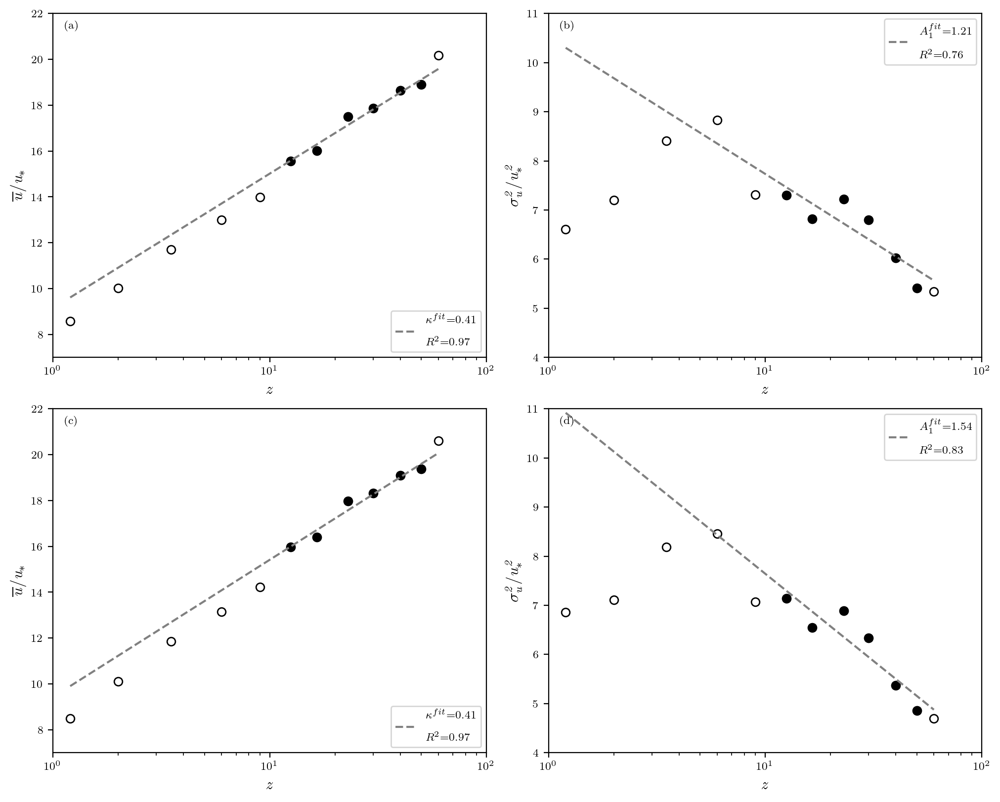

In [7]:
# Find the index of the neutral case
index = true_indices[0]
text_loc = [0.09, 0.92]
fig, axes = plt.subplot_mosaic([['a','b'],['c','d']], constrained_layout=True)
fig.set_size_inches(10,8)
fig.set_dpi(200)
# label physical distance in and down:
trans = mtransforms.ScaledTranslation(-20/72, 7/72, fig.dpi_scale_trans)

def plot_u_avg_prof(fig_lbl,ax,type_):
    """
    slope and intercept need to be normalized by u_star_mean to match up with the profile
    """
    sample = fit_data_vars['var1D_uavg'][type_]
    ax.plot(z[list_all], globals()[f"u_avg_{type_}"].T[list_all,index]/sample['u_star_mean'][index],
            'o',color = 'k',markerfacecolor='none')
    ax.plot(z[list_sel], globals()[f"u_avg_{type_}"].T[list_sel,index]/sample['u_star_mean'][index], 
            'o',color = 'k',markerfacecolor='k')
    
    # linear regression
    line = (sample['slope_uavg'][index]* np.log(z[list_all])+sample['intercept_uavg'][index])/sample['u_star_mean'][index]
    ax.plot(z[list_all], line,color='gray', linestyle='--', 
            label='$\kappa^{fit}$'+'={:.2f}'.format(1/sample['slope_uavg'][index])+'\n\n'+
             '$R^2$={:.2f}'.format(sample['r2_uavg'][index]))
    ax.legend(fontsize=font_size,loc='lower right')
    
    # semilog scale
    ax.set_xscale('log')
    ax.set_xlabel(r'$\it z$',fontsize=font_size+4)
    ax.set_ylabel(r'$\it \overline{u}/u_*$',fontsize=font_size+4)
    ax.text(text_loc[0], text_loc[1], fig_lbl, transform=ax.transAxes + trans,
                fontsize=font_size, va='bottom')
    ax.set_xlim(1,100)
    ax.set_ylim(7,22)
    
def plot_u_std_prof(fig_lbl,ax,type_):
    sample1 = fit_data_vars['var1D_uavg'][type_]
    sample2 = fit_data_vars['var1D_ustd'][type_]
    u_std_plus = globals()[f"u_std_{type_}"][index,:]**2/sample1['u_star_mean'][index]**2
    ax.plot(z[list_all],u_std_plus.T[list_all],'o',color = 'k',markerfacecolor='none')
    ax.plot(z[list_sel],u_std_plus.T[list_sel],'o',color = 'k',markerfacecolor='k')
    
    # linear regression
    line = (-sample2['A1_fit'][index])* np.log(z[list_all])+sample2['intercept_ustd'][index]
    ax.plot(z[list_all], line,color='gray', linestyle='--', 
            label=r'$A_1^{fit}$'+'={:.2f}'.format(sample2['A1_fit'][index])+'\n\n'+
             '$R^2$={:.2f}'.format(sample2['r2_ustd'][index]))
    ax.legend(fontsize=font_size)
    # semilog scale
    ax.set_xscale('log')
    ax.set_xlabel(r'$\it z$',fontsize=font_size+4)
    ax.set_ylabel(r'$\it \sigma_u^2/u_*^2$',fontsize=font_size+4)
    ax.text(text_loc[0], text_loc[1], fig_lbl, transform=ax.transAxes + trans,
                fontsize=font_size, va='bottom')
    ax.set_xlim(1,100)
    ax.set_ylim(4,11)

plot_u_avg_prof('(a)',axes['a'],'ldtr')
plot_u_avg_prof('(c)',axes['c'],'filt')
plot_u_std_prof('(b)',axes['b'],'ldtr')
plot_u_std_prof('(d)',axes['d'],'filt')

## combine two profiles

Index: 15


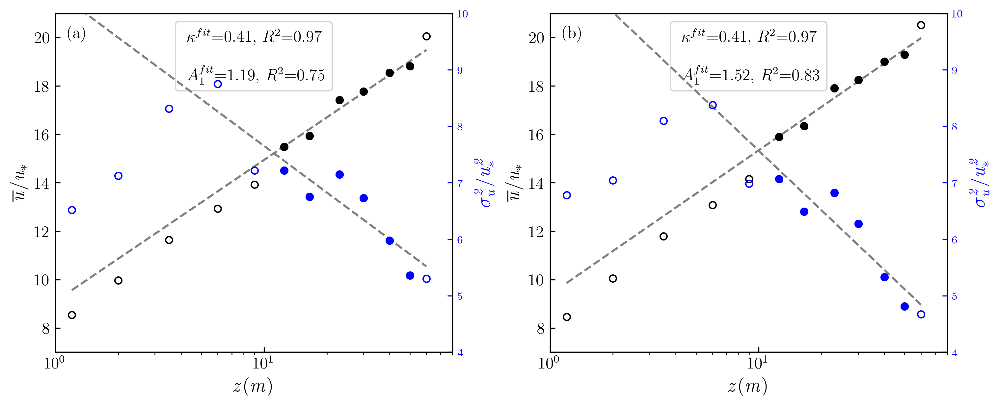

In [342]:
# Find the index of a desired neutral case
# index = true_indices[6]
# print(datetime_all[index])
# Target date and hour
target_date = date(2020, 9, 25)
target_hour = 15

# Find the index where both date and hour match
index = np.where((datetime_all[:, 0] == target_date) & (datetime_all[:, 1] == target_hour))[0][0]

print("Index:", index)
text_loc = [0.1, 0.9]
font_size = 12
mark_size = 5

fig, axes = plt.subplot_mosaic([['a','b']], constrained_layout=True)
fig.set_size_inches(10,4)
fig.set_dpi(300)
# label physical distance in and down:
trans = mtransforms.ScaledTranslation(-20/72, 7/72, fig.dpi_scale_trans)

def plot_u_avg_u_std_prof(fig_lbl,ax,type_):
    """
    slope and intercept need to be normalized by u_star_mean to match up with the profile
    """
    sample1 = fit_data_vars['var1D_uavg'][type_]
    sample2 = fit_data_vars['var1D_ustd'][type_]
    # plot u_avg
    ax.plot(z[list_all], globals()[f"u_avg_{type_}"].T[list_all,index]/sample1['u_star_mean'][index],
            'o',color = 'k',markerfacecolor='none', markersize=mark_size)
    ax.plot(z[list_sel], globals()[f"u_avg_{type_}"].T[list_sel,index]/sample1['u_star_mean'][index], 
            'o',color = 'k',markerfacecolor='k', markersize=mark_size)
    
    # plot u_std
    u_std_plus = globals()[f"u_std_{type_}"][index,:]**2/sample1['u_star_mean'][index]**2
    # ax.plot(z[list_all],u_std_plus.T[list_all],'o',color = 'blue',markerfacecolor='none')
    # ax.plot(z[list_sel],u_std_plus.T[list_sel],'o',color = 'blue',markerfacecolor='blue')
    
    # Create a second y-axis that shares the same x-axis
    ax2 = ax.twinx()
    ax2.plot(z[list_all],u_std_plus.T[list_all],'o',color = 'blue', 
             markerfacecolor='none', markersize=mark_size)  # Plotting on the secondary y-axis
    ax2.plot(z[list_sel],u_std_plus.T[list_sel],'o',color = 'blue',markerfacecolor='blue', markersize=mark_size)
    
    
    # linear regression
    line = (sample1['slope_uavg'][index]* np.log(z[list_all])+sample1['intercept_uavg'][index])/sample1['u_star_mean'][index]
    ax.plot(z[list_all], line,color='gray', linestyle='--', zorder=1)
    line = (-sample2['A1_fit'][index])* np.log(z[list_all])+sample2['intercept_ustd'][index]
    ax2.plot(z[list_all], line,color='gray', linestyle='--', zorder=1)
    
    # ax.legend(fontsize=font_size,loc='lower right')
    info = [r'$\kappa^{fit}$'+'={:.2f}'.format(1/sample1['slope_uavg'][index])+', '+ 
            r'$R^2$={:.2f}'.format(sample1['r2_uavg'][index])+'\n\n'+ 
            r'$A_1^{fit}$'+'={:.2f}'.format(sample2['A1_fit'][index]) +', '+ 
            r'$R^2$={:.2f}'.format(sample2['r2_ustd'][index])]
    ax.legend(custom_lines, info, fontsize=font_size, handlelength=-0.5, loc = 'upper center')
    
    # semilog scale
    ax.set_xscale('log')
    ax.set_xlabel(r'$\it z (m)$',fontsize=font_size+2)
    ax2.set_ylabel(r'$\it \sigma_u^2/u_*^2$',fontsize=font_size+2, color='blue')  # Set the color of the y2 label to blue
    ax.set_ylabel(r'$\it \overline{u}/u_*$',fontsize=font_size+2)
    ax2.text(text_loc[0], text_loc[1], fig_lbl, transform=ax.transAxes + trans,
            fontsize=font_size, zorder=2, 
            bbox={'facecolor': 'white', 'edgecolor': 'none', 'pad': 1})
    ax.set_xlim(1,80)
    ax.set_ylim(7,21)
    ax2.set_ylim(4,10)
    
    # Adjust secondary y-axis ticks to point inward
    ax2.tick_params(axis='y', direction='in', color='blue', labelcolor='blue')

    # Adjust x-axis ticks to point inward
    ax.tick_params(axis='x', direction='in', labelsize=font_size)
    ax.tick_params(axis='y', direction='in', labelsize=font_size)
    
plot_u_avg_u_std_prof('(a)',axes['a'],'ldtr')
plot_u_avg_u_std_prof('(b)',axes['b'],'filt')

# Adjust spacing
fig.subplots_adjust(wspace=0.35)  # Adjust the width space between subplots

# plt.savefig(OUT_PLOT_DIR+'u_avg_u_std_profile_ldtr_filt_20200925_1500.jpg',dpi=400, bbox_inches='tight')

## Combine u,u_std,w_std

Index: 15


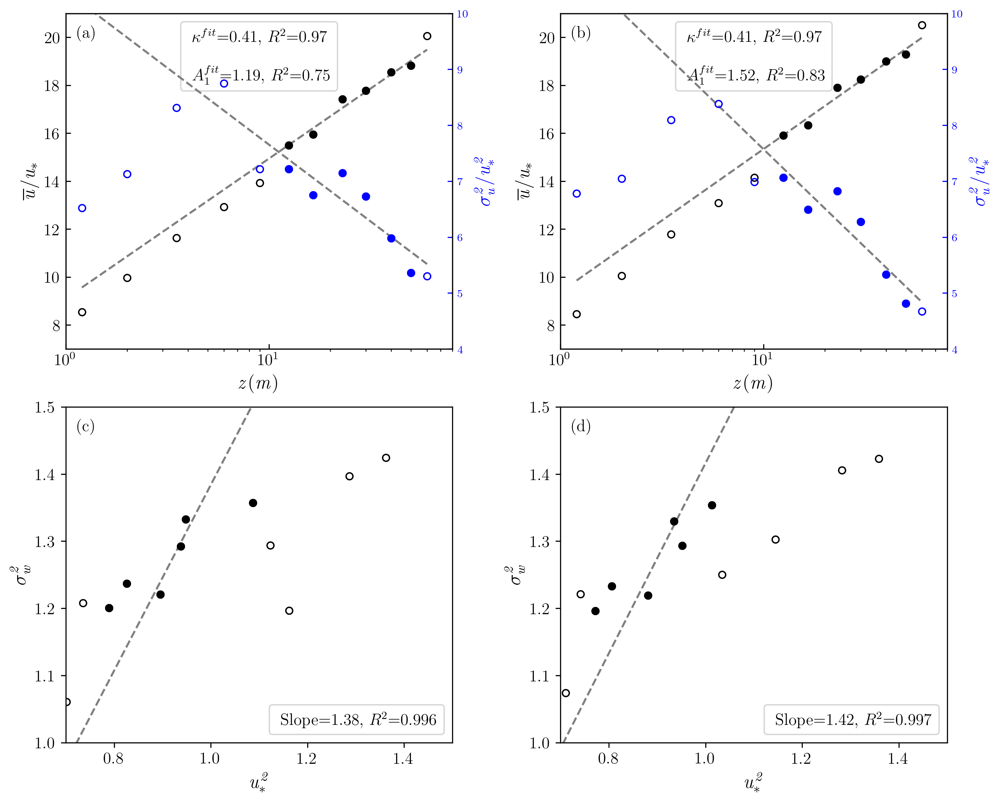

In [343]:
# Find the index of a desired neutral case
# index = true_indices[6]
# print(datetime_all[index])
# Target date and hour
target_date = date(2020, 9, 25)
target_hour = 15

# Find the index where both date and hour match
index = np.where((datetime_all[:, 0] == target_date) & (datetime_all[:, 1] == target_hour))[0][0]

print("Index:", index)
text_loc = [0.1, 0.9]
font_size = 12
mark_size = 5

fig, axes = plt.subplot_mosaic([['a','b'],['c','d']], constrained_layout=True)
fig.set_size_inches(10,8)
fig.set_dpi(300)
# label physical distance in and down:
trans = mtransforms.ScaledTranslation(-20/72, 7/72, fig.dpi_scale_trans)

def plot_u_avg_u_std_prof(fig_lbl,ax,type_):
    """
    slope and intercept need to be normalized by u_star_mean to match up with the profile
    """
    sample1 = fit_data_vars['var1D_uavg'][type_]
    sample2 = fit_data_vars['var1D_ustd'][type_]
    # plot u_avg
    ax.plot(z[list_all], globals()[f"u_avg_{type_}"].T[list_all,index]/sample1['u_star_mean'][index],
            'o',color = 'k',markerfacecolor='none', markersize=mark_size)
    ax.plot(z[list_sel], globals()[f"u_avg_{type_}"].T[list_sel,index]/sample1['u_star_mean'][index], 
            'o',color = 'k',markerfacecolor='k', markersize=mark_size)
    
    # plot u_std
    u_std_plus = globals()[f"u_std_{type_}"][index,:]**2/sample1['u_star_mean'][index]**2
    # ax.plot(z[list_all],u_std_plus.T[list_all],'o',color = 'blue',markerfacecolor='none')
    # ax.plot(z[list_sel],u_std_plus.T[list_sel],'o',color = 'blue',markerfacecolor='blue')
    
    # Create a second y-axis that shares the same x-axis
    ax2 = ax.twinx()
    ax2.plot(z[list_all],u_std_plus.T[list_all],'o',color = 'blue', 
             markerfacecolor='none', markersize=mark_size)  # Plotting on the secondary y-axis
    ax2.plot(z[list_sel],u_std_plus.T[list_sel],'o',color = 'blue',markerfacecolor='blue', markersize=mark_size)
    
    # linear regression
    line = (sample1['slope_uavg'][index]* np.log(z[list_all])+sample1['intercept_uavg'][index])/sample1['u_star_mean'][index]
    ax.plot(z[list_all], line,color='gray', linestyle='--', zorder=1)
    line = (-sample2['A1_fit'][index])* np.log(z[list_all])+sample2['intercept_ustd'][index]
    ax2.plot(z[list_all], line,color='gray', linestyle='--', zorder=1)
    
    # ax.legend(fontsize=font_size,loc='lower right')
    info = [r'$\kappa^{fit}$'+'={:.2f}'.format(1/sample1['slope_uavg'][index])+', '+ 
            r'$R^2$={:.2f}'.format(sample1['r2_uavg'][index])+'\n\n'+ 
            r'$A_1^{fit}$'+'={:.2f}'.format(sample2['A1_fit'][index]) +', '+ 
            r'$R^2$={:.2f}'.format(sample2['r2_ustd'][index])]
    ax.legend(custom_lines, info, fontsize=font_size, handlelength=-0.5, loc = 'upper center')
    
    # semilog scale
    ax.set_xscale('log')
    ax.set_xlabel(r'$\it z (m)$',fontsize=font_size+2)
    ax2.set_ylabel(r'$\it \sigma_u^2/u_*^2$',fontsize=font_size+2, color='blue')  # Set the color of the y2 label to blue
    ax.set_ylabel(r'$\it \overline{u}/u_*$',fontsize=font_size+2)
    ax2.text(text_loc[0], text_loc[1], fig_lbl, transform=ax.transAxes + trans,
            fontsize=font_size, zorder=2, 
            bbox={'facecolor': 'white', 'edgecolor': 'none', 'pad': 1})
    ax.set_xlim(1,80)
    ax.set_ylim(7,21)
    ax2.set_ylim(4,10)
    
    # Adjust secondary y-axis ticks to point inward
    ax2.tick_params(axis='y', direction='in', color='blue', labelcolor='blue')

    # Adjust x-axis ticks to point inward
    ax.tick_params(axis='x', direction='in', labelsize=font_size)
    ax.tick_params(axis='y', direction='in', labelsize=font_size)
    
plot_u_avg_u_std_prof('(a)',axes['a'],'ldtr')
plot_u_avg_u_std_prof('(b)',axes['b'],'filt')

def plot_w_std_u_star(fig_lbl, ax, type_):
    """
    Plot w_std^2 against u_star^2, fit a line through the origin, and calculate R^2.
    """
    u_star_temp = globals()[f"u_star_{type_}"][index, :]
    w_std_temp = globals()[f"w_std_{type_}"][index, :]

    # Square the values for fitting and plotting
    u_star_squared_all = u_star_temp[list_all]**2
    w_std_squared_all = w_std_temp[list_all]**2
    u_star_squared_sel = u_star_temp[list_sel]**2
    w_std_squared_sel = w_std_temp[list_sel]**2
    
    # Plot the data points
    ax.plot(u_star_squared_all, w_std_squared_all, 
            'o', color='k', markerfacecolor='none', markersize=mark_size)
    ax.plot(u_star_squared_sel, w_std_squared_sel, 
            'o', color='k', markerfacecolor='k', markersize=mark_size)

    # Perform linear regression through the origin
    if len(u_star_squared_sel) > 0 and len(w_std_squared_sel) > 0:
        # Reshape the data for np.linalg.lstsq
        u_star_squared_reshaped = u_star_squared_sel[:, np.newaxis]
        slope, _, _, _ = np.linalg.lstsq(u_star_squared_reshaped, w_std_squared_sel, rcond=None)

        # Calculate predicted values based on the fitted slope
        w_std_pred = u_star_squared_sel * slope[0]
        
        # Calculate R^2
        ss_tot = np.sum((w_std_squared_sel) ** 2)
        ss_res = np.sum((w_std_squared_sel - w_std_pred) ** 2)
        R2 = 1 - (ss_res / ss_tot)

        # Generate x-values for the fitted line, covering the range of the data
        x_fit = np.linspace(0, max(u_star_squared_all), 50)
        y_fit = slope[0] * x_fit  # Line equation with slope through the origin
        
        # Plot the fitted line
        ax.plot(x_fit, y_fit,
                color='gray', linestyle='--', zorder=1, label=f'Fit: y = {slope[0]:.2f}x, $R^2$ = {R2:.3f}')

    # Adjust x-axis ticks to point inward
    ax.tick_params(axis='both', labelsize=font_size)
    ax.set_xlabel(r'$\it u_*^2 $', fontsize=font_size+2)
    ax.set_ylabel(r'$\it \sigma_w^2 $', fontsize=font_size+2)
    ax.set_xlim(0.7,1.5)
    ax.set_ylim(1,1.5)
    info = [r'Slope'+'={:.2f}'.format(slope[0])+', '+ 
            r'$R^2$={:.3f}'.format(R2) 
            ]
    ax.legend(custom_lines, info, fontsize=font_size, handlelength=-0.5, loc = 'lower right')
    ax.text(text_loc[0], text_loc[1], fig_lbl, transform=ax.transAxes + trans,
            fontsize=font_size, zorder=2, 
            bbox={'facecolor': 'white', 'edgecolor': 'none', 'pad': 1})

plot_w_std_u_star('(c)',axes['c'],'ldtr')
plot_w_std_u_star('(d)',axes['d'],'filt')

# Adjust spacing
fig.subplots_adjust(wspace=0.35)  # Adjust the width space between subplots

plt.savefig(OUT_PLOT_DIR+'u_avg_u_std_w_std_ldtr_filt_20200925_1500.jpg',dpi=400, bbox_inches='tight')

## Example

Index: 15


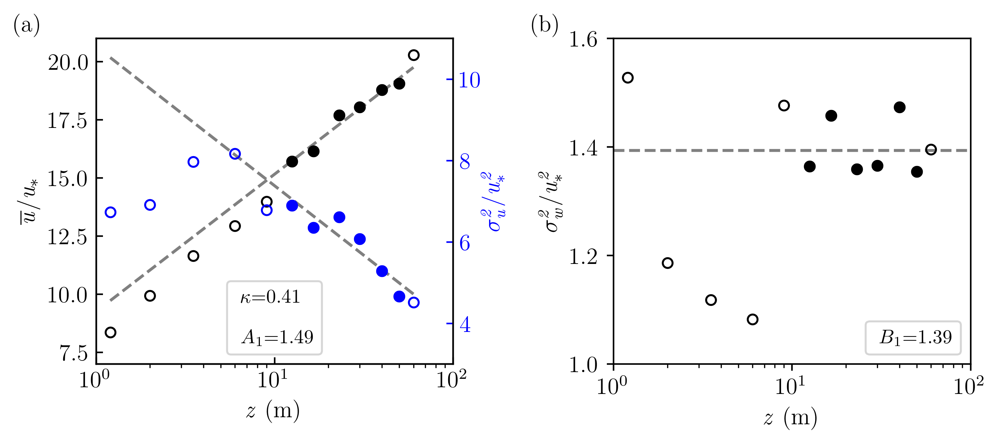

In [155]:
# Find the index of a desired neutral case
# index = true_indices[6]
# print(datetime_all[index])
# Target date and hour
target_date = date(2020, 9, 25)
target_hour = 15

# Find the index where both date and hour match
index = np.where((datetime_all[:, 0] == target_date) & (datetime_all[:, 1] == target_hour))[0][0]

print("Index:", index)
text_loc = [-0.12, 0.98]
font_size = 12
mark_size = 5

fig, axes = plt.subplot_mosaic([['a','b']], constrained_layout=False)
fig.set_size_inches(8,3)
fig.set_dpi(400)
# label physical distance in and down:
trans = mtransforms.ScaledTranslation(-20/72, 7/72, fig.dpi_scale_trans)

def plot_u_avg_u_std_prof(fig_lbl,ax,type_):
    """
    slope and intercept need to be normalized by u_star_mean to match up with the profile
    """
    sample1 = fit_data_vars['var1D_uavg'][type_]
    sample2 = fit_data_vars['var1D_ustd'][type_]
    # plot u_avg
    ax.plot(z[list_all], globals()[f"u_avg_{type_}"].T[list_all,index]/sample1['u_star_mean'][index],
            'o',color = 'k',markerfacecolor='none', markersize=mark_size)
    ax.plot(z[list_sel], globals()[f"u_avg_{type_}"].T[list_sel,index]/sample1['u_star_mean'][index], 
            'o',color = 'k',markerfacecolor='k', markersize=mark_size)
    
    # plot u_std
    u_std_plus = globals()[f"u_std_{type_}"][index,:]**2/sample1['u_star_mean'][index]**2
    # ax.plot(z[list_all],u_std_plus.T[list_all],'o',color = 'blue',markerfacecolor='none')
    # ax.plot(z[list_sel],u_std_plus.T[list_sel],'o',color = 'blue',markerfacecolor='blue')
    
    # Create a second y-axis that shares the same x-axis
    ax2 = ax.twinx()
    ax2.plot(z[list_all],u_std_plus.T[list_all],'o',color = 'blue', 
             markerfacecolor='none', markersize=mark_size)  # Plotting on the secondary y-axis
    ax2.plot(z[list_sel],u_std_plus.T[list_sel],'o',color = 'blue',markerfacecolor='blue', markersize=mark_size)
    
    # linear regression
    line = (sample1['slope_uavg'][index]* np.log(z[list_all])+sample1['intercept_uavg'][index])/sample1['u_star_mean'][index]
    ax.plot(z[list_all], line,color='gray', linestyle='--', zorder=1)
    line = (-sample2['A1_fit'][index])* np.log(z[list_all])+sample2['intercept_ustd'][index]
    ax2.plot(z[list_all], line,color='gray', linestyle='--', zorder=1)
    
    # ax.legend(fontsize=font_size,loc='lower right')
    info = [r'$\kappa$'+'={:.2f}'.format(1/sample1['slope_uavg'][index])
            # +', '+ 
            # r'$R^2$={:.2f}'.format(sample1['r2_uavg'][index])
            +'\n\n'+ 
            r'$A_1$'+'={:.2f}'.format(sample2['A1_fit'][index])
            # +', '+ 
            # r'$R^2$={:.2f}'.format(sample2['r2_ustd'][index])
           ]
    ax.legend(custom_lines, info, fontsize=font_size-2, handlelength=-0.5, loc = 'lower center')
    
    # semilog scale
    ax.set_xscale('log')
    ax.set_xlabel(r'$\it z$ (m)',fontsize=font_size)
    ax2.set_ylabel(r'$\it \sigma_u^2/u_*^2$',fontsize=font_size, color='blue', labelpad=-1)  # Set the color of the y2 label to blue
    ax.set_ylabel(r'$\it \overline{u}/u_*$',fontsize=font_size)
    ax2.text(text_loc[0], text_loc[1], fig_lbl, transform=ax.transAxes + trans,
            fontsize=font_size, zorder=2, 
            bbox={'facecolor': 'white', 'edgecolor': 'none', 'pad': 1})
    ax.set_xlim(1,100)
    ax.set_ylim(7,21)
    ax2.set_ylim(3,11)
    
    # Adjust secondary y-axis ticks to point inward
    ax2.tick_params(axis='y', direction='in', color='blue', labelcolor='blue', 
                    labelsize=font_size)

    # Adjust x-axis ticks to point inward
    ax.tick_params(axis='x', direction='in', labelsize=font_size)
    ax.tick_params(axis='y', direction='in', labelsize=font_size)
    
plot_u_avg_u_std_prof('(a)',axes['a'],'filt')
# plot_u_avg_u_std_prof('(b)',axes['b'],'filt')

def plot_w_std_prof(fig_lbl,ax, type_):
    sample2 = fit_data_vars['var1D_ustd'][type_]
    # plot w_std
    u_star_temp = globals()[f"u_star_{type_}"][index, :]
    w_std_temp = globals()[f"w_std_{type_}"][index, :]
    u_star_squared_all = u_star_temp[list_all]**2
    w_std_squared_all = w_std_temp[list_all]**2
    u_star_squared_sel = u_star_temp[list_sel]**2
    w_std_squared_sel = w_std_temp[list_sel]**2
    
    ax.plot(z[list_all], w_std_squared_all/u_star_squared_all,'o',color = 'k',markerfacecolor='none', markersize=mark_size)
    ax.plot(z[list_sel], w_std_squared_sel/u_star_squared_sel,
             'o',color = 'k',markerfacecolor='k', markersize=mark_size)
    
    # semilog scale
    ax.set_xscale('log')
    ax.set_xlabel(r'$\it z$ (m)',fontsize=font_size)
    ax.set_ylabel(r'$\it \sigma_w^2/u_*^2$',fontsize=font_size)
    ax.set_xlim(1, 100)
    ax.set_ylim(1, 1.6)
    ax.tick_params(axis='both', labelsize=font_size)
    # Adjust x-axis ticks to point inward
    # ax_.tick_params(axis='x', direction='in',labelsize=font_size)
    # ax_.tick_params(axis='y', direction='in',labelsize=font_size)
    ax.text(text_loc[0], text_loc[1], fig_lbl, transform=ax.transAxes + trans,
            fontsize=font_size, zorder=2, 
            bbox={'facecolor': 'white', 'edgecolor': 'none', 'pad': 1})
    # plot reference line (sigma_w/u*)^2=1.78 Kunkel2006
    ax.axhline(sample2['slope_wstd_ustar'][index],linestyle='--',color='gray', zorder=1)
    info = [r'$B_1$'+'={:.2f}'.format(sample2['slope_wstd_ustar'][index])
            # +', '+ 
            # r'$R^2$={:.2f}'.format(sample2['r2_wstd'][index])
           ]
    ax.legend(custom_lines, info, fontsize=font_size-2, handlelength=-0.5, loc = 'lower right')

plot_w_std_prof('(b)',axes['b'],'filt')

# Adjust spacing
fig.subplots_adjust(wspace=0.45)  # Adjust the width space between subplots

plt.savefig(OUT_PLOT_DIR+'u_avg_u_std_w_std_filt_20200925_1500.jpg',dpi=400, bbox_inches='tight')

In [99]:
OUT_PLOT_DIR

'/projectnb/urbanclimate/yueqin/idaho_ec_jupyter/save_fig_2rot/'

# *** Statistics of two detrending methods

In [345]:
for var in fit_data_vars['var1D_ustd']['filt']:
    print(var)

stability_parameter
kappa_corrected
A1_fit
slope_ustd
intercept_ustd
r2_ustd
slope_wstd_ustar
r2_wstd


## A1

In [346]:
sample1 = fit_data_vars['var1D_ustd']['ldtr']
sample2 = fit_data_vars['var1D_ustd']['filt']

print('Liner dtr: A1:mean={:.2f}, std={:.2f}'.format(np.nanmean(sample1['A1_fit'][mask]), np.nanstd(sample1['A1_fit'][mask])))
print('Liner dtr: R2:mean={:.2f}, std={:.2f}'.format(np.nanmean(sample1['r2_ustd'][mask]), np.nanstd(sample1['r2_ustd'][mask])))
print('Hipass filt: A1:mean={:.2f}, std={:.2f}'.format(np.nanmean(sample2['A1_fit'][mask]), np.nanstd(sample2['A1_fit'][mask])))
print('Hipass filt: R2:mean={:.2f}, std={:.2f}'.format(np.nanmean(sample2['r2_ustd'][mask]), np.nanstd(sample2['r2_ustd'][mask])))

# Assuming sample2['stability_parameter'][mask] is already defined
data = sample1['A1_fit'][mask]

# Total number of values
total_values = len(data)

# Number of negative values
negative_values = np.sum(data < 0)

# Percentage of negative values
percentage_negative = (negative_values / total_values) * 100

print(f"Ldtr Percentage of Negative Values: {percentage_negative:.2f}%")

data = sample2['A1_fit'][mask]

# Total number of values
total_values = len(data)

# Number of negative values
negative_values = np.sum(data < 0)

# Percentage of negative values
percentage_negative = (negative_values / total_values) * 100

print(f"Filt Percentage of Negative Values: {percentage_negative:.2f}%")

Liner dtr: A1:mean=0.33, std=1.24
Liner dtr: R2:mean=0.61, std=0.33
Hipass filt: A1:mean=1.15, std=0.82
Hipass filt: R2:mean=0.77, std=0.24
Ldtr Percentage of Negative Values: 31.63%
Filt Percentage of Negative Values: 9.18%


## kappa

In [347]:
sample1 = fit_data_vars['var1D_uavg']['ldtr']
sample2 = fit_data_vars['var1D_uavg']['filt']

print('Liner dtr: kappa:mean={:.2f}, std={:.2f}'.format(np.nanmean(sample1['kappa_fit'][mask]), np.nanstd(sample1['kappa_fit'][mask])))
print('Liner dtr: R2:mean={:.2f}, std={:.2f}'.format(np.nanmean(sample1['r2_uavg'][mask]), np.nanstd(sample1['r2_uavg'][mask])))
print('Hipass filt: kappa:mean={:.2f}, std={:.2f}'.format(np.nanmean(sample2['kappa_fit'][mask]), np.nanstd(sample2['kappa_fit'][mask])))
print('Hipass filt: R2:mean={:.2f}, std={:.2f}'.format(np.nanmean(sample2['r2_uavg'][mask]), np.nanstd(sample2['r2_uavg'][mask])))

# Assuming sample2['stability_parameter'][mask] is already defined
data = sample1['kappa_fit'][mask]

# Total number of values
total_values = len(data)

# Number of negative values
negative_values = np.sum(data < 0)

# Percentage of negative values
percentage_negative = (negative_values / total_values) * 100

print(f"Percentage of Negative Values: {percentage_negative:.2f}%")

data = sample2['kappa_fit'][mask]

# Total number of values
total_values = len(data)

# Number of negative values
negative_values = np.sum(data < 0)

# Percentage of negative values
percentage_negative = (negative_values / total_values) * 100

print(f"Percentage of Negative Values: {percentage_negative:.2f}%")

Liner dtr: kappa:mean=0.39, std=0.08
Liner dtr: R2:mean=0.98, std=0.01
Hipass filt: kappa:mean=0.37, std=0.07
Hipass filt: R2:mean=0.98, std=0.02
Percentage of Negative Values: 0.00%
Percentage of Negative Values: 0.00%


## B2

In [348]:
sample1 = fit_data_vars['var1D_ustd']['ldtr']
sample2 = fit_data_vars['var1D_ustd']['filt']

print('Liner dtr: B2:mean={:.2f}, std={:.2f}'.format(np.nanmean(sample1['slope_wstd_ustar'][mask]), np.nanstd(sample1['slope_wstd_ustar'][mask])))
print('Liner dtr: R2:mean={:.5f}, std={:.5f}'.format(np.nanmean(sample1['r2_wstd'][mask]), np.nanstd(sample1['r2_wstd'][mask])))
print('Hipass filt: wstd/ustar:mean={:.2f}, std={:.2f}'.format(np.nanmean(sample2['slope_wstd_ustar'][mask]), np.nanstd(sample2['slope_wstd_ustar'][mask])))
print('Hipass filt: R2:mean={:.2f}, std={:.2f}'.format(np.nanmean(sample2['r2_wstd'][mask]), np.nanstd(sample2['r2_wstd'][mask])))

# Assuming sample2['stability_parameter'][mask] is already defined
data = sample1['slope_wstd_ustar'][mask]

# Total number of values
total_values = len(data)

# Number of negative values
negative_values = np.sum(data < 0)

# Percentage of negative values
percentage_negative = (negative_values / total_values) * 100

print(f"Percentage of Negative Values: {percentage_negative:.2f}%")

data = sample2['slope_wstd_ustar'][mask]

# Total number of values
total_values = len(data)

# Number of negative values
negative_values = np.sum(data < 0)

# Percentage of negative values
percentage_negative = (negative_values / total_values) * 100

print(f"Percentage of Negative Values: {percentage_negative:.2f}%")

Liner dtr: B2:mean=1.31, std=0.25
Liner dtr: R2:mean=0.97580, std=0.03191
Hipass filt: wstd/ustar:mean=1.43, std=0.19
Hipass filt: R2:mean=0.99, std=0.01
Percentage of Negative Values: 0.00%
Percentage of Negative Values: 0.00%


# Plot PDF of A1

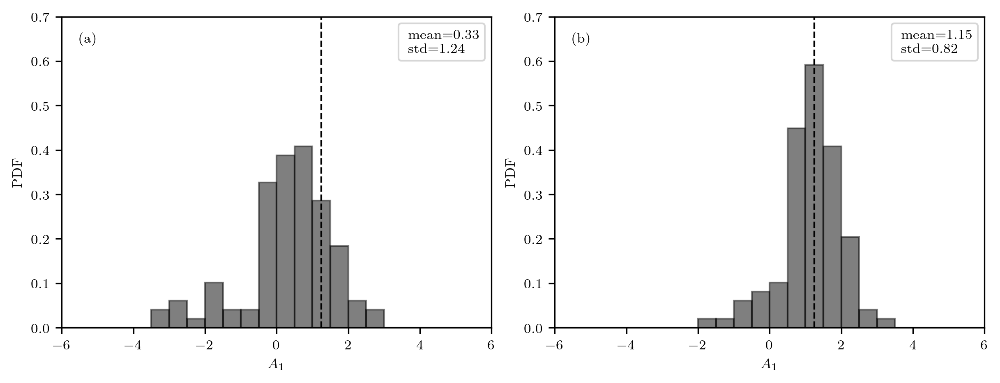

In [349]:
text_loc = [0.12, 0.88]
font_size = 8
mark_size = 5
fig, axes = plt.subplot_mosaic([['a','b']], constrained_layout=True)
fig.set_size_inches(8,3)
fig.set_dpi(300)
# label physical distance in and down:
trans = mtransforms.ScaledTranslation(-20/72, 7/72, fig.dpi_scale_trans)

def plot_pdf_A1(fig_lbl,ax_,type_):
    sample = fit_data_vars['var1D_ustd'][type_]['A1_fit'][mask]
    sns.distplot(sample, hist=True, kde=True,
             bins=24, color = 'black', 
             hist_kws={'edgecolor':'black',"range": [-6,6],'alpha':0.5},
             kde_kws={'linewidth': 0},
             ax=ax_)
    info = ['mean={:.2f}\nstd={:.2f}'.format(np.nanmean(sample), np.nanstd(sample))]
    # ax_.annotate(info, xy=(0.8,0.9),xycoords='axes fraction',
    #          fontsize=font_size)
    ax_.legend(custom_lines, info, fontsize=font_size, handlelength=-0.5, loc = 'upper right')
    ax_.set_xlim(-6,6)
    ax_.set_ylim(0,0.7)
    ax_.set_xlabel(r'$A_1$', fontsize = font_size)
    ax_.set_ylabel(r'PDF', fontsize = font_size)
    ax_.axvline(x=1.25, color='k', linestyle='--', linewidth=1)
    # ax_.set_title('6th to 11th')
    ax_.text(text_loc[0], text_loc[1], fig_lbl, transform=ax_.transAxes + trans,
            fontsize=font_size, zorder=2, 
            bbox={'facecolor': 'white', 'edgecolor': 'none', 'pad': 1})

plot_pdf_A1('(a)',axes['a'],'ldtr')
plot_pdf_A1('(b)',axes['b'],'filt')
# Adjust spacing
fig.subplots_adjust(wspace=0.25)  # Adjust the width space between subplots

plt.savefig(OUT_PLOT_DIR+'PDF_A1_ldtr_filt.jpg',dpi=400, bbox_inches='tight')

# Plot PDF of kappa

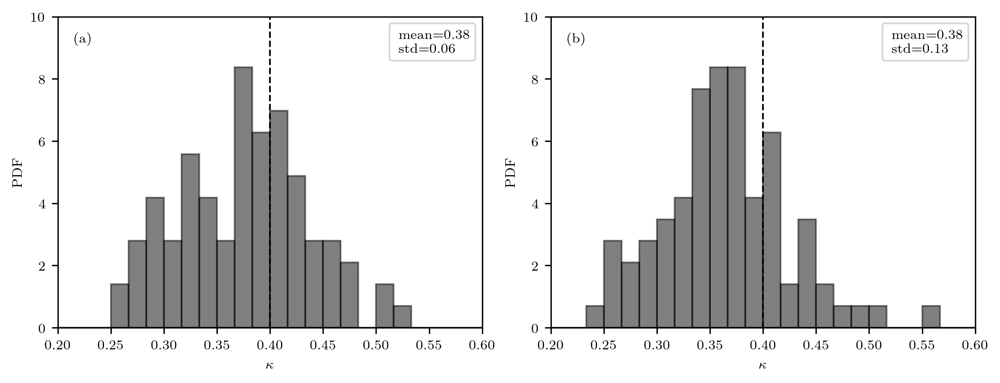

In [29]:
text_loc = [0.12, 0.88]
font_size = 8
mark_size = 5
fig, axes = plt.subplot_mosaic([['a','b']], constrained_layout=True)
fig.set_size_inches(8,3)
fig.set_dpi(300)
# label physical distance in and down:
trans = mtransforms.ScaledTranslation(-20/72, 7/72, fig.dpi_scale_trans)

def plot_pdf_kappa(fig_lbl,ax_,type_):
    sample = fit_data_vars['var1D_uavg'][type_]['kappa_fit'][mask]
    sns.distplot(sample, hist=True, kde=True,
             bins=24, color = 'black', 
             hist_kws={'edgecolor':'black',"range": [0.2,0.6],'alpha':0.5},
             kde_kws={'linewidth': 0},
             ax=ax_)
    info = ['mean={:.2f}\nstd={:.2f}'.format(np.nanmean(sample), np.nanstd(sample))]
    # ax_.annotate(info, xy=(0.8,0.9),xycoords='axes fraction',
    #          fontsize=font_size)
    ax_.legend(custom_lines, info, fontsize=font_size, handlelength=-0.5, loc = 'upper right')
    ax_.set_xlim(0.2,0.6)
    ax_.set_ylim(0,10)
    ax_.set_xlabel(r'$\kappa$', fontsize = font_size)
    ax_.set_ylabel(r'PDF', fontsize = font_size)
    ax_.axvline(x=0.4, color='k', linestyle='--', linewidth=1)
    # ax_.set_title('6th to 11th')
    ax_.text(text_loc[0], text_loc[1], fig_lbl, transform=ax_.transAxes + trans,
            fontsize=font_size, zorder=2, 
            bbox={'facecolor': 'white', 'edgecolor': 'none', 'pad': 1})

plot_pdf_kappa('(a)',axes['a'],'ldtr')
plot_pdf_kappa('(b)',axes['b'],'filt')
# Adjust spacing
fig.subplots_adjust(wspace=0.25)  # Adjust the width space between subplots

plt.savefig(OUT_PLOT_DIR+'PDF_kappa_ldtr_filt.jpg',dpi=400, bbox_inches='tight')

# Plot PDF of sigma_w/u*

In [48]:
np.nanmin(fit_data_vars['var1D_ustd']['ldtr']['slope_wstd_ustar'][mask]),np.nanmax(fit_data_vars['var1D_ustd']['ldtr']['slope_wstd_ustar'][mask])

(0.9184477854747451, 1.3117323890266646)

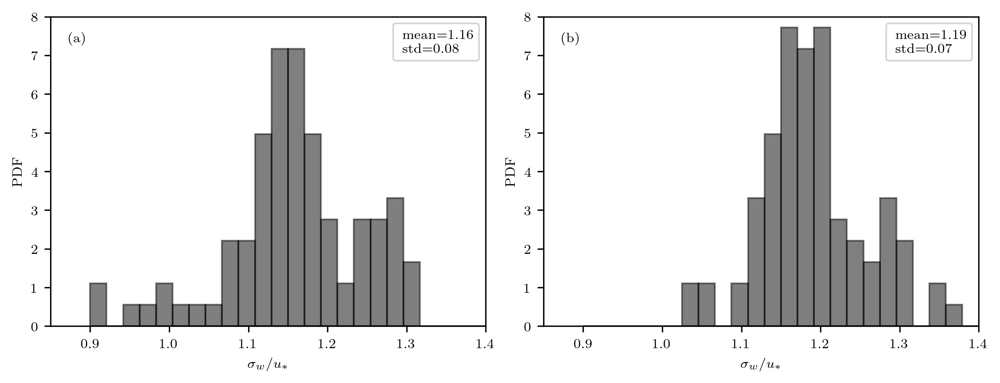

In [52]:
text_loc = [0.12, 0.88]
font_size = 8
mark_size = 5
fig, axes = plt.subplot_mosaic([['a','b']], constrained_layout=True)
fig.set_size_inches(8,3)
fig.set_dpi(300)
# label physical distance in and down:
trans = mtransforms.ScaledTranslation(-20/72, 7/72, fig.dpi_scale_trans)

def plot_pdf_kappa(fig_lbl,ax_,type_):
    sample = fit_data_vars['var1D_ustd'][type_]['slope_wstd_ustar'][mask]
    sns.distplot(sample, hist=True, kde=True,
             bins=24, color = 'black', 
             hist_kws={'edgecolor':'black',"range": [0.9,1.4],'alpha':0.5},
             kde_kws={'linewidth': 0},
             ax=ax_)
    info = ['mean={:.2f}\nstd={:.2f}'.format(np.nanmean(sample), np.nanstd(sample))]
    # ax_.annotate(info, xy=(0.8,0.9),xycoords='axes fraction',
    #          fontsize=font_size)
    ax_.legend(custom_lines, info, fontsize=font_size, handlelength=-0.5, loc = 'upper right')
    ax_.set_xlim(0.85,1.4)
    ax_.set_ylim(0,8)
    ax_.set_xlabel(r'$\sigma_w/u_*$', fontsize = font_size)
    ax_.set_ylabel(r'PDF', fontsize = font_size)
    # ax_.axvline(x=0.4, color='k', linestyle='--', linewidth=1)
    # ax_.set_title('6th to 11th')
    ax_.text(text_loc[0], text_loc[1], fig_lbl, transform=ax_.transAxes + trans,
            fontsize=font_size, zorder=2, 
            bbox={'facecolor': 'white', 'edgecolor': 'none', 'pad': 1})

plot_pdf_kappa('(a)',axes['a'],'ldtr')
plot_pdf_kappa('(b)',axes['b'],'filt')
# Adjust spacing
fig.subplots_adjust(wspace=0.25)  # Adjust the width space between subplots

plt.savefig(OUT_PLOT_DIR+'PDF_wstd_ustar_ldtr_filt.jpg',dpi=400, bbox_inches='tight')

# ****** Section 2 ******

# Plot A1,kappa,sigma_u^2/ustar^2 against u*

In [31]:
u_star_mean_filt[mask].shape

(120,)

(0.1, 0.7)

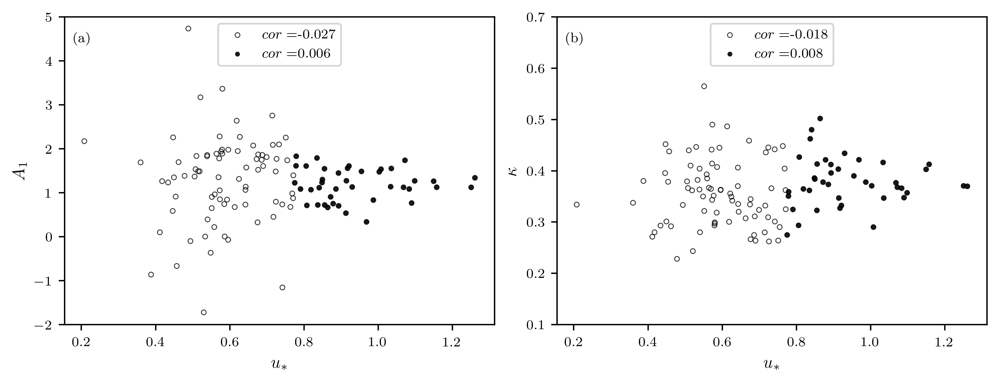

In [32]:
text_loc = [0.1, 0.88]
font_size = 8
mark_size = 8
line_width = 0.5
fig, axes = plt.subplot_mosaic([['a','b']], constrained_layout=True)
fig.set_size_inches(8,3)
fig.set_dpi(400)
# label physical distance in and down:
trans = mtransforms.ScaledTranslation(-20/72, 7/72, fig.dpi_scale_trans)
mask_all = mask*mask_re*mask_r2
def plot_fig_label(x_var,fig_lbl,ax_):
    mask1 = mask
    cor=np.corrcoef(x_var[mask1],y_temp[mask1])
    ax_.scatter(x_var[mask1],y_temp[mask1], alpha=0.8, s=mark_size,
                edgecolors='black', facecolors='none', linewidths=line_width, 
                label='$cor=$'+f'{cor[0,1]:.3f}')
    
    cor=np.corrcoef(x_var[mask*mask_re],y_temp[mask*mask_re])
    ax_.scatter(x_var[mask*mask_re],y_temp[mask*mask_re], s=mark_size, 
                color='k', alpha=0.9, 
                edgecolors='none', label='$cor=$'+f'{cor[0,1]:.3f}')
    # ax_.set_ylabel(r'$A_1$', fontsize=font_size)
    # ax_.set_xlim(-0.1,0.1)
    # Change axis tick label size
    ax_.tick_params(axis='both', labelsize=font_size)  # Adjust axis tick label size
    ax_.text(text_loc[0], text_loc[1], fig_lbl, transform=ax_.transAxes + trans,
                fontsize=font_size, zorder=2, 
                bbox={'facecolor': 'white', 'edgecolor': 'none', 'pad': 1})
    ax_.legend(fontsize=font_size,loc="upper center")
    # ax_.axvline(x=0,linestyle='--',color='gray', linewidth=line_width, zorder=2)
    # Fit the regression line
    slope, intercept, r_value, p_value, std_err = stats.linregress(x_var[mask*mask_re], y_temp[mask*mask_re])

    # # Predict values
    # x = np.sort(x_var[mask_all])
    # print(x)
    # y_pred = intercept + slope * x

    # # Calculate the confidence interval
    # confidence_level = 0.95
    # degrees_freedom = len(x) - 2
    # t_crit = np.abs(stats.t.ppf((1-confidence_level)/2, degrees_freedom))
    # ci = t_crit * std_err * np.sqrt(1/len(x) 
    #                                 + (x - np.mean(x))**2 / np.sum((x - np.mean(x))**2))
    # ax_.plot(x, y_pred, color='red', label='Regression line', linewidth=line_width)

    # # Fill between for the 95% confidence interval
    # ax_.fill_between(x, y_pred - ci, y_pred + ci, color='grey', alpha=0.2, 
    #                  label='95% Confidence Interval', linewidth=line_width)

# mask_ist_wspd = IST_u_filt<0.3
y_temp = A1_filt
# mask_temp = abs(geomean_median_stability)<0.1
# mask outliers
mask_y = np.logical_and(y_temp>-2,y_temp<5)
plot_fig_label(u_star_mean_filt,'(a)', axes['a'])
axes['a'].set_xlabel(r'$u_*$', fontsize=font_size+2)
axes['a'].set_ylabel(r'$A_1$', fontsize=font_size+2)
axes['a'].set_ylim(-2,5)
# outside_conditions = sum(1 for x, y in zip(geomean_median_stability[mask], y_temp[mask]) if y < -2 or y > 5 or x < -0.1 or x > 0.1)
# print('outlier count:'+f"{np.sum(outside_conditions)}")

y_temp = kappa_filt
# mask outliers
# mask_y = np.logical_and(y_temp>0.1,y_temp<0.7)
plot_fig_label(u_star_mean_filt,'(b)', axes['b'])
axes['b'].set_xlabel(r'$u_*$', fontsize=font_size+2)
axes['b'].set_ylabel(r'$\kappa$', fontsize=font_size+2)
axes['b'].set_ylim(0.1,0.7)
# outside_conditions = sum(1 for x, y in zip(geomean_median_stability[mask], y_temp[mask]) if y < 0.1 or y > 0.7 or x < -0.1 or x > 0.1)
# print('outlier count:'+f"{np.sum(outside_conditions)}")
# plt.savefig(OUT_PLOT_DIR+'stability_vs_A1_kappa.jpg',dpi=400, bbox_inches='tight')

# Plot normalized A1 agianst 6 quality control variables

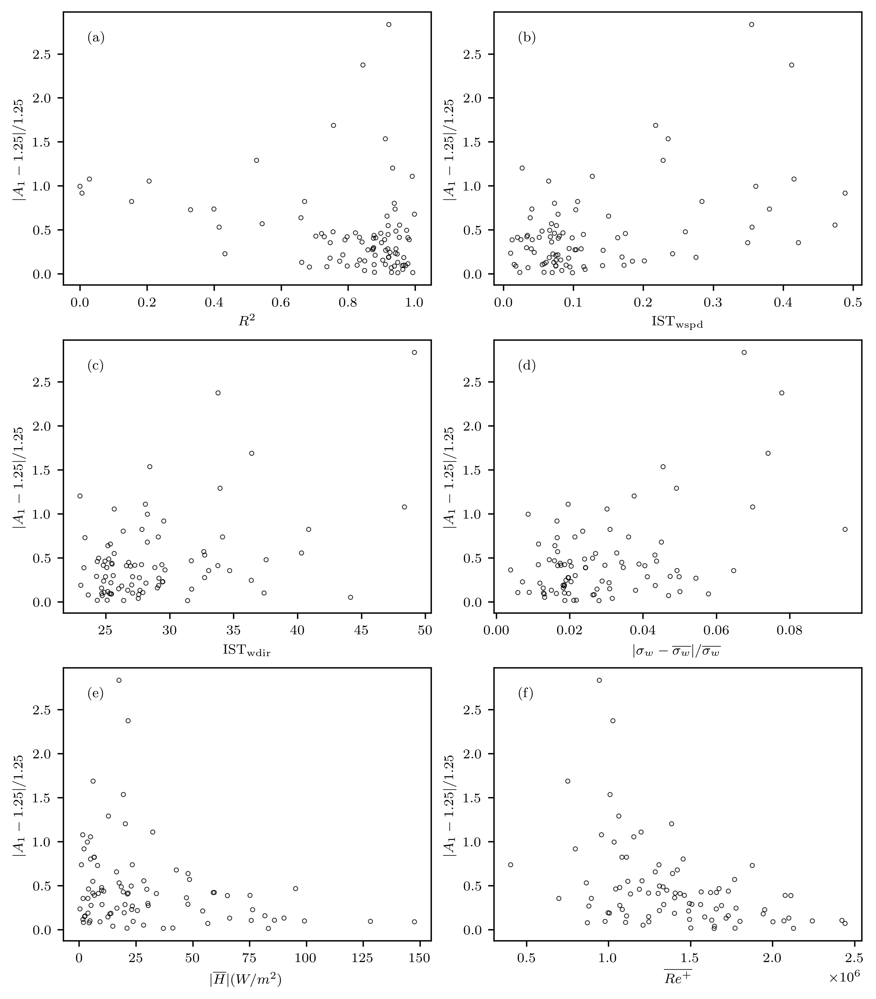

In [55]:
text_loc = [0.16, 0.85]
font_size = 8
mark_size = 6
line_width = 0.5
fig, axes = plt.subplot_mosaic([['a','b'],['c','d'],['e','f']], constrained_layout=True)
fig.set_size_inches(7,8)
fig.set_dpi(400)
# label physical distance in and down:
trans = mtransforms.ScaledTranslation(-20/72, 7/72, fig.dpi_scale_trans)

def plot_fig_label(x_var,fig_lbl,ax_):
    ax_.scatter(x_var[mask],y_temp[mask], alpha=0.8, label='Original Data', s=mark_size,
                  edgecolors='black', facecolors='none', linewidths=line_width)
    ax_.set_ylabel(r'$|A_1-1.25|/1.25$', fontsize=font_size)
    ax_.text(text_loc[0], text_loc[1], fig_lbl, transform=ax_.transAxes + trans,
                fontsize=font_size, zorder=2, 
                bbox={'facecolor': 'white', 'edgecolor': 'none', 'pad': 1})
    

y_temp = abs(A1_filt-1.25)/1.25
# axes['a'].plot(R2_A1_filt[mask],y_temp[mask],'.',color = 'k',markersize=mark_size)
axes['a'].set_xlabel(r'$R^2$', fontsize=font_size)
# axes['a'].set_ylabel(r'$|A_1-1.25|/1.25$', fontsize=font_size)
plot_fig_label(R2_A1_filt,'(a)', axes['a'])

# axes['b'].plot(IST_u_filt[mask],y_temp[mask],'.',color = 'k',markersize=mark_size)
axes['b'].set_xlabel(r'$\mathrm{IST_{wspd}}$', fontsize=font_size)
# axes['b'].set_ylabel(r'$|A_1-1.25|/1.25$', fontsize=font_size)
plot_fig_label(IST_u_filt,'(b)', axes['b'])

# axes['c'].plot(IST_wdir_filt[mask],y_temp[mask],'.',color = 'k',markersize=mark_size)
axes['c'].set_xlabel(r'$\mathrm{IST_{wdir}}$', fontsize=font_size)
# axes['b'].set_ylabel(r'$|A_1-1.25|/1.25$', fontsize=font_size)
plot_fig_label(IST_wdir_filt,'(c)', axes['c'])

# axes['d'].plot(score_w_std_filt[mask],y_temp[mask],'.',color = 'k',markersize=mark_size)
axes['d'].set_xlabel(r'$|\sigma_w-\overline{\sigma_w}|/\overline{\sigma_w}$', fontsize=font_size)
# axes['b'].set_ylabel(r'$|A_1-1.25|/1.25$', fontsize=font_size)
plot_fig_label(score_w_std_filt,'(d)', axes['d'])

# axes['e'].plot(abs(H_avg_filt[mask]),y_temp[mask],'.',color = 'k',markersize=mark_size)
axes['e'].set_xlabel(r'$|\overline{H}| (W/m^2)$', fontsize=font_size)
# axes['b'].set_ylabel(r'$|A_1-1.25|/1.25$', fontsize=font_size)
plot_fig_label(abs(H_avg_filt),'(e)', axes['e'])

# axes['f'].plot(Re_plus_mean_filt[mask],y_temp[mask],'.',color = 'k',markersize=mark_size)
axes['f'].set_xlabel(r'$\overline{{Re}^+}$', fontsize=font_size)
# axes['b'].set_ylabel(r'$|A_1-1.25|/1.25$', fontsize=font_size)
plot_fig_label(Re_plus_mean_filt,'(f)', axes['f'])

# Adjust spacing
fig.subplots_adjust(wspace=0.3)  # Adjust the width space between subplots
fig.subplots_adjust(hspace=0.3)

plt.savefig(OUT_PLOT_DIR+'A1_vs_R2_IST_wstd_H_Re.jpg',dpi=400, bbox_inches='tight')

# Plot $\kappa$ against 6 quality control variables

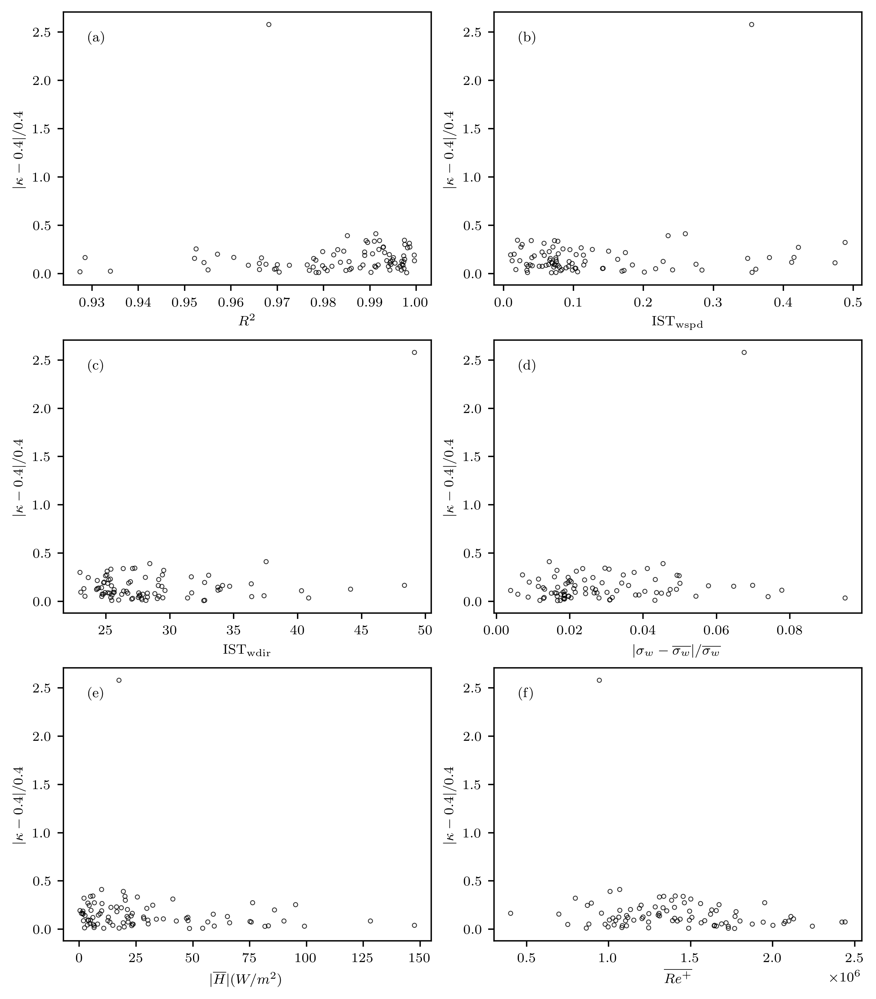

In [56]:
text_loc = [0.16, 0.85]
font_size = 8
mark_size = 6
line_width = 0.5
fig, axes = plt.subplot_mosaic([['a','b'],['c','d'],['e','f']], constrained_layout=True)
fig.set_size_inches(7,8)
fig.set_dpi(400)
# label physical distance in and down:
trans = mtransforms.ScaledTranslation(-20/72, 7/72, fig.dpi_scale_trans)

def plot_fig_label(x_var,fig_lbl,ax_):
    ax_.scatter(x_var[mask],y_temp[mask], alpha=0.8, label='Original Data', s=mark_size,
                  edgecolors='black', facecolors='none', linewidths=line_width)
    ax_.set_ylabel(r'$|\kappa-0.4|/0.4$', fontsize=font_size)
    ax_.text(text_loc[0], text_loc[1], fig_lbl, transform=ax_.transAxes + trans,
                fontsize=font_size, zorder=2, 
                bbox={'facecolor': 'white', 'edgecolor': 'none', 'pad': 1})
    # ax_.set_ylim(-0.05,0.7)
    

y_temp = abs(kappa_filt-0.4)/0.4
# axes['a'].plot(R2_A1_filt[mask],y_temp[mask],'.',color = 'k',markersize=mark_size)
axes['a'].set_xlabel(r'$R^2$', fontsize=font_size)
# axes['a'].set_ylabel(r'$|A_1-1.25|/1.25$', fontsize=font_size)
plot_fig_label(R2_kappa_filt,'(a)', axes['a'])

# axes['b'].plot(IST_u_filt[mask],y_temp[mask],'.',color = 'k',markersize=mark_size)
axes['b'].set_xlabel(r'$\mathrm{IST_{wspd}}$', fontsize=font_size)
# axes['b'].set_ylabel(r'$|A_1-1.25|/1.25$', fontsize=font_size)
plot_fig_label(IST_u_filt,'(b)', axes['b'])

# axes['c'].plot(IST_wdir_filt[mask],y_temp[mask],'.',color = 'k',markersize=mark_size)
axes['c'].set_xlabel(r'$\mathrm{IST_{wdir}}$', fontsize=font_size)
# axes['b'].set_ylabel(r'$|A_1-1.25|/1.25$', fontsize=font_size)
plot_fig_label(IST_wdir_filt,'(c)', axes['c'])

# axes['d'].plot(score_w_std_filt[mask],y_temp[mask],'.',color = 'k',markersize=mark_size)
axes['d'].set_xlabel(r'$|\sigma_w-\overline{\sigma_w}|/\overline{\sigma_w}$', fontsize=font_size)
# axes['b'].set_ylabel(r'$|A_1-1.25|/1.25$', fontsize=font_size)
plot_fig_label(score_w_std_filt,'(d)', axes['d'])

# axes['e'].plot(abs(H_avg_filt[mask]),y_temp[mask],'.',color = 'k',markersize=mark_size)
axes['e'].set_xlabel(r'$|\overline{H}| (W/m^2)$', fontsize=font_size)
# axes['b'].set_ylabel(r'$|A_1-1.25|/1.25$', fontsize=font_size)
plot_fig_label(abs(H_avg_filt),'(e)', axes['e'])

# axes['f'].plot(Re_plus_mean_filt[mask],y_temp[mask],'.',color = 'k',markersize=mark_size)
axes['f'].set_xlabel(r'$\overline{{Re}^+}$', fontsize=font_size)
# axes['b'].set_ylabel(r'$|A_1-1.25|/1.25$', fontsize=font_size)
plot_fig_label(Re_plus_mean_filt,'(f)', axes['f'])

# Adjust spacing
fig.subplots_adjust(wspace=0.3)  # Adjust the width space between subplots
fig.subplots_adjust(hspace=0.3)

plt.savefig(OUT_PLOT_DIR+'kappa_vs_R2_IST_wstd_H_Re.jpg',dpi=400, bbox_inches='tight')

# Correlation between 6 quality control variables
## R2_A1

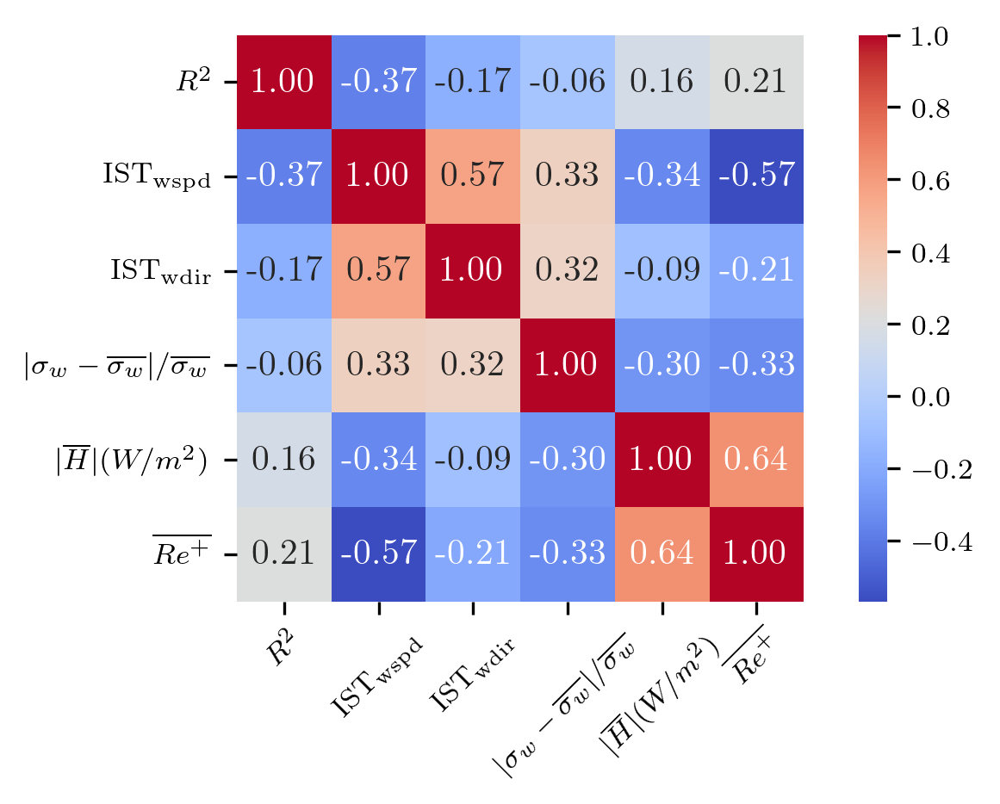

In [89]:
var_names = [r'$R^2$', r'$\mathrm{IST_{wspd}}$', r'$\mathrm{IST_{wdir}}$', 
             r'$|\sigma_w-\overline{\sigma_w}|/\overline{\sigma_w}$', 
             r'$|\overline{H}| (W/m^2)$', r'$\overline{{Re}^+}$']

fig, axes = plt.subplot_mosaic([['a']], constrained_layout=True)
fig.set_size_inches(5,3)
fig.set_dpi(300)

def plot_corr_heatmap(mask_,fig_lbl,ax_):
    data = pd.DataFrame({
            var_names[0]: R2_A1_filt[mask_],
            var_names[1]: IST_u_filt[mask_],
            var_names[2]: IST_wdir_filt[mask_],
            var_names[3]: score_w_std_filt[mask_],
            var_names[4]: abs(H_avg_filt[mask_]),
            var_names[5]: Re_plus_mean_filt[mask_]
                        })
    corr_matrix = data.corr()
    sns.heatmap(corr_matrix, annot=True, fmt=".2f", cmap='coolwarm', cbar=True, square=True, 
            xticklabels=corr_matrix.columns, yticklabels=corr_matrix.columns, ax=ax_)
    # axes['a'].set_title('Correlation Matrix Heatmap', fontsize=font_size)
    plt.xticks(rotation=45)  # Rotate xticklabels by 45 degrees

# plot_corr_heatmap(mask,'(a)', axes['a'])
plot_corr_heatmap(mask,'(a)', axes['a'])   
plt.savefig(OUT_PLOT_DIR+'A1_correlation_heatmap.jpg',dpi=400, bbox_inches='tight')

## R2_kappa

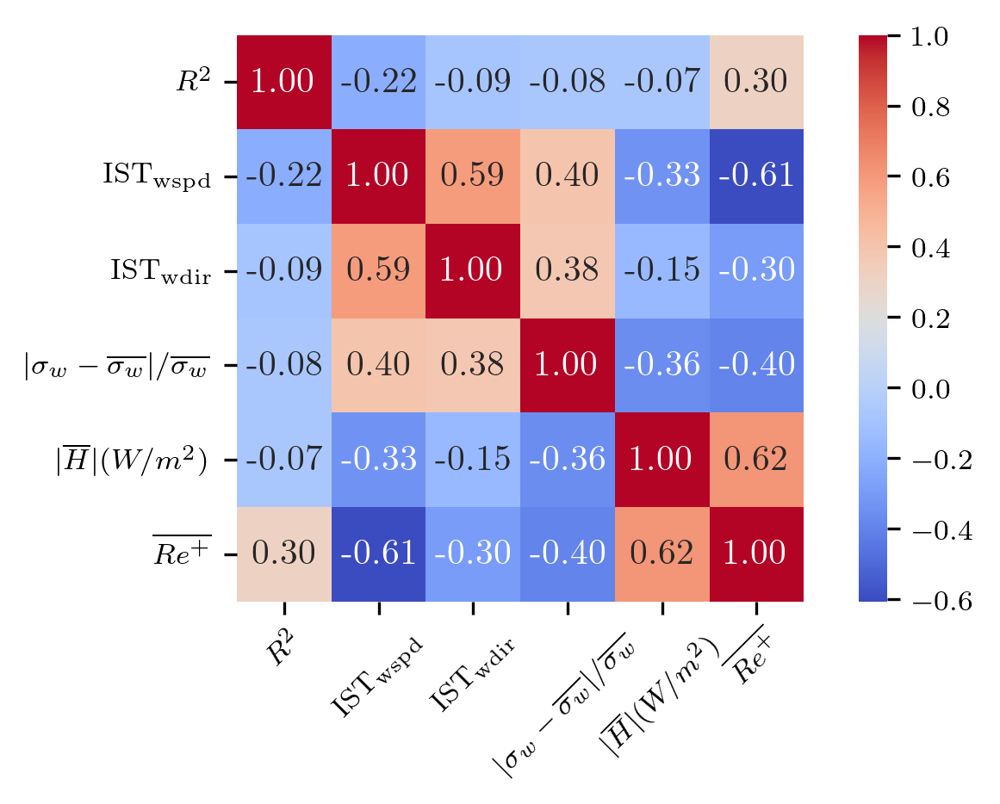

In [57]:
var_names = [r'$R^2$', r'$\mathrm{IST_{wspd}}$', r'$\mathrm{IST_{wdir}}$', 
             r'$|\sigma_w-\overline{\sigma_w}|/\overline{\sigma_w}$', 
             r'$|\overline{H}| (W/m^2)$', r'$\overline{{Re}^+}$']

fig, axes = plt.subplot_mosaic([['a']], constrained_layout=True)
fig.set_size_inches(5,3)
fig.set_dpi(300)

def plot_corr_heatmap(mask_,fig_lbl,ax_):
    data = pd.DataFrame({
            var_names[0]: R2_kappa_filt[mask_],
            var_names[1]: IST_u_filt[mask_],
            var_names[2]: IST_wdir_filt[mask_],
            var_names[3]: score_w_std_filt[mask_],
            var_names[4]: abs(H_avg_filt[mask_]),
            var_names[5]: Re_plus_mean_filt[mask_]
                        })
    corr_matrix = data.corr()
    sns.heatmap(corr_matrix, annot=True, fmt=".2f", cmap='coolwarm', cbar=True, square=True, 
            xticklabels=corr_matrix.columns, yticklabels=corr_matrix.columns, ax=ax_)
    # axes['a'].set_title('Correlation Matrix Heatmap', fontsize=font_size)
    plt.xticks(rotation=45)  # Rotate xticklabels by 45 degrees

# plot_corr_heatmap(mask,'(a)', axes['a'])
plot_corr_heatmap(mask,'(a)', axes['a'])   
plt.savefig(OUT_PLOT_DIR+'kappa_correlation_heatmap.jpg',dpi=400, bbox_inches='tight')

# The effect of IST_wspd on others relations

In [58]:
np.sum(mask*mask_ist_wspd*mask_r2*mask_sigmaw*mask_ISTwdir)

0

In [63]:
np.sum(mask*mask_ist_wspd*mask_r2*mask_sigmaw)

31

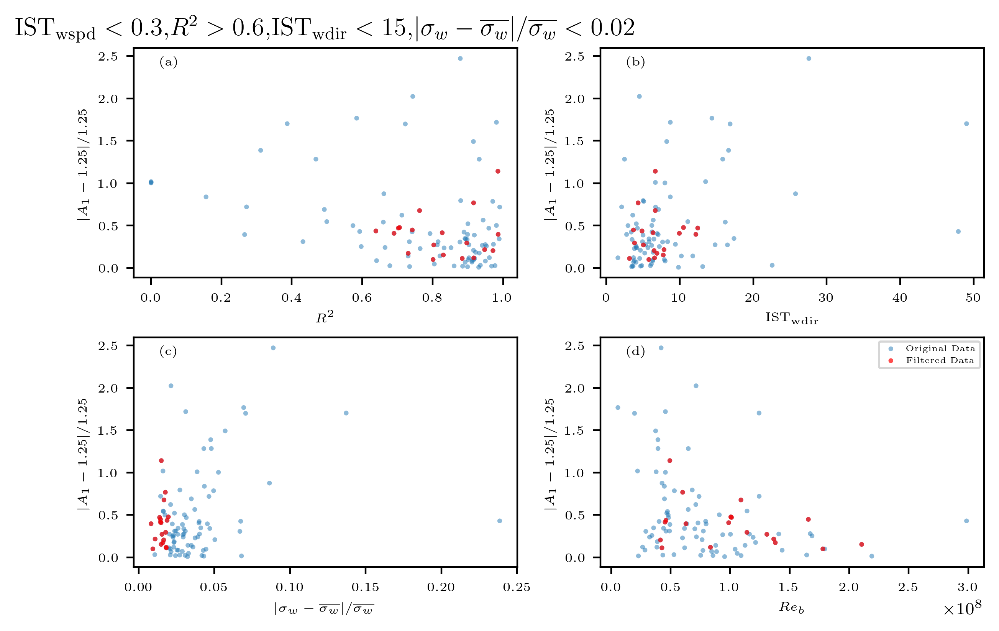

In [24]:
text_loc = [0.18, 0.86]
font_size = 6
mark_size = 5
fig, axes = plt.subplot_mosaic([['a','b'],['c','d']], constrained_layout=True)
fig.set_size_inches(6,4)
fig.set_dpi(400)
# label physical distance in and down:
trans = mtransforms.ScaledTranslation(-20/72, 7/72, fig.dpi_scale_trans)

def plot_fig_label(x_var,fig_lbl,ax_):
    ax_.scatter(x_var[mask],y_temp[mask], color='C0', alpha=0.5, label='Original Data', s=mark_size,
                  edgecolors='none')
    ax_.scatter(x_var[mask*mask_ist_wspd*mask_r2*mask_sigmaw*mask_ISTwdir], 
                y_temp[mask*mask_ist_wspd*mask_r2*mask_sigmaw*mask_ISTwdir], s=mark_size, 
                color='red', alpha=0.7, 
                label=r'Filtered Data', 
                edgecolors='none')
    ax_.set_ylabel(r'$|A_1-1.25|/1.25$', fontsize=font_size)
    # Change axis tick label size
    ax_.tick_params(axis='x', labelsize=font_size)  # Adjust x-axis tick label size
    ax_.tick_params(axis='y', labelsize=font_size)  # Adjust y-axis tick label size
    ax_.text(text_loc[0], text_loc[1], fig_lbl, transform=ax_.transAxes + trans,
                fontsize=font_size, zorder=2, 
                bbox={'facecolor': 'white', 'edgecolor': 'none', 'pad': 1})
    
# mask_ist_wspd = IST_u_filt<0.3
y_temp = abs(A1_filt-1.25)/1.25


axes['a'].set_xlabel(r'$R^2$', fontsize=font_size)
plot_fig_label(R2_A1_filt,'(a)', axes['a'])
axes['a'].set_title(r'$\mathrm{IST_{wspd}}<0.3$,$R^2>0.6$,$\mathrm{IST_{wdir}}<15$,$|\sigma_w-\overline{\sigma_w}|/\overline{\sigma_w}<0.02$')

axes['b'].set_xlabel(r'$\mathrm{IST_{wdir}}$', fontsize=font_size)
plot_fig_label(IST_wdir_filt,'(b)', axes['b'])

axes['c'].set_xlabel(r'$|\sigma_w-\overline{\sigma_w}|/\overline{\sigma_w}$', fontsize=font_size)
plot_fig_label(score_w_std_filt,'(c)', axes['c'])


axes['d'].set_xlabel(r'$Re_b$', fontsize=font_size)
plot_fig_label(Re_b,'(d)', axes['d'])
axes['d'].legend(fontsize=font_size-2)


# Adjust spacing
fig.subplots_adjust(wspace=0.3)  # Adjust the width space between subplots
fig.subplots_adjust(hspace=0.3)


# See if Re>150,000 filter has included IST<0.3 consideration

In [53]:
mask1 = mask*mask_re
mask2 = mask*mask_ist_wspd

# Check if B is True where A is True
result = np.all(np.logical_or(np.logical_not(mask1), mask2))

print("B is True where A is True:", result)

B is True where A is True: True


# Plot the effect of Re filters on $A_1$

In [133]:
np.sum(mask*mask_re*mask_r2)

0

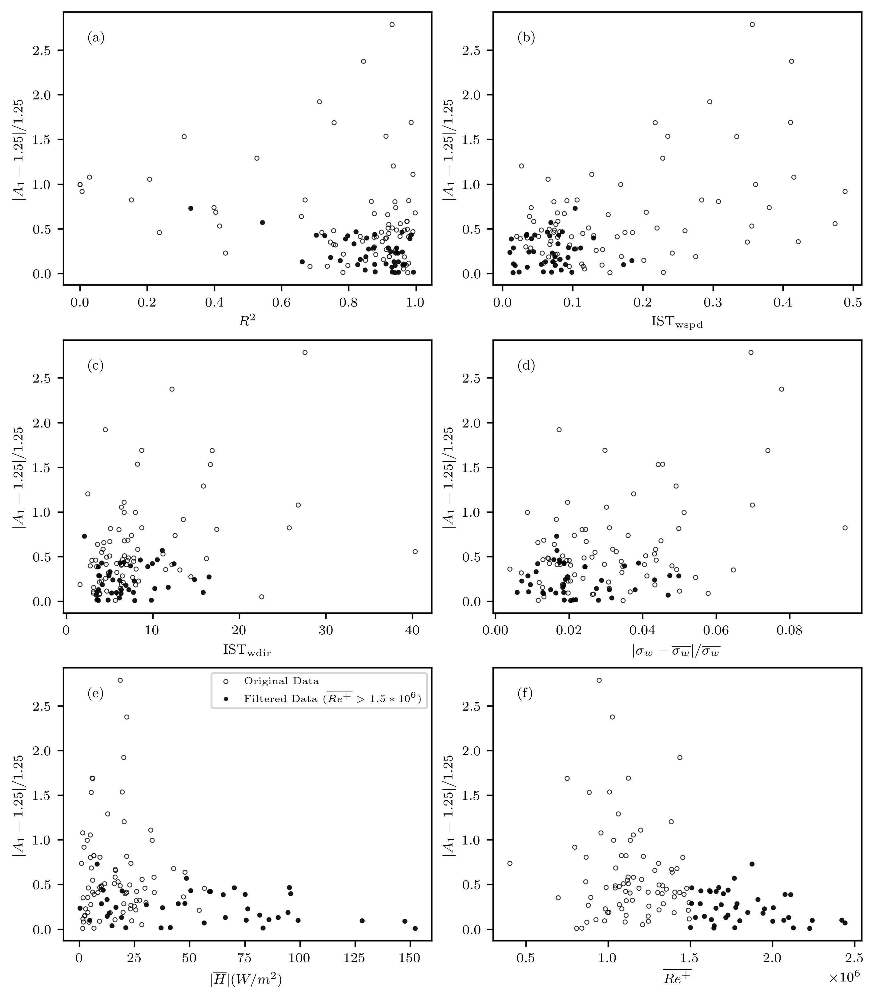

In [33]:
text_loc = [0.16, 0.85]
font_size = 8
mark_size = 6
line_width = 0.5
fig, axes = plt.subplot_mosaic([['a','b'],['c','d'],['e','f']], constrained_layout=True)
fig.set_size_inches(7,8)
fig.set_dpi(400)
# label physical distance in and down:
trans = mtransforms.ScaledTranslation(-20/72, 7/72, fig.dpi_scale_trans)

def plot_fig_label(x_var,fig_lbl,ax_):
    ax_.scatter(x_var[mask],y_temp[mask], alpha=0.8, label='Original Data', s=mark_size,
                  edgecolors='black', facecolors='none', linewidths=line_width)
    # ax_.scatter(x_var[mask*mask_ist_wspd],y_temp[mask*mask_ist_wspd], s=mark_size, 
    #             color='red', alpha=0.7, label=r'Filtered Data ($\mathrm{IST_{wspd}}<0.3$)', edgecolors='none')
    ax_.scatter(x_var[mask*mask_ist_wspd*mask_re],y_temp[mask*mask_ist_wspd*mask_re], s=mark_size, 
                color='k', alpha=0.9, label=r'Filtered Data ($\overline{{Re}^+}>1.5*10^6$)', edgecolors='none')
    ax_.set_ylabel(r'$|A_1-1.25|/1.25$', fontsize=font_size)
    # Change axis tick label size
    ax_.tick_params(axis='x', labelsize=font_size)  # Adjust x-axis tick label size
    ax_.tick_params(axis='y', labelsize=font_size)  # Adjust y-axis tick label size
    ax_.text(text_loc[0], text_loc[1], fig_lbl, transform=ax_.transAxes + trans,
                fontsize=font_size, zorder=2, 
                bbox={'facecolor': 'white', 'edgecolor': 'none', 'pad': 1})
    
# mask_ist_wspd = IST_u_filt<0.3
y_temp = abs(A1_filt-1.25)/1.25

axes['a'].set_xlabel(r'$R^2$', fontsize=font_size)
plot_fig_label(R2_A1_filt,'(a)', axes['a'])

axes['b'].set_xlabel(r'$\mathrm{IST_{wspd}}$', fontsize=font_size)
plot_fig_label(IST_u_filt,'(b)', axes['b'])

axes['c'].set_xlabel(r'$\mathrm{IST_{wdir}}$', fontsize=font_size)
plot_fig_label(IST_wdir_filt,'(c)', axes['c'])

axes['d'].set_xlabel(r'$|\sigma_w-\overline{\sigma_w}|/\overline{\sigma_w}$', fontsize=font_size)
plot_fig_label(score_w_std_filt,'(d)', axes['d'])

axes['e'].set_xlabel(r'$|\overline{H}| (W/m^2)$', fontsize=font_size)
plot_fig_label(abs(H_avg_filt),'(e)', axes['e'])
axes['e'].legend(fontsize=font_size-2)

axes['f'].set_xlabel(r'$\overline{{Re}^+}$', fontsize=font_size)
plot_fig_label(Re_plus_mean_filt,'(f)', axes['f'])


# Adjust spacing
fig.subplots_adjust(wspace=0.3)  # Adjust the width space between subplots
fig.subplots_adjust(hspace=0.3)
# 
# plt.savefig(OUT_PLOT_DIR+'Filtered_A1_vs_R2_IST_wstd_H_Re.jpg',dpi=400, bbox_inches='tight')

## Plot the effect of other filters

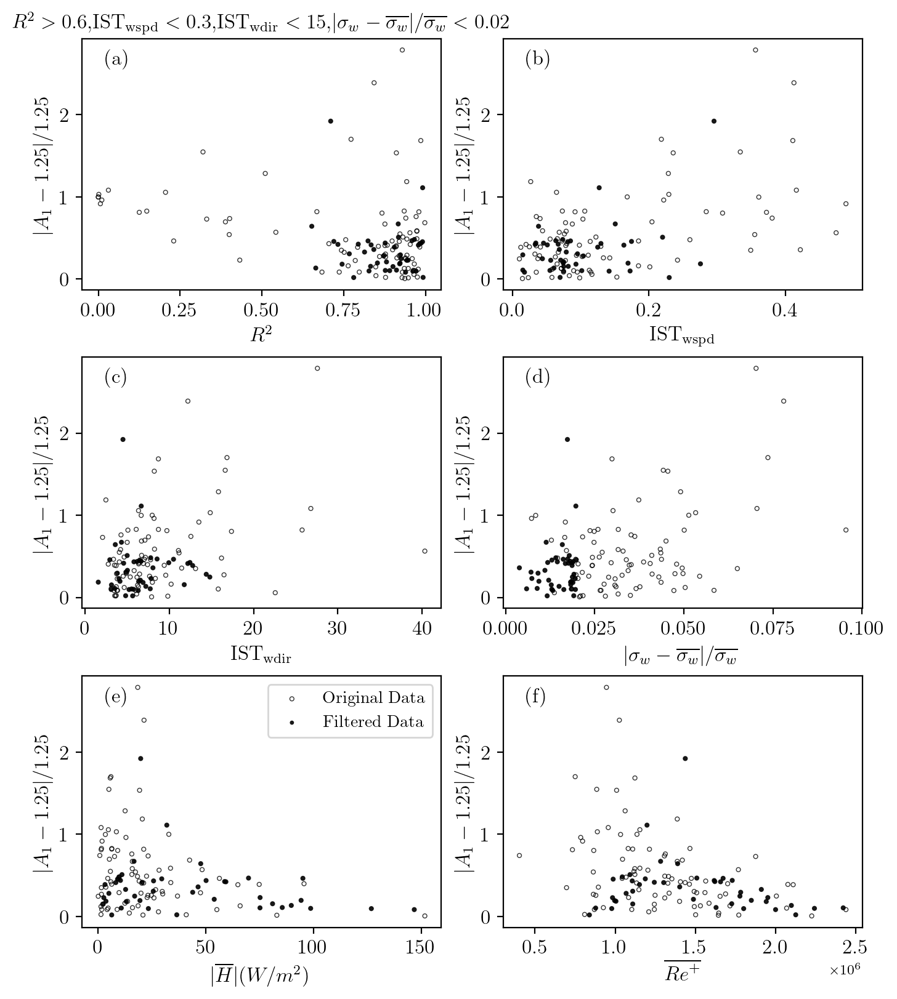

In [68]:
text_loc = [0.16, 0.85]
font_size = 12
mark_size = 6
line_width = 0.5
fig, axes = plt.subplot_mosaic([['a','b'],['c','d'],['e','f']], constrained_layout=True)
fig.set_size_inches(7,8)
fig.set_dpi(200)
# label physical distance in and down:
trans = mtransforms.ScaledTranslation(-20/72, 7/72, fig.dpi_scale_trans)
mask_filter = mask*mask_ist_wspd*mask_r2*mask_sigmaw*mask_ISTwdir
def plot_fig_label(x_var,fig_lbl,ax_):
    ax_.scatter(x_var[mask],y_temp[mask], alpha=0.8, label='Original Data', s=mark_size,
                  edgecolors='black', facecolors='none', linewidths=line_width)
    # ax_.scatter(x_var[mask*mask_ist_wspd],y_temp[mask*mask_ist_wspd], s=mark_size, 
    #             color='red', alpha=0.7, label=r'Filtered Data ($\mathrm{IST_{wspd}}<0.3$)', edgecolors='none')
    ax_.scatter(x_var[mask_filter],y_temp[mask_filter], s=mark_size, 
                color='k', alpha=0.9, label=r'Filtered Data', edgecolors='none')
    ax_.set_ylabel(r'$|A_1-1.25|/1.25$', fontsize=font_size)
    # Change axis tick label size
    ax_.tick_params(axis='x', labelsize=font_size)  # Adjust x-axis tick label size
    ax_.tick_params(axis='y', labelsize=font_size)  # Adjust y-axis tick label size
    ax_.text(text_loc[0], text_loc[1], fig_lbl, transform=ax_.transAxes + trans,
                fontsize=font_size, zorder=2, 
                bbox={'facecolor': 'white', 'edgecolor': 'none', 'pad': 1})
    
# mask_ist_wspd = IST_u_filt<0.3
y_temp = abs(A1_filt-1.25)/1.25
 
axes['a'].set_xlabel(r'$R^2$', fontsize=font_size)
plot_fig_label(R2_A1_filt,'(a)', axes['a'])
axes['a'].set_title(r'$R^2>0.6$,$\mathrm{IST_{wspd}}<0.3$,$\mathrm{IST_{wdir}}<15$,$|\sigma_w-\overline{\sigma_w}|/\overline{\sigma_w}<0.02$')

axes['b'].set_xlabel(r'$\mathrm{IST_{wspd}}$', fontsize=font_size)
plot_fig_label(IST_u_filt,'(b)', axes['b'])

axes['c'].set_xlabel(r'$\mathrm{IST_{wdir}}$', fontsize=font_size)
plot_fig_label(IST_wdir_filt,'(c)', axes['c'])

axes['d'].set_xlabel(r'$|\sigma_w-\overline{\sigma_w}|/\overline{\sigma_w}$', fontsize=font_size)
plot_fig_label(score_w_std_filt,'(d)', axes['d'])

axes['e'].set_xlabel(r'$|\overline{H}| (W/m^2)$', fontsize=font_size)
plot_fig_label(abs(H_avg_filt),'(e)', axes['e'])
axes['e'].legend(fontsize=font_size-2)

axes['f'].set_xlabel(r'$\overline{{Re}^+}$', fontsize=font_size)
plot_fig_label(Re_plus_mean_filt,'(f)', axes['f'])

# Adjust spacing
fig.subplots_adjust(wspace=0.3)  # Adjust the width space between subplots
fig.subplots_adjust(hspace=0.3)

# Plot the effect of Re filters on $\kappa$

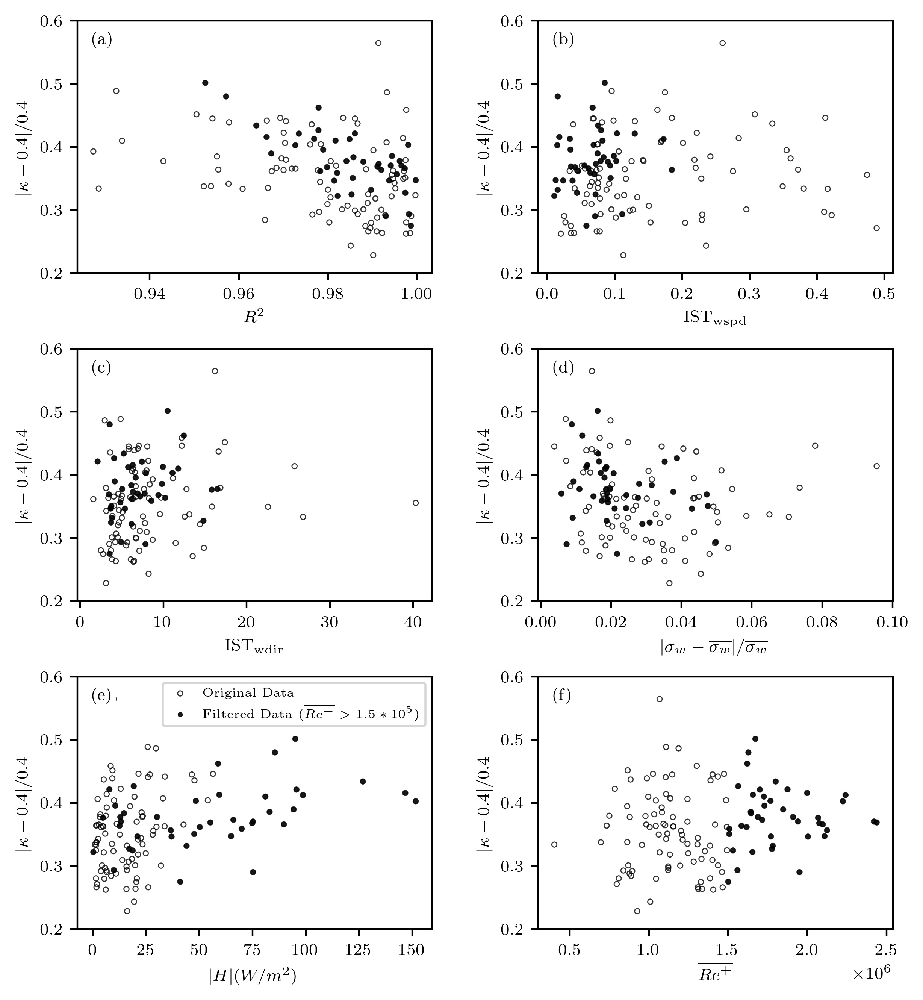

In [19]:
text_loc = [0.16, 0.85]
font_size = 8
mark_size = 6
line_width = 0.5
fig, axes = plt.subplot_mosaic([['a','b'],['c','d'],['e','f']], constrained_layout=True)
fig.set_size_inches(7,8)
fig.set_dpi(400)
# label physical distance in and down:
trans = mtransforms.ScaledTranslation(-20/72, 7/72, fig.dpi_scale_trans)

def plot_fig_label(x_var,fig_lbl,ax_):
    ax_.scatter(x_var[mask],y_temp[mask], alpha=0.8, label='Original Data', s=mark_size,
                  edgecolors='black', facecolors='none', linewidths=line_width)
    # ax_.scatter(x_var[mask*mask_ist_wspd],y_temp[mask*mask_ist_wspd], s=mark_size, 
    #             color='red', alpha=0.7, label=r'Filtered Data ($\mathrm{IST_{wspd}}<0.3$)', edgecolors='none')
    ax_.scatter(x_var[mask*mask_ist_wspd*mask_re],y_temp[mask*mask_re], s=mark_size, 
                color='k', alpha=0.9, label=r'Filtered Data ($\overline{{Re}^+}>1.5*10^6$)', edgecolors='none')
    ax_.set_ylabel(r'$|\kappa-0.4|/0.4$', fontsize=font_size)
    # Change axis tick label size
    ax_.tick_params(axis='x', labelsize=font_size)  # Adjust x-axis tick label size
    ax_.tick_params(axis='y', labelsize=font_size)  # Adjust y-axis tick label size
    ax_.text(text_loc[0], text_loc[1], fig_lbl, transform=ax_.transAxes + trans,
                fontsize=font_size, zorder=2, 
                bbox={'facecolor': 'white', 'edgecolor': 'none', 'pad': 1})
    ax_.set_ylim(0.2,0.6)
    
# mask_ist_wspd = IST_u_filt<0.3
# y_temp = abs(kappa_filt-0.4)/0.4
y_temp = kappa_filt

axes['a'].set_xlabel(r'$R^2$', fontsize=font_size)
plot_fig_label(R2_kappa_filt,'(a)', axes['a'])

axes['b'].set_xlabel(r'$\mathrm{IST_{wspd}}$', fontsize=font_size)
plot_fig_label(IST_u_filt,'(b)', axes['b'])

axes['c'].set_xlabel(r'$\mathrm{IST_{wdir}}$', fontsize=font_size)
plot_fig_label(IST_wdir_filt,'(c)', axes['c'])

axes['d'].set_xlabel(r'$|\sigma_w-\overline{\sigma_w}|/\overline{\sigma_w}$', fontsize=font_size)
plot_fig_label(score_w_std_filt,'(d)', axes['d'])

axes['e'].set_xlabel(r'$|\overline{H}| (W/m^2)$', fontsize=font_size)
plot_fig_label(abs(H_avg_filt),'(e)', axes['e'])
axes['e'].legend(fontsize=font_size-2)

axes['f'].set_xlabel(r'$\overline{{Re}^+}$', fontsize=font_size)
plot_fig_label(Re_plus_mean_filt,'(f)', axes['f'])


# Adjust spacing
fig.subplots_adjust(wspace=0.3)  # Adjust the width space between subplots
fig.subplots_adjust(hspace=0.3)

# plt.savefig(OUT_PLOT_DIR+'Filtered_kappa_vs_R2_IST_wstd_H_Re.jpg',dpi=400, bbox_inches='tight')

# Plot PDF of A1 before and after filtering

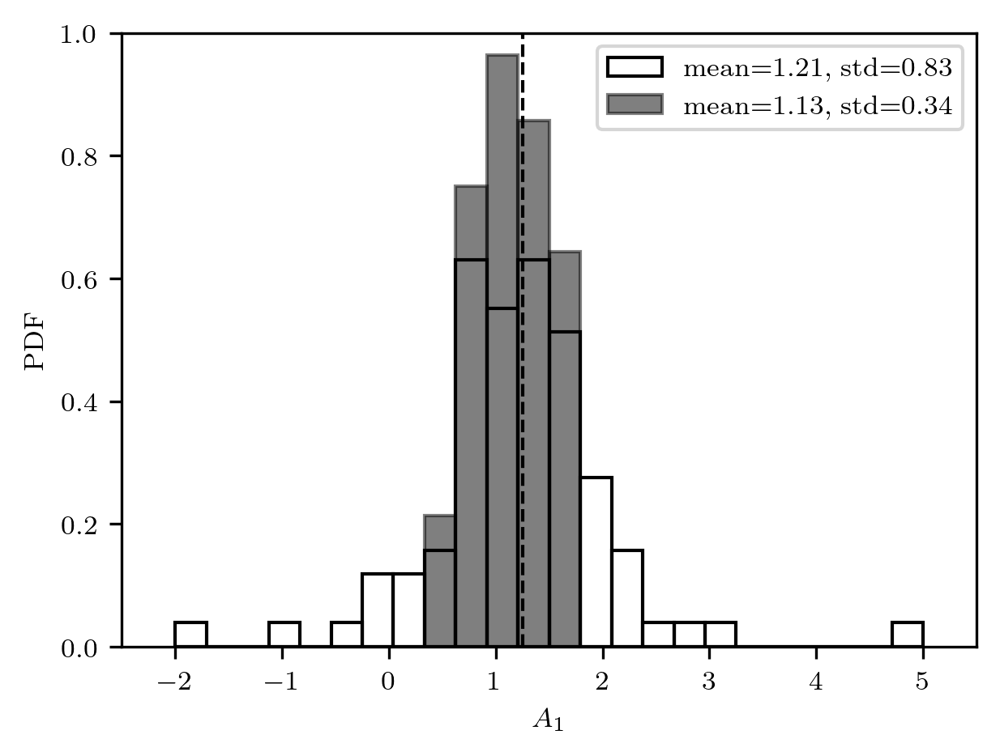

In [68]:
# np.sum(mask*mask_ist_wspd)
text_loc = [0.12, 0.88]
font_size = 8
mark_size = 5
fig, axes = plt.subplot_mosaic([['a']], constrained_layout=True)
fig.set_size_inches(4,3)
fig.set_dpi(300)
# label physical distance in and down:
trans = mtransforms.ScaledTranslation(-20/72, 7/72, fig.dpi_scale_trans)

def plot_pdf_A1(fig_lbl,ax_):
    # A1_filt = fit_data_vars['var1D_ustd']['filt']['A1_fit']
    sample1 = A1_filt[mask]
    sample2 = A1_filt[mask*mask_ist_wspd]
    sample3 = A1_filt[mask*mask_re]
    sns.distplot(sample1, hist=True, kde=True,
             bins=24, color = 'black', 
             hist_kws={'edgecolor':'black', 'linewidth': 1,"range": [-2,5],'facecolor':'none','alpha':1},
             kde_kws={'linewidth': 0}, 
             label='mean={:.2f}, std={:.2f}'.format(np.nanmean(sample1), np.nanstd(sample1)),
             ax=ax_)
    # sns.distplot(sample2, hist=True, kde=True,
    #          bins=24, color='red', 
    #          hist_kws={'edgecolor':'black',"range": [-2,5],'alpha':0.5},
    #          kde_kws={'linewidth': 0}, 
    #          label='mean={:.2f}, std={:.2f}'.format(np.nanmean(sample2), np.nanstd(sample2)),
    #          ax=ax_)
    sns.distplot(sample3, hist=True, kde=True,
             bins=24, color='k', 
             hist_kws={'edgecolor':'black', 'linewidth': 1,"range": [-2,5],'alpha':0.5},
             kde_kws={'linewidth': 0}, 
             label='mean={:.2f}, std={:.2f}'.format(np.nanmean(sample3), np.nanstd(sample3)),
             ax=ax_)
    # info = ['mean={:.2f}, std={:.2f}'.format(np.nanmean(sample1), np.nanstd(sample1))+'\n\n'+ 
    #         'mean={:.2f}, std={:.2f}'.format(np.nanmean(sample2), np.nanstd(sample2))+'\n\n'+ 
    #         'mean={:.2f}, std={:.2f}'.format(np.nanmean(sample3), np.nanstd(sample3))+'\n\n']
    # ax_.annotate(info, xy=(0.8,0.9),xycoords='axes fraction',
    #          fontsize=font_size)
    ax_.legend(fontsize=font_size, loc = 'upper right')
    ax_.set_xlim(-2.5,5.5)
    ax_.set_ylim(0,1)
    ax_.set_xlabel(r'$A_1$', fontsize = font_size)
    ax_.set_ylabel(r'PDF', fontsize = font_size)
    ax_.axvline(x=1.25, color='k', linestyle='--', linewidth=1)
    # ax_.set_title('6th to 11th')
    # ax_.text(text_loc[0], text_loc[1], fig_lbl, transform=ax_.transAxes + trans,
    #         fontsize=font_size, zorder=2, 
    #         bbox={'facecolor': 'white', 'edgecolor': 'none', 'pad': 1})


plot_pdf_A1('(a)',axes['a'])
# plot_pdf_A1('(a)',axes['a'])
plt.savefig(OUT_PLOT_DIR+'PDF_filtered_A1_filt.jpg',dpi=400, bbox_inches='tight')

# PDF of kappa before and after filtering

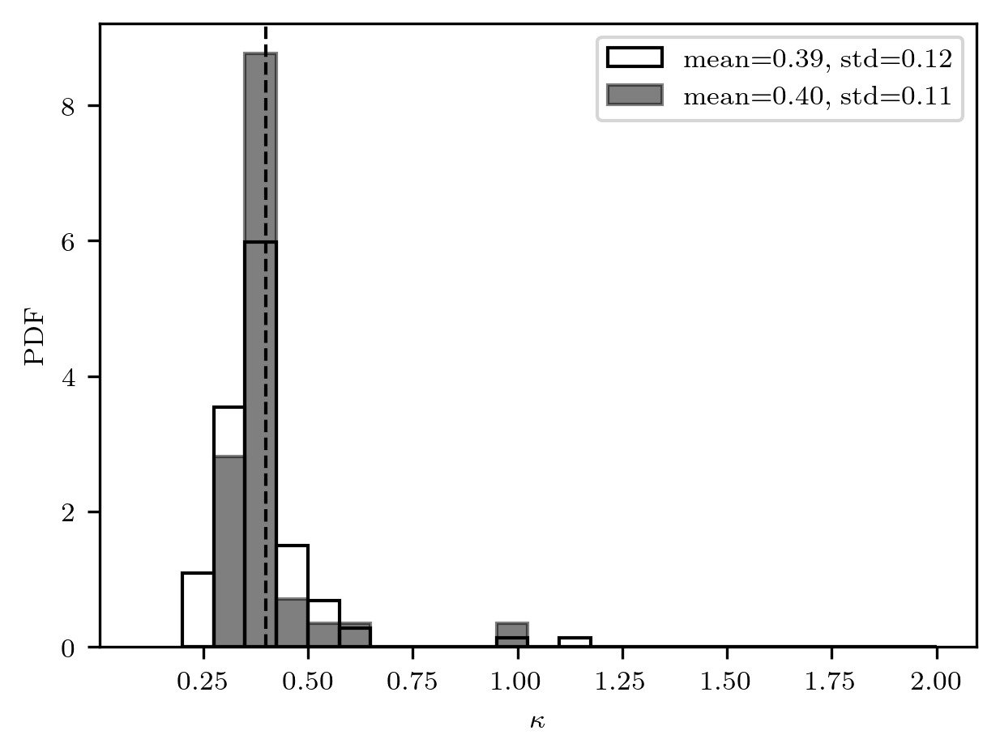

In [31]:
text_loc = [0.12, 0.88]
font_size = 8
mark_size = 5
fig, axes = plt.subplot_mosaic([['a']], constrained_layout=True)
fig.set_size_inches(4,3)
fig.set_dpi(300)
# label physical distance in and down:
trans = mtransforms.ScaledTranslation(-20/72, 7/72, fig.dpi_scale_trans)

def plot_pdf_kappa(fig_lbl,ax_):
    # A1_filt = fit_data_vars['var1D_ustd']['filt']['A1_fit']
    sample1 = kappa_filt[mask]
    sample2 = kappa_filt[mask*mask_ist_wspd]
    sample3 = kappa_filt[mask*mask_re]
    sns.distplot(sample1, hist=True, kde=True,
             bins=24, color = 'black', 
             hist_kws={'edgecolor':'black', 'linewidth': 1,"range": [0.2,2],'facecolor':'none','alpha':1},
             kde_kws={'linewidth': 0}, 
             label='mean={:.2f}, std={:.2f}'.format(np.nanmean(sample1), np.nanstd(sample1)),
             ax=ax_)
    sns.distplot(sample3, hist=True, kde=True,
             bins=24, color='k', 
             hist_kws={'edgecolor':'black', 'linewidth': 1,"range": [0.2,2],'alpha':0.5},
             kde_kws={'linewidth': 0}, 
             label='mean={:.2f}, std={:.2f}'.format(np.nanmean(sample3), np.nanstd(sample3)),
             ax=ax_)
    ax_.legend(fontsize=font_size, loc = 'upper right')
    # ax_.set_xlim(0.2,0.6)
    # ax_.set_ylim(0,1)
    ax_.set_xlabel(r'$\kappa$', fontsize = font_size)
    ax_.set_ylabel(r'PDF', fontsize = font_size)
    ax_.axvline(x=0.4, color='k', linestyle='--', linewidth=1)
    # ax_.set_title('6th to 11th')
    # ax_.text(text_loc[0], text_loc[1], fig_lbl, transform=ax_.transAxes + trans,
    #         fontsize=font_size, zorder=2, 
    #         bbox={'facecolor': 'white', 'edgecolor': 'none', 'pad': 1})

plot_pdf_kappa('(a)',axes['a'])
plt.savefig(OUT_PLOT_DIR+'PDF_filtered_kappa_filt.jpg',dpi=400, bbox_inches='tight')

# Plot PDF of wind direction

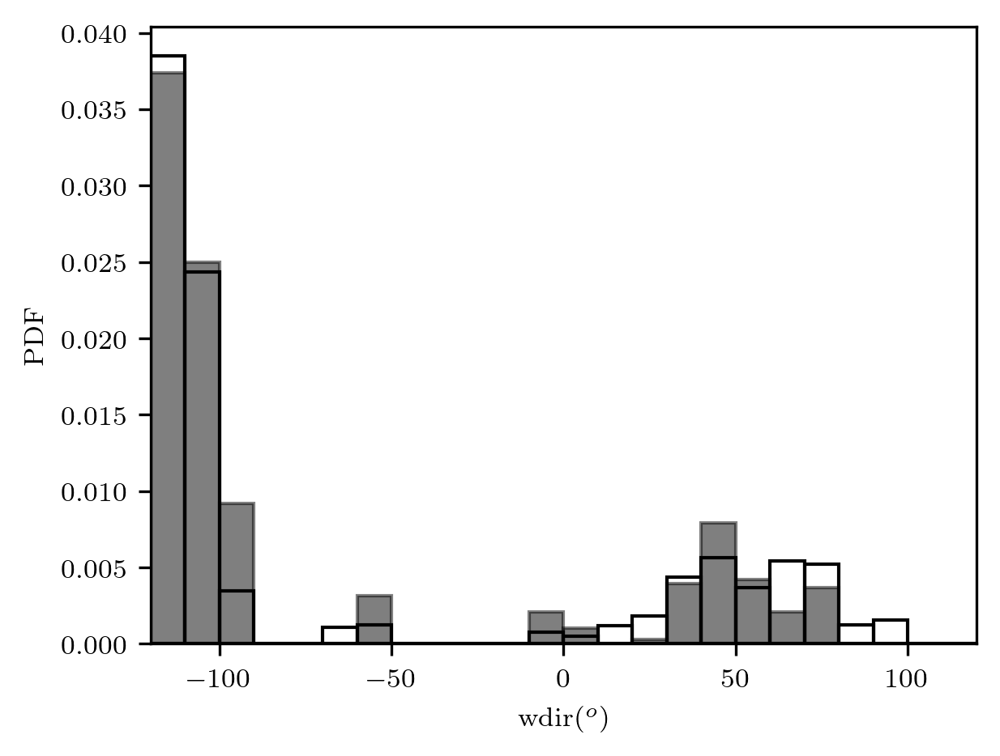

In [71]:
text_loc = [0.12, 0.88]
font_size = 8
mark_size = 5
fig, axes = plt.subplot_mosaic([['a']], constrained_layout=True)
fig.set_size_inches(4,3)
fig.set_dpi(300)
# label physical distance in and down:
trans = mtransforms.ScaledTranslation(-20/72, 7/72, fig.dpi_scale_trans)

def plot_pdf_wdir(fig_lbl,ax_):
    # wdir_filt = fit_data_vars['var1D_ustd']['filt']['A1_fit']
    wdir_filt = fit_data_vars['var2D_ustd']['filt']['wind_ang_convert']
    sample1 = wdir_filt[mask]
    sample2 = wdir_filt[mask*mask_ist_wspd]
    sample3 = wdir_filt[mask*mask_ist_wspd*mask_re]
    sns.distplot(sample1, hist=True, kde=True,
             bins=24, color = 'black', 
             hist_kws={'edgecolor':'black', 'linewidth': 1,"range": [-120,120],'facecolor':'none','alpha':1},
             kde_kws={'linewidth': 0}, 
             label='mean={:.2f}, std={:.2f}'.format(np.nanmean(sample1), np.nanstd(sample1)),
             ax=ax_)
    # sns.distplot(sample2, hist=True, kde=True,
    #          bins=24, color='red', 
    #          hist_kws={'edgecolor':'black',"range": [-120,120],'alpha':0.5},
    #          kde_kws={'linewidth': 0}, 
    #          label='mean={:.2f}, std={:.2f}'.format(np.nanmean(sample2), np.nanstd(sample2)),
    #          ax=ax_)
    sns.distplot(sample3, hist=True, kde=True,
             bins=24, color='k', 
             hist_kws={'edgecolor':'black', 'linewidth': 1,"range": [-120,120],'alpha':0.5},
             kde_kws={'linewidth': 0}, 
             label='mean={:.2f}, std={:.2f}'.format(np.nanmean(sample3), np.nanstd(sample3)),
             ax=ax_)

    # ax_.legend(fontsize=font_size, loc = 'upper right')
    ax_.set_xlim(-120,120)
    # ax_.set_ylim(0,1)
    ax_.set_xlabel(r'wdir$(^o)$', fontsize = font_size)
    ax_.set_ylabel(r'PDF', fontsize = font_size)
    # ax_.axvline(x=1.25, color='k', linestyle='--', linewidth=1)
    # ax_.set_title('6th to 11th')
    # ax_.text(text_loc[0], text_loc[1], fig_lbl, transform=ax_.transAxes + trans,
    #         fontsize=font_size, zorder=2, 
    #         bbox={'facecolor': 'white', 'edgecolor': 'none', 'pad': 1})


plot_pdf_wdir('(a)',axes['a'])
# plt.savefig(OUT_PLOT_DIR+'PDF_filtered_wdir.jpg',dpi=400, bbox_inches='tight')

# Plot PDF of A1 and wspd filtered by R2

number of hours: 30


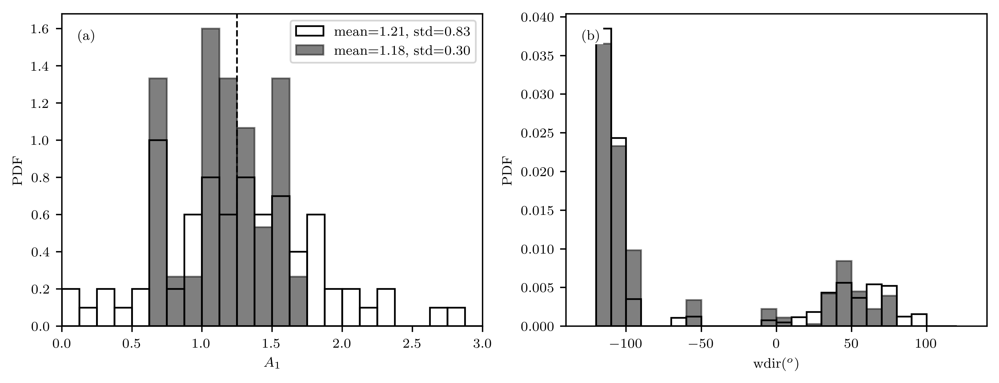

In [73]:
mask_r2 = R2_A1_filt>0.6
mask_temp = mask*mask_ist_wspd*mask_re*mask_r2
print(f"number of hours: {np.sum(mask_temp)}")

text_loc = [0.12, 0.88]
font_size = 8
mark_size = 5
fig, axes = plt.subplot_mosaic([['a','b']], constrained_layout=True)
fig.set_size_inches(8,3)
fig.set_dpi(400)
# label physical distance in and down:
trans = mtransforms.ScaledTranslation(-20/72, 7/72, fig.dpi_scale_trans)

def plot_pdf_A1_masked(mask1_,mask2_,fig_lbl,ax_):
    # A1_filt = fit_data_vars['var1D_ustd']['filt']['A1_fit']
    # sample1 = A1_filt[mask]
    # sample2 = A1_filt[mask*mask_ist_wspd]
    sample3 = A1_filt[mask1_]
    sample4 = A1_filt[mask2_]
    sns.distplot(sample3, hist=True, kde=True,
             bins=24, color='k', 
             hist_kws={'edgecolor':'black',"range": [0,3],'facecolor':'none','alpha':1},
             kde_kws={'linewidth': 0}, 
             label='mean={:.2f}, std={:.2f}'.format(np.nanmean(sample3), np.nanstd(sample3)),
             ax=ax_)
    sns.distplot(sample4, hist=True, kde=True,
             bins=24, color='k', 
             hist_kws={'edgecolor':'black',"range": [0,3],'alpha':0.5},
             kde_kws={'linewidth': 0}, 
             label='mean={:.2f}, std={:.2f}'.format(np.nanmean(sample4), np.nanstd(sample4)),
             ax=ax_)
    # info = ['mean={:.2f}, std={:.2f}'.format(np.nanmean(sample1), np.nanstd(sample1))+'\n\n'+ 
    #         'mean={:.2f}, std={:.2f}'.format(np.nanmean(sample2), np.nanstd(sample2))+'\n\n'+ 
    #         'mean={:.2f}, std={:.2f}'.format(np.nanmean(sample3), np.nanstd(sample3))+'\n\n']
    # ax_.annotate(info, xy=(0.8,0.9),xycoords='axes fraction',
    #          fontsize=font_size)
    ax_.legend(fontsize=font_size)
    ax_.set_xlim(0,3)
    # ax_.set_ylim(0,1)
    ax_.set_xlabel(r'$A_1$', fontsize = font_size)
    ax_.set_ylabel(r'PDF', fontsize = font_size)
    ax_.axvline(x=1.25, color='k', linestyle='--', linewidth=1)
    # ax_.set_title('6th to 11th')
    ax_.text(text_loc[0], text_loc[1], fig_lbl, transform=ax_.transAxes + trans,
            fontsize=font_size, zorder=2, 
            bbox={'facecolor': 'white', 'edgecolor': 'none', 'pad': 1})
    
def plot_pdf_wdir_masked(mask1_,mask2_,fig_lbl,ax_):
    # wdir_filt = fit_data_vars['var1D_ustd']['filt']['A1_fit']
    wdir_filt = fit_data_vars['var2D_ustd']['filt']['wind_ang_convert']
    # sample1 = wdir_filt[mask]
    # sample2 = wdir_filt[mask*mask_ist_wspd]
    sample3 = wdir_filt[mask1_]
    sample4 = wdir_filt[mask2_]
    sns.distplot(sample3, hist=True, kde=True,
             bins=24, color='k', 
             hist_kws={'edgecolor':'black',"range": [-120,120],'facecolor':'none','alpha':1},
             kde_kws={'linewidth': 0}, 
             label='mean={:.2f}, std={:.2f}'.format(np.nanmean(sample3), np.nanstd(sample3)),
             ax=ax_)
    sns.distplot(sample4, hist=True, kde=True,
             bins=24, color='k', 
             hist_kws={'edgecolor':'black',"range": [-120,120],'alpha':0.5},
             kde_kws={'linewidth': 0}, 
             label='mean={:.2f}, std={:.2f}'.format(np.nanmean(sample4), np.nanstd(sample4)),
             ax=ax_)

    # ax_.legend(fontsize=font_size, loc = 'upper right')
    ax_.set_xlim(-140,140)
    # ax_.set_ylim(0,1)
    ax_.set_xlabel(r'wdir$(^o)$', fontsize = font_size)
    ax_.set_ylabel(r'PDF', fontsize = font_size)
    # ax_.axvline(x=1.25, color='k', linestyle='--', linewidth=1)
    # ax_.set_title('6th to 11th')
    ax_.text(text_loc[0], text_loc[1], fig_lbl, transform=ax_.transAxes + trans,
            fontsize=font_size, zorder=2, 
            bbox={'facecolor': 'white', 'edgecolor': 'none', 'pad': 1})


plot_pdf_A1_masked(mask, mask*mask_ist_wspd*mask_re*mask_r2,'(a)',axes['a'])
plot_pdf_wdir_masked(mask, mask*mask_ist_wspd*mask_re*mask_r2,'(b)',axes['b'])

# Adjust spacing
fig.subplots_adjust(wspace=0.3)  # Adjust the width space between subplots

# plt.savefig(OUT_PLOT_DIR+'PDF_r2_filtered_A1_wdir.jpg',dpi=400, bbox_inches='tight')

# Correlation between r^2 and w_std

In [36]:
var_names = [r'$R^2$', r'$|\sigma_w-\overline{\sigma_w}|/\overline{\sigma_w}$']
data = pd.DataFrame({
    var_names[0]: R2_A1_filt[mask_temp],
    var_names[1]: score_w_std_filt[mask_temp],
})
corr_matrix = data.corr()

In [37]:
corr_matrix

,$R^2$,$|\sigma_w-\overline{\sigma_w}|/\overline{\sigma_w}$
$R^2$,1.000000,0.099397
$|\sigma_w-\overline{\sigma_w}|/\overline{\sigma_w}$,0.099397,1.000000


# Correlation between H and Re_b

In [90]:
var_names = [r'$H$', r'$Re_b$']
data = pd.DataFrame({
    var_names[0]: abs(H_avg_filt)[mask],
    var_names[1]: Re_b[mask],
})
corr_matrix = data.corr()
corr_matrix

,$H$,$Re_b$
$H$,1.000000,0.646666
$Re_b$,0.646666,1.000000


# Plot w_std profile to define hours with constant w_std

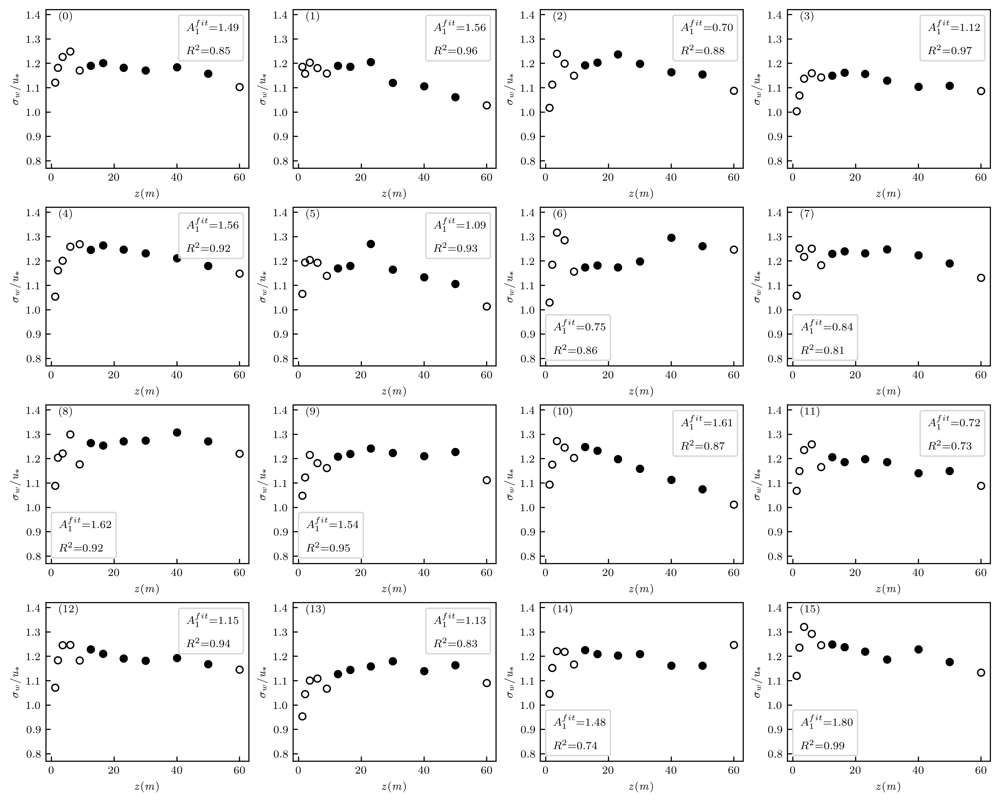

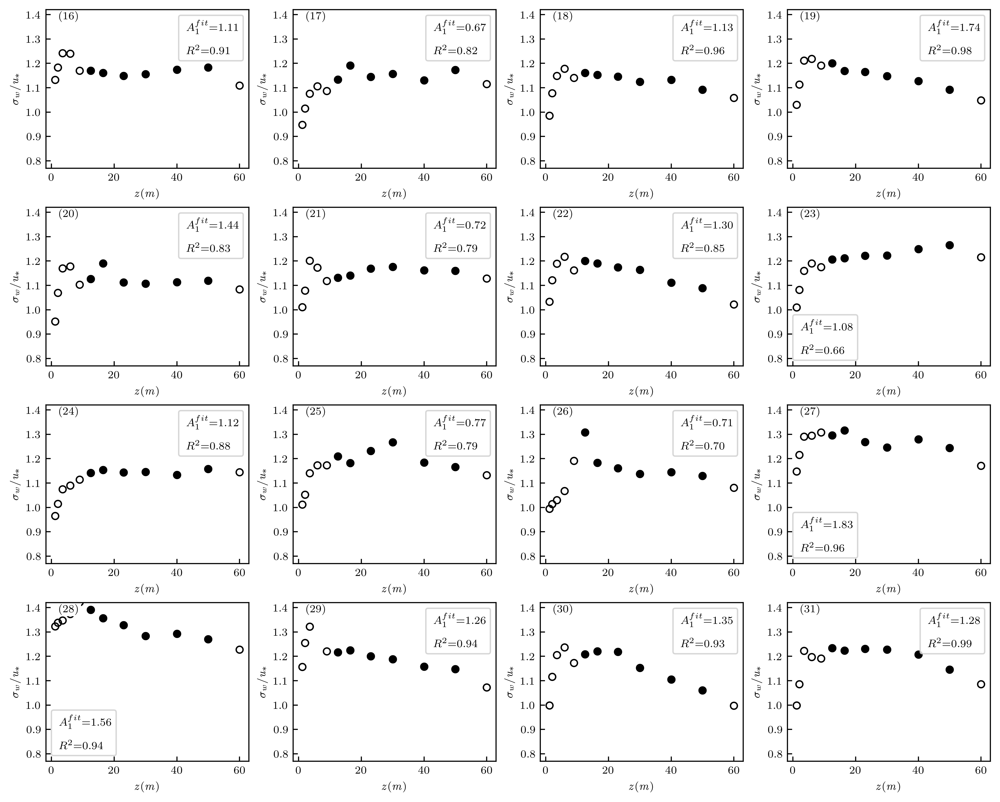

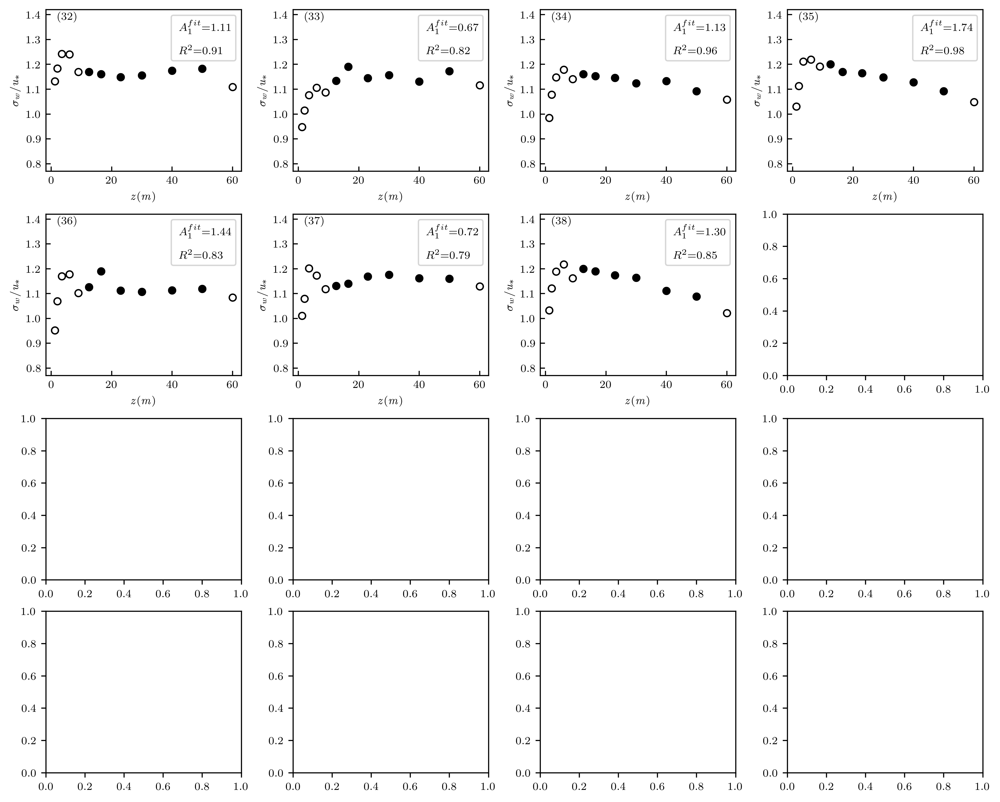

In [68]:
mask_r2 = R2_A1_filt>0.6
mask_temp = mask*mask_ist_wspd*mask_re*mask_r2
Indices = np.where(mask_temp)[0]

w_std_plus = w_std_filt/fit_data_vars['var1D_uavg']['filt']['u_star_mean'][:,None]

text_loc = [0.2, 0.88]
font_size = 8
mark_size = 5

def plot_w_std_prof(fig_lbl,ax_,index):
    # w_std = globals()[f"w_std_{type_}"]
    # w_std_plus = w_std/fit_data_vars['var1D_uavg'][type_]['u_star_mean']
    # plot w_std
    ax_.plot(z[list_all], w_std_plus[index,list_all],'o',color = 'k',markerfacecolor='none', markersize=mark_size)
    ax_.plot(z[list_sel],w_std_plus[index,list_sel],
             'o',color = 'k',markerfacecolor='k', markersize=mark_size)
    ax_.set_xlabel(r'$\it z (m)$',fontsize=font_size)
    ax_.set_ylabel(r'$\it \sigma_w/u_*$',fontsize=font_size)
    ax_.set_ylim(0.77, 1.42)
    # Adjust x-axis ticks to point inward
    ax_.tick_params(axis='x', direction='in',labelsize=font_size)
    ax_.tick_params(axis='y', direction='in',labelsize=font_size)
    
    info = [r'$A_1^{fit}$'+'={:.2f}'.format(A1_filt[index])+'\n\n'+\
            r'$R^2$'+'={:.2f}'.format(R2_A1_filt[index])
           ]
    ax_.legend(custom_lines, info,fontsize=font_size, handlelength=-0.5)
    ax_.text(text_loc[0], text_loc[1], fig_lbl, transform=ax_.transAxes + trans,
            fontsize=font_size, zorder=2, 
            bbox={'facecolor': 'white', 'edgecolor': 'none', 'pad': 1})


numbers_list = [f"({i})" for i in range(len(Indices))]
subplot = [['1', '2', '3', '4'],
         ['5', '6', '7', '8'],
         ['9', '10', '11', '12'],
         ['13', '14', '15', '16']]
fig, axes = plt.subplot_mosaic(subplot, constrained_layout=True)
trans = mtransforms.ScaledTranslation(-20/72, 7/72, fig.dpi_scale_trans)
fig.set_size_inches(10,8)
fig.set_dpi(400)
for i in range(16):
    plot_w_std_prof(numbers_list[i],axes[str(i+1)],Indices[i])
    
fig2, axes = plt.subplot_mosaic(subplot, constrained_layout=True)
trans = mtransforms.ScaledTranslation(-20/72, 7/72, fig2.dpi_scale_trans)
fig2.set_size_inches(10,8)
fig2.set_dpi(400)
for i in range(16):
    plot_w_std_prof(numbers_list[i+16],axes[str(i+1)],Indices[i+16])
    
fig3, axes = plt.subplot_mosaic(subplot, constrained_layout=True)
trans = mtransforms.ScaledTranslation(-20/72, 7/72, fig3.dpi_scale_trans)
fig3.set_size_inches(10,8)
fig3.set_dpi(400)
for i in range(7):
    plot_w_std_prof(numbers_list[i+32],axes[str(i+1)],Indices[i+16])

In [52]:
# Specified indices that corresponding to non-constant w_std hours among 
# the 39 hours after filtering by mask_ist_wspd,mask_re,mask_r2
specified_indices = np.array([1,2,5,6,10,20,22,23,25,26,28,30,33,35,36,38])

# Create a boolean array based on the condition
mask_const_wstd = np.ones(mask_temp.shape, dtype=bool)
Indices = np.where(mask_temp)[0]
mask_const_wstd[Indices[specified_indices]] = False

len_const_wstd = np.sum(mask*mask_ist_wspd*mask_re*mask_r2*mask_const_wstd)
print(len_const_wstd)

23


# Plot PDF of A1 and wspd filterd by constant w_std

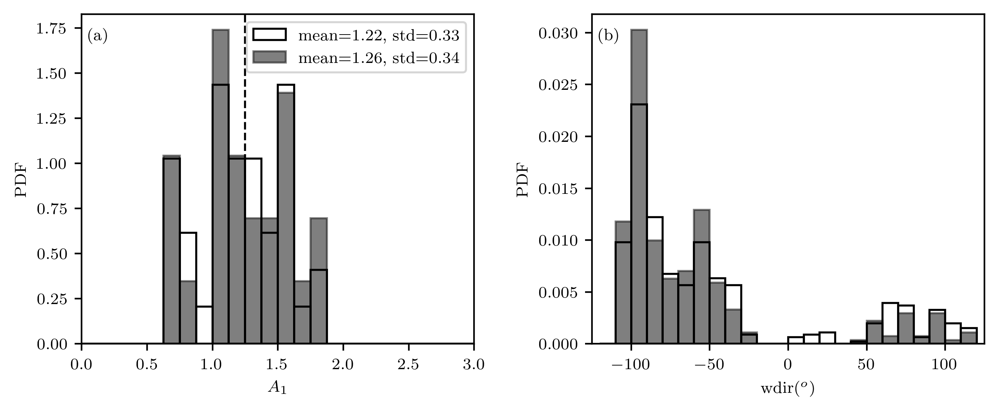

In [53]:
text_loc = [0.12, 0.88]
font_size = 8
mark_size = 5
fig, axes = plt.subplot_mosaic([['a','b']], constrained_layout=True)
fig.set_size_inches(8,3)
fig.set_dpi(400)
# label physical distance in and down:
trans = mtransforms.ScaledTranslation(-20/72, 7/72, fig.dpi_scale_trans)

mask1 = mask*mask_ist_wspd*mask_re*mask_r2
mask2 = mask*mask_ist_wspd*mask_re*mask_r2*mask_const_wstd
plot_pdf_A1_masked(mask1,mask2,'(a)',axes['a'])
plot_pdf_wdir_masked(mask1,mask2,'(b)',axes['b'])

# Adjust spacing
fig.subplots_adjust(wspace=0.3)  # Adjust the width space between subplots

# plt.savefig(OUT_PLOT_DIR+'PDF_wstd_filtered_A1_wdir.jpg',dpi=400, bbox_inches='tight')

# ** Plot corr heatmap and A1 against Re

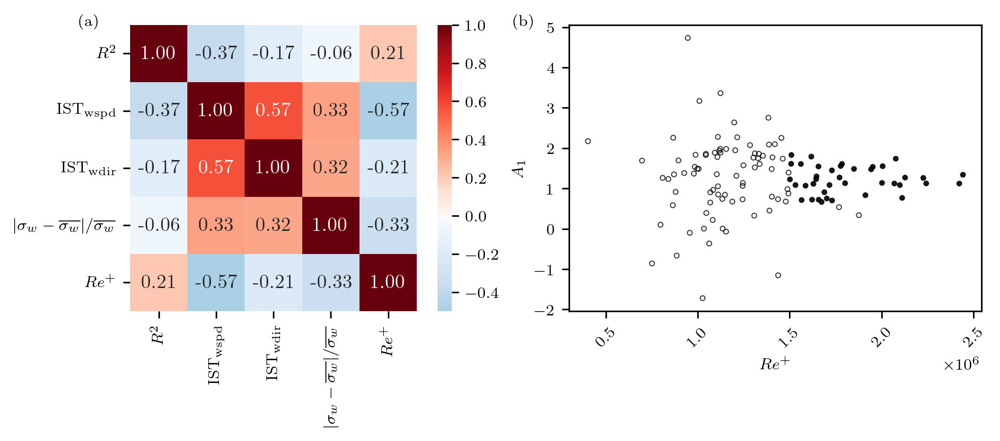

In [34]:
def create_colormap(vmin, vmax):
    """
    Adjust the bluered color map so that vmin will be lighter than vmax if abs(vmin) is smaller,
    and ensure that the color intensity is the same when abs(vmin) equals abs(vmax).
    """
    if abs(vmin) == abs(vmax):
        # If abs(vmin) equals abs(vmax), the colormap should transition smoothly from blue to red
        colors = np.vstack((
            plt.cm.Blues_r(np.linspace(0.0, 1.0, 128)),  # Dark to light blue
            plt.cm.Reds(np.linspace(0.0, 1.0, 128))     # Light to dark red
        ))
    else:
        # Calculate the proportion of the colorbar that should be blue
        negative_proportion = abs(vmin) / (abs(vmax) + abs(vmin))
        positive_proportion = 1 - negative_proportion
        
        # Define the starting point for the Reds and Blues_r to match the intensity
        blue_start = 1 - negative_proportion  # Start from the lightest blue
        red_start = 0.0  # Start from a lighter red to match the blue intensity
        
        # Sample colors from the Blues_r and Reds colormaps
        blues = plt.cm.Blues_r(np.linspace(blue_start, 1.0, int(256 * negative_proportion)))  # Light to dark blue
        whites = np.array([[1.0, 1.0, 1.0, 1.0]])  # Pure white color
        reds = plt.cm.Reds(np.linspace(red_start, 1.0, int(256 * positive_proportion)))  # Light to dark red
        
        # Combine them into a single array
        colors = np.vstack((blues, whites, reds))
    
    # Create a new colormap
    cmap = LinearSegmentedColormap.from_list('CustomBluesReds', colors)
    
    return cmap

var_names = [r'$R^2$', r'$\mathrm{IST_{wspd}}$', r'$\mathrm{IST_{wdir}}$', 
             r'$|\sigma_w-\overline{\sigma_w}|/\overline{\sigma_w}$', 
             r'$|H| (W/m^2)$', r'${Re}^+$']
text_loc = [-0.04, 0.95]
font_size = 8
mark_size = 6
line_width = 0.5
vmin, vmax = -0.5,1
fig, axes = plt.subplot_mosaic([['a','b']], constrained_layout=True)
fig.set_size_inches(7,3)
fig.set_dpi(300)
trans = mtransforms.ScaledTranslation(-20/72, 7/72, fig.dpi_scale_trans)
def plot_corr_heatmap(mask_,fig_lbl,ax_):
    data = pd.DataFrame({
            var_names[0]: R2_A1_filt[mask_],
            var_names[1]: IST_u_filt[mask_],
            var_names[2]: IST_wdir_filt[mask_],
            var_names[3]: score_w_std_filt[mask_],
            # var_names[4]: abs(H_avg_filt[mask_]),
            var_names[5]: Re_plus_mean_filt[mask_]
                        })
    corr_matrix = data.corr()
    # custom_cmap = create_custom_colormap(vmin, vmax)
    custom_cmap = create_colormap(vmin, vmax)
    sns.heatmap(corr_matrix, annot=True, fmt=".2f", cmap=custom_cmap, cbar=True, square=True, 
            xticklabels=corr_matrix.columns, yticklabels=corr_matrix.columns, ax=ax_, vmin=vmin, vmax=vmax)
    ax_.text(text_loc[0], text_loc[1], fig_lbl, transform=ax_.transAxes + trans,
                fontsize=font_size, zorder=2, 
                bbox={'facecolor': 'white', 'edgecolor': 'none', 'pad': 1})
    plt.xticks(rotation=45)  # Rotate xticklabels by 45 degrees

# plot_corr_heatmap(mask,'(a)', axes['a'])
plot_corr_heatmap(mask,'(a)', axes['a'])   

# fig, axes = plt.subplot_mosaic([['a']], constrained_layout=True)
# fig.set_size_inches(3,2.5)
# fig.set_dpi(300)
# label physical distance in and down:
# trans = mtransforms.ScaledTranslation(-20/72, 7/72, fig.dpi_scale_trans)

def plot_fig_label(x_var,fig_lbl,ax_):
    ax_.scatter(x_var[mask],y_temp[mask], alpha=0.8, label='Original Data', s=mark_size,
                  edgecolors='black', facecolors='none', linewidths=line_width)
    ax_.scatter(x_var[mask*mask_re*mask_r2],y_temp[mask*mask_re*mask_r2], s=mark_size, 
                color='k', alpha=0.9, label=r'Filtered Data ($\overline{{Re}^+}>1.5*10^6$)', edgecolors='none')
    ax_.set_ylabel(r'$A_1$', fontsize=font_size)
    ax_.text(text_loc[0], text_loc[1], fig_lbl, transform=ax_.transAxes + trans,
                fontsize=font_size, zorder=2, 
                bbox={'facecolor': 'white', 'edgecolor': 'none', 'pad': 1})
    

y_temp = A1_filt
# axes['a'].plot(R2_A1_filt[mask],y_temp[mask],'.',color = 'k',markersize=mark_size)
axes['b'].set_xlabel(r'${{Re}^+}$', fontsize=font_size)
# axes['a'].set_ylabel(r'$|A_1-1.25|/1.25$', fontsize=font_size)
plot_fig_label(Re_plus_mean_filt,'(b)', axes['b'])
# plt.savefig(OUT_PLOT_DIR+'cor_heatmap_A1_vs_Re.jpg',dpi=400, bbox_inches='tight')

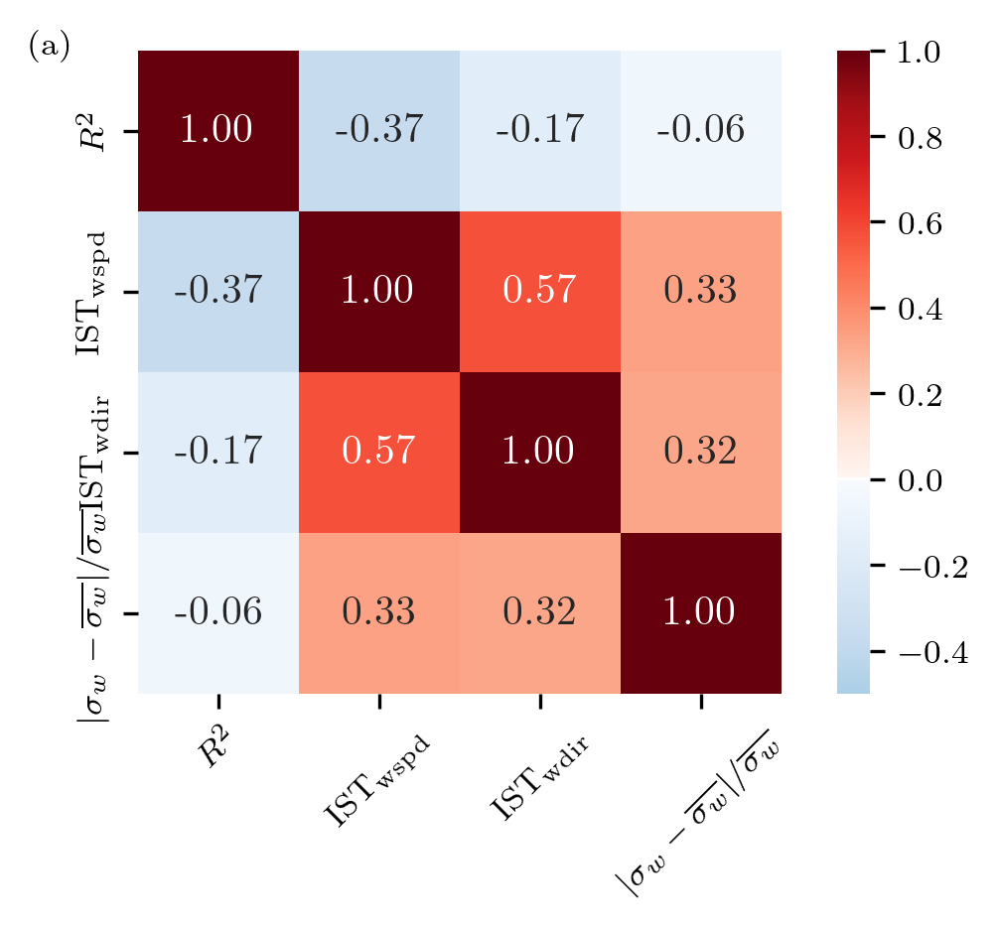

In [44]:
def create_colormap(vmin, vmax):
    """
    Adjust the bluered color map so that vmin will be lighter than vmax if abs(vmin) is smaller,
    and ensure that the color intensity is the same when abs(vmin) equals abs(vmax).
    """
    if abs(vmin) == abs(vmax):
        # If abs(vmin) equals abs(vmax), the colormap should transition smoothly from blue to red
        colors = np.vstack((
            plt.cm.Blues_r(np.linspace(0.0, 1.0, 128)),  # Dark to light blue
            plt.cm.Reds(np.linspace(0.0, 1.0, 128))     # Light to dark red
        ))
    else:
        # Calculate the proportion of the colorbar that should be blue
        negative_proportion = abs(vmin) / (abs(vmax) + abs(vmin))
        positive_proportion = 1 - negative_proportion
        
        # Define the starting point for the Reds and Blues_r to match the intensity
        blue_start = 1 - negative_proportion  # Start from the lightest blue
        red_start = 0.0  # Start from a lighter red to match the blue intensity
        
        # Sample colors from the Blues_r and Reds colormaps
        blues = plt.cm.Blues_r(np.linspace(blue_start, 1.0, int(256 * negative_proportion)))  # Light to dark blue
        whites = np.array([[1.0, 1.0, 1.0, 1.0]])  # Pure white color
        reds = plt.cm.Reds(np.linspace(red_start, 1.0, int(256 * positive_proportion)))  # Light to dark red
        
        # Combine them into a single array
        colors = np.vstack((blues, whites, reds))
    
    # Create a new colormap
    cmap = LinearSegmentedColormap.from_list('CustomBluesReds', colors)
    
    return cmap

var_names = [r'$R^2$', r'$\mathrm{IST_{wspd}}$', r'$\mathrm{IST_{wdir}}$', 
             r'$|\sigma_w-\overline{\sigma_w}|/\overline{\sigma_w}$', 
             r'$|H| (W/m^2)$']
text_loc = [-0.04, 0.95]
font_size = 8
mark_size = 6
line_width = 0.5
vmin, vmax = -0.5,1
fig, axes = plt.subplot_mosaic([['a']], constrained_layout=True)
fig.set_size_inches(4,3)
fig.set_dpi(300)
trans = mtransforms.ScaledTranslation(-20/72, 7/72, fig.dpi_scale_trans)
def plot_corr_heatmap(mask_,fig_lbl,ax_):
    data = pd.DataFrame({
            var_names[0]: R2_A1_filt[mask_],
            var_names[1]: IST_u_filt[mask_],
            var_names[2]: IST_wdir_filt[mask_],
            var_names[3]: score_w_std_filt[mask_],
            # var_names[4]: abs(H_avg_filt[mask_]),
            # var_names[5]: Re_plus_mean_filt[mask_]
                        })
    corr_matrix = data.corr()
    # custom_cmap = create_custom_colormap(vmin, vmax)
    custom_cmap = create_colormap(vmin, vmax)
    sns.heatmap(corr_matrix, annot=True, fmt=".2f", cmap=custom_cmap, cbar=True, square=True, 
            xticklabels=corr_matrix.columns, yticklabels=corr_matrix.columns, ax=ax_, vmin=vmin, vmax=vmax, 
               # cbar_kws={"shrink": 0.6}
               )
    ax_.text(text_loc[0], text_loc[1], fig_lbl, transform=ax_.transAxes + trans,
                fontsize=font_size, zorder=2, 
                bbox={'facecolor': 'white', 'edgecolor': 'none', 'pad': 1})
    plt.xticks(rotation=45)  # Rotate xticklabels by 45 degrees

# plot_corr_heatmap(mask,'(a)', axes['a'])
plot_corr_heatmap(mask,'(a)', axes['a'])   

## **** Re_b

In [350]:
mask_Re_b = Re_b>4e7
np.sum(mask*mask_Re_b*mask_r2)

33

In [351]:
mask1 = mask*mask_Re_b*mask_r2
mask2 = mask*mask_re*mask_r2

# Check if B is True where A is True
result = np.all(np.logical_or(np.logical_not(mask1), mask2))

print("B is True where A is True:", result)

B is True where A is True: False


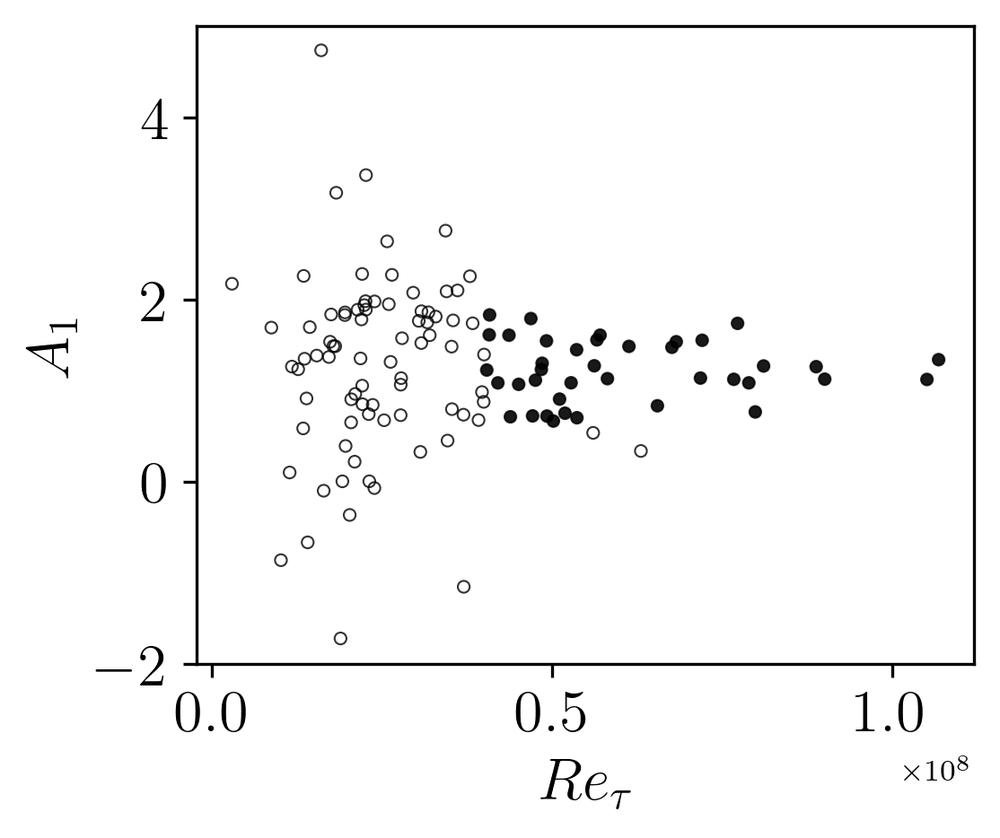

In [171]:
def plot_fig_label(x_var,fig_lbl,ax_):
    ax_.scatter(x_var[mask],y_temp[mask], alpha=0.8, label='Original Data', s=mark_size,
                  edgecolors='black', facecolors='none', linewidths=line_width)
    ax_.scatter(x_var[mask*mask_re*mask_r2],y_temp[mask*mask_re*mask_r2], s=mark_size, 
                color='k', alpha=0.9, label=r'Filtered Data', edgecolors='none')
    # Adding a curve for Re_b vs A_1
    sorted_indices = np.argsort(x_var[mask])  # Sort data based on Re_b
    sorted_x = x_var[mask][sorted_indices]
    # sorted_y = A_1[mask][sorted_indices]
    sorted_y = np.full_like(sorted_x, C_1) # create an array of the same length as sorted_x with this constant value.
    # sorted_y_kappa = A_1_kappa[mask][sorted_indices]
    # sorted_indices2 = np.argsort(Re_b_sort)  # Sort data based on Re_b
    # sorted_x2 = Re_b_sort[sorted_indices2]
    # sorted_y2 = Euu_95_mean_sort[sorted_indices2]
    # ax_.plot(sorted_x, sorted_y, '-', color='blue', label=r'Katul et al. (2016)', linewidth=line_width)  # Add curve
    # ax_.plot(sorted_x, np.full_like(sorted_x, 1.25), '-', color='red', label=r'1.25', linewidth=line_width)  # Add curve
    # ax_.plot(sorted_x2, sorted_y2, '-', color='red', label=r'$Re_b$ vs $C_1$', linewidth=line_width)  # Add curve
    ax_.set_ylabel(r'$A_1$', fontsize=font_size+2)
    ax_.tick_params(axis='both', labelsize=font_size+2)
    # ax_.text(text_loc[0], text_loc[1], fig_lbl, transform=ax_.transAxes + trans,
    #             fontsize=font_size+2, zorder=2, 
    #             bbox={'facecolor': 'white', 'edgecolor': 'none', 'pad': 1})
    ax_.set_ylim((-2,5))
    # ax_.legend(fontsize=font_size)

fig, axes = plt.subplot_mosaic([['a']], constrained_layout=True)
fig.set_size_inches(3.6,3)
fig.set_dpi(300)
font_size = 14
mark_size = 10
line_width = 0.5

y_temp = A1_filt
plot_fig_label(Re_b,'(a)', axes['a'])
axes['a'].set_xlabel(r'${{Re}_{\tau}}$', fontsize=font_size+2)
plt.savefig(OUT_PLOT_DIR+'graphic.jpg',dpi=300, bbox_inches='tight')

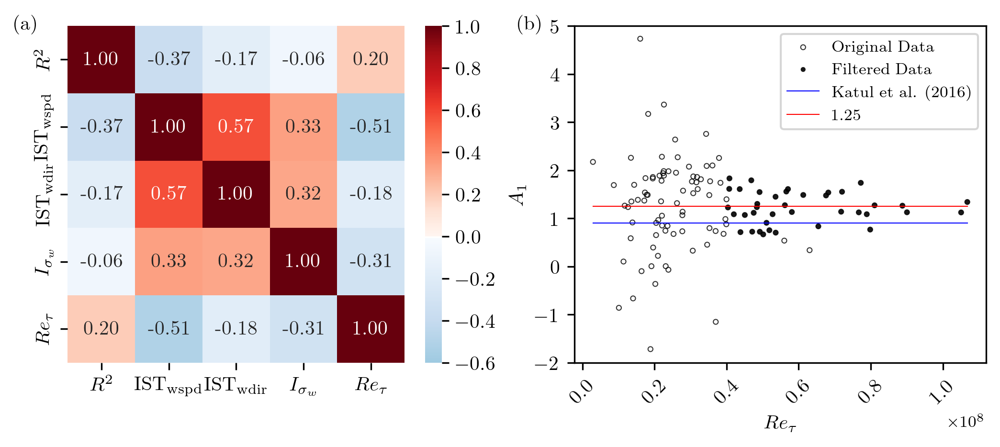

In [107]:
text_loc = [-0.04, 0.95]
font_size = 8
mark_size = 6
line_width = 0.5
vmin, vmax = -0.6,1
fig, axes = plt.subplot_mosaic([['a','b']], constrained_layout=True)

def create_colormap(vmin, vmax):
    """
    Adjust the bluered color map so that vmin will be lighter than vmax if abs(vmin) is smaller,
    and ensure that the color intensity is the same when abs(vmin) equals abs(vmax).
    """
    if abs(vmin) == abs(vmax):
        # If abs(vmin) equals abs(vmax), the colormap should transition smoothly from blue to red
        colors = np.vstack((
            plt.cm.Blues_r(np.linspace(0.0, 1.0, 128)),  # Dark to light blue
            plt.cm.Reds(np.linspace(0.0, 1.0, 128))     # Light to dark red
        ))
    else:
        # Calculate the proportion of the colorbar that should be blue
        negative_proportion = abs(vmin) / (abs(vmax) + abs(vmin))
        positive_proportion = 1 - negative_proportion
        
        # Define the starting point for the Reds and Blues_r to match the intensity
        blue_start = 1 - negative_proportion  # Start from the lightest blue
        red_start = 0.0  # Start from a lighter red to match the blue intensity
        
        # Sample colors from the Blues_r and Reds colormaps
        blues = plt.cm.Blues_r(np.linspace(blue_start, 1.0, int(256 * negative_proportion)))  # Light to dark blue
        whites = np.array([[1.0, 1.0, 1.0, 1.0]])  # Pure white color
        reds = plt.cm.Reds(np.linspace(red_start, 1.0, int(256 * positive_proportion)))  # Light to dark red
        
        # Combine them into a single array
        colors = np.vstack((blues, whites, reds))
    
    # Create a new colormap
    cmap = LinearSegmentedColormap.from_list('CustomBluesReds', colors)
    
    return cmap

var_names = [r'$R^2$', r'$\mathrm{IST_{wspd}}$', r'$\mathrm{IST_{wdir}}$', 
             r'$I_{\sigma_w}$', 
             r'$|H| (W/m^2)$', r'${Re}_{\tau}$']
text_loc = [-0.04, 0.95]
font_size = 8
mark_size = 6
line_width = 0.5
vmin, vmax = -0.6,1
fig, axes = plt.subplot_mosaic([['a','b']], constrained_layout=True)
fig.set_size_inches(7,3)
fig.set_dpi(300)
trans = mtransforms.ScaledTranslation(-20/72, 7/72, fig.dpi_scale_trans)
def plot_corr_heatmap(mask_,fig_lbl,ax_):
    data = pd.DataFrame({
            var_names[0]: R2_A1_filt[mask_],
            var_names[1]: IST_u_filt[mask_],
            var_names[2]: IST_wdir_filt[mask_],
            var_names[3]: score_w_std_filt[mask_],
            # var_names[4]: abs(H_avg_filt[mask_]),
            var_names[5]: Re_b[mask_]
                        })
    corr_matrix = data.corr()
    # custom_cmap = create_custom_colormap(vmin, vmax)
    custom_cmap = create_colormap(vmin, vmax)
    heatmap = sns.heatmap(corr_matrix, annot=True, fmt=".2f", cmap=custom_cmap, cbar=True, square=True, 
            xticklabels=corr_matrix.columns, yticklabels=corr_matrix.columns, ax=ax_, vmin=vmin, vmax=vmax)
    cbar = heatmap.collections[0].colorbar
    cbar.ax.tick_params(labelsize=font_size+2)  # Adjust the colorbar tick label size
    ax_.text(text_loc[0], text_loc[1], fig_lbl, transform=ax_.transAxes + trans,
                fontsize=font_size+2, zorder=2, 
                bbox={'facecolor': 'white', 'edgecolor': 'none', 'pad': 1})
    ax_.tick_params(axis='both', labelsize=font_size+2)
    plt.xticks(rotation=45)  # Rotate xticklabels by 45 degrees

# plot_corr_heatmap(mask,'(a)', axes['a'])
plot_corr_heatmap(mask,'(a)', axes['a'])   

# fig, axes = plt.subplot_mosaic([['a']], constrained_layout=True)
# fig.set_size_inches(3,2.5)
# fig.set_dpi(300)
# label physical distance in and down:
# trans = mtransforms.ScaledTranslation(-20/72, 7/72, fig.dpi_scale_trans)

def plot_fig_label(x_var,fig_lbl,ax_):
    ax_.scatter(x_var[mask],y_temp[mask], alpha=0.8, label='Original Data', s=mark_size,
                  edgecolors='black', facecolors='none', linewidths=line_width)
    ax_.scatter(x_var[mask*mask_re*mask_r2],y_temp[mask*mask_re*mask_r2], s=mark_size, 
                color='k', alpha=0.9, label=r'Filtered Data', edgecolors='none')
    # Adding a curve for Re_b vs A_1
    sorted_indices = np.argsort(x_var[mask])  # Sort data based on Re_b
    sorted_x = x_var[mask][sorted_indices]
    # sorted_y = A_1[mask][sorted_indices]
    sorted_y = np.full_like(sorted_x, C_1) # create an array of the same length as sorted_x with this constant value.
    # sorted_y_kappa = A_1_kappa[mask][sorted_indices]
    # sorted_indices2 = np.argsort(Re_b_sort)  # Sort data based on Re_b
    # sorted_x2 = Re_b_sort[sorted_indices2]
    # sorted_y2 = Euu_95_mean_sort[sorted_indices2]
    ax_.plot(sorted_x, sorted_y, '-', color='blue', label=r'Katul et al. (2016)', linewidth=line_width)  # Add curve
    ax_.plot(sorted_x, np.full_like(sorted_x, 1.25), '-', color='red', label=r'1.25', linewidth=line_width)  # Add curve
    # ax_.plot(sorted_x2, sorted_y2, '-', color='red', label=r'$Re_b$ vs $C_1$', linewidth=line_width)  # Add curve
    ax_.set_ylabel(r'$A_1$', fontsize=font_size+2)
    ax_.tick_params(axis='both', labelsize=font_size+2)
    ax_.text(text_loc[0], text_loc[1], fig_lbl, transform=ax_.transAxes + trans,
                fontsize=font_size+2, zorder=2, 
                bbox={'facecolor': 'white', 'edgecolor': 'none', 'pad': 1})
    ax_.set_ylim((-2,5))
    ax_.legend(fontsize=font_size)

y_temp = A1_filt
axes['b'].set_xlabel(r'${{Re}_{\tau}}$', fontsize=font_size+2)
# axes['a'].set_ylabel(r'$|A_1-1.25|/1.25$', fontsize=font_size)
plot_fig_label(Re_b,'(b)', axes['b'])
plt.savefig(OUT_PLOT_DIR+'cor_heatmap_A1_vs_Re_b.jpg',dpi=400, bbox_inches='tight')

In [26]:
OUT_PLOT_DIR

'/projectnb/urbanclimate/yueqin/idaho_ec_jupyter/save_fig_2rot/'

# *** Compare statistics before and after quality control

In [439]:
data = {
    'A1_filt': A1_filt,
    'kappa_filt': kappa_filt,
    'R2_A1_filt': R2_A1_filt,
    'R2_kappa_filt': R2_kappa_filt,
    'IST_u_filt': IST_u_filt,
    'IST_wdir_filt': IST_wdir_filt,
    'score_w_std_filt': score_w_std_filt,
    'Re_plus_mean_filt': Re_plus_mean_filt,
    'H_avg_filt': abs(H_avg_filt),
    'wstd_ustar_filt': fit_data_vars['var1D_ustd']['filt']['slope_wstd_ustar'],
    'R2_B2_filt': fit_data_vars['var1D_ustd']['filt']['r2_wstd'],
    'Re_b': Re_b, 
}
df = pd.DataFrame(data)

#define masks
mask_before = mask
mask_after = mask*mask_re*mask_r2

# Initialize dictionaries to store results
mean_before = {}
mean_after = {}
std_before = {}
std_after = {}

# List of variables
variables = ['A1_filt', 'kappa_filt', 'R2_A1_filt','R2_kappa_filt', 'IST_u_filt', 'IST_wdir_filt', 
             'score_w_std_filt', 'Re_plus_mean_filt', 'H_avg_filt','wstd_ustar_filt','R2_B2_filt','Re_b']

# Calculate mean and std for each variable before and after applying the masks
for var in variables:
    mean_before[var] = df[var][mask_before].mean()
    mean_after[var] = df[var][mask_after].mean()
    std_before[var] = df[var][mask_before].std()
    std_after[var] = df[var][mask_after].std()

# Create DataFrames to display the results
mean_df = pd.DataFrame({'mean_before': mean_before, 'mean_after': mean_after})
std_df = pd.DataFrame({'std_before': std_before, 'std_after': std_after})

# # Display the results
# print("Mean Comparison")
# print(mean_df)
# print("\nStandard Deviation Comparison")
# print(std_df)

# Round the results to two decimal places
mean_df = mean_df.round(2)
std_df = std_df.round(2)

# Display the results
print("Mean Comparison")
print(mean_df)
print("\nStandard Deviation Comparison")
print(std_df)

Mean Comparison
                   mean_before   mean_after
A1_filt                   1.25         1.22
kappa_filt                0.37         0.38
R2_A1_filt                0.81         0.88
R2_kappa_filt             0.98         0.98
IST_u_filt                0.13         0.07
IST_wdir_filt             8.03         7.21
score_w_std_filt          0.03         0.02
Re_plus_mean_filt   1373907.54   1822637.89
H_avg_filt               29.69        56.45
wstd_ustar_filt           1.45         1.40
R2_B2_filt                0.99         1.00
Re_b               36590777.48  60629583.14

Standard Deviation Comparison
                    std_before    std_after
A1_filt                   0.84         0.33
kappa_filt                0.12         0.05
R2_A1_filt                0.23         0.08
R2_kappa_filt             0.02         0.01
IST_u_filt                0.11         0.04
IST_wdir_filt             5.74         3.48
score_w_std_filt          0.02         0.01
Re_plus_mean_filt    395963.5

# PDF of neutral hours and wind angles

In [450]:
np.sum(mask)

98

In [451]:
np.array(wind_ang_corrected_converted)[mask,6].min(),np.array(wind_ang_corrected_converted)[mask,6].max()

(-135.7140652333926, 79.99896489454562)

In [10]:
font_size

8

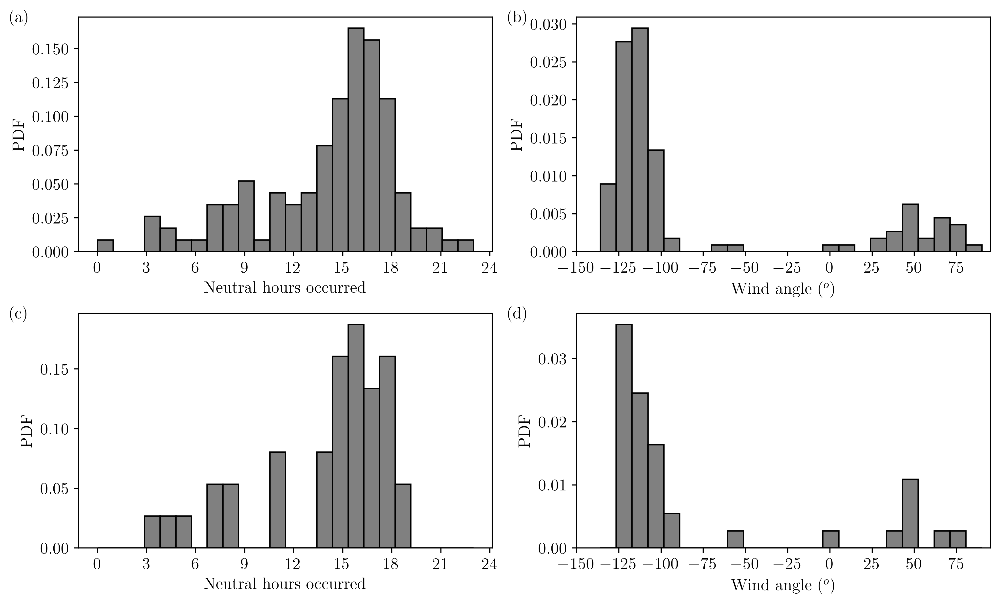

In [151]:
# fig = plt.figure(figsize=(10, 4), dpi=150,tight_layout=True)
# ax1 = fig.add_subplot(121)
fig, axes = plt.subplot_mosaic([['a','b'],['c','d']], constrained_layout=True)
fig.set_size_inches(10, 6)
fig.set_dpi(400)
text_loc = [-0.1, 0.92]
font_size = 12
# label physical distance in and down:
trans = mtransforms.ScaledTranslation(-20/72, 7/72, fig.dpi_scale_trans)

n1, bins1, patches1 = axes['a'].hist(np.array(datetime_all)[mask,1], density=True, facecolor = "gray",edgecolor="black",
                               range=(0,23),bins=24, label='I')  # arguments are passed to np.histogram
axes['a'].xaxis.set_major_locator(MaxNLocator(integer=True))
axes['a'].set_xlabel(r'\rm Neutral hours occurred', fontsize = font_size)
axes['a'].set_ylabel(r'\rm PDF', fontsize = font_size)
# plt.xticks(fontsize=font_size-4)
# plt.yticks(fontsize=font_size-4)

# n2, bins2, patches2 = axes['a'].hist(np.array(neutral_case)[msk1,1],density= True, facecolor = "orange",edgecolor="red",
#                                range=(0,23),bins=24, alpha=0.5, label='II')  # arguments are passed to np.histogram

# n3, bins3, patches3 = axes['a'].hist(np.array(neutral_case)[mask*mask_re*mask_r2,1],density= True,ls='dashed', facecolor = "none",edgecolor="black",
#                                range=(0,23),bins=24, alpha=1, label='II')  # arguments are passed to np.histogram
# axes['a'].xaxis.set_major_locator(MaxNLocator(integer=True))
# axes['a'].set_xlabel(r'\rm Neutral hours occurred', fontsize = font_size)
# axes['a'].set_ylabel(r'\rm Histogram', fontsize = font_size)
# axes['a'].legend(fontsize=12)
axes['a'].text(text_loc[0], text_loc[1], '(a)', transform=axes['a'].transAxes + trans,
                fontsize=font_size, va='bottom')
axes['a'].tick_params(axis='both', labelsize=font_size) 


n1, bins1, patches1 = axes['b'].hist(np.array(wind_ang_corrected_converted)[mask,6], density=True, facecolor = "gray",edgecolor="black",
                               range=(-136,90),bins=24, label='I')  # arguments are passed to np.histogram
# n2, bins2, patches2 = axes['b'].hist(np.array(wind_ang_neutral)[msk1*msk2,6],density= True, facecolor = "orange",edgecolor="red",
#                                range=(-120,120),bins=24, alpha=0.5, label='II')  # arguments are passed to np.histogram
# n3, bins3, patches3 = axes['b'].hist(np.array(wind_ang_neutral)[mask*mask_re*mask_r2,6],density= True,ls='dashed', facecolor = "none",edgecolor="black",
#                                range=(-120,120),bins=24, alpha=1, label='II')  # arguments are passed to np.histogram
axes['b'].xaxis.set_major_locator(MaxNLocator(integer=True))
axes['b'].set_xlabel(r'\rm Wind angle ($^o$)', fontsize = font_size)
axes['b'].set_ylabel(r'\rm PDF', fontsize = font_size)
axes['b'].text(text_loc[0], text_loc[1], '(b)', transform=axes['b'].transAxes + trans,
                fontsize=font_size, va='bottom')
axes['b'].set_xlim((-150,95))
axes['b'].tick_params(axis='both', labelsize=font_size) 

n1, bins1, patches1 = axes['c'].hist(np.array(datetime_all)[mask*mask_re*mask_r2,1], density=True, facecolor = "gray",edgecolor="black",
                               range=(0,23),bins=24, label='I')  # arguments are passed to np.histogram
axes['c'].xaxis.set_major_locator(MaxNLocator(integer=True))
axes['c'].set_xlabel(r'\rm Neutral hours occurred', fontsize = font_size)
axes['c'].set_ylabel(r'\rm PDF', fontsize = font_size)
# plt.xticks(fontsize=font_size-4)
# plt.yticks(fontsize=font_size-4)

# n2, bins2, patches2 = axes['a'].hist(np.array(neutral_case)[msk1,1],density= True, facecolor = "orange",edgecolor="red",
#                                range=(0,23),bins=24, alpha=0.5, label='II')  # arguments are passed to np.histogram

# n3, bins3, patches3 = axes['a'].hist(np.array(neutral_case)[mask*mask_re*mask_r2,1],density= True,ls='dashed', facecolor = "none",edgecolor="black",
#                                range=(0,23),bins=24, alpha=1, label='II')  # arguments are passed to np.histogram
# axes['a'].xaxis.set_major_locator(MaxNLocator(integer=True))
# axes['a'].set_xlabel(r'\rm Neutral hours occurred', fontsize = font_size)
# axes['a'].set_ylabel(r'\rm Histogram', fontsize = font_size)
# axes['a'].legend(fontsize=12)
axes['c'].text(text_loc[0], text_loc[1], '(c)', transform=axes['c'].transAxes + trans,
                fontsize=font_size, va='bottom')
axes['c'].tick_params(axis='both', labelsize=font_size) 

n1, bins1, patches1 = axes['d'].hist(np.array(wind_ang_corrected_converted)[mask*mask_re*mask_r2,6], density=True, facecolor = "gray",edgecolor="black",
                               range=(-136,90),bins=24, label='I')  # arguments are passed to np.histogram
# n2, bins2, patches2 = axes['b'].hist(np.array(wind_ang_neutral)[msk1*msk2,6],density= True, facecolor = "orange",edgecolor="red",
#                                range=(-120,120),bins=24, alpha=0.5, label='II')  # arguments are passed to np.histogram
# n3, bins3, patches3 = axes['b'].hist(np.array(wind_ang_neutral)[mask*mask_re*mask_r2,6],density= True,ls='dashed', facecolor = "none",edgecolor="black",
#                                range=(-120,120),bins=24, alpha=1, label='II')  # arguments are passed to np.histogram
axes['d'].xaxis.set_major_locator(MaxNLocator(integer=True))
axes['d'].set_xlabel(r'\rm Wind angle ($^o$)', fontsize = font_size)
axes['d'].set_ylabel(r'\rm PDF', fontsize = font_size)
axes['d'].text(text_loc[0], text_loc[1], '(d)', transform=axes['d'].transAxes + trans,
                fontsize=font_size, va='bottom')
axes['d'].set_xlim((-150,95))
axes['d'].tick_params(axis='both', labelsize=font_size) 

plt.savefig(OUT_PLOT_DIR + 'neutral_station_hour_hist.jpg', dpi=200)

# Plot A1, kappa against z/L

In [14]:
2.5*0.65

1.625

R^2 Score: 0.9110448558014796


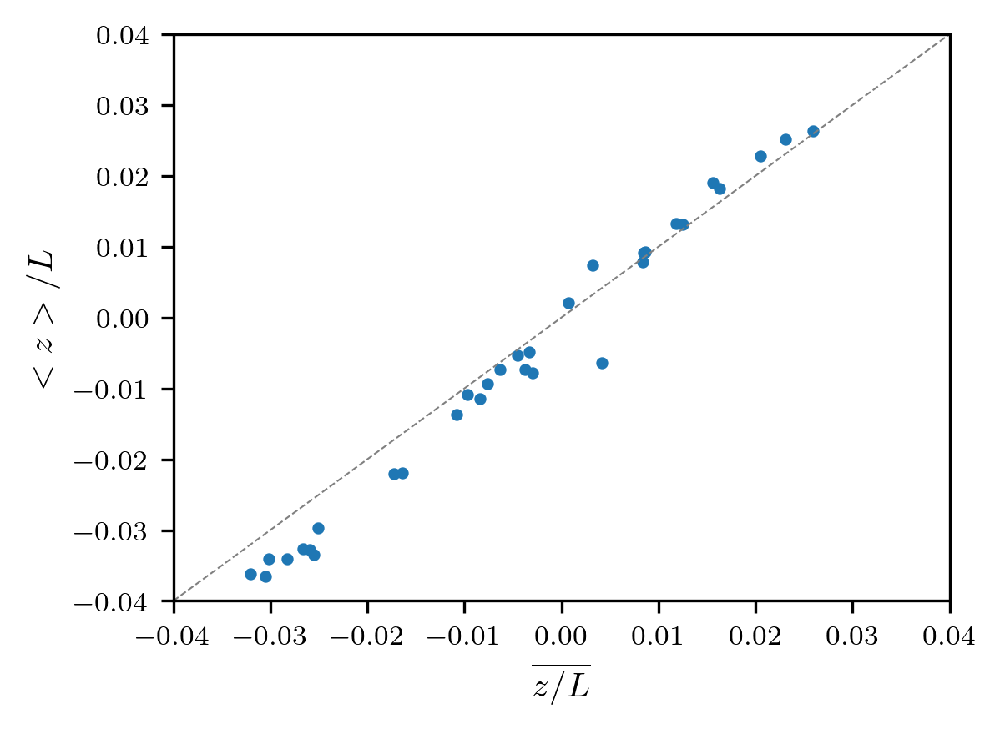

In [14]:
mask_all = mask*mask_re*mask_r2
font_size = 8
mark_size = 6
line_width = 0.5
fig=plt.figure()
fig.set_size_inches(4,3)
fig.set_dpi(300)
plt.scatter(mean_stability[mask_all],geomean_median_stability[mask_all], s=mark_size)
plt.xlabel('$\overline{z/L}$')
plt.ylabel('$<z>/L$')
plt.xlim(-0.04,0.04)
plt.ylim(-0.04,0.04)
plt.plot([-0.04,0.04], [-0.04,0.04],'--',color = 'gray',linewidth=line_width)
# Calculate R^2 score
r2 = r2_score(mean_stability[mask_all], geomean_median_stability[mask_all])
print("R^2 Score:", r2)

## ** combine A1 and kappa against z/L

In [87]:
geomean_median_stability[mask_all].min(),geomean_median_stability[mask_all].max()

(-0.055366799641517674, 0.026384550028962853)

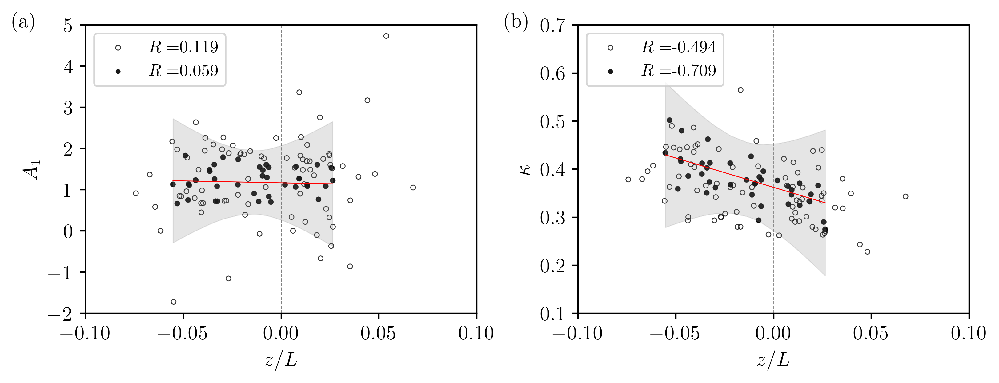

In [172]:
text_loc = [-0.1, 0.95]
font_size = 10
mark_size = 8
line_width = 0.5
fig, axes = plt.subplot_mosaic([['a','b']], constrained_layout=True)
fig.set_size_inches(8,3)
fig.set_dpi(400)
# label physical distance in and down:
trans = mtransforms.ScaledTranslation(-20/72, 7/72, fig.dpi_scale_trans)
mask_all = mask*mask_re*mask_r2
def plot_fig_label(x_var,fig_lbl,ax_):
    cor=np.corrcoef(x_var[mask*mask_temp*mask_y],y_temp[mask*mask_temp*mask_y])
    ax_.scatter(x_var[mask*mask_temp*mask_y],y_temp[mask*mask_temp*mask_y], alpha=0.8, s=mark_size,
                edgecolors='black', facecolors='none', linewidths=line_width, 
                label='$R=$'+f'{cor[0,1]:.3f}')
    
    cor=np.corrcoef(x_var[mask_all],y_temp[mask_all])
    ax_.scatter(x_var[mask_all],y_temp[mask_all], s=mark_size, 
                color='k', alpha=0.9, 
                edgecolors='none', label='$R=$'+f'{cor[0,1]:.3f}')
    # ax_.set_ylabel(r'$A_1$', fontsize=font_size)
    ax_.set_xlim(-0.1,0.1)
    # Change axis tick label size
    ax_.tick_params(axis='both', labelsize=font_size+2)  # Adjust axis tick label size
    ax_.text(text_loc[0], text_loc[1], fig_lbl, transform=ax_.transAxes + trans,
                fontsize=font_size+2, zorder=2, 
                bbox={'facecolor': 'white', 'edgecolor': 'none', 'pad': 1})
    ax_.legend(fontsize=font_size,loc="upper left")
    ax_.axvline(x=0,linestyle='--',color='gray', linewidth=line_width, zorder=2)
    # Fit the regression line
    slope, intercept, r_value, p_value, std_err = stats.linregress(x_var[mask*mask_re], y_temp[mask*mask_re])

    # Predict values
    x = np.sort(x_var[mask_all])
    # print(x)
    y_pred = intercept + slope * x

    # Calculate the confidence interval
    confidence_level = 0.95
    degrees_freedom = len(x) - 2
    t_crit = np.abs(stats.t.ppf((1-confidence_level)/2, degrees_freedom))
    ci = t_crit * std_err * np.sqrt(1/len(x) 
                                    + (x - np.mean(x))**2 / np.sum((x - np.mean(x))**2))
    ax_.plot(x, y_pred, color='red', label='Regression line', linewidth=line_width)

    # Fill between for the 95% confidence interval
    ax_.fill_between(x, y_pred - ci, y_pred + ci, color='grey', alpha=0.2, 
                     label='95% Confidence Interval', linewidth=line_width)

# mask_ist_wspd = IST_u_filt<0.3
y_temp = A1_filt
mask_temp = abs(geomean_median_stability)<0.1
# mask outliers
mask_y = np.logical_and(y_temp>-2,y_temp<5)
plot_fig_label(geomean_median_stability,'(a)', axes['a'])
axes['a'].set_xlabel(r'$z/L$', fontsize=font_size+2)
axes['a'].set_ylabel(r'$A_1$', fontsize=font_size+2)
axes['a'].set_ylim(-2,5)
# outside_conditions = sum(1 for x, y in zip(geomean_median_stability[mask], y_temp[mask]) if y < -2 or y > 5 or x < -0.1 or x > 0.1)
# print('outlier count:'+f"{np.sum(outside_conditions)}")

y_temp = kappa_filt
# mask outliers
mask_y = np.logical_and(y_temp>0.1,y_temp<0.7)
plot_fig_label(geomean_median_stability,'(b)', axes['b'])
axes['b'].set_xlabel(r'$z/L$', fontsize=font_size+2)
axes['b'].set_ylabel(r'$\kappa$', fontsize=font_size+2)
axes['b'].set_ylim(0.1,0.7)
plt.savefig(OUT_PLOT_DIR+'stability_vs_A1_kappa.jpg',dpi=400, bbox_inches='tight')
# outside_conditions = sum(1 for x, y in zip(geomean_median_stability[mask], y_temp[mask]) if y < 0.1 or y > 0.7 or x < -0.1 or x > 0.1)
# print('outlier count:'+f"{np.sum(outside_conditions)}")


# ****** Section 3 ****** #
Load the 39 hours aftering all the filtering

# *********Define parameters

In [16]:
np.sum(mask*mask_re*mask_r2)

39

In [17]:
mask_all = mask*mask_re*mask_r2
# Find the indices of mask_all
Indices = np.where(mask_all)[0]
# print(Indices, in_tur)

# Define parameters for spectral analysis
# Filter requirements.
T = time_avg         # Sample Period
l_cutoff = 2000      # cutoff wavelength, m
order = 10       # filter order
nyq = 0.5 * frequency  # Nyquist Frequency
n = int(T * frequency) # total number of samples

# Welch method
wid = 8 # the number of windows
n1=floor(rpat/wid)
n2=floor(log2(n1)) #==12
n2 = 14
n_welch = 2**(n2-1) # half of the window length = the width of welch psd
print(f'n_welch:{n_welch}')
n_log = 500 #number of the logarithimically spaced frequencies

# for structure function
# j_r = np.arange(1, 17001, 5) # spatial separation series
max_r = rpat // 2 
n_r = 800 # number of the logarithmically spaced r
# Generate logarithmically spaced values
r_series_float = np.logspace(start=0, stop=np.log10(max_r), num=n_r, base=10)
# Round to nearest integer and remove duplicates
j_r = np.unique(np.round(r_series_float).astype(int))

print(f"number_r:{len(j_r)}")
# print(f"j_r:{j_r}")

# Define variable names
var2d_names = ['freq','freq_norm', 'wavenumber', 'wavenumber_norm','kdelta', 'power_density','power_density_norm']
var1d_names = ['cor']
var_strucfunc_names = ['structure_func','distance','structure_func_norm','distance_norm']

var_types = ['ldtr','filt']
var_Pxx_data = ['Euu','Eww']
var_Pxy_data = ['Euw']
var_strucfunc_data = ['u']

# # Group1: anomalous u_std cases
# group1 = [10, 26, 27]

# # Group2: anomalous w_std cases
# group2=[2,6,9,11,12,22,23,25,30,32,33,34,36]

# # Group3: high performance cases
# group3=[0,3,13,14,15,16,18,29,31,35,38]

# # Group4: borderline cases
# group4=[1,4,5,7,8,17,19,20,21,24,28,37]

n_welch:8192
number_r:522


# -- Calculate Spectrum, Structure function and Cospectrum

## Define functions

In [18]:
def psd_welch(ts_data,fs,exp):
    """
    Estimate the power spectral density, Pxx, using Welch’s method.
    one-sided by default, scaling to 'spectrum' where Pxx has units of Velocity**2/Hz (e.g.,(m/s)**2/Hz), 
    if x is measured in V and fs is measured in Hz.
    """
    # replace nan by mean value
    x = ts_data.copy()
    x[np.argwhere(np.isnan(x))] = np.nanmean(ts_data)
    # timeseries is divided into segments of length equal to the value of 'nperseg'
    # 50% overlapping between consecutive sub-periods
    f0, Pxx_den0 = signal.welch(x, fs, nperseg=2**exp, detrend=False)
    # compute the correlation coefficient to 
    # cor>1 means there is energy loss due to windowing and averaging for FFT 
    df=f0[1]-f0[0]
    Cor0=np.nanmean((x-np.nanmean(x))**2)/np.nansum(Pxx_den0*df)
    # remove f=0
    return f0[1::],Pxx_den0[1::],Cor0


def csd_welch(ts1,ts2,fs,exp):
    """
    Estimate the cross power spectral density, Pxy, using Welch’s method.
    one-sided by default
    """
    x1 = ts1.copy()
    x1[np.argwhere(np.isnan(x1))] = np.nanmean(ts1)
    x2 = ts2.copy()
    x2[np.argwhere(np.isnan(x2))] = np.nanmean(ts2)
    # Compute Fourier spectral density (using FFT)
    f0,Cxy0=signal.csd(x1,x2,fs,nperseg=2**exp,detrend=False) 
    Cxy0 = np.abs(Cxy0) # return the real part
    # print(f0.shape)
    # compute the correlation coefficient to 
    # check the energy loss due to windowing and averaging for FFT 
    df=f0[1]-f0[0]
    Cor0=np.nanmean(x1*x2)/np.nansum(Cxy0*df)
    # print(Pxx_den0)
    # print(Cor0)
    return f0[1::],Cxy0[1::],Cor0


def cal_energy_spectrum(tur_ts,data_,type_):
    sample_2d = var_spectrum_2d[data_][type_]
    sample_1d = var_spectrum_1d[data_][type_]
    u_star = fit_data_vars['var1D_uavg'][type_]['u_star_mean'][id_]
    u_avg = globals()[f"u_avg_{type_}"][id_,:]
    for il in range(sonum):
        ts = tur_ts[:,il]
        # Calculate power density by welch method
        sample_2d['freq'][:,il],sample_2d['power_density'][:,il],sample_1d['cor'][il] = psd_welch(ts,frequency,n2)
        # Normalized frequency
        sample_2d['freq_norm'][:,il] = sample_2d['freq'][:,il]*z[il]/u_star
        # Normalized power density
        sample_2d['power_density_norm'][:,il] = sample_2d['freq'][:,il]*sample_2d['power_density'][:,il]/u_star**2
        # wavenumber
        sample_2d['wavenumber'][:,il] = 2*pi*sample_2d['freq'][:,il]/u_avg[il]
        # normalized wavenumber kz
        sample_2d['wavenumber_norm'][:,il] = sample_2d['wavenumber'][:,il]*z[il]
        delta = Ca*u_star/f_c
        sample_2d['kdelta'][:,il] = sample_2d['wavenumber'][:,il]*delta

        
def cal_energy_cospectrum(tur1,tur2,data_,type_):
    sample_2d = var_cospectrum_2d[data_][type_]
    sample_1d = var_cospectrum_1d[data_][type_]
    u_star = fit_data_vars['var1D_uavg'][type_]['u_star_mean'][id_]
    u_avg = globals()[f"u_avg_{type_}"][id_,:]
    for il in range(sonum):
        ts1 = tur1[:,il]
        ts2 = tur2[:,il]
        # Calculate power density by welch method
        sample_2d['freq'][:,il],sample_2d['power_density'][:,il],sample_1d['cor'][il] = csd_welch(ts1,ts2,frequency,n2)
        # Normalized frequency
        sample_2d['freq_norm'][:,il] = sample_2d['freq'][:,il]*z[il]/u_star
        # Normalized power density
        sample_2d['power_density_norm'][:,il] = sample_2d['freq'][:,il]*sample_2d['power_density'][:,il]/u_star**2
        # wavenumber
        sample_2d['wavenumber'][:,il] = 2*pi*sample_2d['freq'][:,il]/u_avg[il]
        # normalized wavenumber kz
        sample_2d['wavenumber_norm'][:,il] = sample_2d['wavenumber'][:,il]*z[il]

        
def cal_interp_to_log_scale(data_,type_,spectrum_type):
    """
    Interpolate the PSD to logarithmically spaced grids
    
    Notes:
    1. Ensure no negative values in the interpolated results.
    2. The logarithmically spaced frequency grid starting from the smallest non-zero frequency.
    """
    if spectrum_type == 'spectrum':
        sample_2d = var_spectrum_2d[data_][type_]
        rsl_2d = var_log_spectrum_2d[data_][type_]
    elif spectrum_type == 'cospectrum':
        sample_2d = var_cospectrum_2d[data_][type_]
        rsl_2d = var_log_cospectrum_2d[data_][type_]
    
    u_star = fit_data_vars['var1D_uavg'][type_]['u_star_mean'][id_]
    u_avg = globals()[f"u_avg_{type_}"][id_,:]
    
    # Create a logarithmically spaced frequency grid starting from the smallest and ending at the largest
    log_freqs = np.logspace(np.log10(sample_2d['freq'][0,0]), np.log10(sample_2d['freq'][-1,0]), num=n_log)

    for il in range(sonum):
        interp_func = interp1d(sample_2d['freq'][:,il],sample_2d['power_density'][:,il], kind='linear', fill_value='extrapolate')
        # Calculate power density
        rsl_2d['freq'][:,il] = log_freqs
        log_psd_values = interp_func(log_freqs)
        # Ensure no negative values in the interpolated result
        # log_psd_values[log_psd_values < 0] = 0
        rsl_2d['power_density'][:,il] = log_psd_values
        
        # Normalized frequency
        rsl_2d['freq_norm'][:,il] = rsl_2d['freq'][:,il]*z[il]/u_star
        # Normalized power density
        rsl_2d['power_density_norm'][:,il] = rsl_2d['freq'][:,il]*rsl_2d['power_density'][:,il]/u_star**2
        # wavenumber 2pi*f/u_avg
        rsl_2d['wavenumber'][:,il] = 2*pi*rsl_2d['freq'][:,il]/u_avg[il]
        # normalized wavenumber kz
        rsl_2d['wavenumber_norm'][:,il] = rsl_2d['wavenumber'][:,il]*z[il]
        delta = Ca*u_star/f_c
        rsl_2d['kdelta'][:,il] = rsl_2d['wavenumber'][:,il]*delta


def cal_structure_function(ins_ts,separation,data_,type_):
    """
    Calculate the second-order structure function for each column in the data array.
    
    Parameters:
    - ins_ts: 2D NumPy array with dimensions [rpat, sonum] 
    - separation: The list of separation distance
    
    """
    sample_2d = var_strucfunc_2d[data_][type_]
    var_mean = np.nanmean(ins_ts,0)
    u_star = fit_data_vars['var1D_uavg'][type_]['u_star_mean'][id_]
    for i in range(len(separation)):
        step = separation[i]
        squared_diffs = (ins_ts[:-step] - ins_ts[step:])**2
        sample_2d['structure_func'][i,:] = np.nanmean(squared_diffs,axis=0)  # Average over the first axis (different points), for each column
        # convert r from timestep to distance
        sample_2d['distance'][i,:] = step*var_mean/frequency
        # normalize structure function by u*^2
        sample_2d['structure_func_norm'][i,:] = sample_2d['structure_func'][i,:]/u_star**2
        # normalize distance by z
        sample_2d['distance_norm'][i,:] = sample_2d['distance'][i,:]/z
        
def cal_3rd_structure_function(ins_ts,separation,data_,type_):
    """
    Calculate the third-order structure function for each column in the data array.
    
    Parameters:
    - ins_ts: 2D NumPy array with dimensions [rpat, sonum] 
    - separation: The list of separation distance
    
    """
    sample_2d = var_3rd_strucfunc_2d[data_][type_]
    var_mean = np.nanmean(ins_ts,0)
    u_star = fit_data_vars['var1D_uavg'][type_]['u_star_mean'][id_]
    for i in range(len(separation)):
        step = separation[i]
        cubic_diffs = (ins_ts[:-step] - ins_ts[step:])**3
        sample_2d['structure_func'][i,:] = np.nanmean(cubic_diffs,axis=0)  # Average over the first axis (different points), for each column
        # convert r from timestep to distance
        sample_2d['distance'][i,:] = step*var_mean/frequency
        # normalize structure function by u*^2
        sample_2d['structure_func_norm'][i,:] = sample_2d['structure_func'][i,:]/u_star**3
        # normalize distance by z
        sample_2d['distance_norm'][i,:] = sample_2d['distance'][i,:]/z

## *** Save results by hours

In [358]:
# Initialize all variables using nested dictionary comprehensions
var_spectrum_2d = {data_: {type_: {name: np.zeros((n_welch,sonum)) * np.nan for name in var2d_names} 
                   for type_ in var_types} for data_ in var_Pxx_data}
var_log_spectrum_2d = {data_: {type_: {name: np.zeros((n_log,sonum)) * np.nan for name in var2d_names} 
                       for type_ in var_types} for data_ in var_Pxx_data}
var_spectrum_1d = {data_: {type_: {name: np.zeros(sonum) * np.nan for name in var1d_names} 
                  for type_ in var_types} for data_ in var_Pxx_data}
var_strucfunc_2d = {data_: {type_: {name: np.zeros((len(j_r),sonum)) * np.nan for name in var_strucfunc_names} 
                   for type_ in var_types} for data_ in var_strucfunc_data}
var_cospectrum_2d = {data_: {type_: {name: np.zeros((n_welch,sonum)) * np.nan for name in var2d_names} 
                    for type_ in var_types} for data_ in var_Pxy_data}
var_log_cospectrum_2d = {data_: {type_: {name: np.zeros((n_log,sonum)) * np.nan for name in var2d_names} 
                        for type_ in var_types} for data_ in var_Pxy_data}
var_cospectrum_1d = {data_: {type_: {name: np.zeros(sonum) * np.nan for name in var1d_names} 
                    for type_ in var_types} for data_ in var_Pxy_data}

In [359]:
OUT_DIR

'/projectnb/urbanclimate/yueqin/idaho_ec_jupyter/save_spectrum_data_planarfit/'

In [360]:
%%time
var_3rd_strucfunc_2d = {data_: {type_: {name: np.zeros((len(j_r),sonum)) * np.nan for name in var_strucfunc_names} 
                        for type_ in var_types} for data_ in var_strucfunc_data}

write_results = True
for id_ in Indices:
    strday = str(datetime_all[id_][0].strftime("%Y%m%d"))
    ih = datetime_all[id_][1]
    print(f"{strday}_{ih:02}00")
    # load turbulent data
    for var_name in in_tur:
        globals()[var_name] = np.load(f"{IN_STAT_DIR}{var_name}_{strday}_{ih:02}00.npy", allow_pickle=True)
    # Calculate spectrum
    cal_energy_spectrum(u_tur_ldtr,'Euu','ldtr')
    cal_energy_spectrum(u_tur_filt,'Euu','filt')
    cal_energy_spectrum(w_tur_ldtr,'Eww','ldtr')
    cal_energy_spectrum(w_tur_filt,'Eww','filt')
    print(var_spectrum_1d['Euu']['filt']['cor'])
    # Calculate cospectrum
    cal_energy_cospectrum(u_tur_ldtr,w_tur_ldtr,'Euw','ldtr')
    cal_energy_cospectrum(u_tur_ldtr,w_tur_ldtr,'Euw','filt')
    
    # Interpolate onto the logarithmic grid
    cal_interp_to_log_scale('Euu','ldtr','spectrum')
    cal_interp_to_log_scale('Euu','filt','spectrum')
    cal_interp_to_log_scale('Eww','ldtr','spectrum')
    cal_interp_to_log_scale('Eww','filt','spectrum')
    cal_interp_to_log_scale('Euw','ldtr','cospectrum')
    cal_interp_to_log_scale('Euw','filt','cospectrum')
    
    # # load u_ins data
    # u_ins_ldtr = np.load(f"{IN_INS_DIR}u_dspk_2rot_ldtr_{strday}_{ih:02}00.npy", allow_pickle=True)
    # u_ins_filt = np.load(f"{IN_INS_DIR}u_dspk_2rot_filt_{strday}_{ih:02}00.npy", allow_pickle=True)
    # # Calculate 2nd order structure function
    # cal_structure_function(u_ins_ldtr,j_r,'u','ldtr')
    # cal_structure_function(u_ins_filt,j_r,'u','filt')
    # # Calculate 3rd order structure function
    # cal_3rd_structure_function(u_ins_ldtr,j_r,'u','ldtr')
    # cal_3rd_structure_function(u_ins_filt,j_r,'u','filt')
    
    # Save results
    # print('start writing')
    if write_results:
        # Save var_spectrum_2d
        with open(f"{OUT_DIR}var_spectrum_2d_{strday}_{ih:02}00.pkl", 'wb') as f:
            pickle.dump(var_spectrum_2d, f)

        # Save var_log_spectrum_2d
        with open(f"{OUT_DIR}var_log_spectrum_2d_{strday}_{ih:02}00.pkl", 'wb') as f:
            pickle.dump(var_log_spectrum_2d, f)

        # Save var_spectrum_1d
        with open(f"{OUT_DIR}var_spectrum_1d_{strday}_{ih:02}00.pkl", 'wb') as f:
            pickle.dump(var_spectrum_1d, f)
        
        # Save var_cospectrum_2d
        with open(f"{OUT_DIR}var_cospectrum_2d_{strday}_{ih:02}00.pkl", 'wb') as f:
            pickle.dump(var_cospectrum_2d, f)

        # Save var_log_cospectrum_2d
        with open(f"{OUT_DIR}var_log_cospectrum_2d_{strday}_{ih:02}00.pkl", 'wb') as f:
            pickle.dump(var_log_cospectrum_2d, f)

        # Save var_cospectrum_1d
        with open(f"{OUT_DIR}var_cospectrum_1d_{strday}_{ih:02}00.pkl", 'wb') as f:
            pickle.dump(var_cospectrum_1d, f)
        
        # # Save var_strucfunc_2d
        # with open(f"{OUT_DIR}var_strucfunc_2d_{strday}_{ih:02}00.pkl", 'wb') as f:
        #     pickle.dump(var_strucfunc_2d, f)
            
        # # Save var_3rd_strucfunc_2d
        # with open(f"{OUT_DIR}var_3rd_strucfunc_2d_{strday}_{ih:02}00.pkl", 'wb') as f:
        #     pickle.dump(var_3rd_strucfunc_2d, f)

20200925_1500
[1.01426998 0.99272884 0.98242161 1.00226442 1.0290242  1.02864029
 1.0153169  1.03564479 0.9902117  1.00405115 1.00017223 1.01685973]
20200925_1600
[1.10160599 1.07051153 1.07863598 1.08796814 1.09323704 1.1209359
 1.14616515 1.16319012 1.10552504 1.12263867 1.08019969 1.05320476]
20201010_1600
[0.94982421 0.95787757 0.98933959 0.98505638 0.98182995 0.99189413
 1.00495824 1.01073871 1.01994207 1.03800823 1.02489166 1.06090863]
20201010_1800
[1.50814854 1.33767736 1.13637244 1.12595907 1.10091517 1.07070487
 1.14778752 1.09846151 1.08549688 1.03559183 0.97901818 0.97972529]
20201010_1900
[1.02895449 1.02927036 0.99519497 1.02468689 1.10122229 1.08338752
 1.11030481 1.03326588 1.07037397 1.09510068 1.15323512 1.01867406]
20201013_1600
[0.96425637 0.97352076 1.0079952  1.02037448 0.95139217 0.98464383
 0.99667956 1.00067646 1.01544068 1.05547032 1.04027866 1.04072092]
20201013_1700
[0.963906   0.98204071 0.95349384 0.94851445 1.00532557 0.9871011
 0.96242363 0.94373429 0.97

# ****Load corresponding log-spaced spectrum and structure function

In [20]:
%%time
# Dictionary to hold the data with datetime as keys
log_spectrum_vars = {}
log_cospectrum_vars = {}
struc_func_vars = {}
struc_func_3rd_vars = {}
spectrum_vars = {}
cospectrum_vars = {}
# Loop through each hour
for date_,ih in zip(datetime_all[Indices][:,0],datetime_all[Indices][:,1]):
    strday = str(date_.strftime("%Y%m%d"))
    # print(f"{strday}_{ih:02}00")
    with open(f"{OUT_DIR}var_log_spectrum_2d_{strday}_{ih:02}00.pkl", 'rb') as file:
        # Load the data from the file
        data = pickle.load(file)
        # Assign the loaded data to the corresponding variable name in the dictionary
        log_spectrum_vars[f"{strday}_{ih:02}00"] = data
        
    with open(f"{OUT_DIR}var_log_cospectrum_2d_{strday}_{ih:02}00.pkl", 'rb') as file:
        # Load the data from the file
        data = pickle.load(file)
        # Assign the loaded data to the corresponding variable name in the dictionary
        log_cospectrum_vars[f"{strday}_{ih:02}00"] = data
    
    # with open(f"{OUT_DIR}var_strucfunc_2d_{strday}_{ih:02}00.pkl", 'rb') as file:
    #     # Load the data from the file
    #     data = pickle.load(file)
    #     # Assign the loaded data to the corresponding variable name in the dictionary
    #     struc_func_vars[f"{strday}_{ih:02}00"] = data
    
    # with open(f"{OUT_DIR}var_3rd_strucfunc_2d_{strday}_{ih:02}00.pkl", 'rb') as file:
    #     # Load the data from the file
    #     data = pickle.load(file)
    #     # Assign the loaded data to the corresponding variable name in the dictionary
    #     struc_func_3rd_vars[f"{strday}_{ih:02}00"] = data

    with open(f"{OUT_DIR}var_spectrum_2d_{strday}_{ih:02}00.pkl", 'rb') as file:
        # Load the data from the file
        data = pickle.load(file)
        # Assign the loaded data to the corresponding variable name in the dictionary
        spectrum_vars[f"{strday}_{ih:02}00"] = data
    
    with open(f"{OUT_DIR}var_cospectrum_2d_{strday}_{ih:02}00.pkl", 'rb') as file:
        # Load the data from the file
        data = pickle.load(file)
        # Assign the loaded data to the corresponding variable name in the dictionary
        cospectrum_vars[f"{strday}_{ih:02}00"] = data

CPU times: user 762 ms, sys: 431 ms, total: 1.19 s
Wall time: 1.26 s


## Test an example

In [17]:
strday = datetime_all[Indices[0]][0].strftime("%Y%m%d")
ih = datetime_all[Indices[0]][1]
key1 = f"{strday}_{ih:02}00"
sample_Euu = log_spectrum_vars[key1]['Euu']['filt']
sample_Eww = log_spectrum_vars[key1]['Eww']['filt']
# sample_Duu = struc_func_vars[key1]['u']['filt']

In [18]:
log_spectrum_vars[key1]['Euu']['filt'].keys()

dict_keys(['freq', 'freq_norm', 'wavenumber', 'wavenumber_norm', 'power_density', 'power_density_norm'])

In [19]:
log_spectrum_vars[key1]['Eww']['filt'].keys()

dict_keys(['freq', 'freq_norm', 'wavenumber', 'wavenumber_norm', 'power_density', 'power_density_norm'])

# **** Calculate smoothed Euu, Eww, Euw and find the peaks, the 95th percentile

In [21]:
# def smooth_find_peaks(x,y):
#     y_smoothed = np.zeros(np.shape(y))*np.nan
#     max_peak_y = np.zeros((sonum))*np.nan
#     max_peak_x = np.zeros((sonum))*np.nan
#     for il in range(sonum):
#         x_l = x[:,il]
#         # Smoothing the data
#         y_smoothed[:,il] = savgol_filter(y[:,il], window_length=31, polyorder=3)
#         # Finding the peak
#         peaks_index, _ = find_peaks(y_smoothed[:,il],distance=25)
#         # Finding the maximum peak
#         max_peak_index = peaks_index[np.argmax(y_smoothed[peaks_index,il])]
#         max_peak_y[il] = y_smoothed[int(max_peak_index),il]
#         max_peak_x[il] = x[int(max_peak_index),il]
#     return y_smoothed,max_peak_x,max_peak_y

def smooth_find_peaks(x, y):
    y_smoothed = np.zeros(np.shape(y)) * np.nan
    max_peak_y = np.zeros((sonum)) * np.nan
    max_peak_x = np.zeros((sonum)) * np.nan
    
    for il in range(sonum):
        x_l = x[:, il]
        # Smoothing the data
        y_smoothed[:, il] = savgol_filter(y[:, il], window_length=31, polyorder=3)
        
        # Finding the peaks
        peaks_index, _ = find_peaks(y_smoothed[:, il], distance=25)
        
        if len(peaks_index) > 0:
            # Finding the maximum peak
            max_peak_index = peaks_index[np.argmax(y_smoothed[peaks_index, il])]
            max_peak_y[il] = y_smoothed[int(max_peak_index), il]
            max_peak_x[il] = x[int(max_peak_index), il]
        else:
            # If no peaks are found, set to NaN
            max_peak_y[il] = np.nan
            max_peak_x[il] = np.nan
    
    return y_smoothed, max_peak_x, max_peak_y

Euu_95perc = np.zeros((len(Indices),sonum))*np.nan
Euu_92perc = np.zeros((len(Indices),sonum))*np.nan
Euu_90perc = np.zeros((len(Indices),sonum))*np.nan
for i in range(len(Indices)):
    id_ = Indices[i]
    # Loop through the 39 neutral hours
    strday = str(datetime_all[id_][0].strftime("%Y%m%d"))
    ih = datetime_all[id_][1]
    key1 = f"{strday}_{ih:02}00"
    u_star = fit_data_vars['var1D_uavg']['filt']['u_star_mean'][id_]
    # for Euu
    sample = log_spectrum_vars[key1]['Euu']['filt']
    k = sample['wavenumber']
    Euu = sample['power_density']
    kz = sample['wavenumber_norm']
    Euu_norm = sample['power_density_norm']
    sample['Euu_smoothed'],sample['max_peak_k'],sample['max_peak_Euu'] = smooth_find_peaks(k,Euu)
    sample['Euu_norm_smoothed'],sample['max_peak_k_norm'],sample['max_peak_Euu_norm'] = smooth_find_peaks(kz,Euu_norm)
    Euu_smoothed = sample['Euu_norm_smoothed']
    for il in range(sonum):
        Euu_95perc[i,il] = np.percentile(Euu_smoothed[:,il], 95)
        Euu_92perc[i,il] = np.percentile(Euu_smoothed[:,il], 92)
        Euu_90perc[i,il] = np.percentile(Euu_smoothed[:,il], 90)
    # premultiplied Euu and normalized
    sample['Euu_smoothed_norm'] = k*sample['Euu_smoothed']/u_star**2
    
    # for Eww
    sample2 = log_spectrum_vars[key1]['Eww']['filt']
    k = sample2['wavenumber']
    Eww = sample2['power_density']
    kz = sample2['wavenumber_norm']
    Eww_norm = sample2['power_density_norm']
    sample2['Eww_smoothed'],sample2['max_peak_k'],sample2['max_peak_Eww'] = smooth_find_peaks(k,Eww)
    sample2['Eww_norm_smoothed'],sample2['max_peak_k_norm'],sample2['max_peak_Eww_norm'] = smooth_find_peaks(kz,Eww_norm)
    # premultiplied Eww and normalized
    sample2['Eww_smoothed_norm'] = k*sample2['Eww_smoothed']/u_star**2
    
    # for Euw
    sample3 = log_cospectrum_vars[key1]['Euw']['filt']
    k = sample3['wavenumber']
    Euw = sample3['power_density']
    kz = sample3['wavenumber_norm']
    Euw_norm = sample3['power_density_norm']
    sample3['Euw_smoothed'],sample3['max_peak_k'],sample3['max_peak_Euw'] = smooth_find_peaks(k,Euw)
    sample3['Euw_norm_smoothed'],sample3['max_peak_k_norm'],sample3['max_peak_Euw_norm'] = smooth_find_peaks(kz,Euw_norm)
    # premultiplied Euw and normalized
    sample3['Euw_smoothed_norm'] = k*sample3['Euw_smoothed']/u_star**2

# Plot A1 against C1

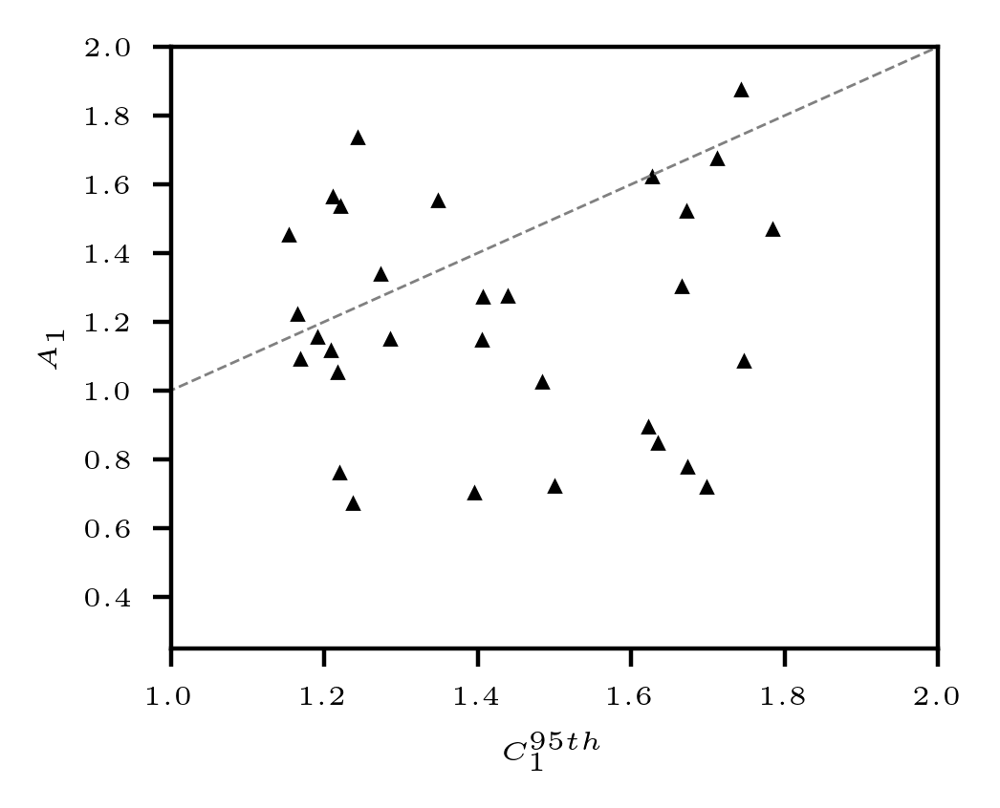

In [364]:
font_size = 5
mark_size = 2
line_width = 0.5
subplot = [['1']]

Euu_95_mean = np.nanmean(Euu_95perc,1)
Euu_92_mean = np.nanmean(Euu_92perc,1)
Euu_90_mean = np.nanmean(Euu_90perc,1)
fig, axes = plt.subplot_mosaic(subplot, constrained_layout=True)
trans = mtransforms.ScaledTranslation(-20/72, 7/72, fig.dpi_scale_trans)
fig.set_size_inches(2.5,2)
fig.set_dpi(400)
# axes['1'].plot(A1,Euu_95_mean,'+',color = 'black', markersize=mark_size, markeredgewidth=line_width)
axes['1'].plot(Euu_95_mean,A1_filt[mask_all],'^',color = 'black', 
               markersize=mark_size, markeredgewidth=line_width, label='95th')
# axes['1'].plot(Euu_92_mean,A1_filt[mask_all],'.',color = 'blue', 
#                markersize=mark_size, markeredgewidth=line_width, label='92th')
# axes['1'].plot(Euu_90_mean,A1_filt[mask_all],'.',color = 'red', 
#                markersize=mark_size, markeredgewidth=line_width, label='90th')
axes['1'].set_xlabel(r'$C_1^{95th}$', fontsize = font_size)
axes['1'].set_ylabel(r'$A_1$', fontsize = font_size)
axes['1'].set_xlim(1,2)
axes['1'].set_ylim(0.25,2)
axes['1'].tick_params(axis='both', labelsize=font_size)
plt.plot([0, 2], [0, 2],'--',color = 'gray',linewidth=line_width)
# legend = axes['1'].legend(fontsize=font_size)
# plt.savefig(OUT_PLOT_DIR+f'C1_95th_vs_A1.jpg',dpi=400, bbox_inches='tight')

In [35]:
print('mean={:.2f}, std={:.2f}'.format(np.nanmean(Euu_95_mean), np.nanstd(Euu_95_mean)))

mean=1.38, std=0.21


# Create an array to store peaks

In [365]:
Euu_peaks = []
Euu_peaks_kz = []
Eww_peaks = []
Eww_peaks_kz = []
for id_ in Indices:
    # Loop through the 39 neutral hours
    strday = str(datetime_all[id_][0].strftime("%Y%m%d"))
    ih = datetime_all[id_][1]
    key1 = f"{strday}_{ih:02}00"
    sample = log_spectrum_vars[key1]['Euu']['filt']
    Euu_peaks = np.append(Euu_peaks,np.nanmean(sample['max_peak_Euu_norm'][list_sel]))
    Euu_peaks_kz = np.append(Euu_peaks_kz, np.nanmean(sample['max_peak_k_norm'][list_sel]))
    sample2 = log_spectrum_vars[key1]['Eww']['filt']
    Eww_peaks = np.append(Eww_peaks,np.nanmean(sample2['max_peak_Eww_norm'][list_sel]))
    Eww_peaks_kz = np.append(Eww_peaks_kz, np.nanmean(sample2['max_peak_k_norm'][list_sel]))
    
A1 = A1_filt[mask_all]
# Get the indices that would sort the array
sorted_indices = np.argsort(A1)
A1_sort = A1[sorted_indices]
Euu_peaks_sort = Euu_peaks[sorted_indices]
Euu_peaks_kz_sort = Euu_peaks_kz[sorted_indices]
Eww_peaks_sort = Eww_peaks[sorted_indices]
Eww_peaks_kz_sort = Eww_peaks_kz[sorted_indices]

# Plot A1 vs peaks

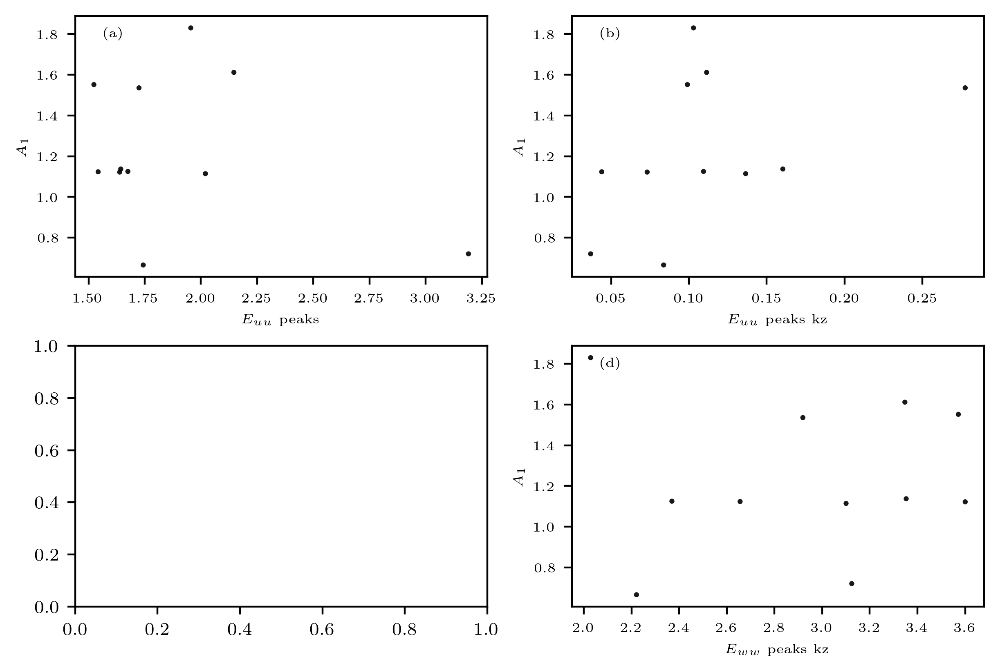

In [31]:
text_loc = [0.18, 0.86]
font_size = 6
mark_size = 5
fig, axes = plt.subplot_mosaic([['a','b'],['c','d']], constrained_layout=True)
fig.set_size_inches(6,4)
fig.set_dpi(400)
# label physical distance in and down:
trans = mtransforms.ScaledTranslation(-20/72, 7/72, fig.dpi_scale_trans)

def plot_fig_label(x_var,fig_lbl,ax_):
    ax_.scatter(x_var,y_temp, s=mark_size, 
                color='black', alpha=0.9, label=r'Filtered Data ($\mathrm{IST_{wspd}}<0.3$)', edgecolors='none')
    ax_.set_ylabel(r'$A_1$', fontsize=font_size)
    # Change axis tick label size
    ax_.tick_params(axis='x', labelsize=font_size)  # Adjust x-axis tick label size
    ax_.tick_params(axis='y', labelsize=font_size)  # Adjust y-axis tick label size
    ax_.text(text_loc[0], text_loc[1], fig_lbl, transform=ax_.transAxes + trans,
                fontsize=font_size, zorder=2, 
                bbox={'facecolor': 'white', 'edgecolor': 'none', 'pad': 1})
    
y_temp = A1_sort[group3]

plot_fig_label(Euu_peaks_sort[group3],'(a)', axes['a'])
axes['a'].set_xlabel(r'$E_{uu}$ peaks', fontsize=font_size)

plot_fig_label(Euu_peaks_kz_sort[group3],'(b)', axes['b'])
axes['b'].set_xlabel(r'$E_{uu}$ peaks kz', fontsize=font_size)

# plot_fig_label(Eww_peaks_sort[group3]/Euu_peaks_sort[group3],'(c)', axes['c'])
# axes['c'].set_xlabel(r'$E_{ww}/E_{uu}$', fontsize=font_size)

plot_fig_label(Eww_peaks_kz_sort[group3],'(d)', axes['d'])
axes['d'].set_xlabel(r'$E_{ww}$ peaks kz', fontsize=font_size)

# Adjust spacing
fig.subplots_adjust(wspace=0.3)  # Adjust the width space between subplots
fig.subplots_adjust(hspace=0.3)

# **** Compute ensemble Euu and Eww

In [22]:
# Line parameters
x01 = np.logspace(-1, 2, num=100)
x02 = np.logspace(-2, 1.5, num=100)

line_width = 0.5
strday = datetime_all[Indices[0]][0].strftime("%Y%m%d")
ih = datetime_all[Indices[0]][1]
key1 = f"{strday}_{ih:02}00"
n_log = log_spectrum_vars[key1]['Euu']['filt']['wavenumber_norm'].shape[0]
# Initialize 3d arrays to store Euu, Eww, kz values
Euu_norm_all = np.zeros((len(Indices),n_log,sonum))*np.nan
Eww_norm_all = np.zeros((len(Indices),n_log,sonum))*np.nan
kz_value_all = np.zeros((len(Indices),n_log,sonum))*np.nan
kdelta_value_all = np.zeros((len(Indices),n_log,sonum))*np.nan
# Iterate over level 1 keys
for i,level1_key in zip(range(len(Indices)),log_spectrum_vars.keys()):
    level2_dict = log_spectrum_vars[level1_key]
    # only deal with Euu, filt:
    kz_value = level2_dict['Euu']['filt']['wavenumber_norm']
    kdelta_value = level2_dict['Euu']['filt']['kdelta']
    Euu_value = level2_dict['Euu']['filt']['power_density_norm']
    Eww_value = level2_dict['Eww']['filt']['power_density_norm']
    kz_value_all[i,:,:] = kz_value
    kdelta_value_all[i,:,:] = kdelta_value
    Euu_norm_all[i,:,:] = Euu_value
    Eww_norm_all[i,:,:] = Eww_value

# Compute the mean of level 4 values, ignoring NaN values
kz_value_mean = np.nanmean(kz_value_all, axis=0)
kdelta_value_mean = np.nanmean(kdelta_value_all, axis=0)
Euu_norm_mean = np.nanmean(Euu_norm_all, axis=0)
Eww_norm_mean = np.nanmean(Eww_norm_all, axis=0)

## Plot ensemble Euu 

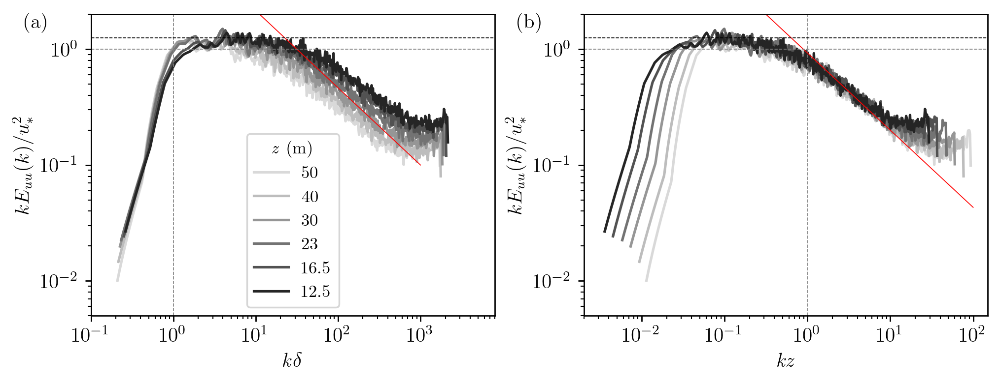

In [69]:
fig, axes = plt.subplot_mosaic([['a','b']], constrained_layout=True)
fig.set_size_inches(8,3)
fig.set_dpi(250)
# label physical distance in and down:
trans = mtransforms.ScaledTranslation(-20/72, 7/72, fig.dpi_scale_trans)

text_loc = [-0.08, 0.9]
font_size = 12
mark_size = 5
line_width = 0.5
# Define the intersection points
x_left = 4e-2
y_left = 3e-2
x_right = 10
y_right = 0.2
# Line parameters
x01 = np.logspace(-1, 2, num=100)
x02 = np.logspace(-2, 1.5, num=100)

# Set color order
axes['b'].set_prop_cycle(color=color_list)
# Plot kFu from higher to lower level
for il in reversed(list_sel):
    axes['b'].loglog(kz_value_mean[:,il],Euu_norm_mean[:,il])
# Plot reference lines
axes['b'].axvline(x=1,linestyle='--',color='grey', linewidth=line_width, zorder=2)
# Creating the line y = A * x^(-2/3)
A = y_right *x_right**(2/3)
line1_y = A * x01**(-2/3)

# Creating the line y = B * x
B = y_left / x_left
line2_y = B * x02

# Plotting the reference lines
axes['b'].plot(x01,line1_y, 'red', linewidth=line_width)
# ax2.plot(x02,line2_y, 'red', linewidth=line_width)    

axes['b'].set_xlim(2e-3,150)    
axes['b'].set_ylim(5e-3,2)
# ax2.set_ylim(1e-3,2)
axes['b'].set_xlabel(r'$\it kz$', fontsize = font_size)
axes['b'].set_ylabel(r'$kE_{uu}(k)/u_*^2$', fontsize = font_size)
axes['b'].tick_params(axis='both', labelsize=font_size)
# ax2.set_ylabel(r'$kE_{ww}(k)/u_*^2$', fontsize = font_size, color=blue_color_list[-1])
# Change the color of major ticks
# ax2.tick_params(axis='y', color=blue_color_list[-1], labelcolor=blue_color_list[-1])
# Change the color of minor ticks on y axes
# ax2.tick_params(axis='y', which='minor', color=blue_color_list[-1])
# axes['b'].legend(list(reversed(ldg)), title='Elevation(m)', loc='lower center', 
#                  title_fontsize =font_size-2, fontsize = font_size-2)
axes['b'].axhline(y=1,linestyle='--',color='gray', linewidth=line_width, zorder=2)
axes['b'].axhline(y=1.25,linestyle='--',color='black', linewidth=line_width, zorder=2)
axes['b'].text(text_loc[0], text_loc[1], '(b)', transform=axes['b'].transAxes + trans,
                fontsize=font_size, va='bottom')
# plt.savefig(OUT_PLOT_DIR+'ensembled_Euu_39cases.jpg',dpi=400, bbox_inches='tight')

# plot delta scaled Euu
# Define the intersection points
x_left = 20
y_left = 3e-2
x_right = 1000
y_right = 0.1
x01 = np.logspace(1, 3, num=100)
# Set color order
axes['a'].set_prop_cycle(color=color_list)
# Plot kFu from higher to lower level
for il in reversed(list_sel):
    axes['a'].loglog(kdelta_value_mean[:,il],Euu_norm_mean[:,il])
# Plot reference lines
axes['a'].axvline(x=1,linestyle='--',color='grey', linewidth=line_width, zorder=2)
# Creating the line y = A * x^(-2/3)
A = y_right *x_right**(2/3)
line1_y = A * x01**(-2/3)

# # Creating the line y = B * x
# B = y_left / x_left
# line2_y = B * x02

# Plotting the reference lines
axes['a'].plot(x01,line1_y, 'red', linewidth=line_width)
# ax2.plot(x02,line2_y, 'red', linewidth=line_width)    

axes['a'].set_xlim(1e-1,8000)    
axes['a'].set_ylim(5e-3,2)
# ax2.set_ylim(1e-3,2)
axes['a'].set_xlabel(r'$\it k\delta$', fontsize = font_size)
axes['a'].set_ylabel(r'$kE_{uu}(k)/u_*^2$', fontsize = font_size)
axes['a'].tick_params(axis='both', labelsize=font_size)
# ax2.set_ylabel(r'$kE_{ww}(k)/u_*^2$', fontsize = font_size, color=blue_color_list[-1])
# Change the color of major ticks
# ax2.tick_params(axis='y', color=blue_color_list[-1], labelcolor=blue_color_list[-1])
# Change the color of minor ticks on y axes
# ax2.tick_params(axis='y', which='minor', color=blue_color_list[-1])
# axes['b'].legend(list(reversed(ldg)), title='Elevation(m)', loc='lower center', 
#                  title_fontsize =font_size-2, fontsize = font_size-2)
axes['a'].axhline(y=1,linestyle='--',color='gray', linewidth=line_width, zorder=2)
axes['a'].axhline(y=1.25,linestyle='--',color='black', linewidth=line_width, zorder=2)
axes['a'].text(text_loc[0], text_loc[1], '(a)', transform=axes['a'].transAxes + trans,
                fontsize=font_size, va='bottom')
axes['a'].legend(list(reversed(ldg)), title=r'$\it z$ (m)', loc='lower center', 
                 title_fontsize =font_size-2, fontsize = font_size-2)
plt.savefig(OUT_PLOT_DIR+'ensembled_Euu_39cases.jpg',dpi=400, bbox_inches='tight')

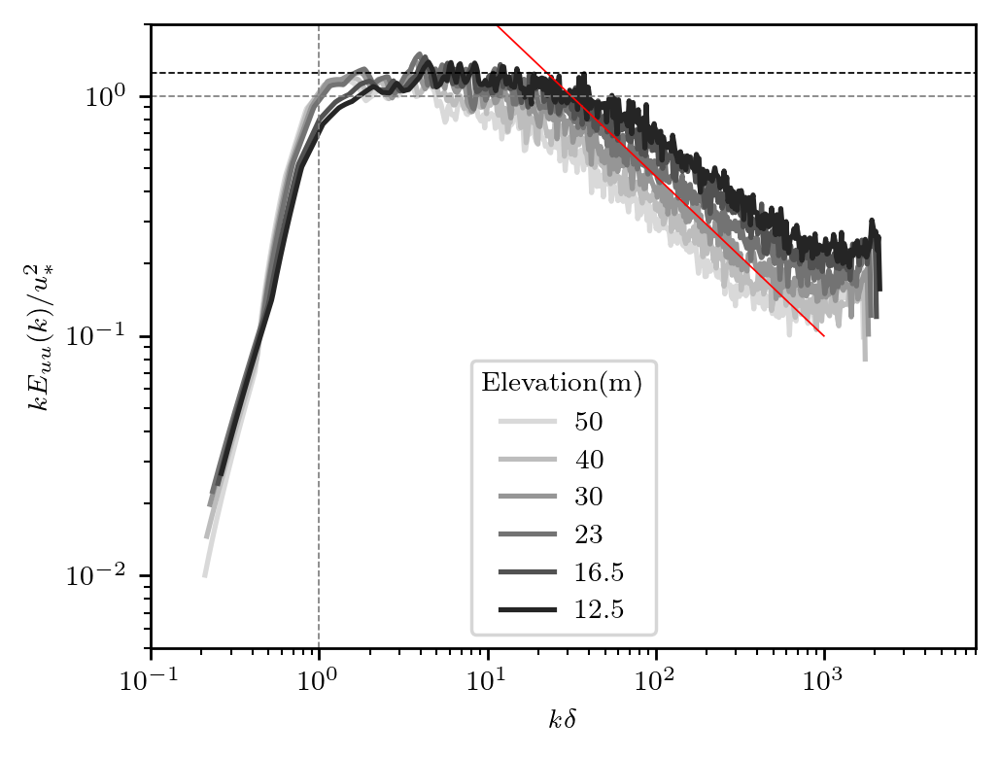

In [74]:
# Define the intersection points
# x_left = 50
# y_left = 1
# Line parameters
x01 = np.logspace(1, 3, num=100)
x02 = np.logspace(-2, 1.5, num=100)
x_right = 1000
y_right = 0.1
line_width = 0.5
fig, axes = plt.subplot_mosaic([['a']], constrained_layout=True)
fig.set_size_inches(4,3)
fig.set_dpi(250)
# label physical distance in and down:
trans = mtransforms.ScaledTranslation(-20/72, 7/72, fig.dpi_scale_trans)

text_loc = [-0.1, 1]
font_size = 8
mark_size = 5
line_width = 0.5
# Set color order
axes['a'].set_prop_cycle(color=color_list)
# Plot kFu from higher to lower level
for il in reversed(list_sel):
    axes['a'].loglog(kdelta_value_mean[:,il],Euu_norm_mean[:,il])
# Plot reference lines
axes['a'].axvline(x=1,linestyle='--',color='grey', linewidth=line_width, zorder=2)
# Creating the line y = A * x^(-2/3)
A = y_right *x_right**(2/3)
line1_y = A * x01**(-2/3)

# Creating the line y = B * x
B = y_left / x_left
line2_y = B * x02

# Plotting the reference lines
axes['a'].plot(x01,line1_y, 'red', linewidth=line_width)
# ax2.plot(x02,line2_y, 'red', linewidth=line_width)    

axes['a'].set_xlim(1e-1,8000)    
axes['a'].set_ylim(5e-3,2)
# ax2.set_ylim(1e-3,2)
axes['a'].set_xlabel(r'$\it k\delta$', fontsize = font_size)
axes['a'].set_ylabel(r'$kE_{uu}(k)/u_*^2$', fontsize = font_size)
# ax2.set_ylabel(r'$kE_{ww}(k)/u_*^2$', fontsize = font_size, color=blue_color_list[-1])
# Change the color of major ticks
# ax2.tick_params(axis='y', color=blue_color_list[-1], labelcolor=blue_color_list[-1])
# Change the color of minor ticks on y axes
# ax2.tick_params(axis='y', which='minor', color=blue_color_list[-1])
axes['a'].legend(list(reversed(ldg)), title='Elevation(m)', loc='lower center', fontsize = font_size, title_fontsize=font_size)
axes['a'].axhline(y=1,linestyle='--',color='gray', linewidth=line_width, zorder=2)
axes['a'].axhline(y=1.25,linestyle='--',color='black', linewidth=line_width, zorder=2)
# plt.savefig(OUT_PLOT_DIR+'ensembled_Euu_39cases.jpg',dpi=400, bbox_inches='tight')

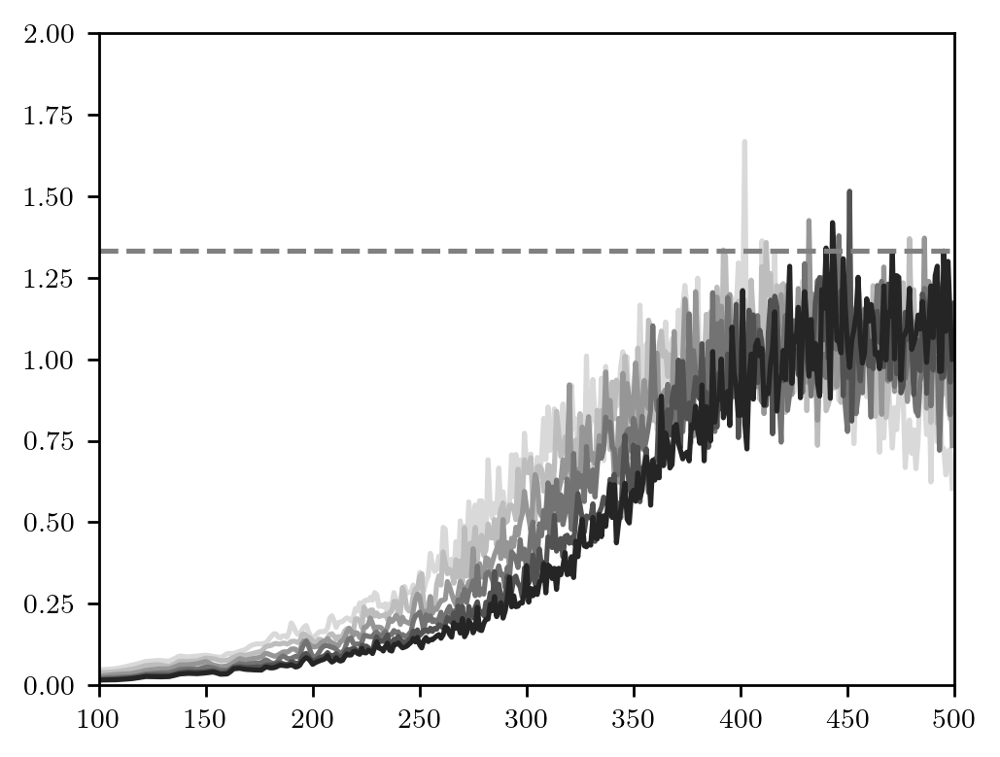

In [34]:
# the ratio of Eww/Euu
ratio = Eww_norm_mean/Euu_norm_mean
fig, axes = plt.subplot_mosaic([['a']], constrained_layout=True)
fig.set_size_inches(4,3)
fig.set_dpi(250)
axes['a'].set_prop_cycle(color=color_list)
for i in reversed(list_sel):
    axes['a'].plot(ratio[:,i])
# axes['a'].plot(ratio[:,list_sel[0]])
# axes['a'].plot(ratio[:,list_sel[1]])
axes['a'].set_xlim(100,500)
axes['a'].set_ylim(0,2)
axes['a'].axhline(y=4/3,linestyle='--',color='gray')

## Plot ensumble Eww

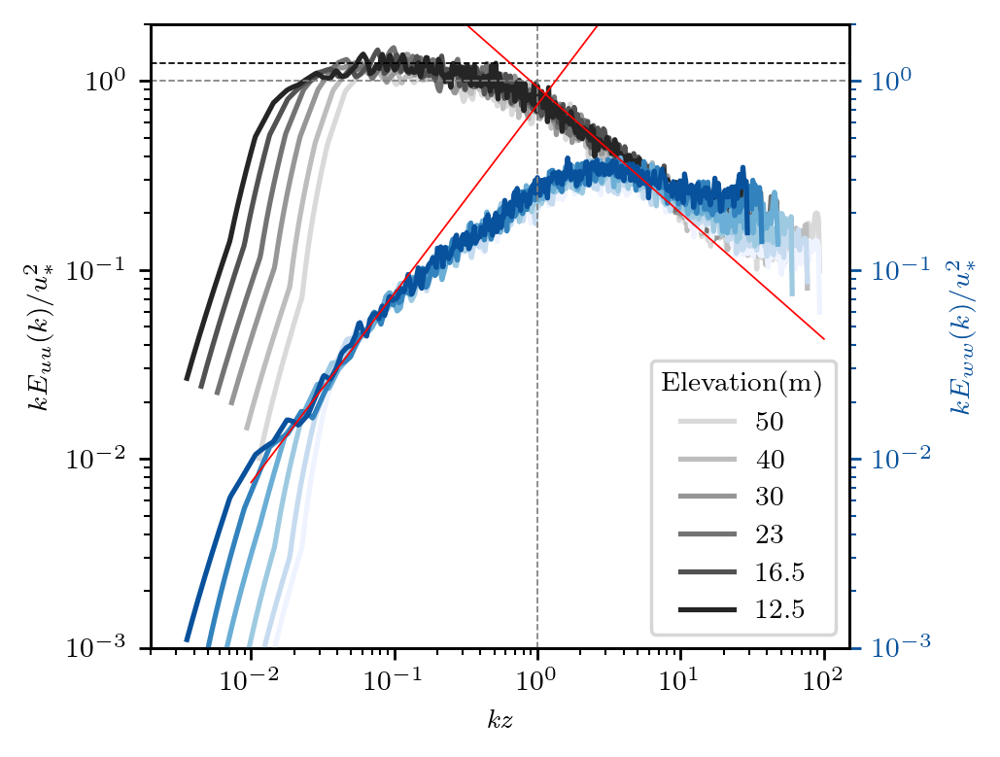

In [35]:
fig, axes = plt.subplot_mosaic([['a']], constrained_layout=True)
fig.set_size_inches(4,3)
fig.set_dpi(250)
# label physical distance in and down:
trans = mtransforms.ScaledTranslation(-20/72, 7/72, fig.dpi_scale_trans)

text_loc = [-0.1, 1]
font_size = 8
mark_size = 5
line_width = 0.5
# Set color order
axes['a'].set_prop_cycle(color=color_list)
# Plot kFu from higher to lower level
for il in reversed(list_sel):
    axes['a'].loglog(kz_value_mean[:,il],Euu_norm_mean[:,il])
# Create a second y-axis that shares the same x-axis
ax2 = axes['a'].twinx()
# Set color order|
ax2.set_prop_cycle(color=blue_color_list)
# Plot kFw from higher to lower level
for il in reversed(list_sel):
    ax2.loglog(kz_value_mean[:,il],Eww_norm_mean[:,il],zorder=1)
# Plot reference lines
ax2.axvline(x=1,linestyle='--',color='grey', linewidth=line_width, zorder=2)
# Plot f=5e-3Hz
# for i in reversed(list_sel):
#     u_avg = np.nanmean(u_avg_filt[mask_all,i])
#     ax2.axvline(x=2*pi*5e-3/u_avg*z[i],linestyle='--',color='gray', linewidth=line_width, zorder=2)
# Creating the line y = A * x^(-2/3)
A = y_right *x_right**(2/3)
line1_y = A * x01**(-2/3)

# Creating the line y = B * x
B = y_left / x_left
line2_y = B * x02

# Plotting the reference lines
ax2.plot(x01,line1_y, 'red', linewidth=line_width)
ax2.plot(x02,line2_y, 'red', linewidth=line_width)    
    
axes['a'].set_xlim(2e-3,150)    
axes['a'].set_ylim(1e-3,2)
ax2.set_ylim(1e-3,2)
axes['a'].set_xlabel(r'$\it kz$', fontsize = font_size)
axes['a'].set_ylabel(r'$kE_{uu}(k)/u_*^2$', fontsize = font_size)
ax2.set_ylabel(r'$kE_{ww}(k)/u_*^2$', fontsize = font_size, color=blue_color_list[-1])
# Change the color of major ticks
ax2.tick_params(axis='y', color=blue_color_list[-1], labelcolor=blue_color_list[-1])
# Change the color of minor ticks on y axes
ax2.tick_params(axis='y', which='minor', color=blue_color_list[-1])
axes['a'].legend(list(reversed(ldg)), title='Elevation(m)', loc='lower right', fontsize = font_size, title_fontsize=font_size)
axes['a'].axhline(y=1,linestyle='--',color='gray', linewidth=line_width, zorder=2)
axes['a'].axhline(y=1.25,linestyle='--',color='black', linewidth=line_width, zorder=2)
plt.savefig(OUT_PLOT_DIR+'ensembled_Euu_Eww.jpg',dpi=400, bbox_inches='tight')

In [2]:
1.25**2,1.2**2

(1.5625, 1.44)

# ****** Section 4 ******* #

# ****** Create subset of variables after applying mask_all and sort by A1

In [23]:
A1 = A1_filt[mask_all]
datetime = datetime_all[mask_all]
H_avg = abs(H_avg_filt)[mask_all]
sample_uavg = fit_data_vars['var1D_uavg']['filt']
sample_ustd = fit_data_vars['var1D_ustd']['filt']
u_std_plus_all = u_std_filt**2/sample_uavg['u_star_mean'][:,None]**2
u_std_plus = u_std_plus_all[mask_all]
w_std_plus_all = w_std_filt**2/sample_uavg['u_star_mean'][:,None]**2
w_std_plus = w_std_plus_all[mask_all]
w_std_plus_ldtr_all = w_std_ldtr**2/fit_data_vars['var1D_uavg']['ldtr']['u_star_mean'][:,None]**2
w_std_plus_ldtr = w_std_plus_ldtr_all[mask_all]
w_std_plus_ldtr2_all = w_std_ldtr**2/fit_data_vars['var1D_uavg']['filt']['u_star_mean'][:,None]**2
w_std_plus_ldtr2 = w_std_plus_ldtr2_all[mask_all]
w_std_filt_masked = w_std_ldtr[mask_all]
u_star_filt_masked = u_star_filt[mask_all]
wstd_slope = sample_ustd['slope_wstd_ustar'][mask_all]
intercept_all = sample_ustd['intercept_ustd']
intercept = intercept_all[mask_all]
u_star = sample_uavg['u_star_mean'][mask_all]
R2_A1 = R2_A1_filt[mask_all]
z_L = np.nanmean(stability_filt[mask_all][:,list_sel],1) 
u_avg = u_avg_filt[mask_all]
kappa = kappa_filt[mask_all]
zol = geomean_median_stability[mask_all]
Re_b_subset = Re_b[mask_all]

# Get the indices that would sort the array
sorted_indices = np.argsort(A1)
A1_sort = A1[sorted_indices]
datetime_sort = datetime[sorted_indices]
H_avg_sort = H_avg[sorted_indices]
u_std_plus_sort = u_std_plus[sorted_indices]
w_std_plus_sort = w_std_plus[sorted_indices]
w_std_plus_ldtr_sort = w_std_plus_ldtr[sorted_indices]
w_std_plus_ldtr2_sort = w_std_plus_ldtr2[sorted_indices]
w_std_filt_sort = w_std_filt_masked[sorted_indices]
u_star_filt_sort = u_star_filt_masked[sorted_indices]
wstd_slope_sort = wstd_slope[sorted_indices]
intercept_sort = intercept[sorted_indices]
u_star_sort = u_star[sorted_indices]
R2_A1_sort = R2_A1[sorted_indices]
z_L_sort = z_L[sorted_indices]
Euu_95_mean = np.nanmean(Euu_95perc,1)
Euu_95_mean_sort = Euu_95_mean[sorted_indices]
u_avg_sort = u_avg[sorted_indices]
kappa_sort = kappa[sorted_indices]
zol_sort = zol[sorted_indices]
Re_b_sort = Re_b_subset[sorted_indices]

In [129]:
Euu_95_mean.shape

(39,)

In [131]:
# Create a DataFrame from the formatted data
df_ = pd.DataFrame(datetime, columns=['Date','Hour'])
print(df_)

          Date Hour
0   2020-09-25   15
1   2020-09-25   16
2   2020-10-10   16
3   2020-10-10   17
4   2020-10-10   18
5   2020-10-10   19
6   2020-10-13   15
7   2020-10-13   16
8   2020-10-13   17
9   2020-10-13   18
10  2020-10-16   16
11  2020-10-18   15
12  2020-10-21   14
13  2020-10-21   15
14  2020-10-21   16
15  2020-10-30   15
16  2020-11-19   11
17  2020-11-19   14
18  2021-02-26   11
19  2021-03-06   14
20  2021-03-06   15
21  2021-03-06   16
22  2021-03-28   17
23  2021-03-29    3
24  2021-03-29    4
25  2021-03-29    5
26  2021-03-29    7
27  2021-04-08    8
28  2021-04-08   18
29  2021-04-10   16
30  2021-04-10   17
31  2021-04-10   18
32  2021-04-13   17
33  2021-04-13   18
34  2021-04-14    7
35  2021-04-14    8
36  2021-04-14   11
37  2021-04-19   18
38  2021-04-19   19


# Plot all Euu

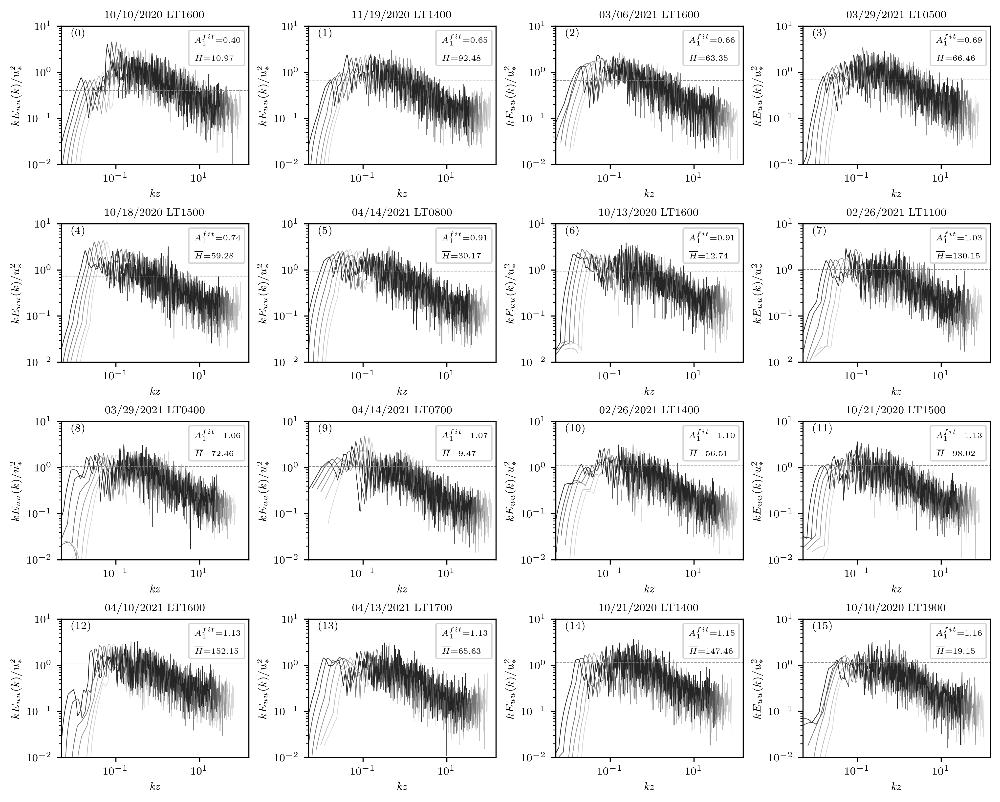

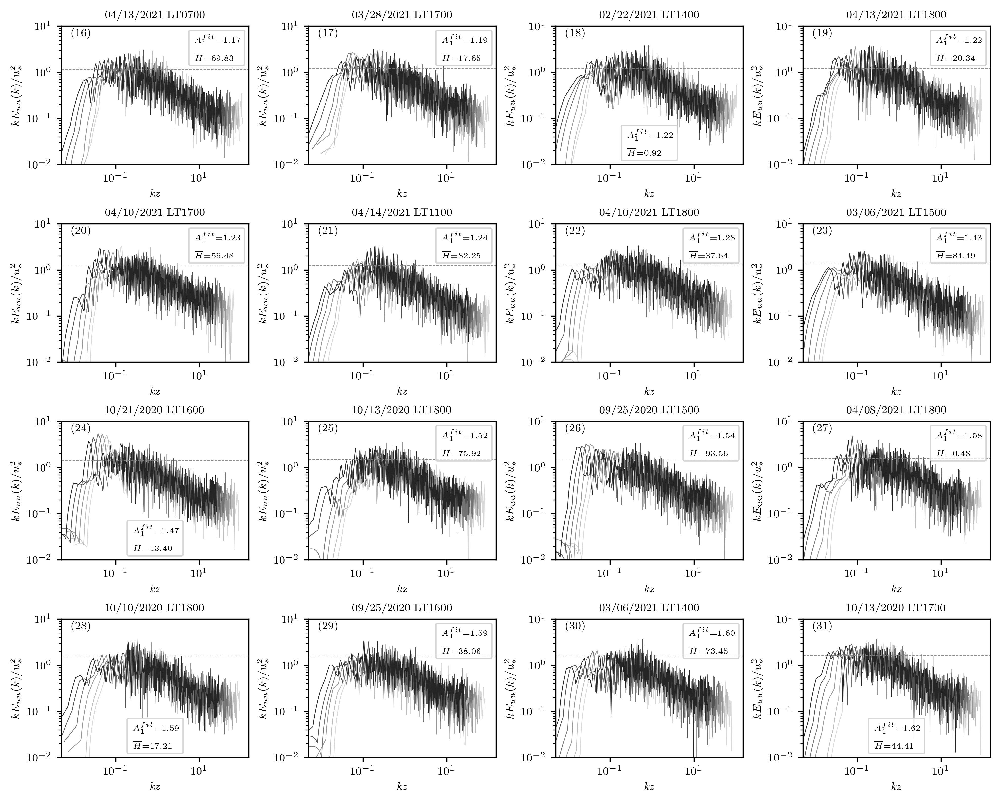

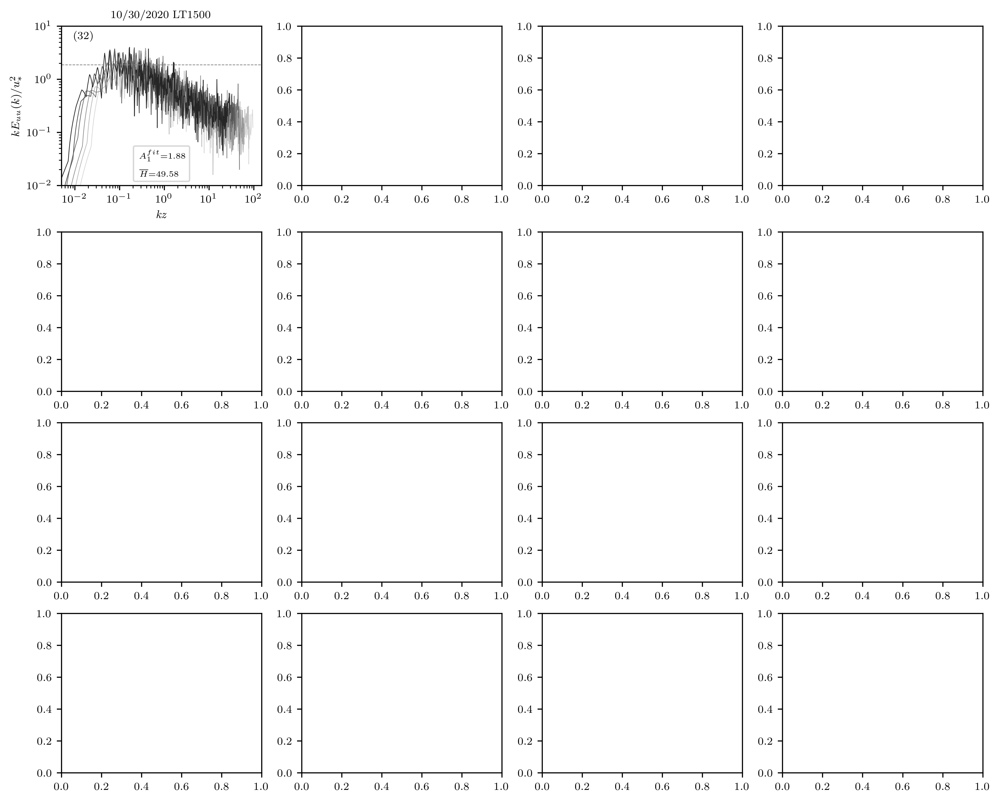

In [41]:
text_loc = [0.2, 0.86]
font_size = 8
mark_size = 5
line_width = 0.5

def plot_kEuu_sort(fig_lbl,ax_,index):
    strday = datetime_sort[index][0].strftime("%Y%m%d")
    ih = datetime_sort[index][1]
    key1 = f"{strday}_{ih:02}00"
    sample = log_spectrum_vars[key1]['Euu']['filt']
    # Set color order
    ax_.set_prop_cycle(color=color_list)
    # Plot kFu from higher to lower level
    for il in reversed(list_sel):
        ax_.loglog(sample['wavenumber_norm'][:,il],sample['power_density_norm'][:,il],linewidth=line_width)
    ax_.set_xlabel(r'$\it kz$', fontsize = font_size)
    ax_.set_ylabel(r'$kE_{uu}(k)/u_*^2$', fontsize = font_size)
    ax_.set_xlim(5e-3, 150)
    ax_.set_ylim(1e-2, 1e1)
    ax_.text(text_loc[0], text_loc[1], fig_lbl, transform=ax_.transAxes + trans,
            fontsize=font_size, zorder=2, 
            bbox={'facecolor': 'white', 'edgecolor': 'none', 'pad': 1})
    ax_.set_title(datetime_sort[index][0].strftime("%m/%d/%Y")+' LT'+f"{ih:02}00",
              fontsize = font_size)
    info = [r'$A_1^{fit}$'+'={:.2f}'.format(A1_sort[index])+'\n\n'+ 
            r'$\overline{H}$'+'={:.2f}'.format(H_avg_sort[index])]
    ax_.legend(custom_lines, info, fontsize=font_size-2, handlelength=-0.5)
    ax_.axhline(y=A1_sort[index],linestyle='--',color='gray', linewidth=line_width, zorder=2)


numbers_list = [f"({i})" for i in range(len(sorted_indices))]
subplot = [['1', '2', '3', '4'],
         ['5', '6', '7', '8'],
         ['9', '10', '11', '12'],
         ['13', '14', '15', '16']]    
fig, axes = plt.subplot_mosaic(subplot, constrained_layout=True)
trans = mtransforms.ScaledTranslation(-20/72, 7/72, fig.dpi_scale_trans)
fig.set_size_inches(10,8)
fig.set_dpi(400)
for i in range(16):
    plot_kEuu_sort(numbers_list[i],axes[str(i+1)],i)
    
fig2, axes = plt.subplot_mosaic(subplot, constrained_layout=True)
trans = mtransforms.ScaledTranslation(-20/72, 7/72, fig2.dpi_scale_trans)
fig2.set_size_inches(10,8)
fig2.set_dpi(400)
for i in range(16):
    plot_kEuu_sort(numbers_list[i+16],axes[str(i+1)],i+16)

fig2, axes = plt.subplot_mosaic(subplot, constrained_layout=True)
trans = mtransforms.ScaledTranslation(-20/72, 7/72, fig2.dpi_scale_trans)
fig2.set_size_inches(10,8)
fig2.set_dpi(400)
for i in range(1):
    plot_kEuu_sort(numbers_list[i+32],axes[str(i+1)],i+32)

# Plot all Euu after smoothing
## all

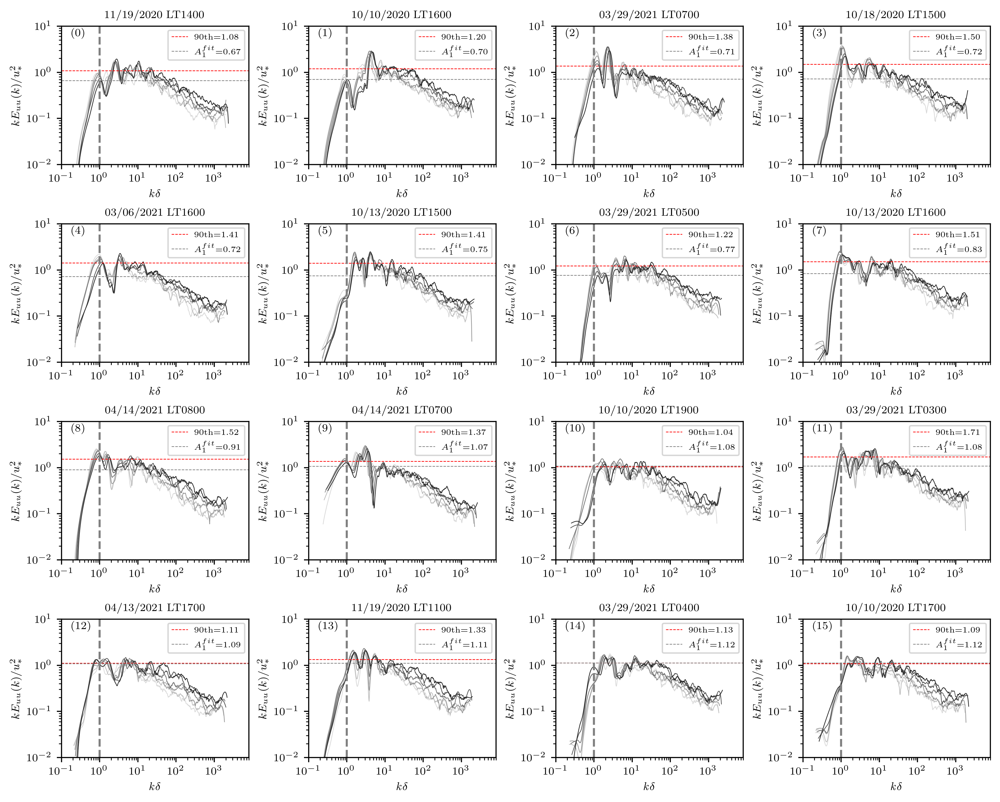

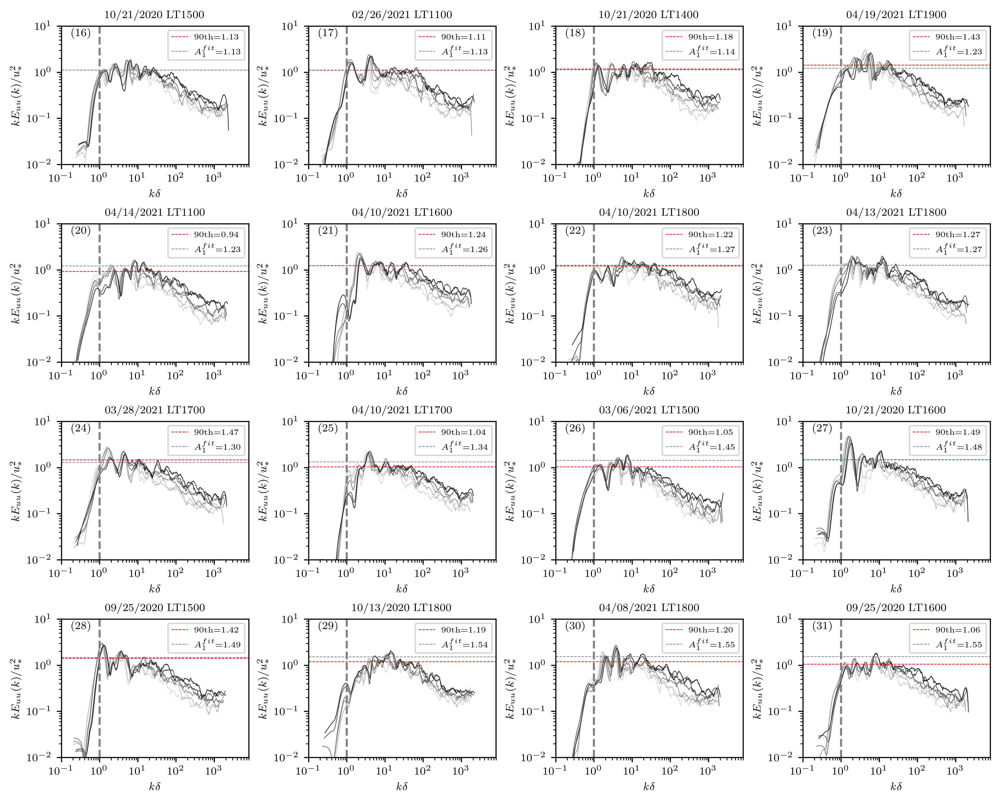

In [ ]:
text_loc = [0.2, 0.86]
font_size = 8
mark_size = 2
line_width = 0.5
# group3 = group5
def smooth_find_peaks(x,y):
    # Smoothing the data
    y_smoothed = savgol_filter(y, window_length=31, polyorder=3)
    # Finding the peak
    peaks, _ = find_peaks(y_smoothed,distance=25)
    # Finding the maximum peak
    max_peak_index = peaks[np.argmax(y_smoothed[peaks])]
    max_peak_y = y_smoothed[int(max_peak_index)]
    max_peak_x = x[int(max_peak_index)]
    return peaks,y_smoothed,max_peak_x,max_peak_y

def plot_kEuu_sort(fig_lbl,ax_,index):
    Euu_95perc = np.zeros((len(list_sel)))*np.nan
    Euu_90perc = np.zeros((len(list_sel)))*np.nan
    strday = datetime_sort[index][0].strftime("%Y%m%d")
    ih = datetime_sort[index][1]
    key1 = f"{strday}_{ih:02}00"
    sample = log_spectrum_vars[key1]['Euu']['filt']
    kz = sample['wavenumber_norm']
    kdelta = sample['kdelta']
    Euu_norm = sample['power_density_norm']
    # Set color order
    ax_.set_prop_cycle(color=color_list)
    # Plot kFu from higher to lower level
    for ii in range(len(list_sel)):
        il = list(reversed(list_sel))[ii]
        peaks,Euu_smoothed,max_peak_kz,max_peak_Euu = smooth_find_peaks(kz[:,il],Euu_norm[:,il])
        Euu_95perc[ii] = np.percentile(Euu_smoothed, 95)
        Euu_90perc[ii] = np.percentile(Euu_smoothed, 90)
        # Plotting the data
        # ax_.plot(kz[:,il], Euu_norm[:,il], label='Original Data',linewidth=line_width)
        ax_.plot(kdelta[:,il], Euu_smoothed,linewidth=line_width)
        # ax_.scatter(kz[peaks,il], Euu_smoothed[peaks], marker='o', 
        #             color='black', label='Peaks',s = mark_size)
        # ax_.axvline(max_peak_kz,linestyle='--',color='gray',linewidth=line_width)
    ax_.axhline(y=np.nanmean(Euu_90perc),linestyle='--',color='red', linewidth=line_width, zorder=2, 
               label = r'90th'+'={:.2f}'.format(np.nanmean(Euu_90perc)))
    ax_.set_xscale('log')
    ax_.set_yscale('log')
    
    # # Set color order
    # ax_.set_prop_cycle(color=color_list)
    # # Plot kFu from higher to lower level
    # for il in reversed(list_sel):
    #     ax_.loglog(sample['wavenumber_norm'][:,il],sample['power_density_norm'][:,il],linewidth=line_width)
    ax_.set_xlabel(r'$\it k\delta$', fontsize = font_size)
    ax_.set_ylabel(r'$kE_{uu}(k)/u_*^2$', fontsize = font_size)
    # ax_.set_xlim(5e-3, 150)
    ax_.set_xlim(1e-1,8000)
    ax_.set_ylim(1e-2, 1e1)
    ax_.text(text_loc[0], text_loc[1], fig_lbl, transform=ax_.transAxes + trans,
            fontsize=font_size, zorder=2, 
            bbox={'facecolor': 'white', 'edgecolor': 'none', 'pad': 1})
    ax_.set_title(datetime_sort[index][0].strftime("%m/%d/%Y")+' LT'+f"{ih:02}00",
              fontsize = font_size)
    # info = [r'$A_1^{fit}$'+'={:.2f}'.format(A1_sort[index])]
    ax_.axhline(y=A1_sort[index],linestyle='--',color='gray', linewidth=line_width, zorder=2, 
                label = r'$A_1^{fit}$'+'={:.2f}'.format(A1_sort[index]))
    ax_.legend(fontsize=font_size-2)
    
    # plot ref lines
    ax_.axvline(x=1,linestyle='--',color='gray')
    ax_.axvline(x=2e-2,linestyle='--',color='gray')


# numbers_list = [f"({i+1})" for i in range(len(sorted_indices))]
# subplot = [['1', '2', '3', '4'],
#          ['5', '6', '7', '8'],
#          ['9', '10', '11', '12'],
#          ['13', '14', '15', '16']]    
# fig, axes = plt.subplot_mosaic(subplot, constrained_layout=True)
# trans = mtransforms.ScaledTranslation(-20/72, 7/72, fig.dpi_scale_trans)
# fig.set_size_inches(10,8)
# fig.set_dpi(400)
# for i in range(len(group3)):
#     plot_kEuu_sort(f"({group3[i]+1})",axes[str(i+1)],group3[i])
# axes[subplot[3][3]].remove()
# plt.savefig(OUT_PLOT_DIR+f'group3_smoothed_Euu.jpg',dpi=400, bbox_inches='tight')

numbers_list = [f"({i})" for i in range(len(sorted_indices))]
subplot = [['1', '2', '3', '4'],
         ['5', '6', '7', '8'],
         ['9', '10', '11', '12'],
         ['13', '14', '15', '16']]    
fig, axes = plt.subplot_mosaic(subplot, constrained_layout=True)
trans = mtransforms.ScaledTranslation(-20/72, 7/72, fig.dpi_scale_trans)
fig.set_size_inches(10,8)
fig.set_dpi(400)
for i in range(16):
    plot_kEuu_sort(numbers_list[i],axes[str(i+1)],i)
    
fig2, axes = plt.subplot_mosaic(subplot, constrained_layout=True)
trans = mtransforms.ScaledTranslation(-20/72, 7/72, fig2.dpi_scale_trans)
fig2.set_size_inches(10,8)
fig2.set_dpi(400)
for i in range(16):
    plot_kEuu_sort(numbers_list[i+16],axes[str(i+1)],i+16)

fig2, axes = plt.subplot_mosaic(subplot, constrained_layout=True)
trans = mtransforms.ScaledTranslation(-20/72, 7/72, fig2.dpi_scale_trans)
fig2.set_size_inches(10,8)
fig2.set_dpi(400)
for i in range(7):
    plot_kEuu_sort(numbers_list[i+32],axes[str(i+1)],i+32)

## Group 4

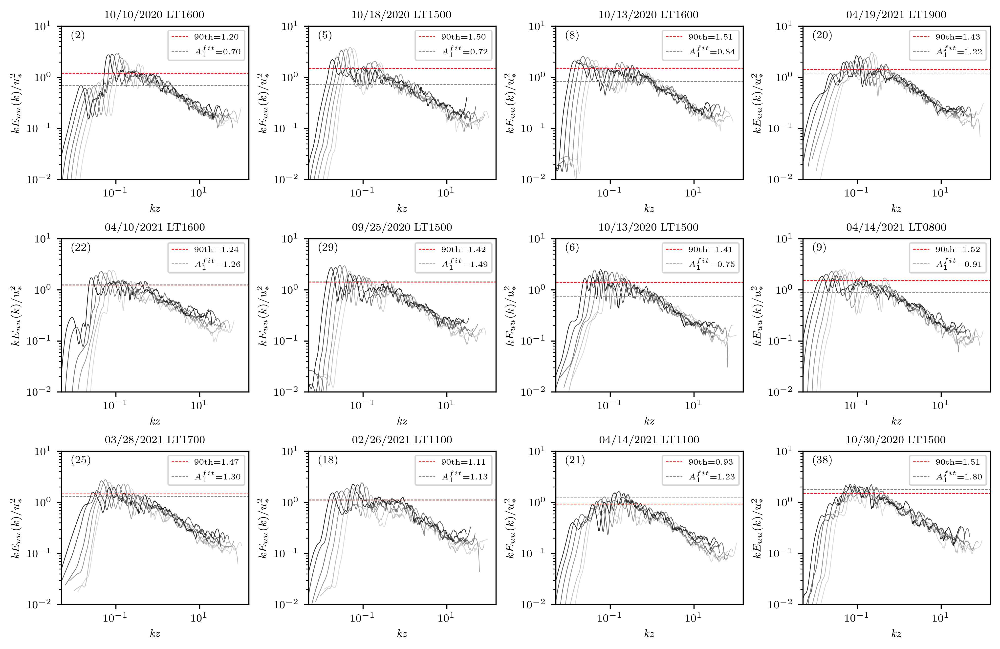

In [90]:
fig2, axes = plt.subplot_mosaic(subplot, constrained_layout=True)
trans = mtransforms.ScaledTranslation(-20/72, 7/72, fig2.dpi_scale_trans)
fig2.set_size_inches(10,8)
fig2.set_dpi(400)
for i in range(len(group4)):
    plot_kEuu_sort(f"({group4[i]+1})",axes[str(i+1)],group4[i])
for j in range(4):  # All columns
    axes[subplot[3][j]].remove()
plt.savefig(OUT_PLOT_DIR+f'group4_smoothed_Euu.jpg',dpi=400, bbox_inches='tight')

## Group 2

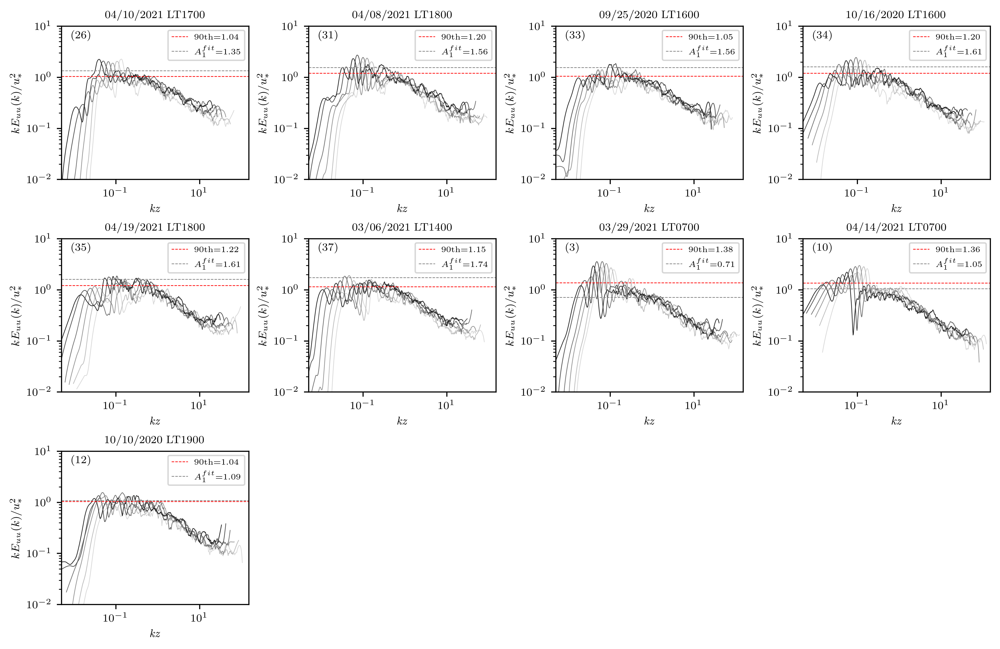

In [94]:
fig2, axes = plt.subplot_mosaic(subplot, constrained_layout=True)
trans = mtransforms.ScaledTranslation(-20/72, 7/72, fig2.dpi_scale_trans)
fig2.set_size_inches(10,8)
fig2.set_dpi(400)
for i in range(len(group2)):
    plot_kEuu_sort(f"({group2[i]+1})",axes[str(i+1)],group2[i])
for j in range(1,4):  # All columns
    axes[subplot[2][j]].remove()
for j in range(4):  # All columns
    axes[subplot[3][j]].remove()
plt.savefig(OUT_PLOT_DIR+f'group2_smoothed_Euu.jpg',dpi=400, bbox_inches='tight')

# Plot Euu and Eww, sigma_u and sigma_w, isotropic ratio, Dww

In [41]:
text_loc = [0.28, 0.8]
font_size = 5
mark_size = 3
line_width = 0.5
# Line parameters
x01 = np.logspace(-1, 2, num=100)
# Define the intersection points
x_right = 10
y_right = 0.8

def plot_kEuu_sort(fig_lbl,ax1,index):
    strday = datetime_sort[index][0].strftime("%Y%m%d")
    ih = datetime_sort[index][1]
    key1 = f"{strday}_{ih:02}00"
    sample_Euu = log_spectrum_vars[key1]['Euu']['filt']
    # Set color order
    ax1.set_prop_cycle(color=color_list)
    # Plot kFu from higher to lower level
    for il in reversed(list_sel):
        ax1.loglog(sample_Euu['wavenumber_norm'][:,il],sample_Euu['Euu_smoothed_norm'][:,il],linewidth=line_width)
    ax1.set_xlabel(r'$\it kz$', fontsize = font_size)
    ax1.set_ylabel(r'$kE_{uu}/u_*^2$', fontsize = font_size)
    ax1.set_xlim(5e-3, 150)
    ax1.set_ylim(1e-3, 1e1)
    ax1.tick_params(axis='both', labelsize=font_size)
    ax1.text(text_loc[0], text_loc[1], fig_lbl, transform=ax1.transAxes + trans,
            fontsize=font_size, zorder=2, 
            bbox={'facecolor': 'white', 'edgecolor': 'none', 'pad': 1})
    # ax1.set_title(f'{index+1}. '+ datetime_sort[index][0].strftime("%m/%d/%Y")+' LT'+f"{ih:02}00",
    #           fontsize = font_size)
    # info = [r'$A_1^{fit}$'+'={:.2f}'.format(A1_sort[index])+'\n\n'+ 
    #         r'$\overline{H}$'+'={:.2f}'.format(H_avg_sort[index])]
    ax1.axhline(y=A1_sort[index],linestyle='--',color='gray', linewidth=line_width, zorder=2, 
                label = r'$A_1^{fit}$'+'={:.2f}'.format(A1_sort[index]))
    ax1.axhline(y=1,linestyle='--',color='black', linewidth=line_width, zorder=2, 
                label = 'y=1')
    ax1.axhline(y=1.25,linestyle='--',color='red', linewidth=line_width, zorder=2, 
                label = 'y=1.25')
    ax1.axvline(x=1,linestyle='--',color='gray', linewidth=line_width, zorder=2, 
                label = 'x=1')
    legend = ax1.legend(fontsize=font_size-2)
    legend.get_frame().set_linewidth(line_width)
    
    # Creating the line y = A * x^(-2/3)
    A = y_right *x_right**(2/3)
    line1_y = A * x01**(-2/3)

    # Plotting the reference lines
    ax1.plot(x01,line1_y, 'red', linewidth=line_width)

def plot_kEww_sort(fig_lbl,ax1,index):
    strday = datetime_sort[index][0].strftime("%Y%m%d")
    ih = datetime_sort[index][1]
    key1 = f"{strday}_{ih:02}00"
    sample_Eww = log_spectrum_vars[key1]['Eww']['filt']
    # Set color order
    ax1.set_prop_cycle(color=color_list)
    # Plot kFu from higher to lower level
    for il in reversed(list_sel):
        ax1.loglog(sample_Eww['wavenumber_norm'][:,il],sample_Eww['Eww_smoothed_norm'][:,il],linewidth=line_width)
    ax1.set_xlabel(r'$\it kz$', fontsize = font_size)
    ax1.set_ylabel(r'$kE_{ww}/u_*^2$', fontsize = font_size)
    ax1.set_xlim(5e-3, 150)
    ax1.set_ylim(1e-3, 1e1)
    ax1.tick_params(axis='both', labelsize=font_size)
    ax1.text(text_loc[0], text_loc[1], fig_lbl, transform=ax1.transAxes + trans,
            fontsize=font_size, zorder=2, 
            bbox={'facecolor': 'white', 'edgecolor': 'none', 'pad': 1})
    
def plot_isotropic_ratio(fig_lbl,ax1,index):
    strday = datetime_sort[index][0].strftime("%Y%m%d")
    ih = datetime_sort[index][1]
    key1 = f"{strday}_{ih:02}00"
    sample_Euu = log_spectrum_vars[key1]['Euu']['filt']
    sample_Eww = log_spectrum_vars[key1]['Eww']['filt']
    iso_ratio = sample_Eww['Eww_smoothed_norm']/sample_Euu['Euu_smoothed_norm']
    # Set color order
    ax1.set_prop_cycle(color=color_list)
    # Plot kFu from higher to lower level
    for il in reversed(list_sel):
        ax1.semilogx(sample_Eww['wavenumber_norm'][:,il]/(2*pi),iso_ratio[:,il],linewidth=line_width)
    ax1.set_xlabel(r'$\it kz/2\pi$', fontsize = font_size)
    ax1.set_ylabel(r'$E_{ww}/E_{uu}$', fontsize = font_size)
    ax1.tick_params(axis='both', labelsize=font_size)
    # ax1.tick_params(axis='y', labelsize=font_size)
    ax1.text(text_loc[0], text_loc[1], fig_lbl, transform=ax1.transAxes + trans,
            fontsize=font_size, zorder=2, 
            bbox={'facecolor': 'white', 'edgecolor': 'none', 'pad': 1})
    ax1.set_xlim(2e-2, 15)
    ax1.set_ylim(-0.1, 2.5)
    ax1.axhline(y=4/3,linestyle='--',color='gray', linewidth=line_width, zorder=2, 
                label='ratio=4/3')
    legend = ax1.legend(fontsize=font_size-2, loc='center left')
    legend.get_frame().set_linewidth(line_width)
    # Set x-axis ticks using the object-oriented interface
    ax1.set_xticks([0.1, 0.2, 0.5, 1, 2, 5, 10])

    # Optionally, set custom x-axis tick labels
    ax1.set_xticklabels(['0.1', '0.2', '0.5', '1', '2', '5', '10'])
    
    # Turn off minor ticks
    ax1.tick_params(axis='x', which='minor', bottom=False, top=False, left=False, right=False)

def plot_u_std_prof(fig_lbl,ax1,index):
    # plot u_std   
    ax1.plot(z[list_all],u_std_plus_sort[index,list_all].T,'o',color = 'black', 
             markerfacecolor='none', markersize=mark_size)  
    ax1.plot(z[list_sel],u_std_plus_sort[index,list_sel].T,'o',color = 'black',markerfacecolor='black', markersize=mark_size)
    # linear regression
    line = (-A1_sort[index])* np.log(z[list_all])+intercept_sort[index]
    ax1.plot(z[list_all], line,color='gray', linestyle='--', linewidth=line_width, zorder=1)
    
    # semilog scale
    ax1.set_xscale('log')
    ax1.set_xlabel(r'$\it z (m)$',fontsize=font_size)
    ax1.set_ylabel(r'$\it \sigma_u^2/u_*^2$',fontsize=font_size) 
    ax1.tick_params(axis='both', labelsize=font_size)
    ax1.set_ylim(3, 10)
    ax1.text(text_loc[0], text_loc[1], fig_lbl, transform=ax1.transAxes + trans,
            fontsize=font_size, zorder=2, 
            bbox={'facecolor': 'white', 'edgecolor': 'none', 'pad': 1})
    # info = [r'$u_*$'+'={:.2f}'.format(u_star_sort[index])
    #         +'\n\n'+\
    #         r'$\overline{H}$'+'={:.2f}'.format(H_avg_sort[index])
    #         +'\n\n'+\
    #         r'$R^2$'+'={:.2f}'.format(R2_A1_sort[index])
    #        ]
    info = [r'$-z/L$'+'={:.3f}'.format(-z_L_sort[index])
            +'\n\n'+
            r'$R^2$'+'={:.2f}'.format(R2_A1_sort[index])
           ]
    legend= ax1.legend(custom_lines, info,fontsize=font_size, handlelength=-0.5)
    legend.get_frame().set_linewidth(line_width)
    
def plot_w_std_prof(fig_lbl,ax1,index):
    # plot w_std
    ax1.plot(z[list_all], w_std_plus_sort[index,list_all],'o',color = 'k',markerfacecolor='none', markersize=mark_size)
    ax1.plot(z[list_sel],w_std_plus_sort[index,list_sel],
             'o',color = 'k',markerfacecolor='k', markersize=mark_size)
    
    # semilog scale
    ax1.set_xscale('log')
    ax1.set_xlabel(r'$\it z (m)$',fontsize=font_size)
    ax1.set_ylabel(r'$\it \sigma_w^2/u_*^2$',fontsize=font_size)
    ax1.set_ylim(0.85, 2.05)
    ax1.tick_params(axis='both', labelsize=font_size)
    # Adjust x-axis ticks to point inward
    # ax_.tick_params(axis='x', direction='in',labelsize=font_size)
    # ax_.tick_params(axis='y', direction='in',labelsize=font_size)
    
#     info = [r'$A_1^{fit}$'+'={:.2f}'.format(A1_filt[index])+'\n\n'+\
#             r'$R^2$'+'={:.2f}'.format(R2_A1_filt[index])
#            ]
#     ax_.legend(custom_lines, info,fontsize=font_size, handlelength=-0.5)
    ax1.text(text_loc[0], text_loc[1], fig_lbl, transform=ax1.transAxes + trans,
            fontsize=font_size, zorder=2, 
            bbox={'facecolor': 'white', 'edgecolor': 'none', 'pad': 1})

def plot_structure_func(fig_lbl,ax1,index):
    strday = datetime_sort[index][0].strftime("%Y%m%d")
    ih = datetime_sort[index][1]
    key1 = f"{strday}_{ih:02}00"
    sample = struc_func_vars[key1]['u']['filt']
    # Set color order
    ax1.set_prop_cycle(color=color_list)
    for il in reversed(list_sel):
        ax1.semilogx(sample['distance_norm'][:,il]/kappa_assumed,sample['structure_func_norm'][:,il],linewidth=line_width)
    ax1.set_xlabel(r'$r/ \kappa z$',fontsize=font_size)
    ax1.set_ylabel(r'$D_{uu}/u_*^2$',fontsize=font_size)
    ax1.tick_params(axis='both', labelsize=font_size)
    ax1.set_xlim(1e-1,1e4)
    ax1.set_ylim(0,20)
    ax1.text(text_loc[0], text_loc[1], fig_lbl, transform=ax1.transAxes + trans,
            fontsize=font_size, zorder=2, 
            bbox={'facecolor': 'white', 'edgecolor': 'none', 'pad': 1})
    ax1.semilogx(sample['distance_norm'][:,list_sel[0]],2.5*np.log(sample['distance_norm'][:,list_sel[0]])+2, 
                 'k--', linewidth=line_width, label='$slope=2.5$')
    ax1.semilogx(sample['distance_norm'][:,list_sel[0]],2*A1_sort[index]*np.log(sample['distance_norm'][:,list_sel[0]])+2, 
                 color='gray',linestyle='--', linewidth=line_width, label='$slope=2A_{fit}$')
    legend = ax1.legend(fontsize=font_size-2, loc='center left')
    legend.get_frame().set_linewidth(line_width)

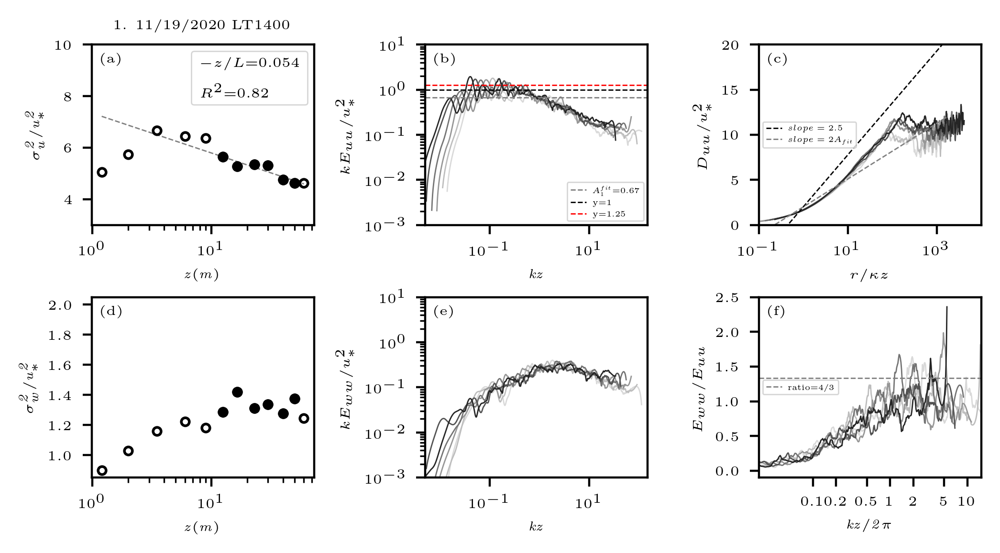

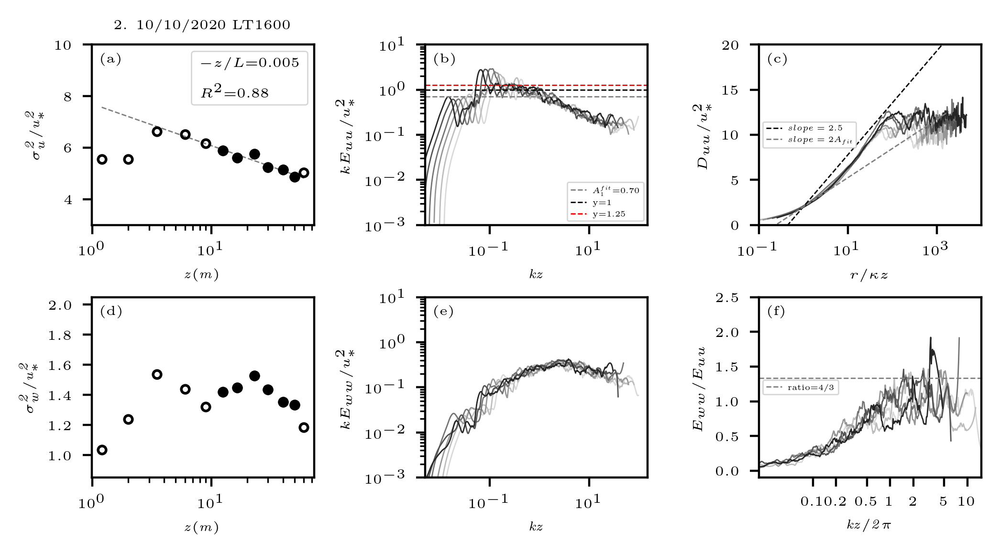

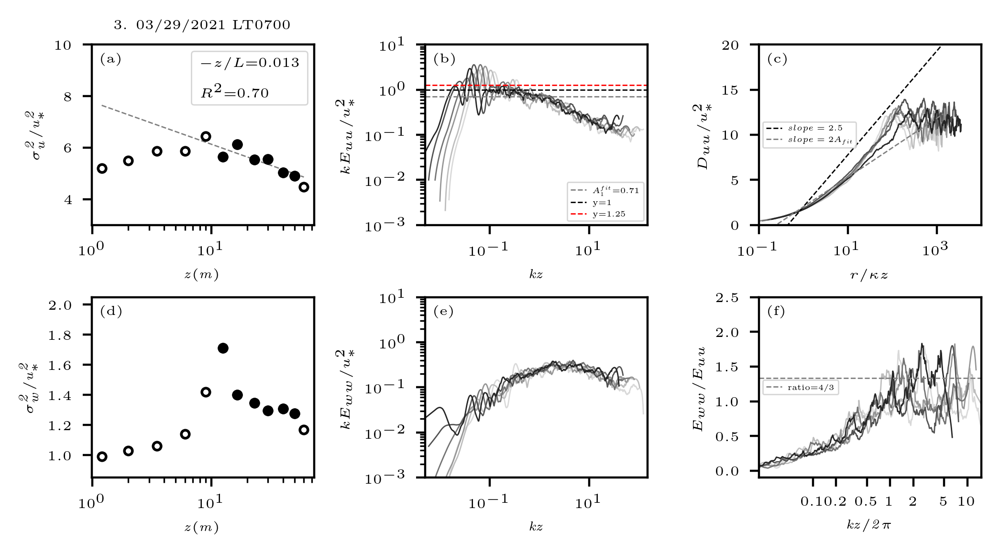

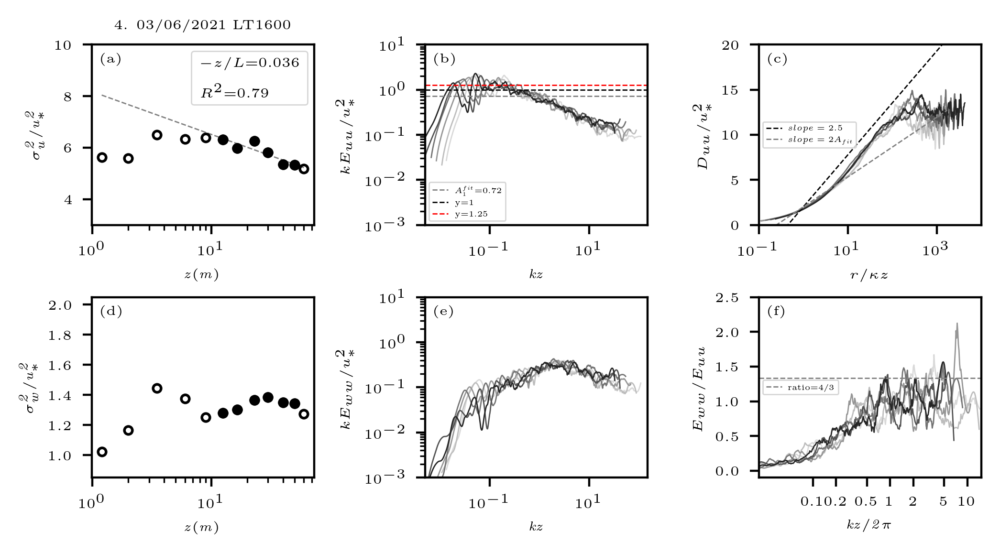

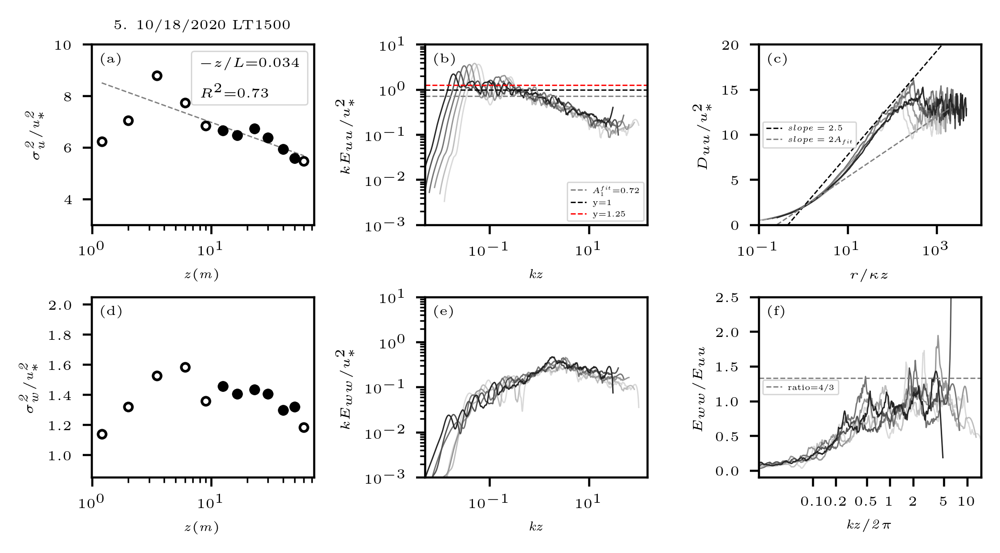

In [41]:
 
subplot = [['1', '2', '3'],
         ['4', '5', '6']]    

# for i in range(len(sorted_indices)):
for i in range(5):
    fig, axes = plt.subplot_mosaic(subplot, constrained_layout=True)
    trans = mtransforms.ScaledTranslation(-20/72, 7/72, fig.dpi_scale_trans)
    fig.set_size_inches(6,3)
    fig.set_dpi(400)
    plot_u_std_prof('(a)',axes['1'],i)
    axes['1'].set_title(f'{i+1}. '+ datetime_sort[i][0].strftime("%m/%d/%Y")+' LT'+f"{datetime_sort[i][1]:02}00",
          fontsize = font_size)
    plot_kEuu_sort('(b)',axes['2'],i)
    plot_structure_func('(c)',axes['3'],i)
    plot_w_std_prof('(d)',axes['4'],i)
    plot_kEww_sort('(e)',axes['5'],i)
    plot_isotropic_ratio('(f)',axes['6'],i)
    # Adjust spacing
    fig.subplots_adjust(wspace=0.5)  # Adjust the width space between subplots
    fig.subplots_adjust(hspace=0.4)  # Adjust the height space between subplots
    # plt.savefig(OUT_PLOT_DIR+f'combined_smoothed_Euu_Eww_ratio_profile_Duu_case{i+1}.jpg',dpi=400, bbox_inches='tight')
    plt.show()

# ****** Section 5 ******* #

# Relation between dissipation rate by Euu, Duu, Duuu

1. $\epsilon_k = C_k^{-3/2}E_u(k_x)^{3/2}k_x^{5/2}$
2. $\epsilon_2 = C_2^{-3/2}D_{1,1}(r_1)^{3/2}r_1^{-1}$ 
3. $\epsilon_3 = -5/4D_{1,1,1}(r_1)r_1^{-1}$ 

$C_e$ = 1.5, 
$C_k = 18C_e/55 \approx 0.49$,
$C_2 \approx 4.017C_k \approx 1.97$

To avoid the path averaging error: k1<17.2m^-1, r>0.36m.

## ***** Define useful functions

In [21]:
def smooth(y):
    y_smoothed = np.zeros(np.shape(y))*np.nan
    for il in range(sonum):
        # Smooth the data by column
        y_smoothed[:,il] = savgol_filter(y[:,il], window_length=41, polyorder=4)
    return y_smoothed

def plot_kEuu_sort(fig_lbl,ax1,index,if_smooth):
    strday = datetime_sort[index][0].strftime("%Y%m%d")
    ih = datetime_sort[index][1]
    key1 = f"{strday}_{ih:02}00"
    sample_Euu = log_spectrum_vars[key1]['Euu']['filt']
    u_star = u_star_sort[index]
    # Set color order
    ax1.set_prop_cycle(color=colors)
    # Compensate Euu
    Euu_compens = Ck**(-3/2)*sample_Euu['power_density']**(3/2)*sample_Euu['wavenumber']**(5/2)
    # Smooth Euu
    Euu_compens_smoothed = smooth(Euu_compens)
    # Plot kFu from higher to lower level
    for il in reversed(list_all):
        if if_smooth:
            ax1.loglog(sample_Euu['wavenumber_norm'][:,il],Euu_compens_smoothed[:,il]*z[il],linewidth=line_width)
        else:
            ax1.loglog(sample_Euu['wavenumber_norm'][:,il],Euu_compens[:,il]*z[il],linewidth=line_width)
    ax1.set_xlabel(r'$\it kz$', fontsize = font_size)
    ax1.set_ylabel(r'$C_k^{-3/2}E_u(k)^{3/2}k^{5/2}$', fontsize = font_size)
    ax1.set_xlim(5e-3, 150)
    ax1.set_ylim(1e-1, 10)
    ax1.tick_params(axis='both', labelsize=font_size)
    ax1.text(text_loc[0], text_loc[1], fig_lbl, transform=ax1.transAxes + trans,
            fontsize=font_size, zorder=2, 
            bbox={'facecolor': 'white', 'edgecolor': 'none', 'pad': 1})
    ax1.axvline(x=1,linestyle='--',color='gray', linewidth=line_width, zorder=2, 
                label = 'x=1')
    # ax1.axvline(x=3,linestyle='--',color='gray', linewidth=line_width, zorder=2, 
    #             label = 'x=1')

def plot_structure_func(fig_lbl,ax1,index):
    strday = datetime_sort[index][0].strftime("%Y%m%d")
    ih = datetime_sort[index][1]
    key1 = f"{strday}_{ih:02}00"
    sample = struc_func_vars[key1]['u']['filt']
    # Set color order
    ax1.set_prop_cycle(color=colors)
    # Compensate Duu
    Duu_compens = C2**(-3/2)*sample['structure_func']**(3/2)/sample['distance']
    for il in reversed(list_all):
        ax1.loglog(sample['distance_norm'][:,il],Duu_compens[:,il]*z[il],linewidth=line_width, 
                  linestyle='-', marker='p', markersize=mark_size)
    # Move y-axis ticks and label to the right
    ax1.yaxis.set_ticks_position('right')
    ax1.yaxis.set_label_position('right')
    ax1.set_xlabel(r'$r/z$',fontsize=font_size)
    ax1.set_ylabel(r'$C_2^{-3/2}D_{uu}(r)^{3/2}r^{-1}$',fontsize=font_size)
    ax1.tick_params(axis='both', labelsize=font_size)
    ax1.set_xlim(1e-2,100)
    ax1.set_ylim(1e-1, 10)
    ax1.text(text_loc[0], text_loc[1], fig_lbl, transform=ax1.transAxes + trans,
            fontsize=font_size, zorder=2, 
            bbox={'facecolor': 'white', 'edgecolor': 'none', 'pad': 1})
    
def plot_3rd_structure_func(fig_lbl,ax1,index):
    strday = datetime_sort[index][0].strftime("%Y%m%d")
    ih = datetime_sort[index][1]
    key1 = f"{strday}_{ih:02}00"
    sample = struc_func_3rd_vars[key1]['u']['filt']
    # Set color order
    ax1.set_prop_cycle(color=colors)
    # Compensate Duu
    Duuu_compens = (-5/4)*sample['structure_func']/sample['distance']
    for il in reversed(list_all):
        ax1.loglog(sample['distance_norm'][:,il],Duuu_compens[:,il]*z[il],linewidth=line_width, 
                  linestyle='-', marker='p', markersize=mark_size)
    # Move y-axis ticks and label to the right
    ax1.yaxis.set_ticks_position('right')
    ax1.yaxis.set_label_position('right')
    ax1.set_xlabel(r'$r/z$',fontsize=font_size)
    ax1.set_ylabel(r'$-5/4D_{uuu}(r)r^{-1}$',fontsize=font_size)
    ax1.tick_params(axis='both', labelsize=font_size)
    ax1.set_xlim(1e-2,100)
    ax1.set_ylim(1e-1, 10)
    ax1.text(text_loc[0], text_loc[1], fig_lbl, transform=ax1.transAxes + trans,
            fontsize=font_size, zorder=2, 
            bbox={'facecolor': 'white', 'edgecolor': 'none', 'pad': 1})

def plot_group(index_):
    subplot = [['1','2','3']]
    global text_loc
    text_loc = [0.18, 0.8]
    fig, axes = plt.subplot_mosaic(subplot, constrained_layout=True)
    global trans
    trans = mtransforms.ScaledTranslation(-20/72, 7/72, fig.dpi_scale_trans)
    fig.set_size_inches(6,1.5)
    fig.set_dpi(400)
    plot_kEuu_sort('(a)',axes['1'],index_,True)
    plot_structure_func('(b)',axes['2'],index_)
    plot_3rd_structure_func('(c)',axes['3'],index_)
    axes['1'].set_title(f'{index_+1}. '+ datetime_sort[i][0].strftime("%m/%d/%Y")+' LT'+f"{datetime_sort[i][1]:02}00",
          fontsize = font_size)

In [142]:
text_loc

[0.28, 0.8]

# Plot compensated Euu, Duu, Duuu

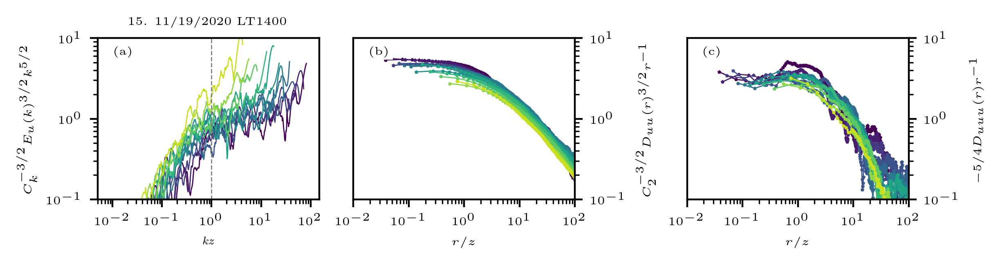

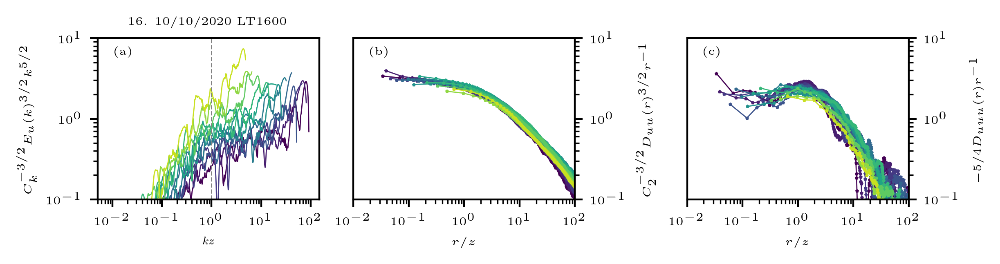

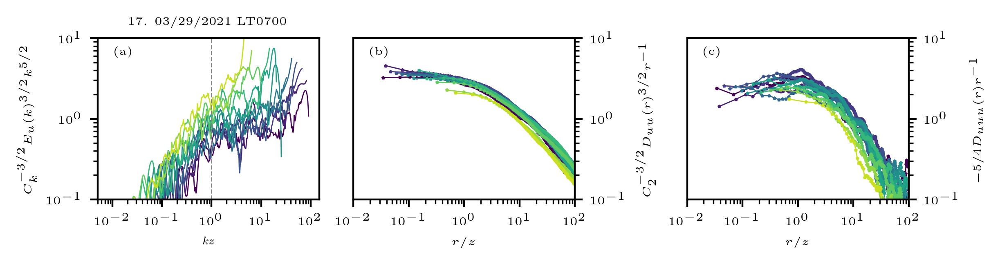

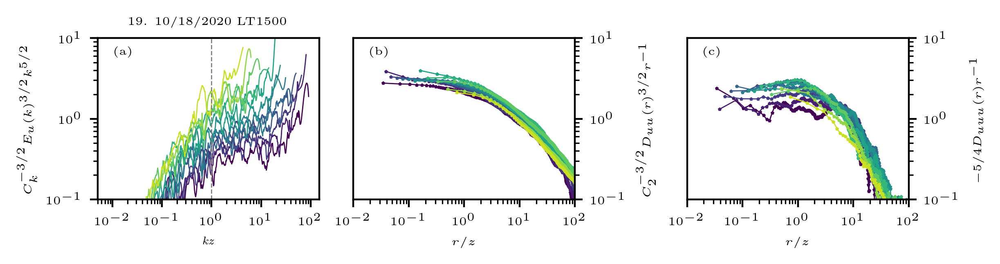

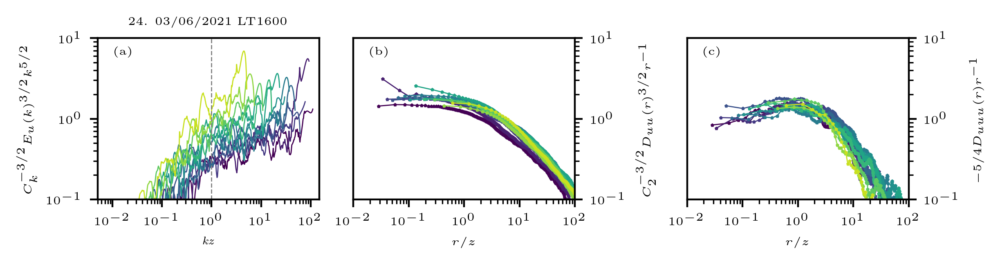

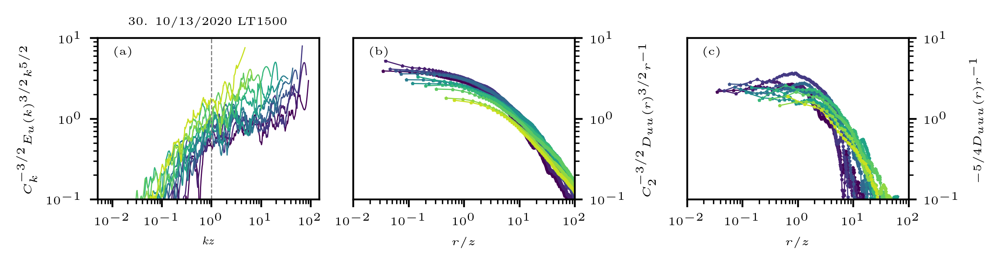

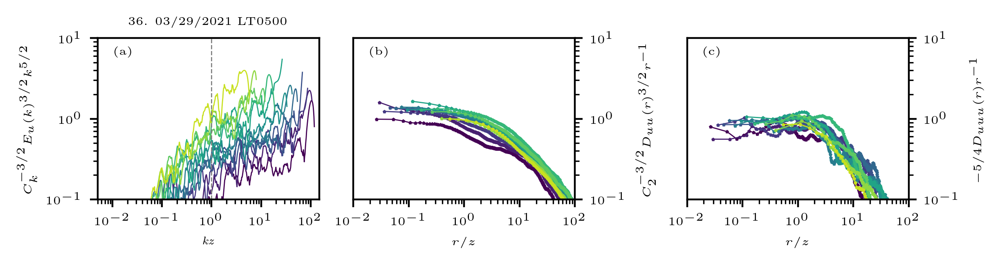

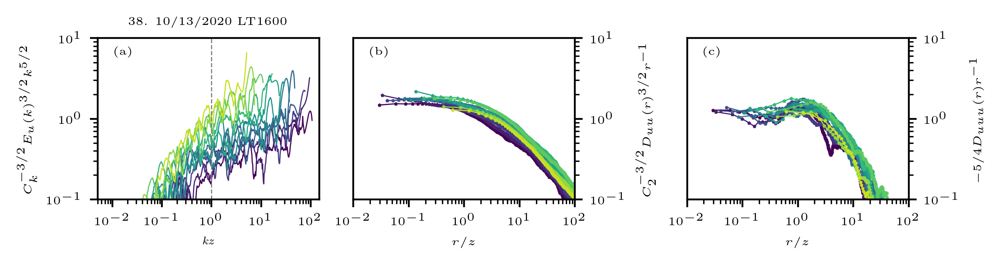

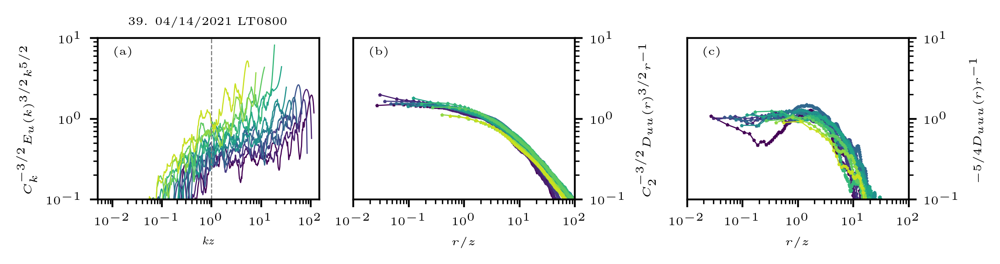

In [48]:
text_loc = [0.28, 0.8]
font_size = 5
mark_size = 0.5
line_width = 0.5

for i in range(len(group3)):
    plot_group(group3[i])
    plt.show()

# ***** Calculate and save the estimated production rate from the 3rd order polynomial of u_avg

In [370]:
save_result = True

C_a_low = np.zeros((len(Indices)))*np.nan
C_b_low = np.zeros((len(Indices)))*np.nan
C_c_low = np.zeros((len(Indices)))*np.nan
C_d_low = np.zeros((len(Indices)))*np.nan

C_a_up = np.zeros((len(Indices)))*np.nan
C_b_up = np.zeros((len(Indices)))*np.nan
C_c_up = np.zeros((len(Indices)))*np.nan
C_d_up = np.zeros((len(Indices)))*np.nan

C_a_6l = np.zeros((len(Indices)))*np.nan
C_b_6l = np.zeros((len(Indices)))*np.nan
C_c_6l = np.zeros((len(Indices)))*np.nan
C_d_6l = np.zeros((len(Indices)))*np.nan

du_dz_poly_sort = np.zeros((len(Indices),sonum))*np.nan
Prod_poly_sort = np.zeros((len(Indices),sonum))*np.nan

du_dz_poly_sort_6l = np.zeros((len(Indices),sonum))*np.nan
Prod_poly_sort_6l = np.zeros((len(Indices),sonum))*np.nan

list_up = np.array([0,1,2,3,4,5,6,7,8,9,10,11])
list_6l = np.array([4,5,6,7,8,9,10])
for i in range(len(Indices)):
    log_z = np.log(z)
    # For the bottom four levels
    x = log_z[list_bot]
    y = u_avg_sort[i][list_bot]
    # Fit the data to a third-order polynomial
    C_a_low[i], C_b_low[i] = np.polyfit(x, y, 1)
    
    # For the 12 levels
    x = log_z[list_up]
    y = u_avg_sort[i][list_up]
    # Fit the data to a third-order polynomial
    C_a_up[i], C_b_up[i], C_c_up[i], C_d_up[i] = np.polyfit(x, y, 3)
    
    # For the 6 levels
    x = log_z[list_6l]
    y = u_avg_sort[i][list_6l]
    # Fit the data to a third-order polynomial
    C_a_6l[i], C_b_6l[i], C_c_6l[i], C_d_6l[i] = np.polyfit(x, y, 3)
    
    # # Calculate the du_dz for the bottom five levels
    # du_dz_poly_sort[i,0:5] = (3*C_a_low[i]*log_z[0:5]**2 + 2*C_b_low[i]*log_z[0:5] + C_c_low[i])/z[0:5]
    # Calculate the du_dz from 12 levels
    du_dz_poly_sort[i,:] = (3*C_a_up[i]*log_z[:]**2 + 2*C_b_up[i]*log_z[:] + C_c_up[i])/z[:]
    Prod_poly_sort[i,:] = u_star_sort[i]**2*du_dz_poly_sort[i,:]
    
    # Calculate the du_dz for the 6 levels from 5th to 11th
    du_dz_poly_sort_6l[i,:] = (3*C_a_6l[i]*log_z[:]**2 + 2*C_b_6l[i]*log_z[:] + C_c_6l[i])/z[:]
    Prod_poly_sort_6l[i,:] = u_star_sort[i]**2*du_dz_poly_sort_6l[i,:]

if save_result:
    print("saving results")
    # List of variable names and corresponding data arrays
variables_to_save = [
    # ('C_a_low', C_a_low),
    # ('C_b_low', C_b_low),
    # ('C_c_low', C_c_low),
    # ('C_d_low', C_d_low),
    # ('C_a_up', C_a_up),
    # ('C_b_up', C_b_up),
    # ('C_c_up', C_c_up),
    # ('C_d_up', C_d_up),
    # ('C_a_6l', C_a_6l),
    # ('C_b_6l', C_b_6l),
    # ('C_c_6l', C_c_6l),
    # ('C_d_6l', C_d_6l),
    ('du_dz_poly_sort', du_dz_poly_sort),
    ('Prod_poly_sort', Prod_poly_sort),
    ('du_dz_poly_sort_6l', du_dz_poly_sort_6l),
    ('Prod_poly_sort_6l', Prod_poly_sort_6l)
]

# Loop through the list and save each array
for var_name, var_data in variables_to_save:
    np.save(os.path.join(OUT_DIR, f'{var_name}.npy'), var_data)

saving results


# Plot the u_avg profile

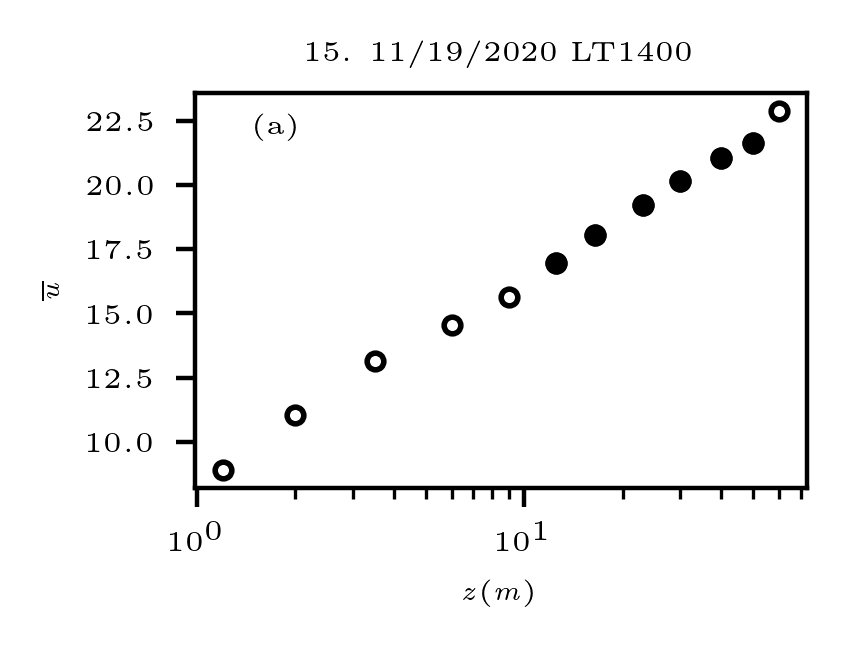

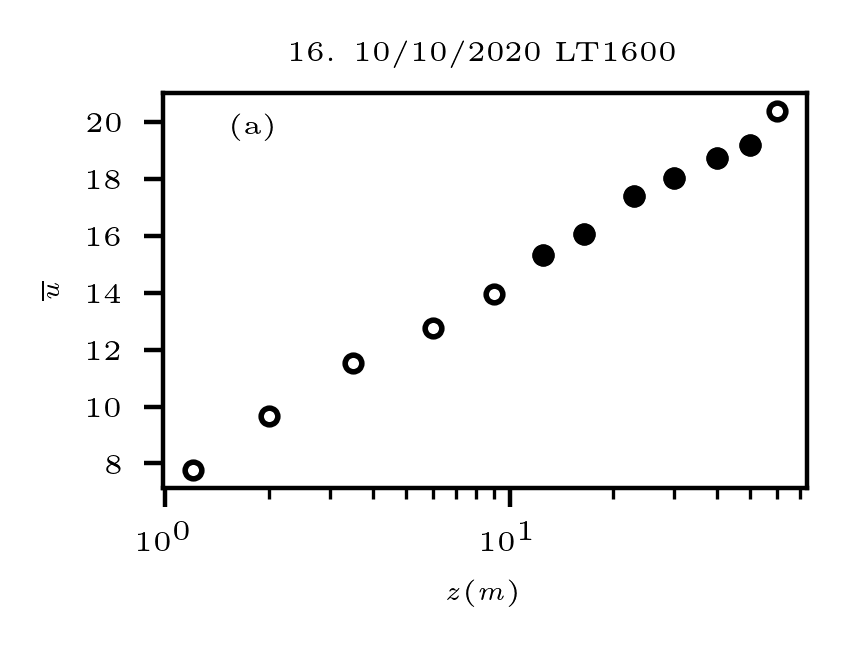

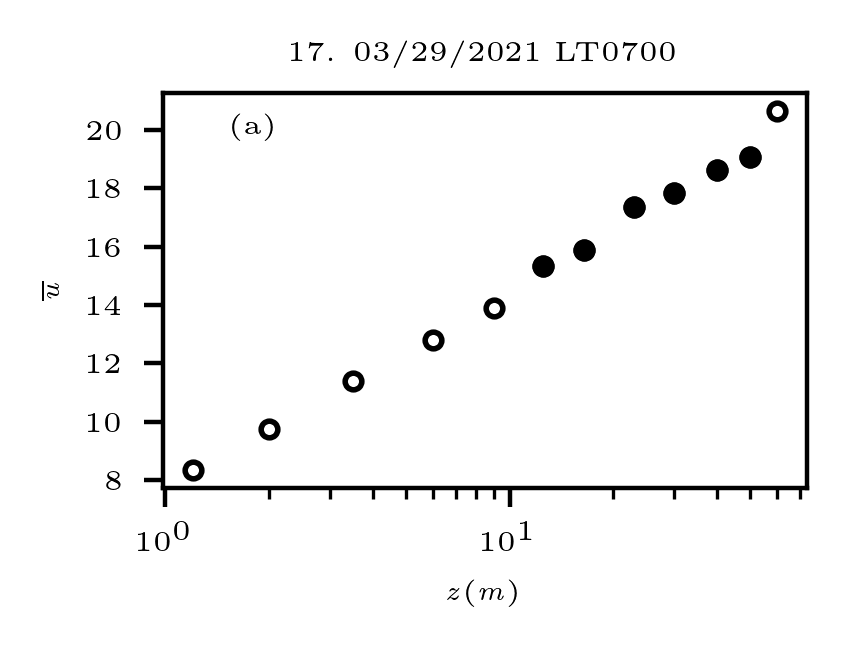

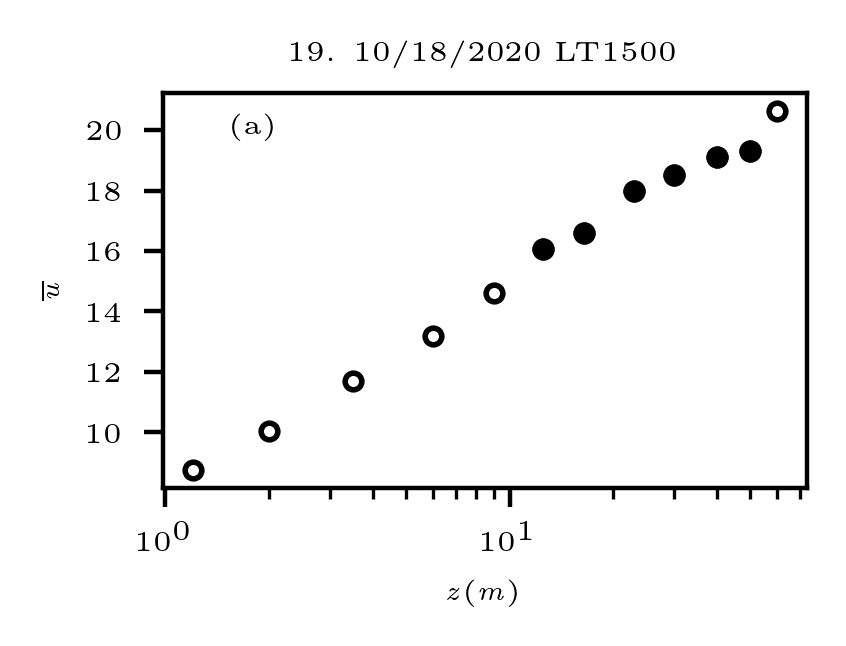

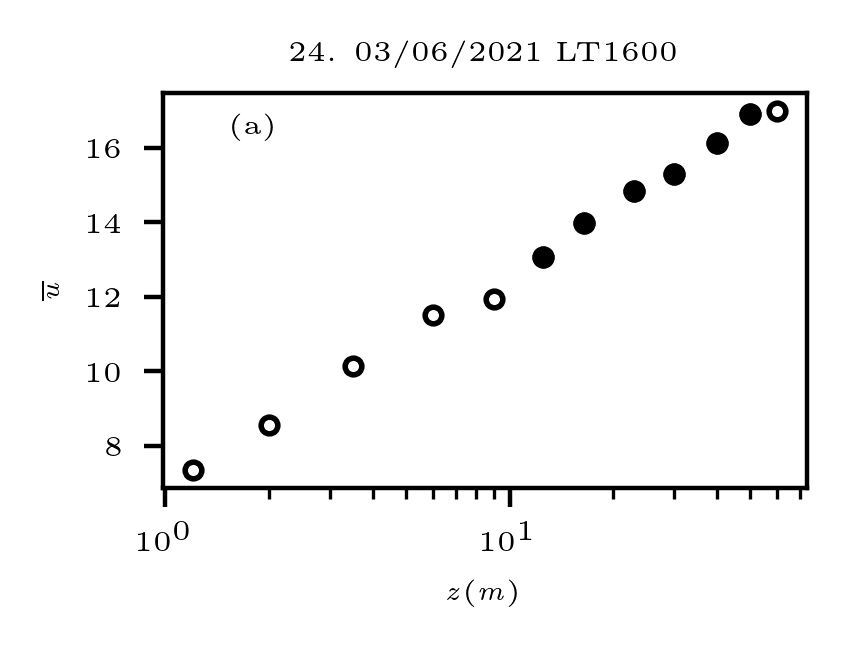

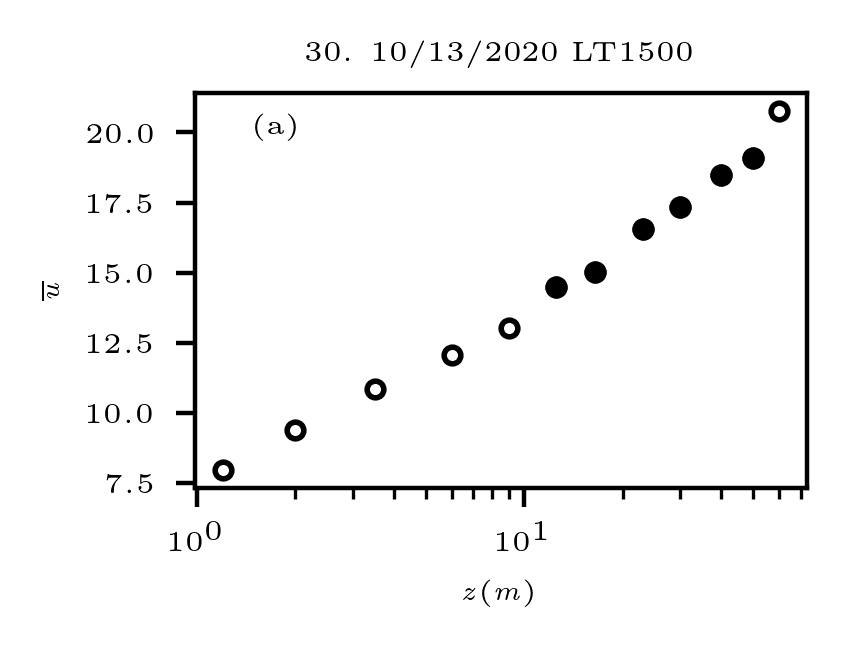

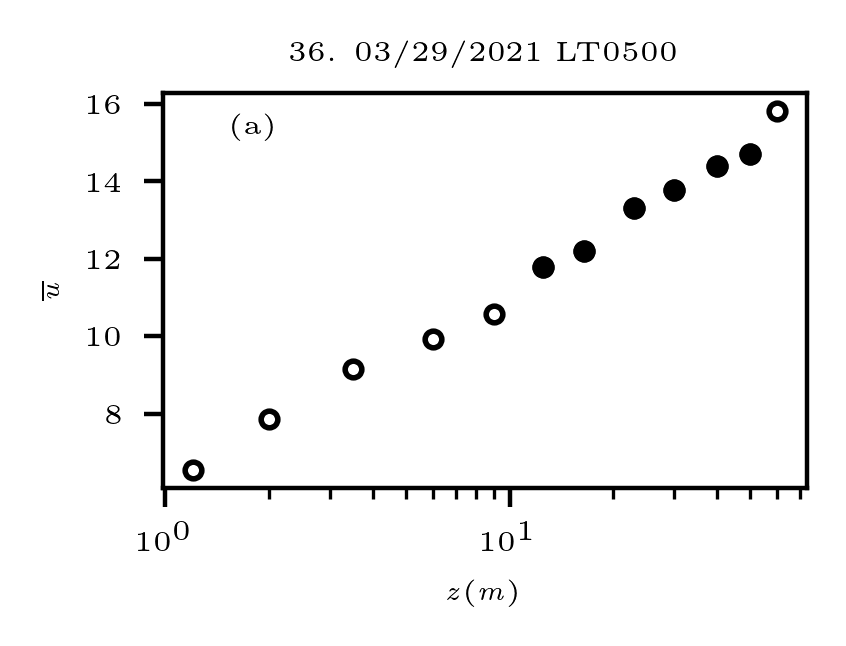

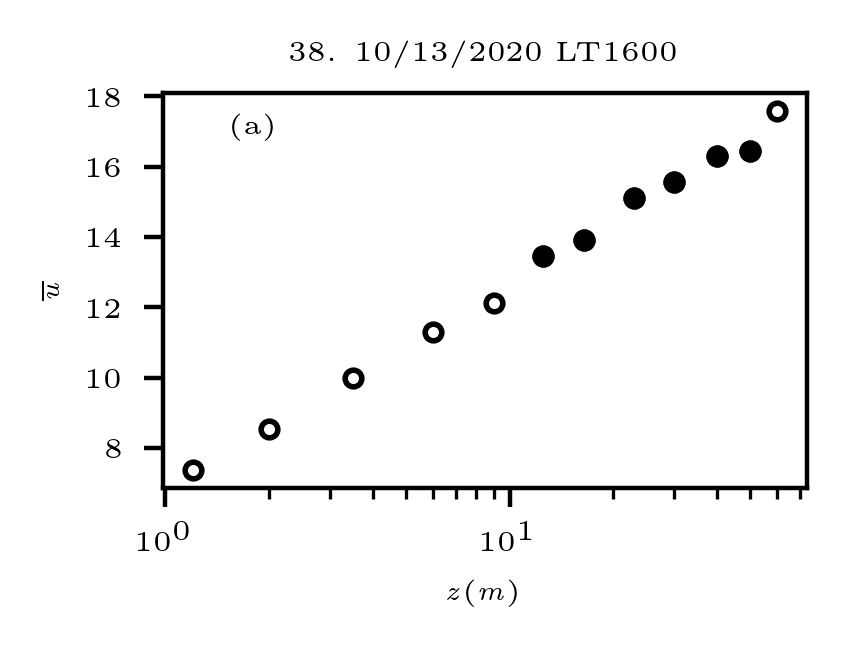

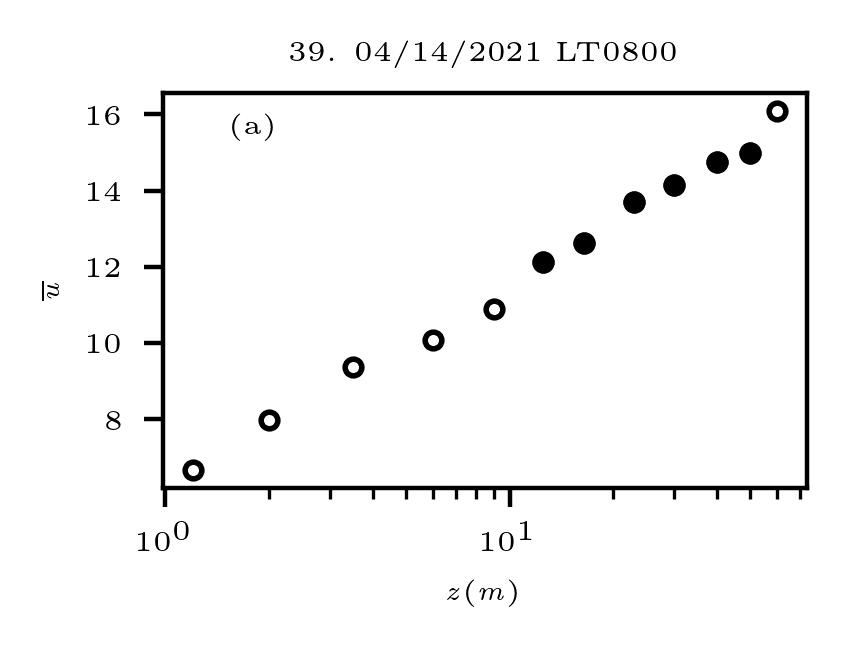

In [51]:
def plot_u_avg_prof(fig_lbl,ax1,index):
    # plot u_avg   
    ax1.plot(z[list_all],u_avg_sort[index,list_all].T,'o',color = 'black', 
             markerfacecolor='none', markersize=mark_size)  
    ax1.plot(z[list_sel],u_avg_sort[index,list_sel].T,'o',color = 'black',markerfacecolor='black', markersize=mark_size)
    # linear regression
    # line = (-A1_sort[index])* np.log(z[list_all])+intercept_sort[index]
    # ax1.plot(z[list_all], line,color='gray', linestyle='--', linewidth=line_width, zorder=1)
    
    # semilog scale
    ax1.set_xscale('log')
    ax1.set_xlabel(r'$\it z (m)$',fontsize=font_size)
    ax1.set_ylabel(r'$\it \overline{u}$',fontsize=font_size) 
    ax1.tick_params(axis='both', labelsize=font_size)
    # ax1.set_ylim(3, 10)
    ax1.text(text_loc[0], text_loc[1], fig_lbl, transform=ax1.transAxes + trans,
            fontsize=font_size, zorder=2, 
            bbox={'facecolor': 'white', 'edgecolor': 'none', 'pad': 1})

def plot_extra_group(index_):
    subplot = [['1']]
    fig, axes = plt.subplot_mosaic(subplot, constrained_layout=True)
    global trans
    trans = mtransforms.ScaledTranslation(-20/72, 7/72, fig.dpi_scale_trans)
    fig.set_size_inches(2,1.5)
    fig.set_dpi(400)
    plot_u_avg_prof('(a)',axes['1'],index_)
    axes['1'].set_title(f'{index_+1}. '+ datetime_sort[i][0].strftime("%m/%d/%Y")+' LT'+f"{datetime_sort[i][1]:02}00",
          fontsize = font_size)

text_loc = [0.28, 0.8]
font_size = 5
mark_size = 3
line_width = 0.5
# Line parameters
x01 = np.logspace(-1, 2, num=100)
x02 = np.logspace(-1, 2, num=100)
# Define the intersection points
x_right = 10
y_right = 0.4
x_right2 = 5
y_right2 = 0.2

for i in range(len(group3)):
    plot_extra_group(group3[i])
    plt.show()

# Plot D2 and D3 before normalization

In [52]:
# Line parameters
x01 = np.logspace(-1, 2, num=100)
# Define the intersection points
x1 = 1
y1 = 3
x2 = 1
y2 = 1
def plot_structure_func(fig_lbl,ax1,index):
    strday = datetime_sort[index][0].strftime("%Y%m%d")
    ih = datetime_sort[index][1]
    key1 = f"{strday}_{ih:02}00"
    sample = struc_func_vars[key1]['u']['filt']
    # Set color order
    ax1.set_prop_cycle(color=colors)
    for il in reversed(list_all):
        ax1.loglog(sample['distance'][:,il],sample['structure_func'][:,il],linewidth=line_width, 
                  linestyle='-', marker='p', markersize=mark_size)
    ax1.set_xlabel(r'$r$',fontsize=font_size)
    ax1.set_ylabel(r'$D_{uu}$',fontsize=font_size)
    ax1.tick_params(axis='both', labelsize=font_size)
    ax1.set_xlim(1e-1,50)
    ax1.set_ylim(1e-1,10)
    ax1.text(text_loc[0], text_loc[1], fig_lbl, transform=ax1.transAxes + trans,
            fontsize=font_size, zorder=2, 
            bbox={'facecolor': 'white', 'edgecolor': 'none', 'pad': 1})
    # Creating the line y = A * x^(2/3)
    A = y1 * x1**(-2/3)
    line1_y = A * x01**(2/3)

    # Plotting the reference lines
    ax1.plot(x01,line1_y, 'red', linewidth=line_width)

def plot_3rd_structure_func(fig_lbl,ax1,index):
    strday = datetime_sort[index][0].strftime("%Y%m%d")
    ih = datetime_sort[index][1]
    key1 = f"{strday}_{ih:02}00"
    sample = struc_func_3rd_vars[key1]['u']['filt']
    # Set color order
    ax1.set_prop_cycle(color=colors)
    for il in reversed(list_all):
        ax1.loglog(sample['distance'][:,il],-sample['structure_func'][:,il],linewidth=line_width, 
                   linestyle='-', marker='p', markersize=mark_size)
    ax1.set_xlabel(r'$r$',fontsize=font_size)
    ax1.set_ylabel(r'$D_{uuu}$',fontsize=font_size)
    ax1.tick_params(axis='both', labelsize=font_size)
    ax1.set_xlim(1e-1,50)
    ax1.set_ylim(1e-2,20)
    ax1.text(text_loc[0], text_loc[1], fig_lbl, transform=ax1.transAxes + trans,
            fontsize=font_size, zorder=2, 
            bbox={'facecolor': 'white', 'edgecolor': 'none', 'pad': 1})
    # Creating the line y = A * x
    A = y2 / x2
    line1_y = A * x01

    # Plotting the reference lines
    ax1.plot(x01,line1_y, 'red', linewidth=line_width)


def plot_extra_group(index_):
    subplot = [['1', '2']]
    fig, axes = plt.subplot_mosaic(subplot, constrained_layout=True)
    global trans
    trans = mtransforms.ScaledTranslation(-20/72, 7/72, fig.dpi_scale_trans)
    fig.set_size_inches(4,1.5)
    fig.set_dpi(400)
    plot_structure_func('(a)',axes['1'],index_)
    axes['1'].set_title(f'{index_+1}. '+ datetime_sort[i][0].strftime("%m/%d/%Y")+' LT'+f"{datetime_sort[i][1]:02}00",
          fontsize = font_size)
    plot_3rd_structure_func('(b)',axes['2'],index_) 
    

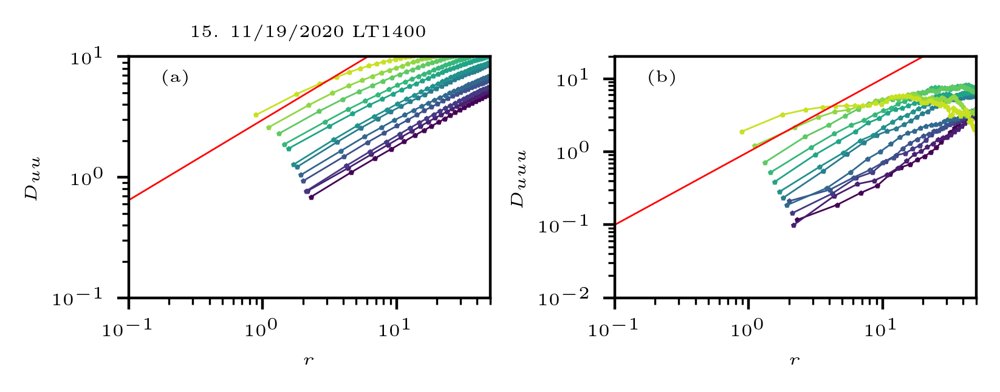

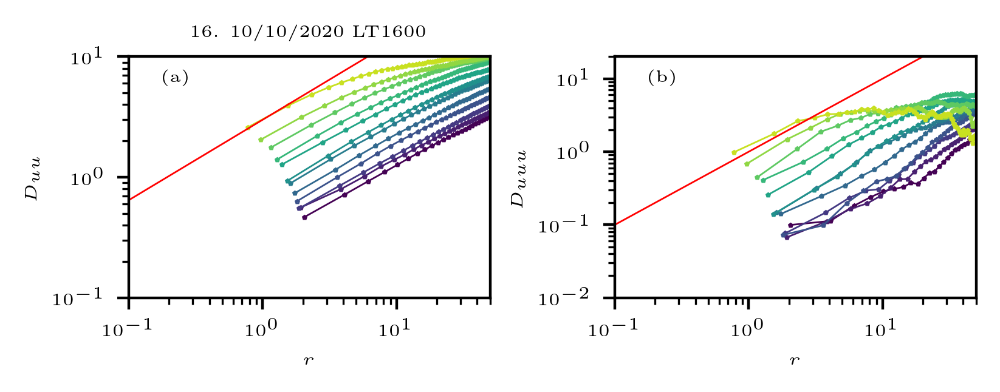

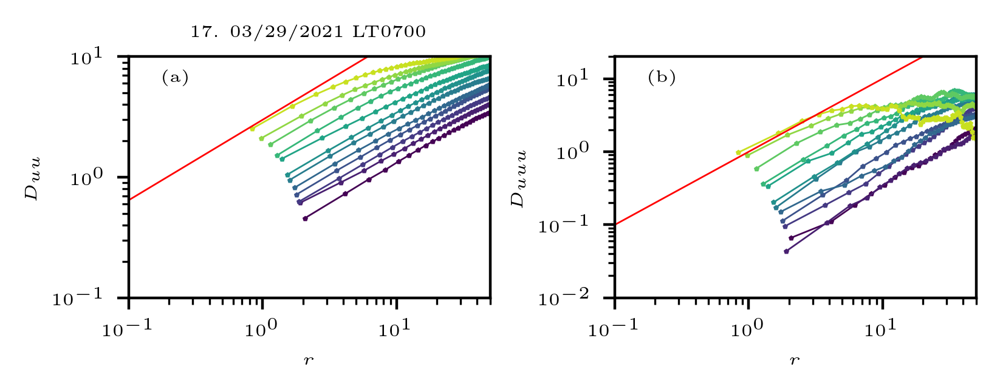

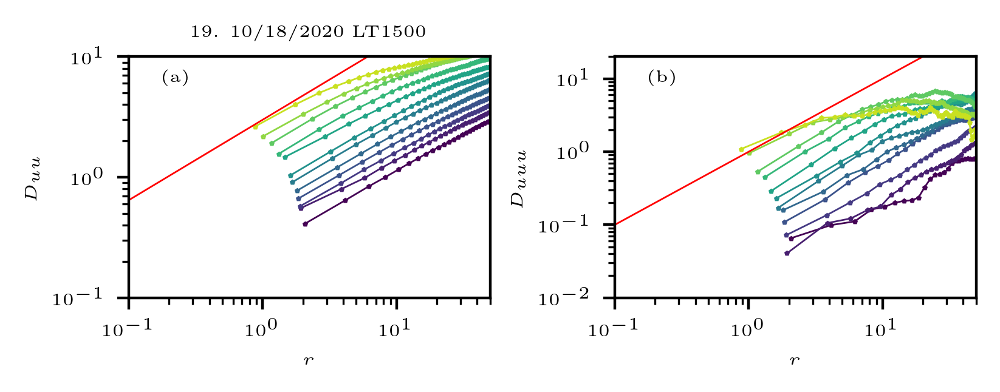

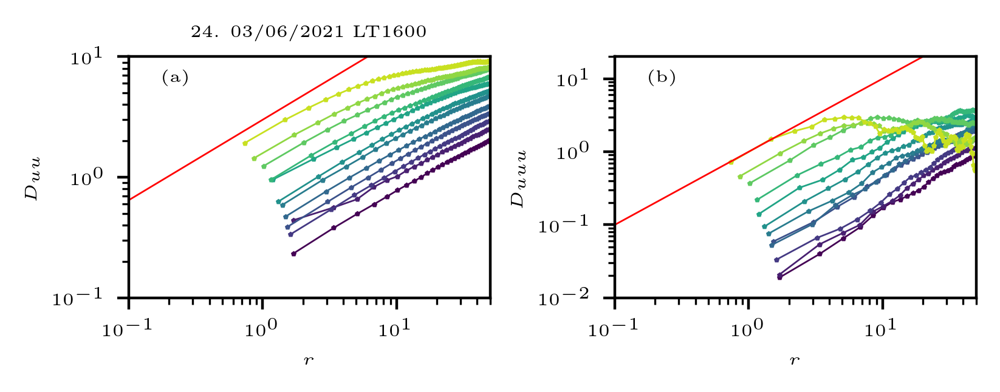

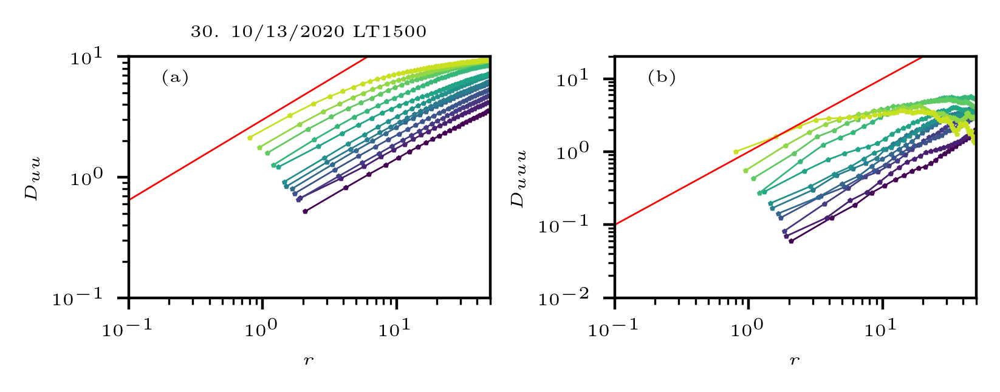

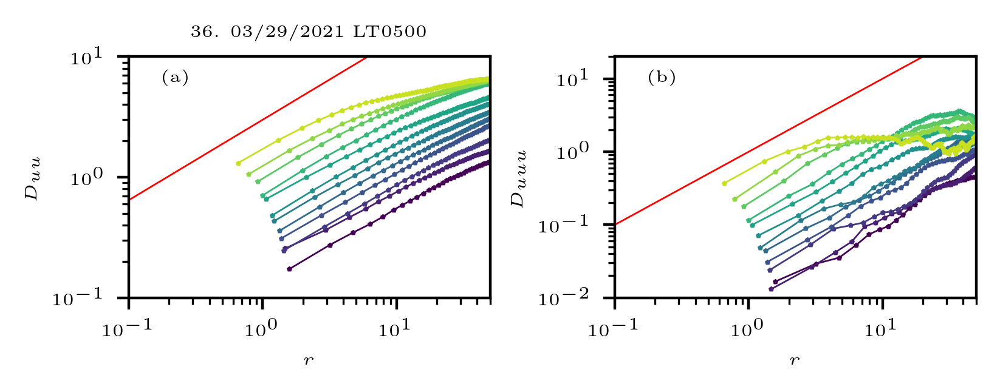

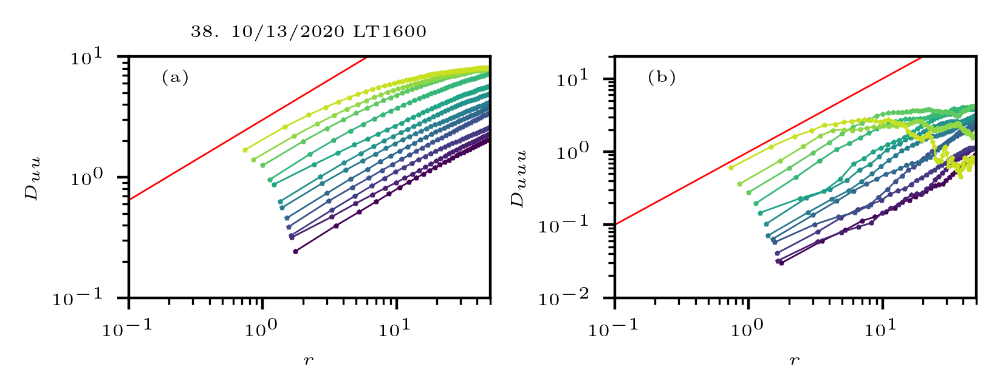

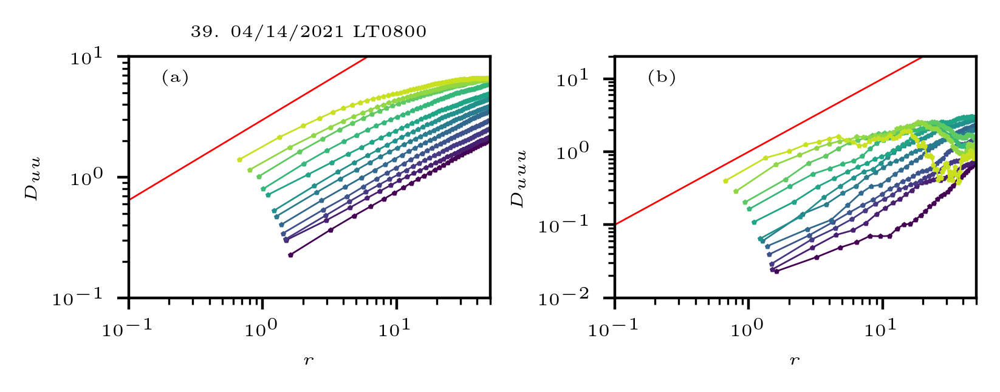

In [54]:
text_loc = [0.28, 0.8]
font_size = 5
mark_size = 0.5
line_width = 0.5

for i in range(len(group3)):
    plot_extra_group(group3[i])
    plt.show()

# Plot k against kEuu after smoothing for 12 levels

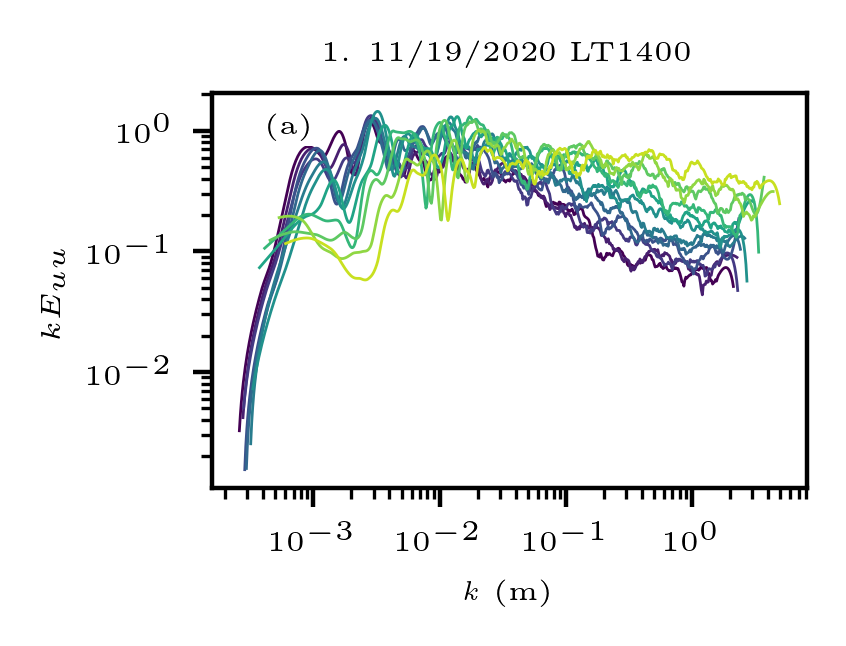

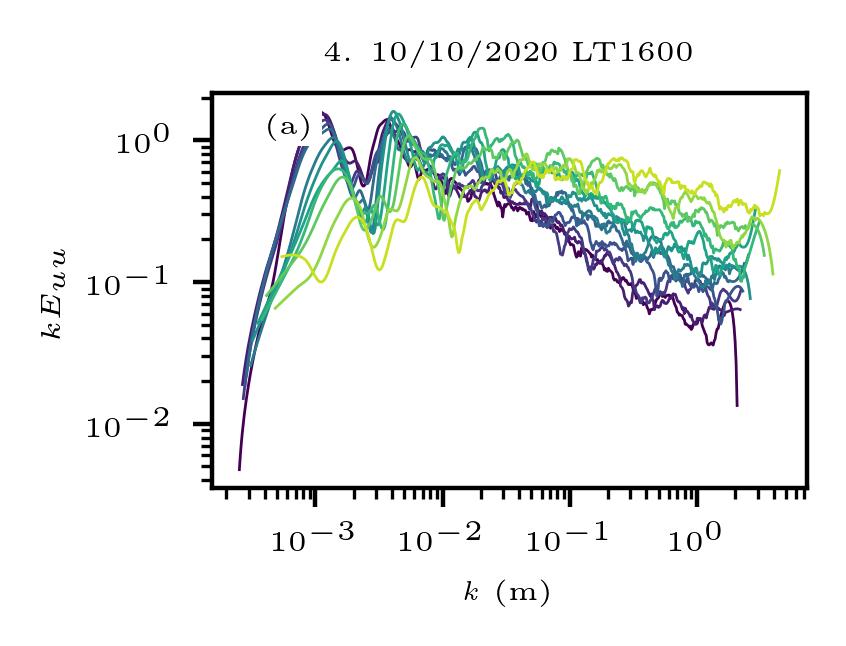

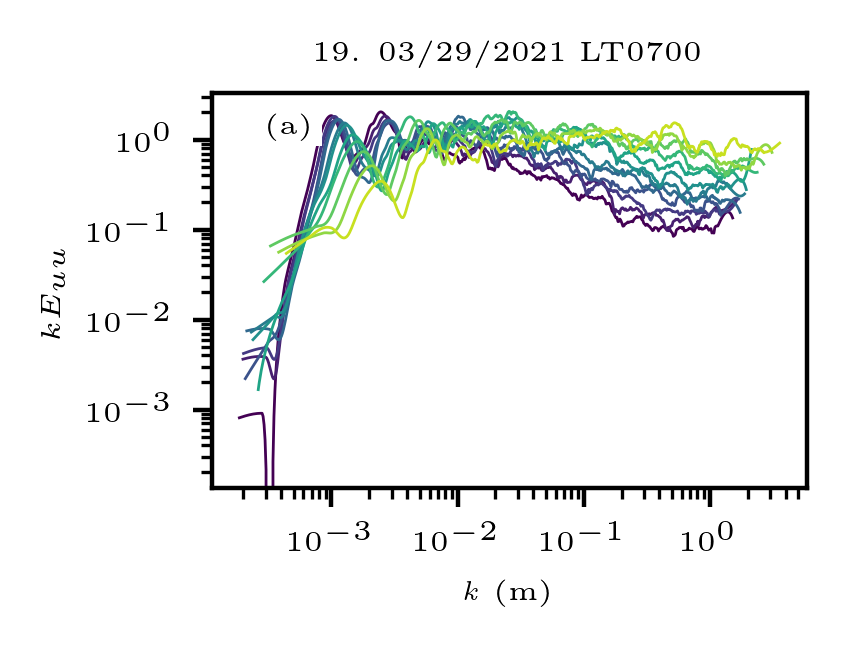

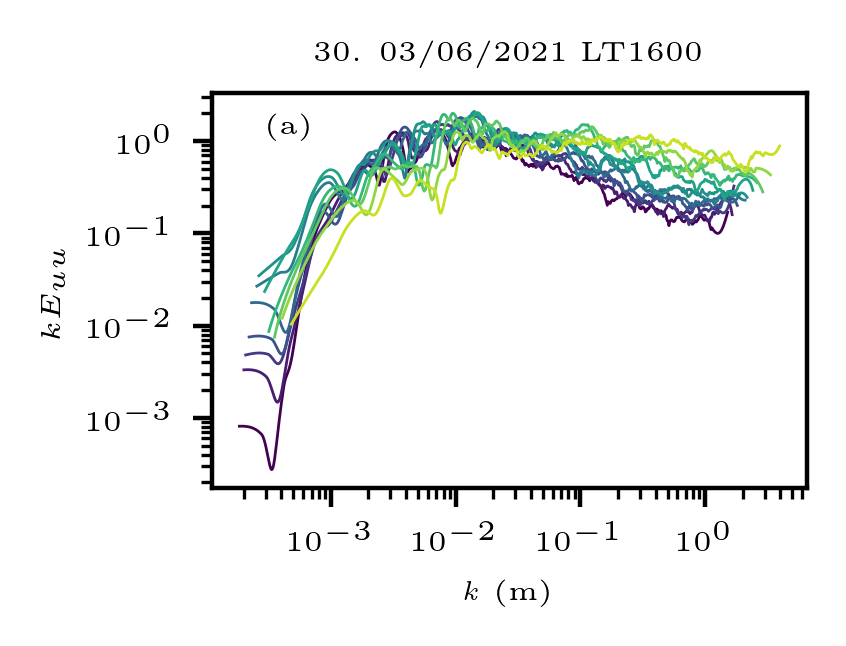

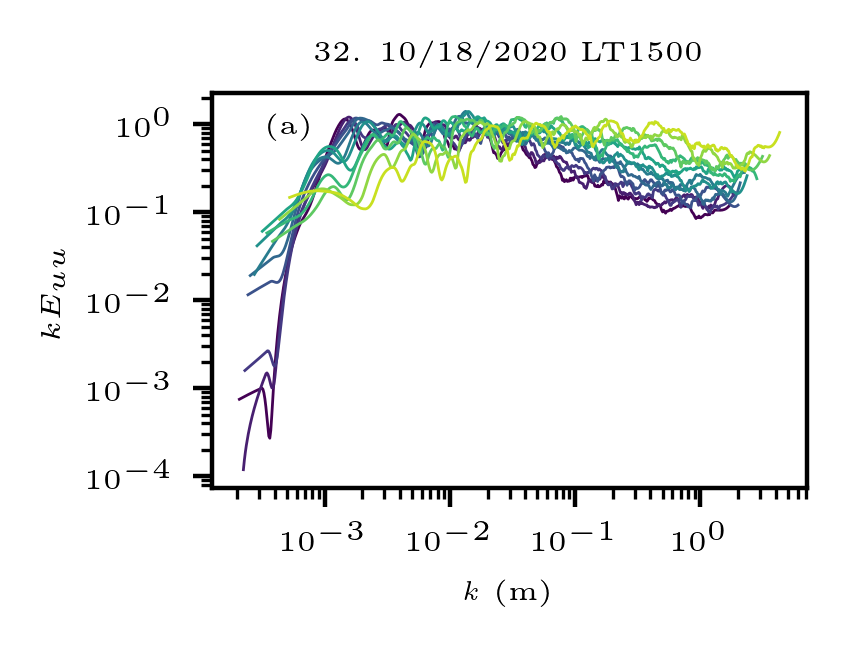

...

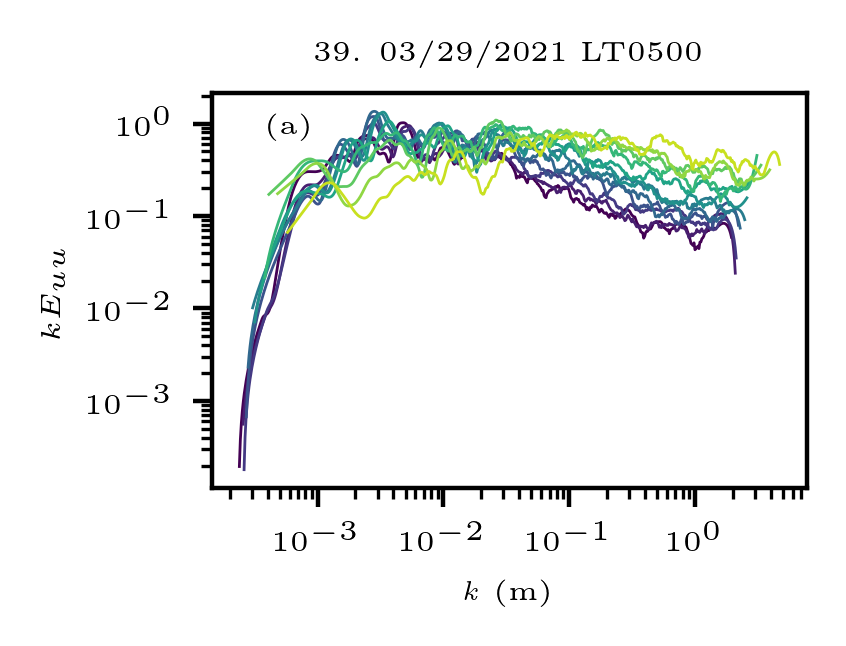

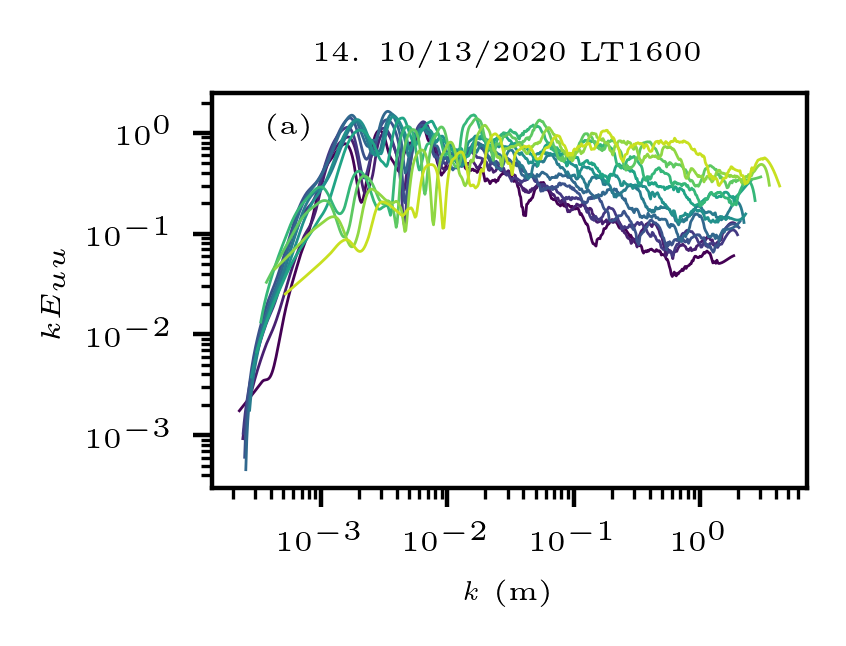

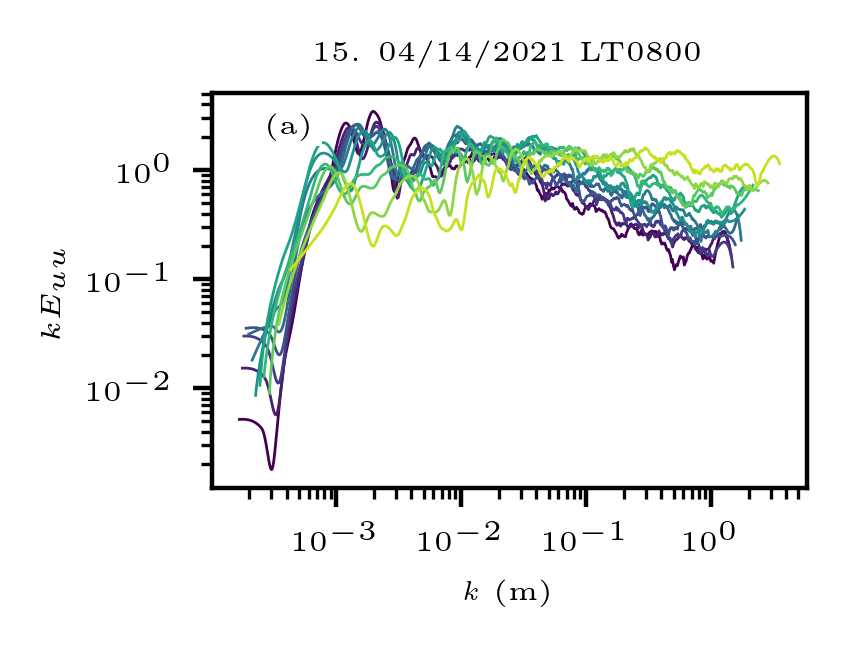

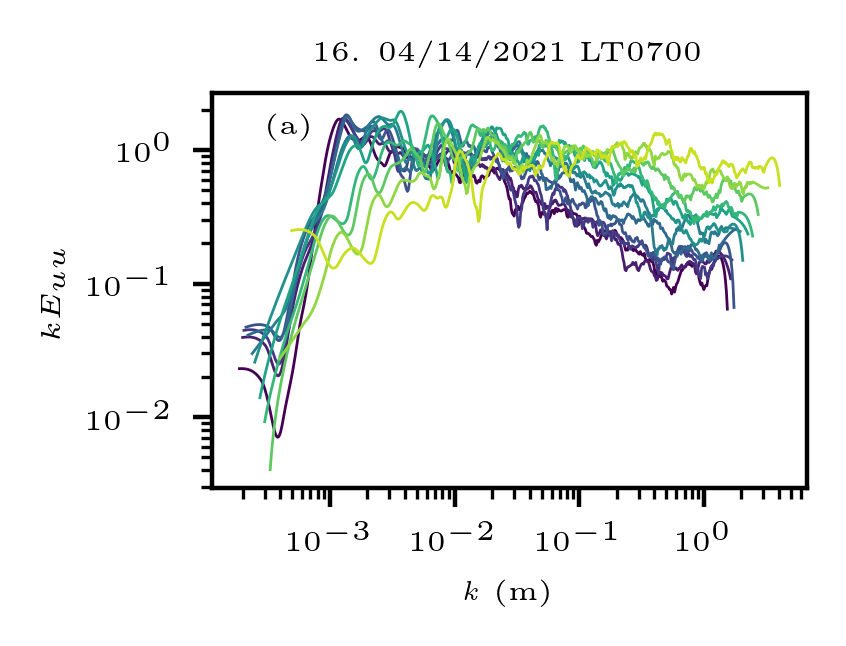

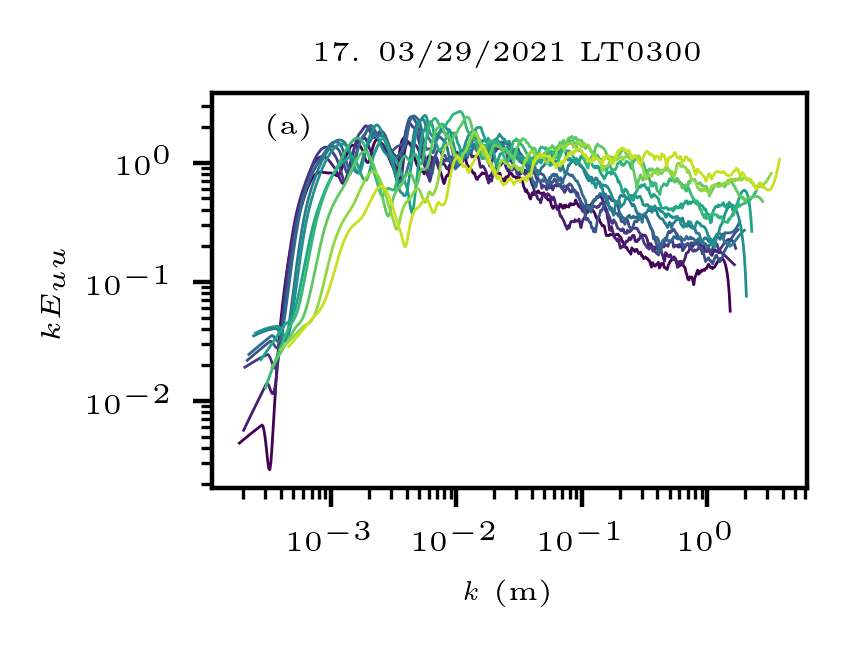

In [63]:
def plot_kEuu_sort(fig_lbl,ax1,index):
    strday = datetime_sort[index][0].strftime("%Y%m%d")
    ih = datetime_sort[index][1]
    key1 = f"{strday}_{ih:02}00"
    sample_Euu = log_spectrum_vars[key1]['Euu']['filt']
    u_star = u_star_sort[index]
    # Set color order
    ax1.set_prop_cycle(color=colors)
    
    # Plot kFu from higher to lower level
    kEuu = sample_Euu['Euu_norm_smoothed']*u_star**2
    for il in reversed(list_all):
        ax1.loglog(sample_Euu['wavenumber'][:,il],kEuu[:,il],linewidth=line_width)
    ax1.set_xlabel(r'$\it k$ (m)', fontsize = font_size)
    ax1.set_ylabel(r'$kE_{uu}$', fontsize = font_size)
    # ax1.set_xlim(5e-3, 150)
    # ax1.set_ylim(1e-3, 1e1)
    ax1.tick_params(axis='both', labelsize=font_size)
    ax1.text(text_loc[0], text_loc[1], fig_lbl, transform=ax1.transAxes + trans,
            fontsize=font_size, zorder=2, 
            bbox={'facecolor': 'white', 'edgecolor': 'none', 'pad': 1})
    
    # ax1.axvline(x=1,linestyle='--',color='gray', linewidth=line_width, zorder=2, 
    #             label = 'x=1')
    # legend = ax1.legend(fontsize=font_size-2)
    # legend.get_frame().set_linewidth(line_width)
    
    # Creating the line y = A * x^(-2/3)
    A = y_right *x_right**(2/3)
    line1_y = A * x01**(-2/3)

    # Plotting the reference lines
    # ax1.plot(x01,line1_y, 'red', linewidth=line_width)
def plot_extra_group(index_):
    subplot = [['1']]
    fig, axes = plt.subplot_mosaic(subplot, constrained_layout=True)
    global trans
    trans = mtransforms.ScaledTranslation(-20/72, 7/72, fig.dpi_scale_trans)
    fig.set_size_inches(2,1.5)
    fig.set_dpi(400)
    plot_kEuu_sort('(a)',axes['1'],index_)
    axes['1'].set_title(f'{index_+1}. '+ datetime_sort[i][0].strftime("%m/%d/%Y")+' LT'+f"{datetime_sort[i][1]:02}00",
          fontsize = font_size)

text_loc = [0.28, 0.8]
font_size = 5
mark_size = 3
line_width = 0.5
# Line parameters
x01 = np.logspace(-1, 2, num=100)
x02 = np.logspace(-1, 2, num=100)
# Define the intersection points
x_right = 10
y_right = 0.4
x_right2 = 5
y_right2 = 0.2

for i in range(len(group3)):
    plot_extra_group(group3[i])
    plt.show()

# ***** Calculate and save the dissipation rate and ratio
$P=-\overline{u'w'}\frac{\partial U}{\partial z}=u_*^2\frac{\partial U}{\partial z}$

1. Direct method based on local isotropy:

$\epsilon = 15\nu \overline{{(\frac{\partial u_1}{\partial x})}^2} = 15\nu \frac{1}{U^2}\overline{{(\frac{\partial u_1}{\partial t})}^2}$

2. Second-order structure function and the Fourier counterpart:

$D_2(r)=C_2\epsilon^{2/3}r^{2/3}$ 

$E_u(k_x)=C_k\epsilon^{2/3}k_x^{-5/3}$

$C_e$ = 1.5, 
$C_k = 18C_e/55 \approx 0.49$,
$C_2 \approx 4.017C_k \approx 1.97$

3. Third-order structure funtion:

$D_3(r)=-4/5\epsilon r$

In [388]:
save_result = True
def cal_dissipation(ins_ts):  
    distance = np.minimum(1,z/2)
    var_mean = np.nanmean(ins_ts,0)
    r = distance/var_mean*frequency
    # print(r)
    r = np.round(r).astype(int)
    D2 = np.zeros((sonum))*np.nan
    D3 = np.zeros((sonum))*np.nan
    epsilon_2 = np.zeros((sonum))*np.nan
    epsilon_3 = np.zeros((sonum))*np.nan
    for il in range(sonum):
        # print(r[il])
        r[il] = np.maximum(1,r[il])
        squared_diffs = (ins_ts[:,il][:-r[il]] - ins_ts[:,il][r[il]:])**2
        cubic_diffs = (ins_ts[:,il][:-r[il]] - ins_ts[:,il][r[il]:])**3
        D2[il] = np.nanmean(squared_diffs)
        D3[il] = np.nanmean(cubic_diffs)
        epsilon_2[il] = C2**(-3/2)*D2[il]**(3/2)/distance[il]
        epsilon_3[il] = -5/4*D3[il]/distance[il]
    return epsilon_2,epsilon_3

# Initialization
Prod_rate = np.zeros((np.sum(mask_all),sonum))*np.nan
Diss_D2_rate = np.zeros((np.sum(mask_all),sonum))*np.nan
Diss_D3_rate = np.zeros((np.sum(mask_all),sonum))*np.nan

for i in range(len(Indices)):
    id_ = Indices[i]
    # Loop through the 39 neutral hours
    strday = str(datetime_all[id_][0].strftime("%Y%m%d"))
    ih = datetime_all[id_][1]
    key1 = f"{strday}_{ih:02}00"
    kappa_fit = fit_data_vars['var1D_uavg']['filt']['kappa_fit'][id_]
    # load u_ins data
    u_ins_filt = np.load(f"{IN_INS_DIR}u_dspk_planar_filt_{key1}.npy", allow_pickle=True)
    # Calculte production rate
    du_dz = u_star[i]/kappa_fit/z
    Prod_rate[i,:] = u_star[i]**2*du_dz
    # Calculate dissipation rate
    Diss_D2_rate[i,:],Diss_D3_rate[i,:] = cal_dissipation(u_ins_filt)
         
Prod_rate_sort = Prod_rate[sorted_indices]
Diss_rate_D2_sort = Diss_D2_rate[sorted_indices]
Diss_rate_D3_sort = Diss_D3_rate[sorted_indices]
P_D_ratio_D2_sort = Prod_rate_sort/Diss_rate_D2_sort
P_D_ratio_D3_sort = Prod_rate_sort/Diss_rate_D3_sort

if save_result:
    print("saving result")
    # List of variable names and corresponding data arrays
    variables_to_save = [
        ('Prod_rate_sort', Prod_rate_sort),
        ('Diss_rate_D2_sort', Diss_rate_D2_sort),
        ('Diss_rate_D3_sort', Diss_rate_D3_sort),
        ('P_D_ratio_D2_sort', P_D_ratio_D2_sort),
        ('P_D_ratio_D3_sort', P_D_ratio_D3_sort),
    ]
    
    # Loop through the list and save each array
    for var_name, var_data in variables_to_save:
        np.save(os.path.join(OUT_DIR, f'{var_name}.npy'), var_data)

saving result


# Plot E_D3 against E_D2

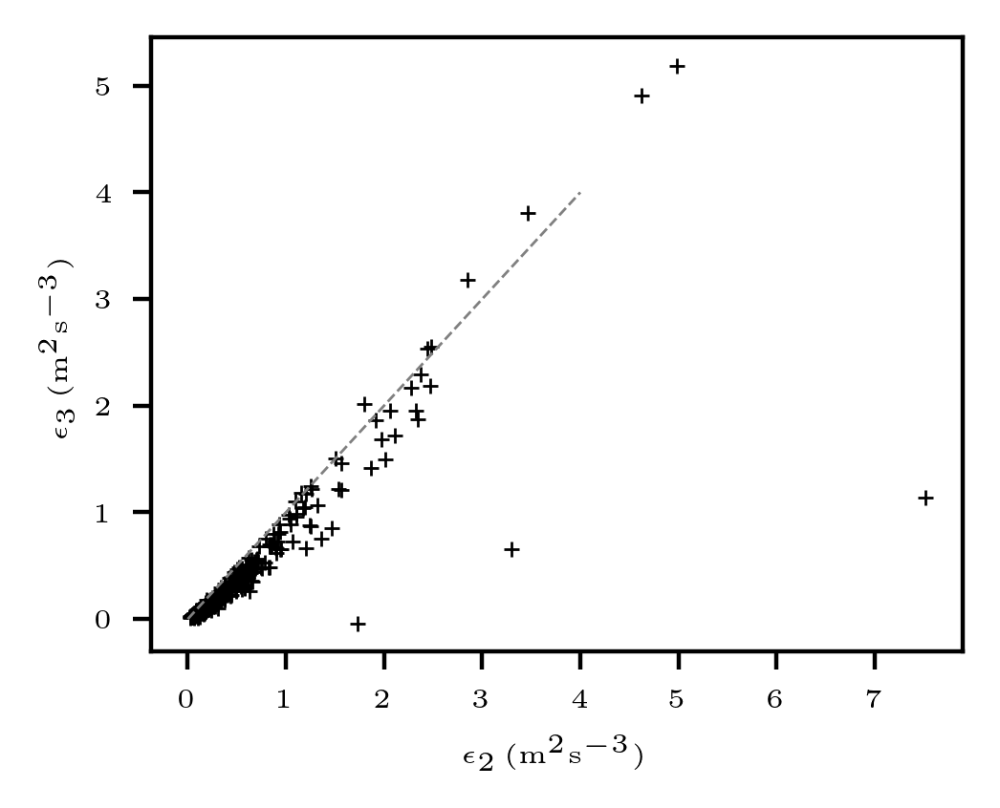

In [389]:
flat_D2 = Diss_rate_D2_sort.flatten()
flat_D3 = Diss_rate_D3_sort.flatten()
font_size = 5
mark_size = 3
line_width = 0.5
subplot = [['1']]
fig, axes = plt.subplot_mosaic(subplot, constrained_layout=True)
trans = mtransforms.ScaledTranslation(-20/72, 7/72, fig.dpi_scale_trans)
fig.set_size_inches(2.5,2)
fig.set_dpi(400)
axes['1'].plot(flat_D2,flat_D3,'+',color = 'black', markersize=mark_size, markeredgewidth=line_width)
axes['1'].set_xlabel(r'$\epsilon_{2}\, \mathrm{(m^2 s^{-3})}$', fontsize = font_size)
axes['1'].set_ylabel(r'$\epsilon_{3}\, \mathrm{(m^2 s^{-3})}$', fontsize = font_size)
# axes['1'].set_xlim(0,4)
# axes['1'].set_ylim(0,4)
axes['1'].tick_params(axis='both', labelsize=font_size)
plt.plot([0, 4], [0, 4],'--',color = 'gray',linewidth=line_width)
plt.savefig(OUT_PLOT_DIR+f'dissipation_D2_D3.jpg',dpi=400, bbox_inches='tight')

# Plot P-rate calculated by two methods

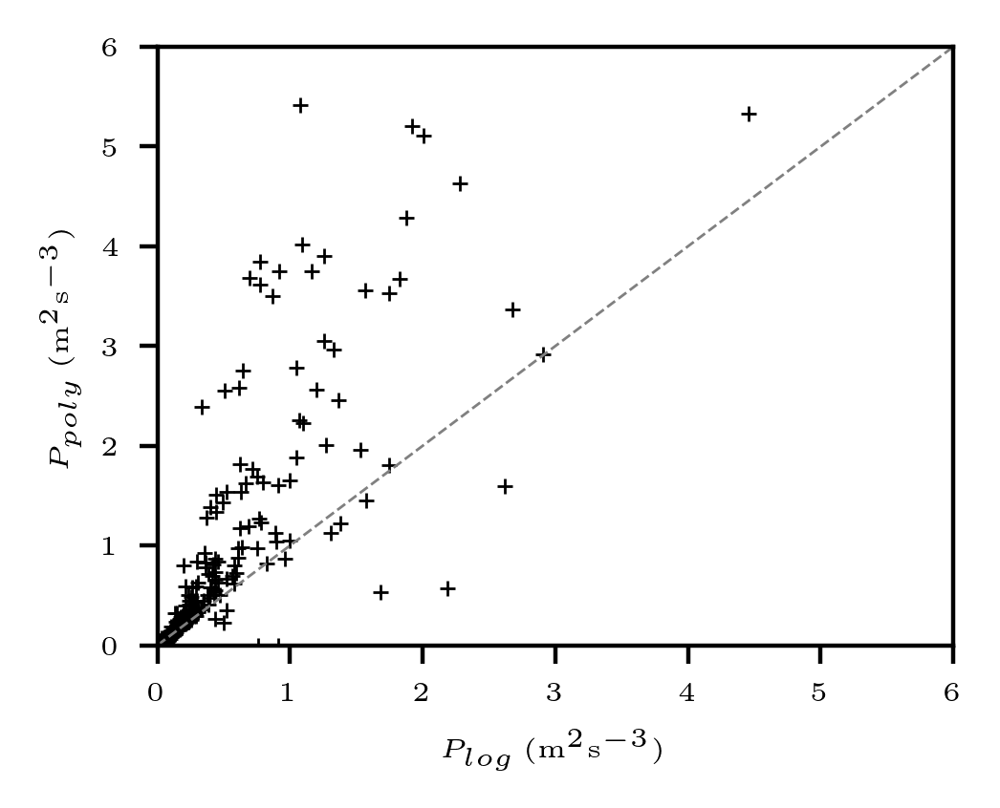

In [386]:
# Only for Group3
flat_Prod = Prod_rate_sort.flatten()
flat_Prod_poly = Prod_poly_sort_6l.flatten()
font_size = 5
mark_size = 3
line_width = 0.5
subplot = [['1']]
fig, axes = plt.subplot_mosaic(subplot, constrained_layout=True)
trans = mtransforms.ScaledTranslation(-20/72, 7/72, fig.dpi_scale_trans)
fig.set_size_inches(2.5,2)
fig.set_dpi(400)
axes['1'].plot(flat_Prod,flat_Prod_poly,'+',color = 'black', markersize=mark_size, markeredgewidth=line_width)
axes['1'].set_xlabel(r'$P_{log}\, \mathrm{(m^2 s^{-3})}$', fontsize = font_size)
axes['1'].set_ylabel(r'$P_{poly}\, \mathrm{(m^2 s^{-3})}$', fontsize = font_size)
axes['1'].set_xlim(0,6)
axes['1'].set_ylim(0,6)
axes['1'].tick_params(axis='both', labelsize=font_size)
plt.plot([0,6], [0,6],'--',color = 'gray',linewidth=line_width)

In [39]:
np.isnan(flat_Prod_poly_6l).sum(),np.isnan(flat_Prod_poly).sum()

(195, 0)

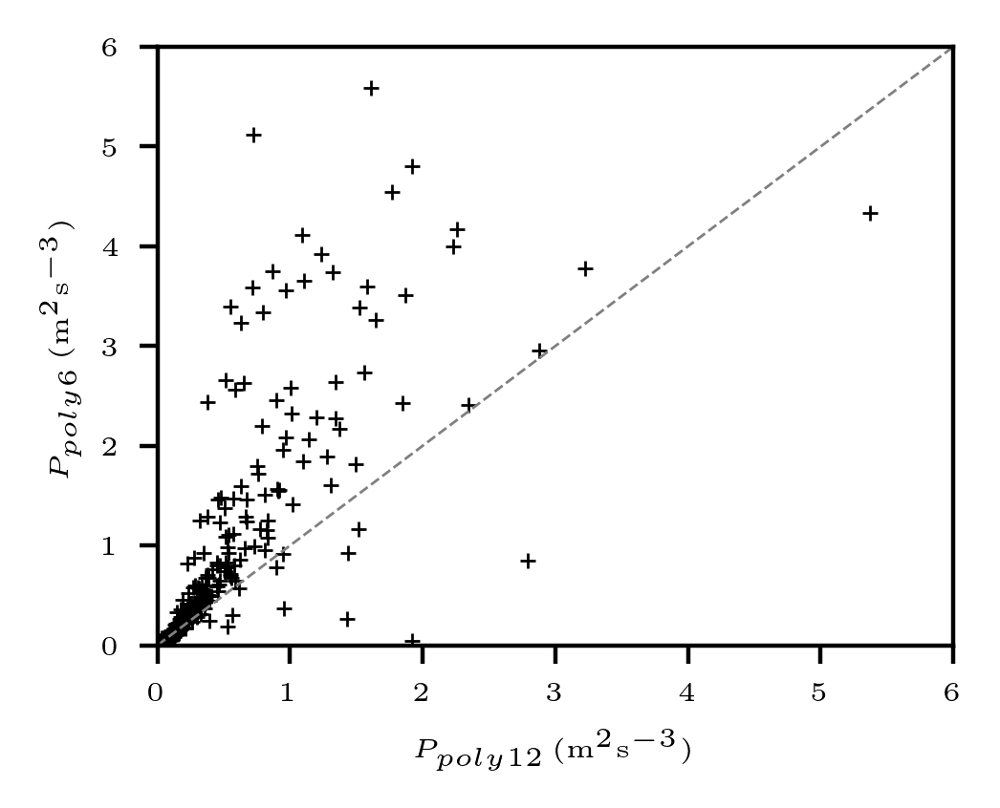

In [59]:
# Only for Group3
flat_Prod_poly = Prod_poly_sort.flatten()
flat_Prod_poly_6l = Prod_poly_sort_6l.flatten()
font_size = 5
mark_size = 3
line_width = 0.5
subplot = [['1']]
fig, axes = plt.subplot_mosaic(subplot, constrained_layout=True)
trans = mtransforms.ScaledTranslation(-20/72, 7/72, fig.dpi_scale_trans)
fig.set_size_inches(2.5,2)
fig.set_dpi(400)
axes['1'].plot(flat_Prod_poly,flat_Prod_poly_6l,'+',color = 'black', markersize=mark_size, markeredgewidth=line_width)
axes['1'].set_xlabel(r'$P_{poly12}\, \mathrm{(m^2 s^{-3})}$', fontsize = font_size)
axes['1'].set_ylabel(r'$P_{poly6}\, \mathrm{(m^2 s^{-3})}$', fontsize = font_size)
axes['1'].set_xlim(0,6)
axes['1'].set_ylim(0,6)
axes['1'].tick_params(axis='both', labelsize=font_size)
plt.plot([0,6], [0,6],'--',color = 'gray',linewidth=line_width)

In [84]:
len(flat_Prod),len(flat_D2)

(468, 108)

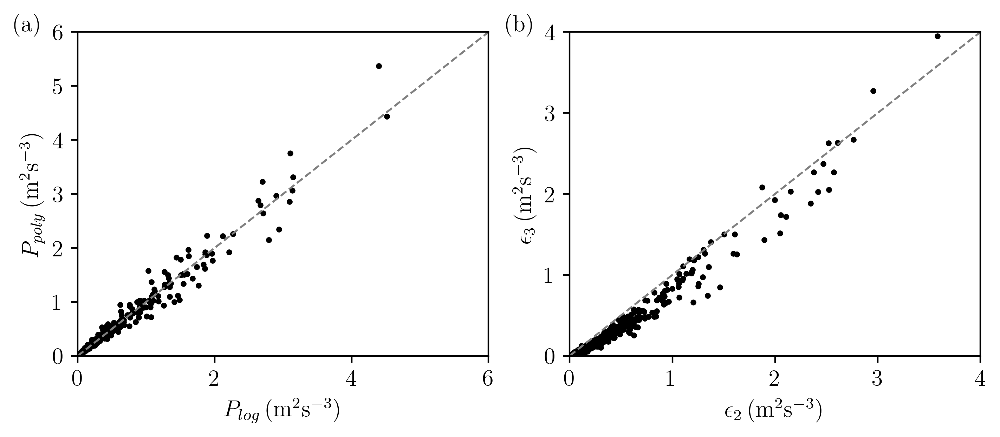

In [139]:
# Find the index of the neutral case
index = true_indices[0]
text_loc = [-0.06, 0.96]
font_size = 12
mark_size = 4
line_width = 1

fig, axes = plt.subplot_mosaic([['a','b']], constrained_layout=True)
fig.set_size_inches(7,3)
fig.set_dpi(400)
# label physical distance in and down:
trans = mtransforms.ScaledTranslation(-20/72, 7/72, fig.dpi_scale_trans)
flat_D2 = Diss_rate_D2_sort.flatten()
flat_D3 = Diss_rate_D3_sort.flatten()
axes['b'].plot(flat_D2,flat_D3,'.',color = 'black', markersize=mark_size, markeredgewidth=line_width)
axes['b'].set_xlabel(r'$\epsilon_{2}\, \mathrm{(m^2 s^{-3})}$', fontsize = font_size)
axes['b'].set_ylabel(r'$\epsilon_{3}\, \mathrm{(m^2 s^{-3})}$', fontsize = font_size)
axes['b'].set_xlim(0,4)
axes['b'].set_ylim(0,4)
axes['b'].tick_params(axis='both', labelsize=font_size)
axes['b'].plot([0, 4], [0, 4],'--',color = 'gray',linewidth=line_width)
axes['b'].text(text_loc[0], text_loc[1], '(b)', transform=axes['b'].transAxes + trans,
            fontsize=font_size, zorder=2, 
            bbox={'facecolor': 'white', 'edgecolor': 'none', 'pad': 1})

flat_Prod = Prod_rate_sort.flatten()
flat_Prod_poly = Prod_poly_sort.flatten()
axes['a'].plot(flat_Prod,flat_Prod_poly,'.',color = 'black', markersize=mark_size, markeredgewidth=line_width)
axes['a'].set_xlabel(r'$P_{log}\, \mathrm{(m^2 s^{-3})}$', fontsize = font_size)
axes['a'].set_ylabel(r'$P_{poly}\, \mathrm{(m^2 s^{-3})}$', fontsize = font_size)
axes['a'].set_xlim(0,6)
axes['a'].set_ylim(0,6)
axes['a'].tick_params(axis='both', labelsize=font_size)
axes['a'].plot([0,6], [0,6],'--',color = 'gray',linewidth=line_width)
axes['a'].text(text_loc[0], text_loc[1], '(a)', transform=axes['a'].transAxes + trans,
            fontsize=font_size, zorder=2, 
            bbox={'facecolor': 'white', 'edgecolor': 'none', 'pad': 1})


# Adjust spacing
fig.subplots_adjust(wspace=0.25)  # Adjust the width space between subplots

plt.savefig(OUT_PLOT_DIR+'prate_erate.jpg',dpi=400, bbox_inches='tight')

# Plot u'w'/u*^2

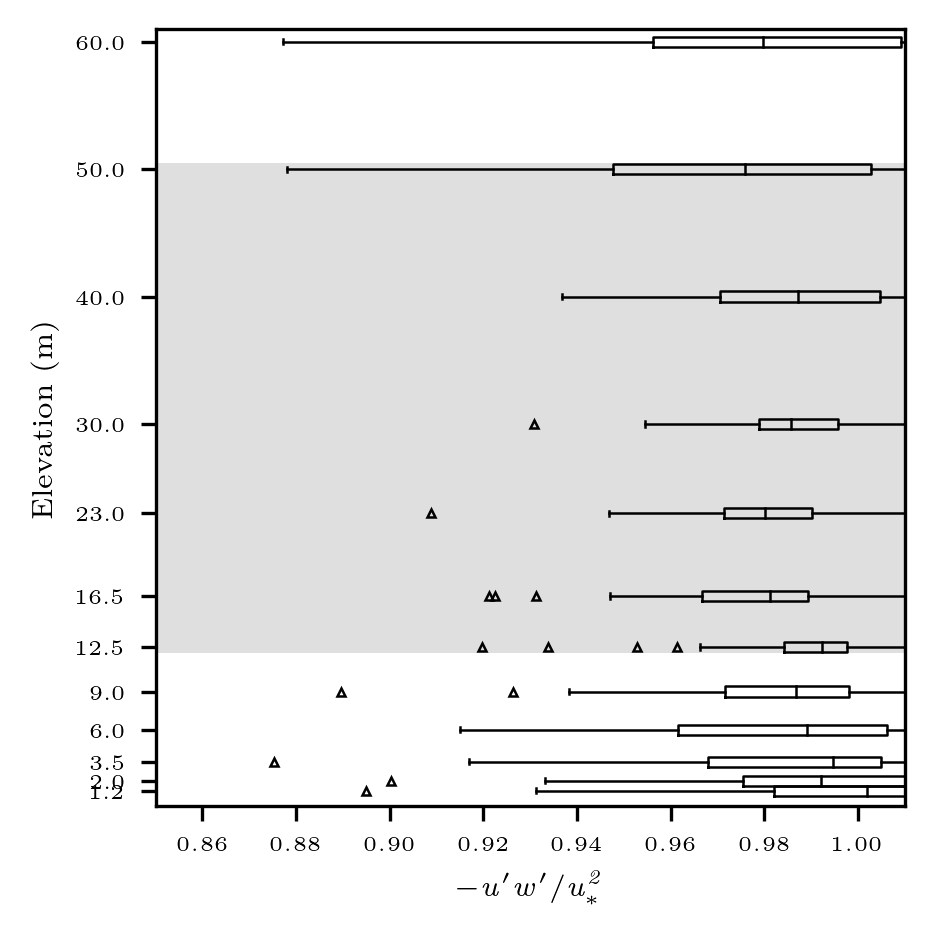

In [61]:
uw_over_ustar=-uw_filt/u_star_filt**2

text_loc = [0.12, 0.88]
font_size = 5
mark_size = 2
line_width = 0.6
widths = 0.8
fig, axes = plt.subplot_mosaic([['a']], constrained_layout=True)
fig.set_size_inches(3,3)
fig.set_dpi(300)
# label physical distance in and down:
trans = mtransforms.ScaledTranslation(-20/72, 7/72, fig.dpi_scale_trans)

def plot_uw_over_ustar(fig_lbl,ax):
    medianprops = dict(linestyle='-', linewidth=widths, color='k')
    sample = uw_over_ustar[mask_all]
    mask_ = ~np.isnan(sample) # Filter data using np.isnan
    filtered_data = [d[m] for d, m in zip(sample, mask_)]
    filtered_data = np.array(filtered_data)
    # print(filtered_data)
    box = ax.boxplot(filtered_data,positions=z, vert=False, widths=widths, medianprops=medianprops)
    # Decreasing the line width of the boxes
    for element in ['boxes', 'whiskers', 'means', 'medians', 'caps']:
        plt.setp(box[element], linewidth=line_width)
    # Specifically targeting the outliers ('fliers') to decrease their line width
    plt.setp(box['fliers'], marker='^', markersize=mark_size, markeredgewidth=line_width)  # Adjust markersize for visual preference
    # plt.setp(box['fliers'], marker='o')  # Example to change the marker style, optional
    # plt.setp(box['fliers'], linewidth=line_width-4)  # Adjusting the linewidth of the outlier markers
        
    ax.set_xlim(0.85,1.01)
    ax.set_ylim(0,61)
    # plot reference lines
    # ax.axvline(x=0, color='grey', linestyle='--', linewidth=line_width)
    # ax.axvline(x=0.25, color='grey', linestyle='--', linewidth=line_width)
    # ax.axvline(x=-0.25, color='grey', linestyle='--', linewidth=line_width)
    ax.axhspan(12, 50.5, facecolor='grey', alpha=0.25)

    ax.set_ylabel(r'Elevation (m)', fontsize=font_size+2)
    ax.set_xlabel(r'$\it{-u^\prime w^\prime /u_*^2}$', fontsize=font_size+2)
    
     # Adjust axis ticks
    ax.tick_params(axis='both', labelsize=font_size)
    
plot_uw_over_ustar('(a)',axes['a'])
plt.savefig(OUT_PLOT_DIR+'uw_over_ustar.jpg',dpi=400, bbox_inches='tight')

# *** Load TKE-related data

In [27]:
# List of variable names to load
variables_to_load = [
    'du_dz_poly_sort',
    'Prod_poly_sort',
    'du_dz_poly_sort_6l',
    'Prod_poly_sort_6l',
    'Prod_rate_sort',
    'Diss_rate_D2_sort',
    'Diss_rate_D3_sort',
    'P_D_ratio_D2_sort',
    'P_D_ratio_D3_sort'
]

# Loop through the list and load each array, assigning it to the original variable name
for var_name in variables_to_load:
    globals()[var_name] = np.load(os.path.join(OUT_DIR, f'{var_name}.npy'))

# *****Plot Euu and Eww, sigma_u and sigma_w, Production/Dissipation, Euw

In [123]:
text_loc = [-0.01, 0.9]
font_size = 6
mark_size = 2.5
line_width = 0.5
# Line parameters
x01 = np.logspace(-1, 2, num=100)
x02 = np.logspace(-1, 2, num=100)
# Define the intersection points
x_right = 10
y_right = 0.4
x_right2 = 5
y_right2 = 0.2

def plot_kEuu_sort(fig_lbl,ax1,index):
    strday = datetime_sort[index][0].strftime("%Y%m%d")
    ih = datetime_sort[index][1]
    key1 = f"{strday}_{ih:02}00"
    sample_Euu = log_spectrum_vars[key1]['Euu']['filt']
    # Set color order
    ax1.set_prop_cycle(color=color_list)
    # Plot kFu from higher to lower level
    for il in reversed(list_sel):
        ax1.loglog(sample_Euu['wavenumber_norm'][:,il],sample_Euu['Euu_norm_smoothed'][:,il],linewidth=line_width)
    ax1.set_xlabel(r'$\it kz$', fontsize = font_size)
    ax1.set_ylabel(r'$kE_{uu}/u_*^2$', fontsize = font_size)
    ax1.set_xlim(5e-3, 150)
    ax1.set_ylim(1e-3, 1e1)
    ax1.tick_params(axis='both', labelsize=font_size)
    ax1.text(text_loc[0], text_loc[1], fig_lbl, transform=ax1.transAxes + trans,
            fontsize=font_size, zorder=2, 
            bbox={'facecolor': 'white', 'edgecolor': 'none', 'pad': 1})
    # ax1.set_title(f'{index+1}. '+ datetime_sort[index][0].strftime("%m/%d/%Y")+' LT'+f"{ih:02}00",
    #           fontsize = font_size)
    # info = [r'$A_1^{fit}$'+'={:.2f}'.format(A1_sort[index])+'\n\n'+ 
    #         r'$\overline{H}$'+'={:.2f}'.format(H_avg_sort[index])]
    ax1.axhline(y=A1_sort[index],linestyle='--',color='gray', linewidth=line_width, zorder=2, 
                label = r'$A_1$'+'={:.2f}'.format(A1_sort[index]))
    ax1.axhline(y=Euu_95_mean_sort[index],linestyle='--',color='black', linewidth=line_width, zorder=2, 
                label = r'$C_1$'+'={:.2f}'.format(Euu_95_mean_sort[index]))
    # ax1.axhline(y=1,linestyle='--',color='black', linewidth=line_width, zorder=2, 
    #             label = 'y=1')
    # ax1.axhline(y=1.25,linestyle='--',color='red', linewidth=line_width, zorder=2, 
    #             label = 'y=1.25')
    
    ax1.axvline(x=1,linestyle='--',color='gray', linewidth=line_width, zorder=2)
    legend = ax1.legend(fontsize=font_size-2)
    legend.get_frame().set_linewidth(line_width)
    
    # Creating the line y = A * x^(-2/3)
    A = y_right *x_right**(2/3)
    line1_y = A * x01**(-2/3)

    # Plotting the reference lines
    ax1.plot(x01,line1_y, 'red', linewidth=line_width)

    # Adding an arrow on the left-hand side of the plot
    ax1.annotate('', xy=(0.05, 0.04), xytext=(0.005, 0.3),
                 arrowprops=dict(arrowstyle='->', facecolor='gray', edgecolor='gray', 
                                 linewidth=0.3, shrinkA=0, shrinkB=0))
    # Adding the formatted text "$z$ increasing" near the endpoint of the arrow
    ax1.text(0.25, 0.3,r'$z$'+'\n'+'Increasing', fontsize=font_size, ha='left', va='bottom', 
             transform=ax1.transAxes, linespacing=1.5, color='gray')

def plot_kEww_sort(fig_lbl,ax1,index):
    strday = datetime_sort[index][0].strftime("%Y%m%d")
    ih = datetime_sort[index][1]
    key1 = f"{strday}_{ih:02}00"
    sample_Eww = log_spectrum_vars[key1]['Eww']['filt']
    # Set color order
    ax1.set_prop_cycle(color=color_list)
    # Plot kFu from higher to lower level
    for il in reversed(list_sel):
        ax1.loglog(sample_Eww['wavenumber_norm'][:,il],sample_Eww['Eww_norm_smoothed'][:,il],linewidth=line_width)
    ax1.set_xlabel(r'$\it kz$', fontsize = font_size)
    ax1.set_ylabel(r'$kE_{ww}/u_*^2$', fontsize = font_size)
    ax1.set_xlim(5e-3, 150)
    ax1.set_ylim(1e-3, 1e1)
    ax1.tick_params(axis='both', labelsize=font_size)
    ax1.text(text_loc[0], text_loc[1], fig_lbl, transform=ax1.transAxes + trans,
            fontsize=font_size, zorder=2, 
            bbox={'facecolor': 'white', 'edgecolor': 'none', 'pad': 1})

# Calculate the ratio
P_D_ratio_D2_sort = Prod_poly_sort/Diss_rate_D2_sort
P_D_ratio_D3_sort = Prod_poly_sort/Diss_rate_D3_sort

def plot_P_D_ratio(fig_lbl,ax1,index,y_lim=[0, 4]):
    # plot the ratio of Production rate to Dissipation rate 
    ax1.semilogx(z[list_all],P_D_ratio_D2_sort[index,list_all].T,'o',color = 'black', 
             markerfacecolor='none', markersize=mark_size)  
    ax1.semilogx(z[list_sel],P_D_ratio_D2_sort[index,list_sel].T,'o',color = 'black', 
                 markerfacecolor='black', markersize=mark_size, label='$D_2$')
    ax1.semilogx(z[list_all],P_D_ratio_D3_sort[index,list_all].T,'o',color = 'red', 
             markerfacecolor='none', markersize=mark_size)  
    ax1.semilogx(z[list_sel],P_D_ratio_D3_sort[index,list_sel].T,'o',color = 'red', 
                 markerfacecolor='red', markersize=mark_size, label='$D_3$')
    # semilog scale
    # ax1.set_xscale('log')
    # ax1.set_yscale('log')
    ax1.axhline(y=1,linestyle='--',color='gray', linewidth=line_width, zorder=2)
    ax1.set_ylim(y_lim)
    ax1.set_xlabel(r'$\it z (m)$',fontsize=font_size)
    ax1.set_ylabel(r'$\it P/\epsilon$',fontsize=font_size) 
    ax1.tick_params(axis='both', labelsize=font_size)
    ax1.text(text_loc[0], text_loc[1], fig_lbl, transform=ax1.transAxes + trans,
            fontsize=font_size, zorder=2, 
            bbox={'facecolor': 'white', 'edgecolor': 'none', 'pad': 1})
    legend = ax1.legend(fontsize=font_size-2)
    legend.get_frame().set_linewidth(line_width)

def plot_kEuw_sort(fig_lbl,ax1,index):
    strday = datetime_sort[index][0].strftime("%Y%m%d")
    ih = datetime_sort[index][1]
    key1 = f"{strday}_{ih:02}00"
    sample_Euw = log_cospectrum_vars[key1]['Euw']['filt']
    # Set color order
    ax1.set_prop_cycle(color=color_list)
    # Plot kFu from higher to lower level
    for il in reversed(list_sel):
        ax1.loglog(sample_Euw['wavenumber_norm'][:,il],sample_Euw['Euw_norm_smoothed'][:,il],linewidth=line_width)
    ax1.set_xlabel(r'$\it kz$', fontsize = font_size)
    ax1.set_ylabel(r'$kE_{uw}/u_*^2$', fontsize = font_size)
    ax1.set_xlim(5e-3, 150)
    ax1.set_ylim(1e-2, 1)
    ax1.tick_params(axis='both', labelsize=font_size)
    ax1.text(text_loc[0], text_loc[1], fig_lbl, transform=ax1.transAxes + trans,
            fontsize=font_size, zorder=2, 
            bbox={'facecolor': 'white', 'edgecolor': 'none', 'pad': 1})
    # Creating the line y = A * x^(-4/3)
    A = y_right2 *x_right2**(4/3)
    line1_y = A * x02**(-4/3)

    # Plotting the reference lines
    ax1.plot(x02,line1_y, 'red', linewidth=line_width)
    
def plot_u_std_prof(fig_lbl,ax1,index,y_lim=[4, 7]):
    # plot u_std   
    ax1.plot(z[list_all],u_std_plus_sort[index,list_all].T,'o',color = 'black', 
             markerfacecolor='none', markersize=mark_size)  
    ax1.plot(z[list_sel],u_std_plus_sort[index,list_sel].T,'o',color = 'black',markerfacecolor='black', markersize=mark_size)
    # linear regression
    line = (-A1_sort[index])* np.log(z[list_all])+intercept_sort[index]
    ax1.plot(z[list_all], line,color='gray', linestyle='--', linewidth=line_width, zorder=1)
    
    # semilog scale
    ax1.set_xscale('log')
    ax1.set_xlabel(r'$\it z (m)$',fontsize=font_size)
    ax1.set_ylabel(r'$\it \sigma_u^2/u_*^2$',fontsize=font_size) 
    ax1.tick_params(axis='both', labelsize=font_size)
    ax1.set_ylim(y_lim)
    ax1.text(text_loc[0], text_loc[1], fig_lbl, transform=ax1.transAxes + trans,
            fontsize=font_size, zorder=2, 
            bbox={'facecolor': 'white', 'edgecolor': 'none', 'pad': 1})
    # info = [r'$-z/L$'+'={:.3f}'.format(-z_L_sort[index])
    #         +'\n\n'+
    #         r'$R^2$'+'={:.2f}'.format(R2_A1_sort[index])
    #        ]
    info = [r'$A_1$'+'={:.2f}'.format(A1_sort[index])
            # +'\n\n'+
            # r'$R^2$'+'={:.2f}'.format(R2_A1_sort[index])
           ]
    legend= ax1.legend(custom_lines, info,fontsize=font_size-2, handlelength=-0.5)
    legend.get_frame().set_linewidth(line_width)
    
def plot_w_std_prof(fig_lbl,ax1,index,y_lim=[0.85, 2.05]):
    # plot w_std
    ax1.plot(z[list_all], w_std_plus_sort[index,list_all],'o',color = 'k',markerfacecolor='none', markersize=mark_size)
    ax1.plot(z[list_sel],w_std_plus_sort[index,list_sel],
             'o',color = 'k',markerfacecolor='k', markersize=mark_size)
    
    # semilog scale
    ax1.set_xscale('log')
    ax1.set_xlabel(r'$\it z (m)$',fontsize=font_size)
    ax1.set_ylabel(r'$\it \sigma_w^2/u_*^2$',fontsize=font_size)
    ax1.set_ylim(y_lim)
    ax1.tick_params(axis='both', labelsize=font_size)
    # Adjust x-axis ticks to point inward
    # ax_.tick_params(axis='x', direction='in',labelsize=font_size)
    # ax_.tick_params(axis='y', direction='in',labelsize=font_size)
    ax1.text(text_loc[0], text_loc[1], fig_lbl, transform=ax1.transAxes + trans,
            fontsize=font_size, zorder=2, 
            bbox={'facecolor': 'white', 'edgecolor': 'none', 'pad': 1})
    # plot reference line (sigma_w/u*)^2=1.78 Kunkel2006
    # ax1.axhline(y=1.78,linestyle='--',color='gray', linewidth=line_width, zorder=2)
    ax1.axhline(wstd_slope_sort[index],label = r'$B_2$'+'={:.2f}'.format(wstd_slope_sort[index]), 
                linestyle='--',color='gray', linewidth=line_width, zorder=2)
    legend = ax1.legend(fontsize=font_size-2, loc='lower right')
    legend.get_frame().set_linewidth(line_width)

def plot_group(index_):
    subplot = [['1', '2'],
              ['3', '4']] 
    global text_loc
    text_loc = [0.22, 0.8]
    fig, axes = plt.subplot_mosaic(subplot, constrained_layout=True)
    global trans
    trans = mtransforms.ScaledTranslation(-20/72, 7/72, fig.dpi_scale_trans)
    fig.set_size_inches(4,3)
    fig.set_dpi(250)
    plot_u_std_prof('(a)',axes['1'],index_)
    axes['1'].set_title(f'{index_+1}. '+ datetime_sort[index_][0].strftime("%m/%d/%Y")+' LT'+f"{datetime_sort[index_][1]:02}00",
          fontsize = font_size)
    plot_kEuu_sort('(b)',axes['2'],index_)
    plot_w_std_prof('(c)',axes['3'],index_)
    plot_P_D_ratio('(d)',axes['4'],index_)
    # Adjust spacing
    fig.subplots_adjust(wspace=0.5)  # Adjust the width space between subplots
    fig.subplots_adjust(hspace=0.4)  # Adjust the height space between subplots

def plot_extra_group(index_):
    subplot = [['1', '2']]
    fig, axes = plt.subplot_mosaic(subplot, constrained_layout=True)
    global trans
    trans = mtransforms.ScaledTranslation(-20/72, 7/72, fig.dpi_scale_trans)
    fig.set_size_inches(4,1.5)
    fig.set_dpi(400)
    plot_kEww_sort('(a)',axes['1'],index_)
    axes['1'].set_title(f'{index_+1}. '+ datetime_sort[index_][0].strftime("%m/%d/%Y")+' LT'+f"{datetime_sort[index_][1]:02}00",
          fontsize = font_size)
    plot_kEuw_sort('(b)',axes['2'],index_)

# Plot All cases

In [374]:
len(Indices)

32

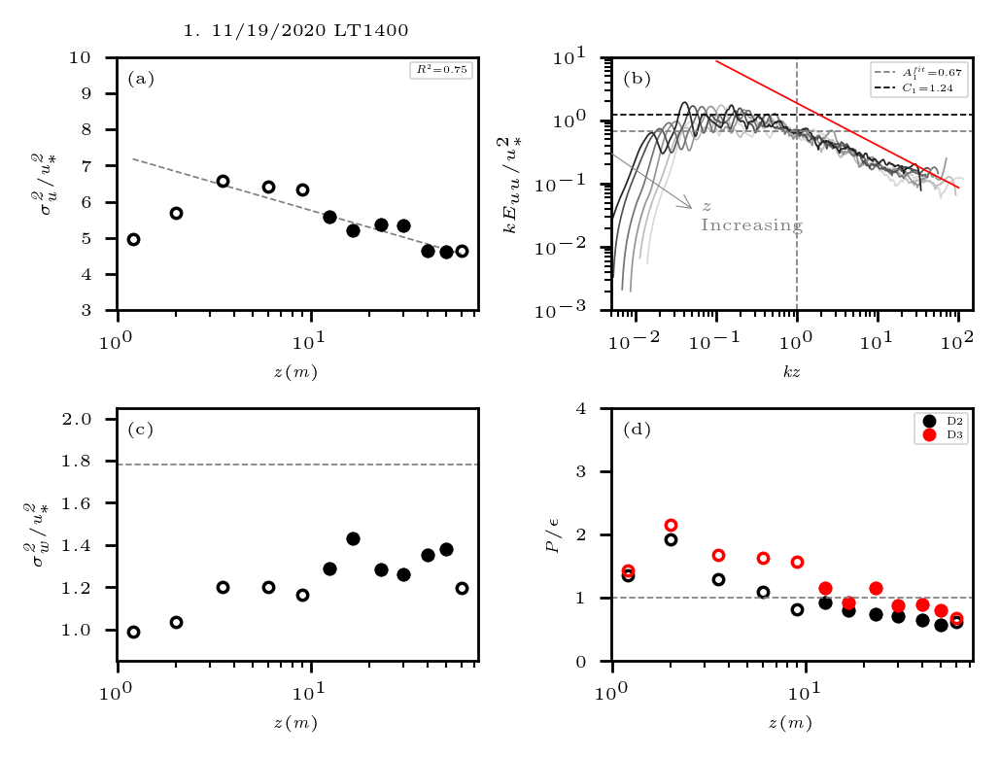

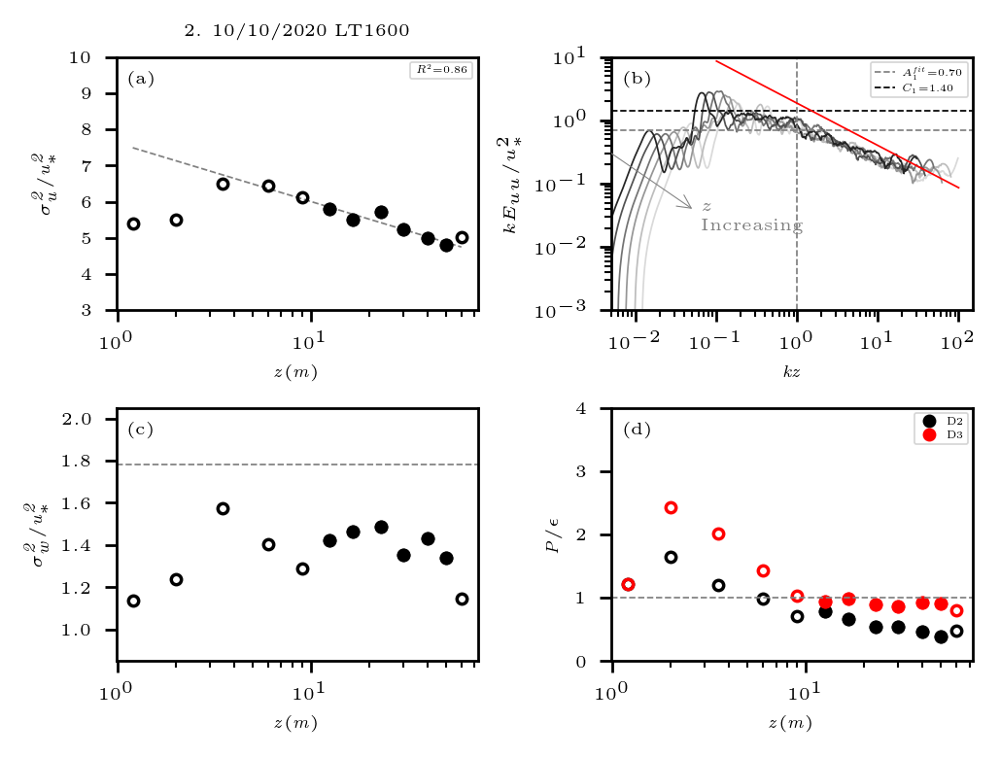

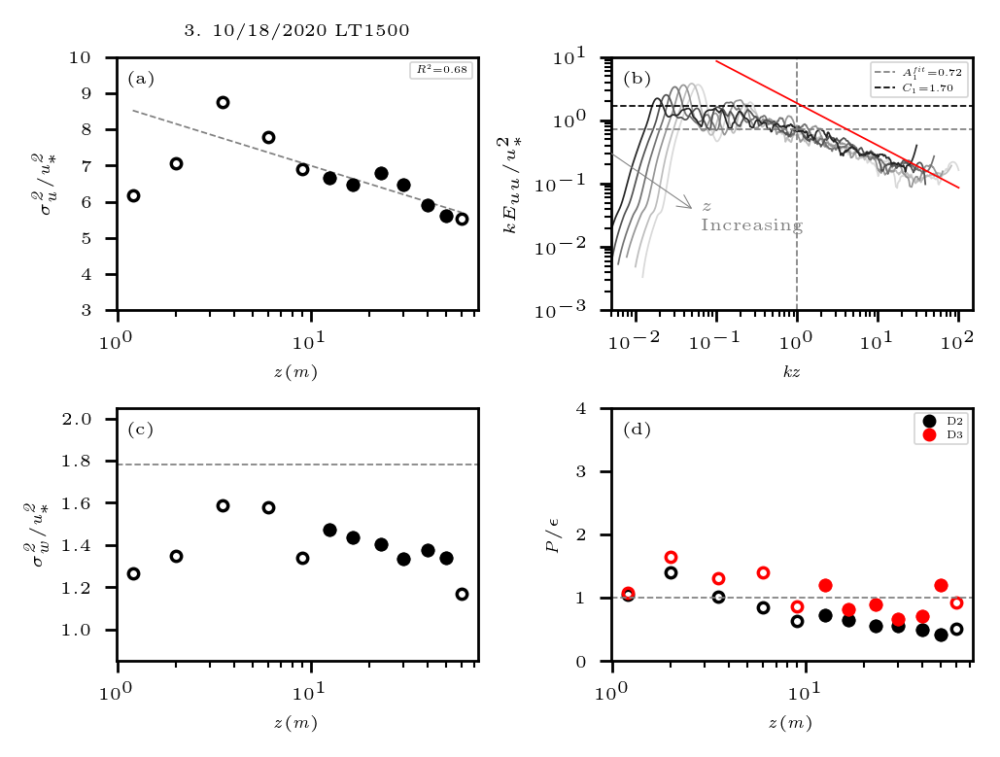

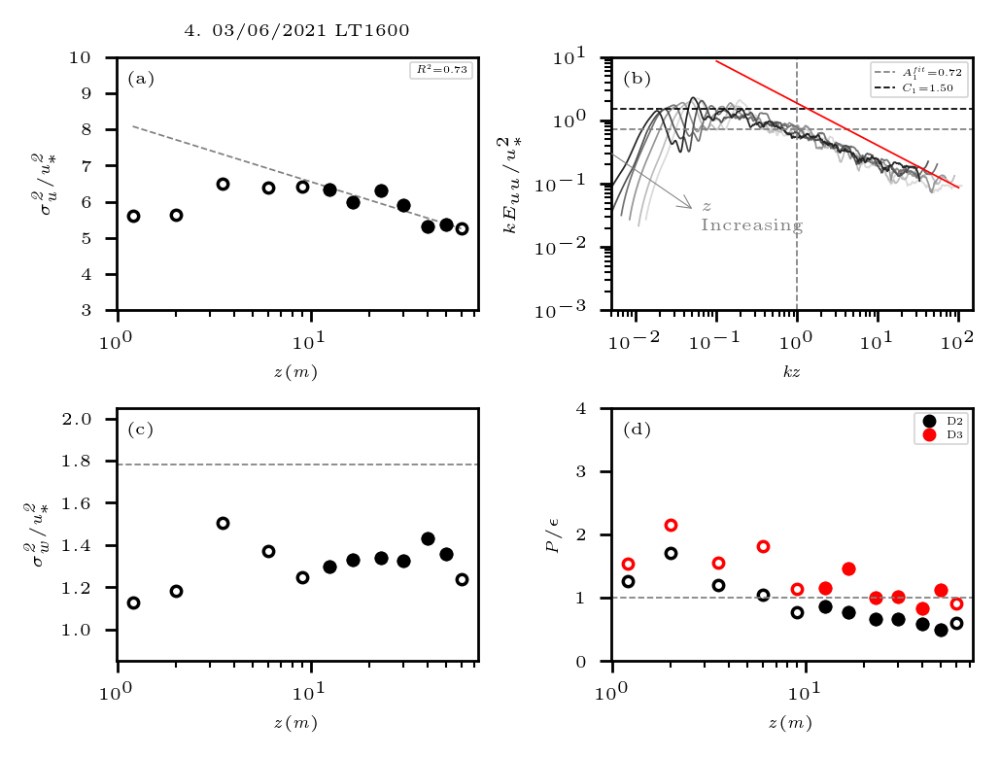

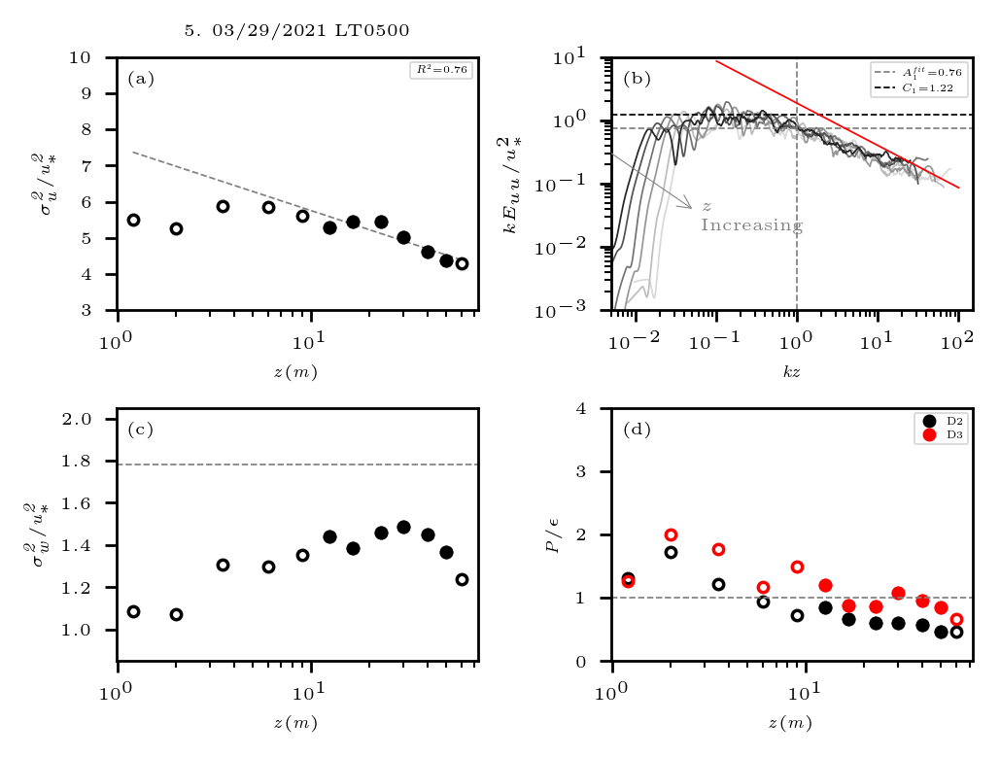

...

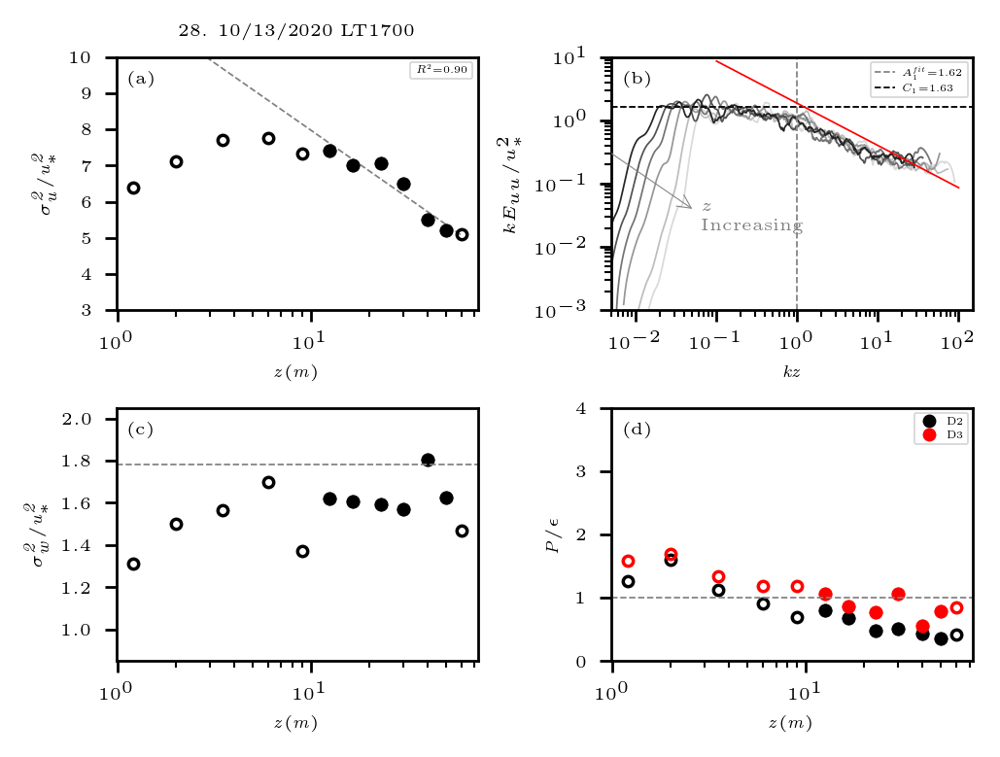

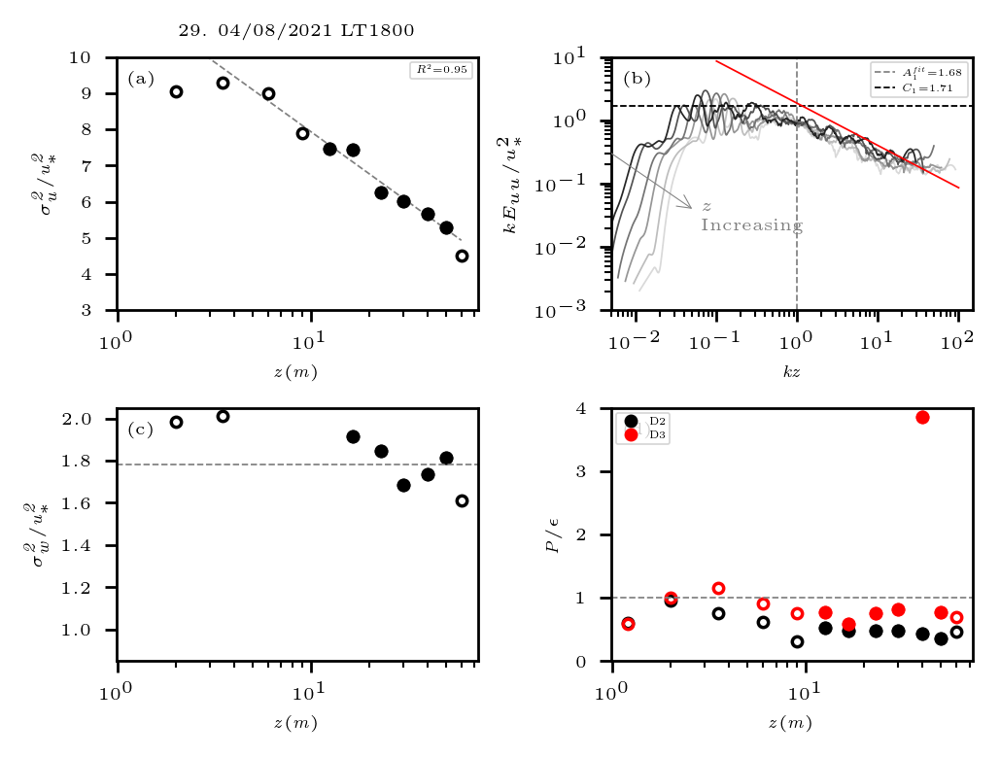

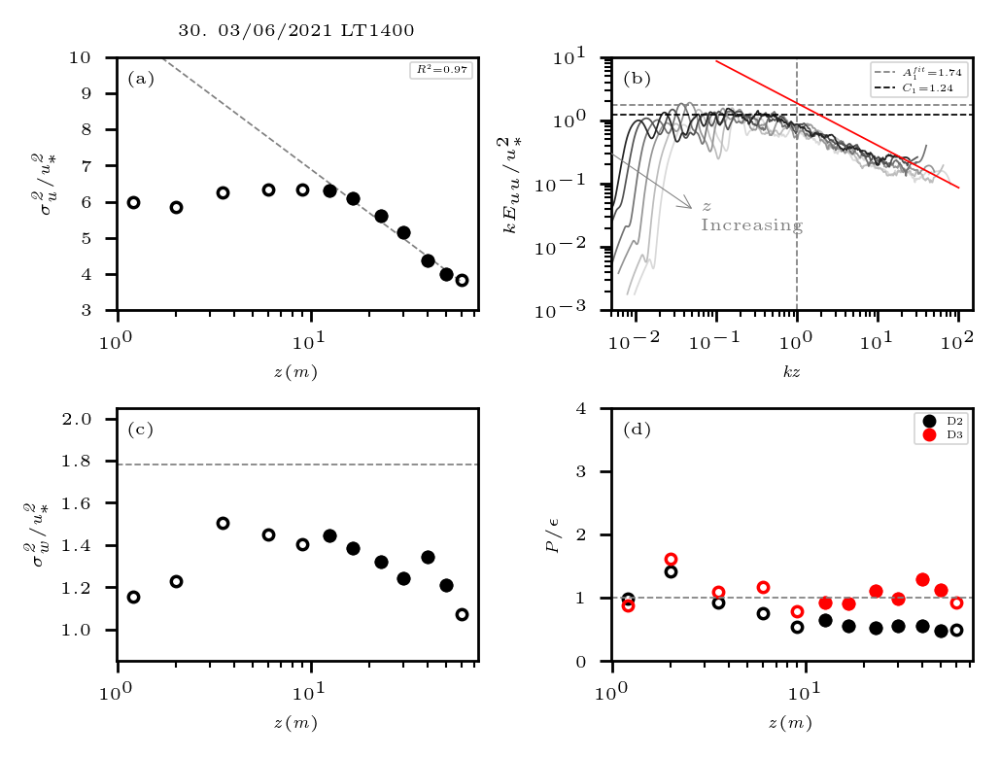

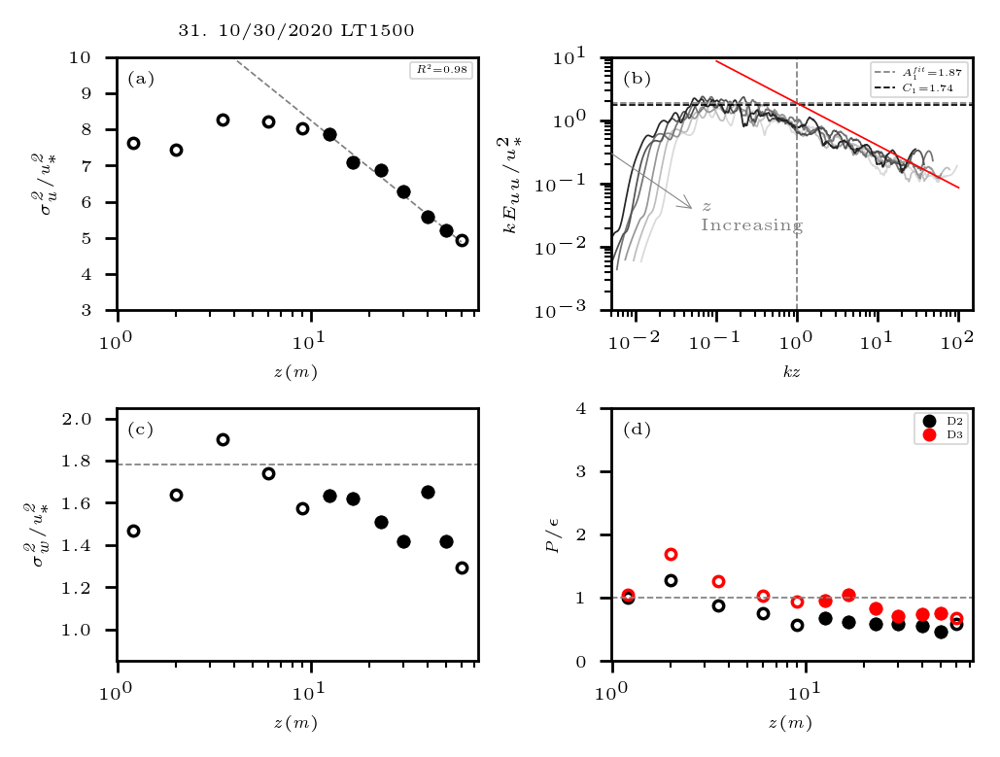

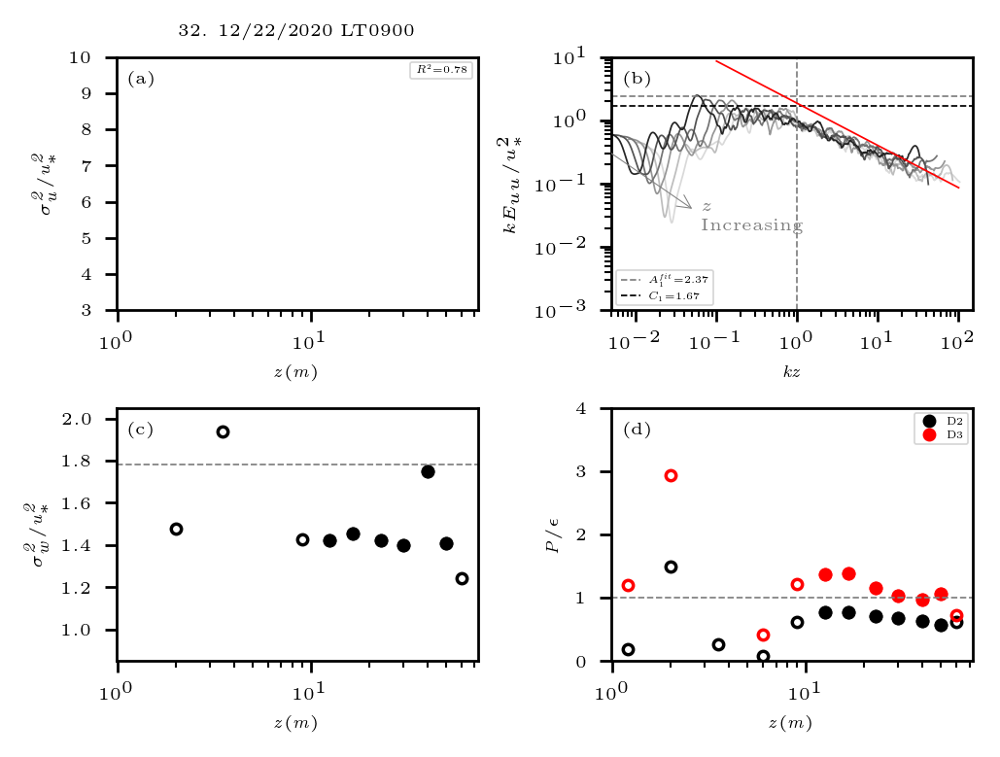

In [391]:
font_size = 5
mark_size = 3
line_width = 0.5
for i in range(len(Indices)):
    plot_group(i)
    plt.show()

# *****Define groups

## with despiking

In [133]:
# anomalous sigma_u
group1=[10, 26, 27]
# anomalous sigma_w
group2=[5,6,22,24,25,30,31,32,33,34,36]
# Euu has wake detached eddies
group3=[1,2,4,7,9,17,19,21,28]
# anomalous balance
group4=[0,3,8,11,12,13,20]
# high performance
group5=[14,15,16,18,23,29,35,37,38]

## without despiking

In [28]:
# anomalous sigma_u
# group1=[10, 26, 27]
group1=[11,26,27]
# anomalous sigma_w
# group2=[5,6,22,24,25,30,31,32,33,34,36]
group2=[6,10,20,21,22,24,25,30,31,32,33,34,35,36,37]
# Euu has wake detached eddies
# group3=[1,2,4,7,9,17,19,21,28]
group3=[1,2,3,4,7,9,28]
# anomalous balance
# group4=[0,3,8,11,12,13,20]
group4=[0,5,8,12,13]
# high performance
# group5=[14,15,16,18,23,29,35,37,38]
group5=[14,15,16,17,18,19,23,29,38]

In [141]:
len(group1+group2+group3+group4+group5)

39

In [247]:
len(group5)

9

## planar fit

In [400]:
# anomalous sigma_u
group1=[10, 21, 22]
# anomalous sigma_w
group2=[2,7,9,11,13,15,16,17,18,19,20,26,29,30]
# Euu has wake detached eddies
group3=[1,5,6,8,24]
# anomalous balance
group4=[0,3,24,25]
# high performance
group5=[4,12,14,27,28,31]

In [393]:
len(group1+group2+group3+group4+group5)

32

## Group 1

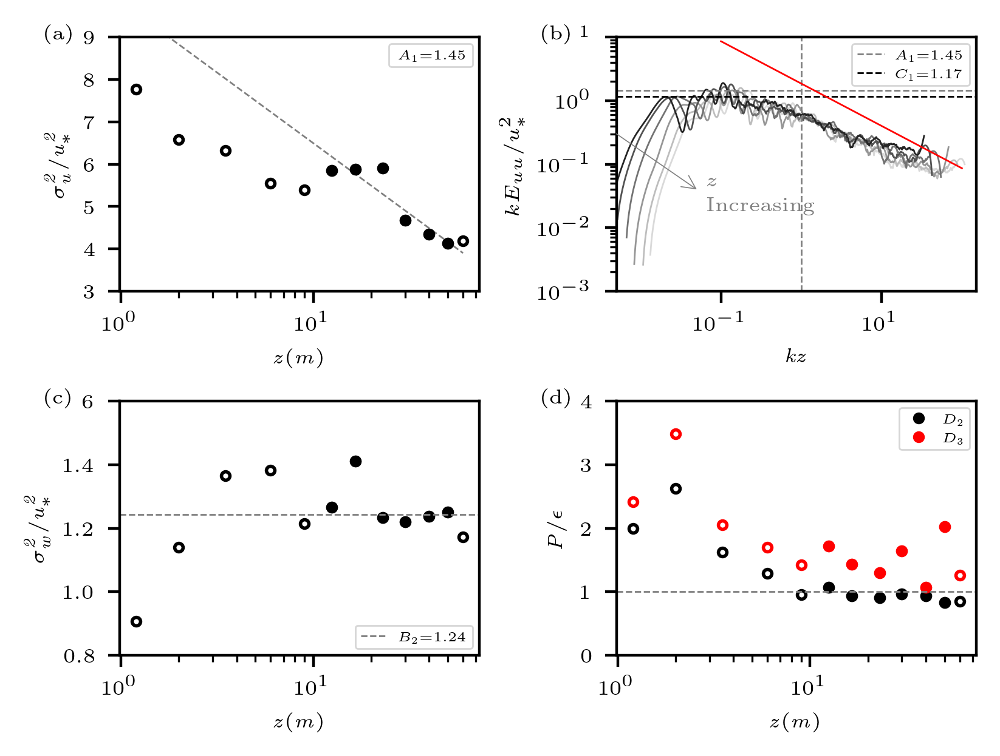

In [131]:
def plot_group_without_title(index_):
    subplot = [['1', '2'],
              ['3', '4']] 
    global text_loc
    text_loc = [-0.02, 0.9]
    fig, axes = plt.subplot_mosaic(subplot, constrained_layout=True)
    global trans
    trans = mtransforms.ScaledTranslation(-20/72, 7/72, fig.dpi_scale_trans)
    fig.set_size_inches(4,3)
    fig.set_dpi(400)
    plot_u_std_prof('(a)',axes['1'],index_,(3,9))
    # axes['1'].set_title(f'{index_+1}. '+ datetime_sort[index_][0].strftime("%m/%d/%Y")+' LT'+f"{datetime_sort[index_][1]:02}00",
    #       fontsize = font_size)
    plot_kEuu_sort('(b)',axes['2'],index_)
    plot_w_std_prof('(c)',axes['3'],index_,(0.8,1.6))
    plot_P_D_ratio('(d)',axes['4'],index_,(0,4))
    # Adjust spacing
    fig.subplots_adjust(wspace=0.5)  # Adjust the width space between subplots
    fig.subplots_adjust(hspace=0.4)  # Adjust the height space between subplots

plot_group_without_title(group1[1])
plt.savefig(OUT_PLOT_DIR+f'combined_smoothed_ustd_Euu_wstd_tke_G1_20210306_LT1500.jpg',dpi=400, bbox_inches='tight')

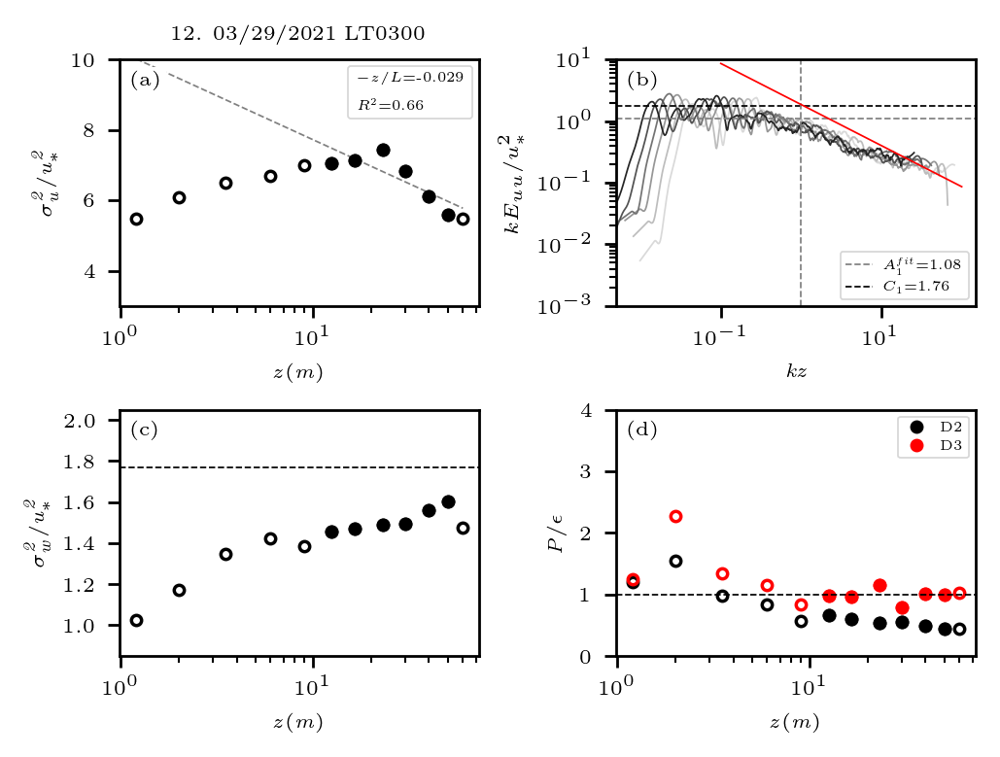

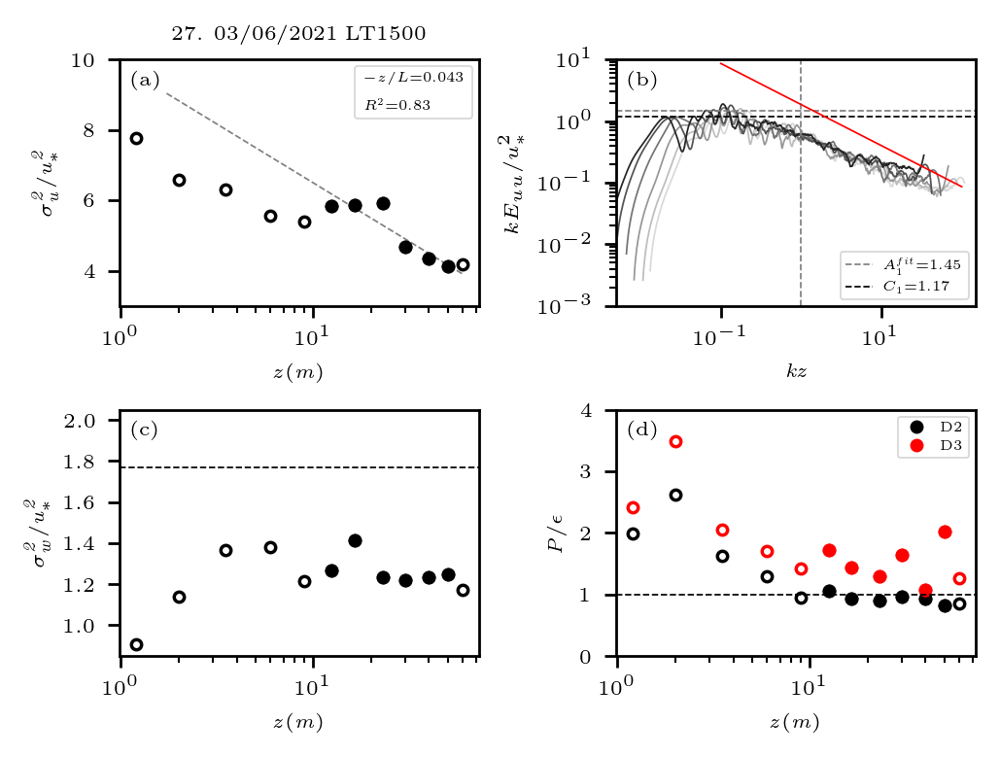

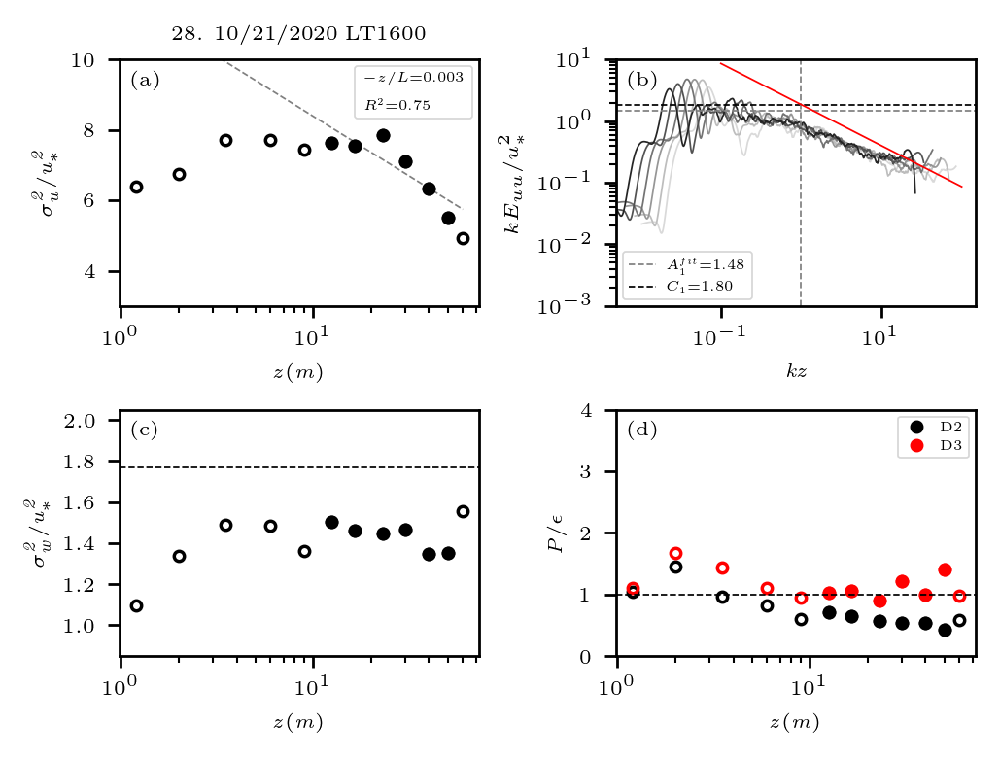

In [172]:
for i in range(len(group1)):
    plot_group(group1[i])
    plt.savefig(OUT_PLOT_DIR+f'combined_smoothed_ustd_Euu_wstd_tke_case{group1[i]+1}_group1.jpg',dpi=250, bbox_inches='tight')
    # plot_extra_group(group1[i])
    # print(text_loc)
    plt.show()

## Group2

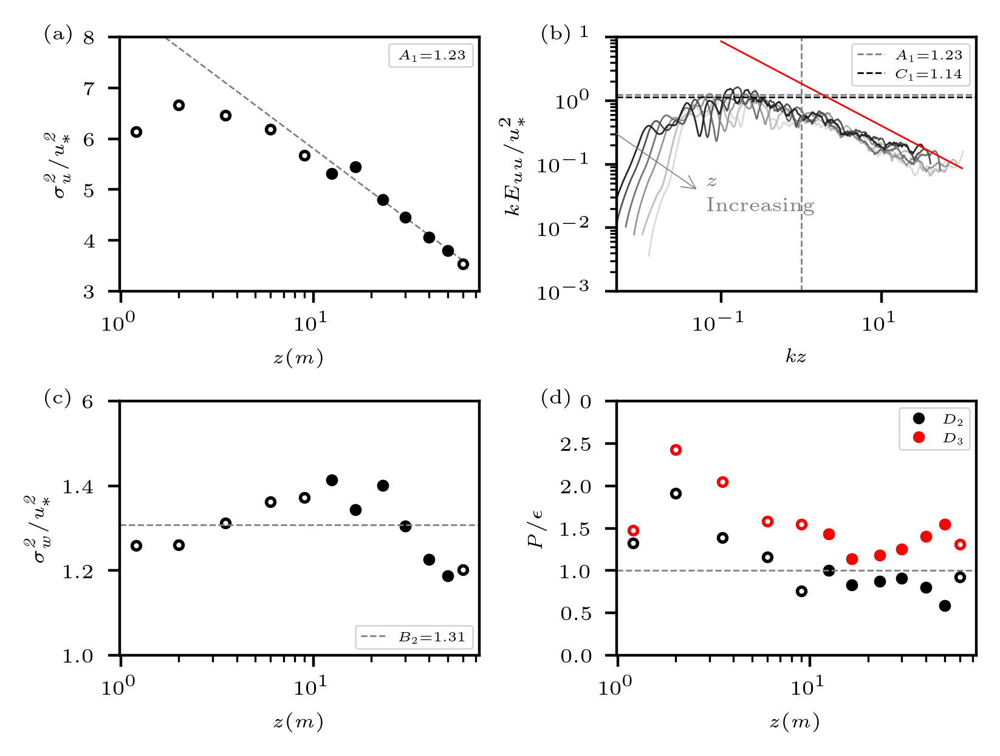

In [130]:
def plot_group_without_title(index_):
    subplot = [['1', '2'],
              ['3', '4']] 
    global text_loc
    text_loc = [-0.02, 0.9]
    fig, axes = plt.subplot_mosaic(subplot, constrained_layout=True)
    global trans
    trans = mtransforms.ScaledTranslation(-20/72, 7/72, fig.dpi_scale_trans)
    fig.set_size_inches(4,3)
    fig.set_dpi(400)
    plot_u_std_prof('(a)',axes['1'],index_,(3,8))
    # axes['1'].set_title(f'{index_+1}. '+ datetime_sort[index_][0].strftime("%m/%d/%Y")+' LT'+f"{datetime_sort[index_][1]:02}00",
    #       fontsize = font_size)
    plot_kEuu_sort('(b)',axes['2'],index_)
    plot_w_std_prof('(c)',axes['3'],index_,(1,1.6))
    plot_P_D_ratio('(d)',axes['4'],index_,(0,3))
    # Adjust spacing
    fig.subplots_adjust(wspace=0.5)  # Adjust the width space between subplots
    fig.subplots_adjust(hspace=0.4)  # Adjust the height space between subplots

plot_group_without_title(group2[2])
plt.savefig(OUT_PLOT_DIR+f'combined_smoothed_ustd_Euu_wstd_tke_G2_20210414_LT1100.jpg',dpi=400, bbox_inches='tight')

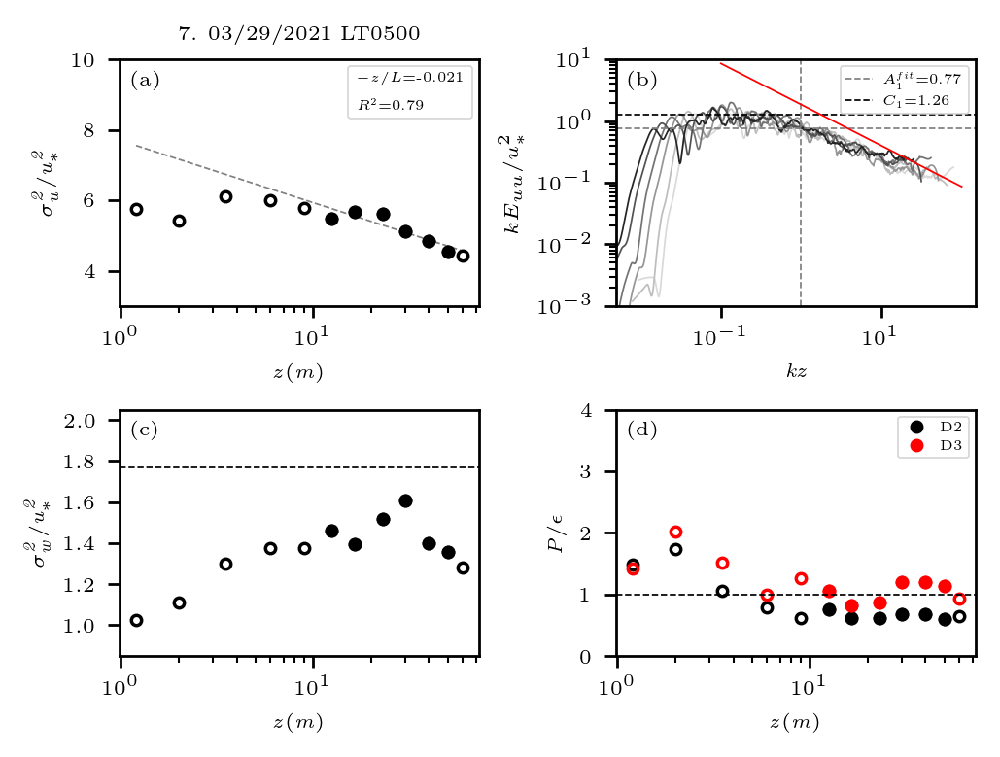

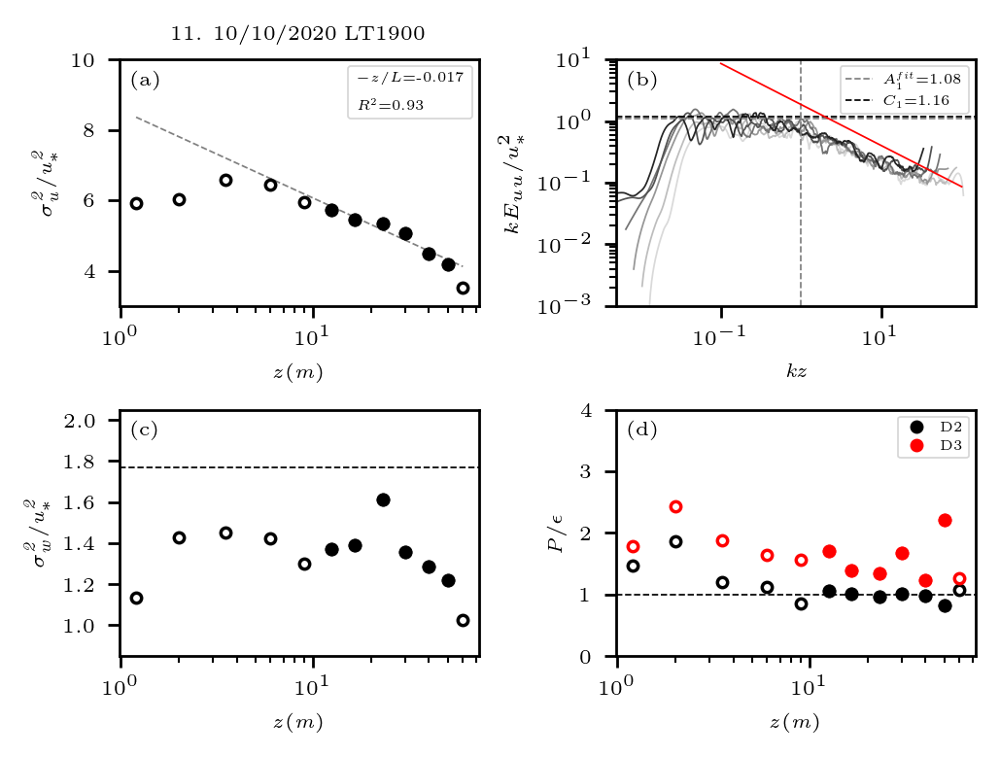

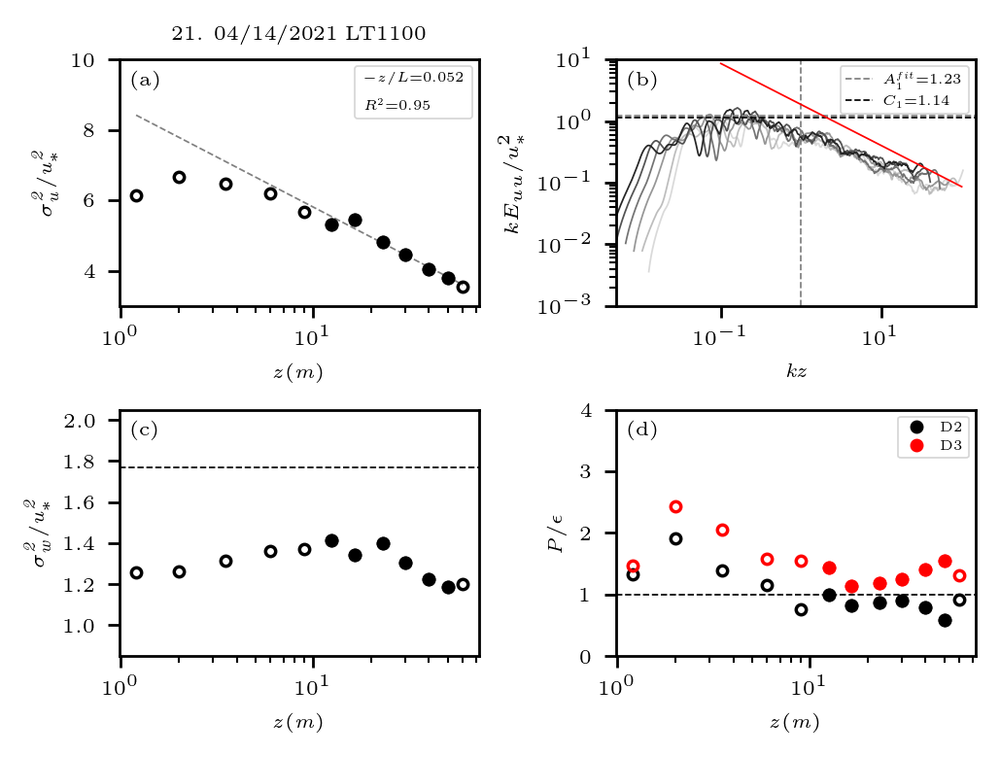

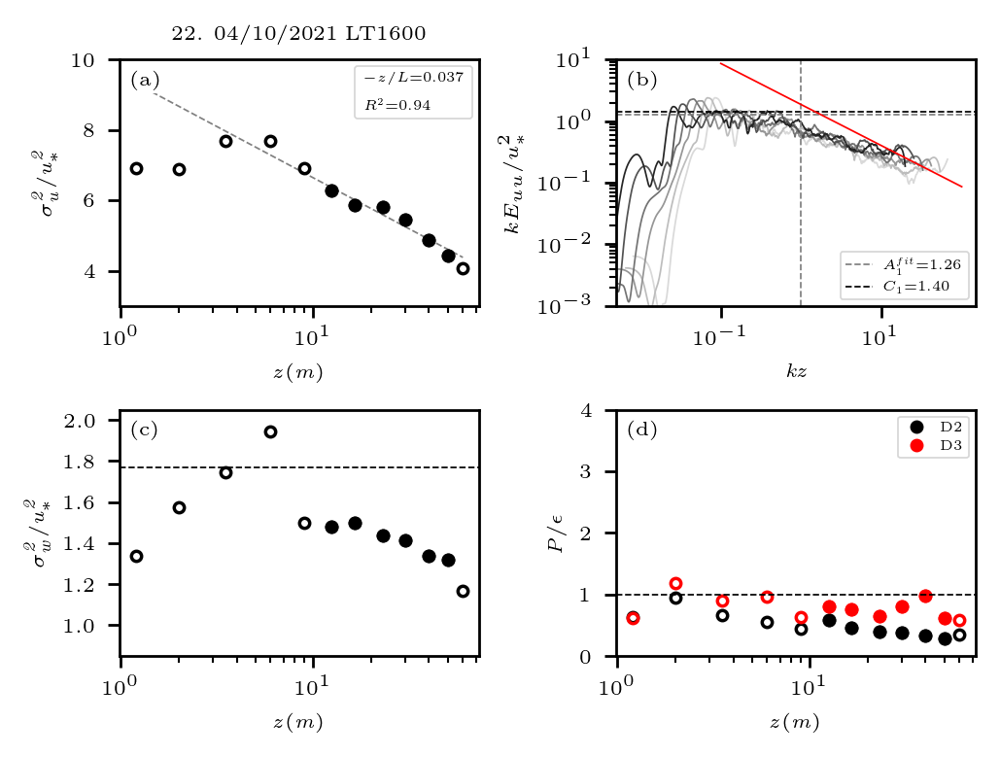

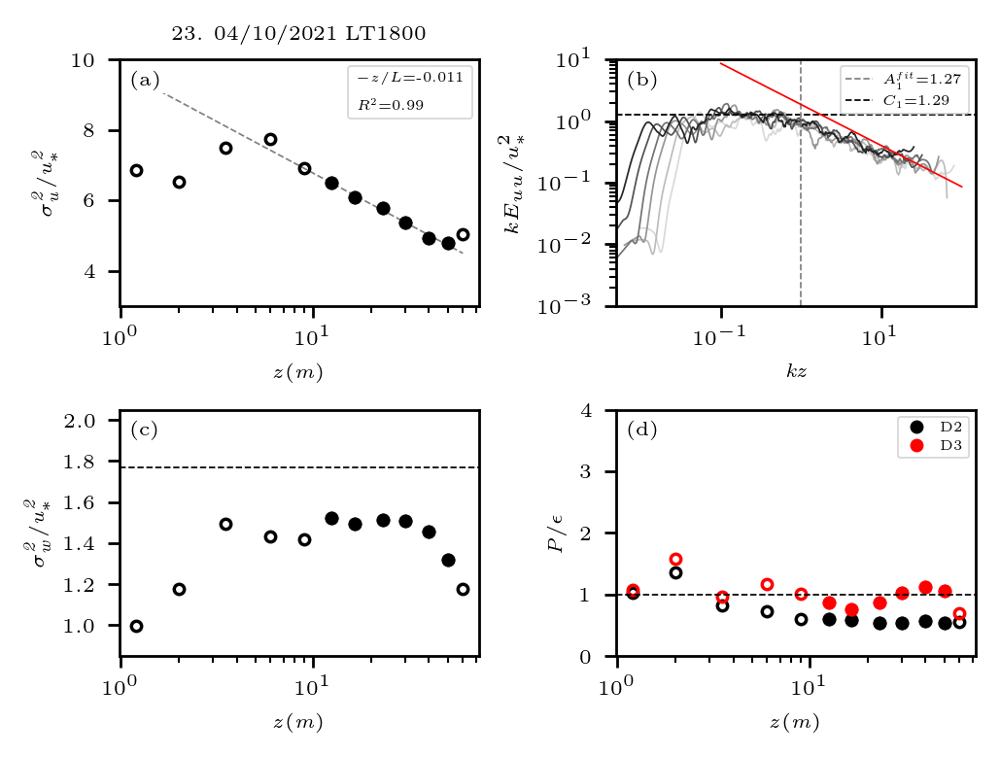

...

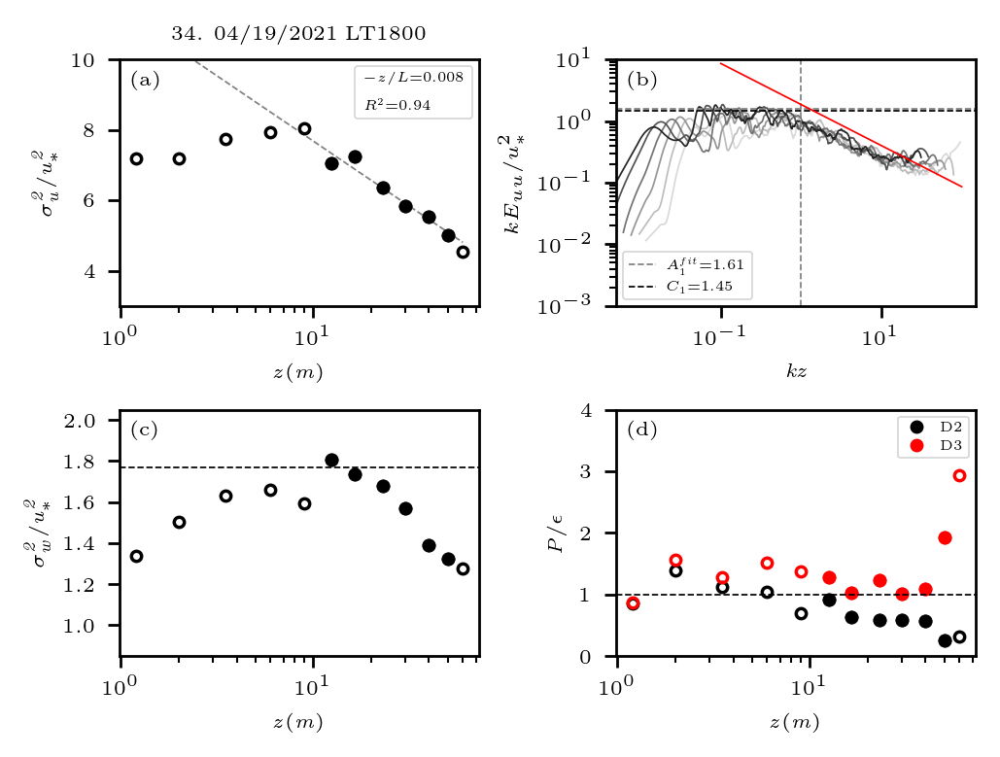

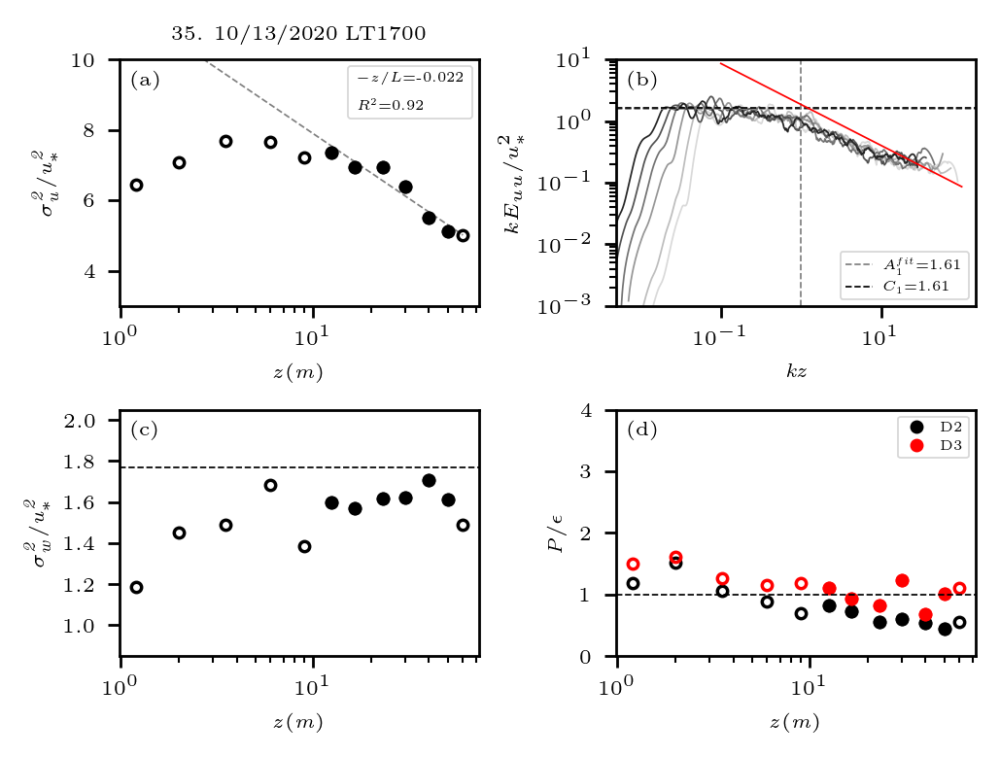

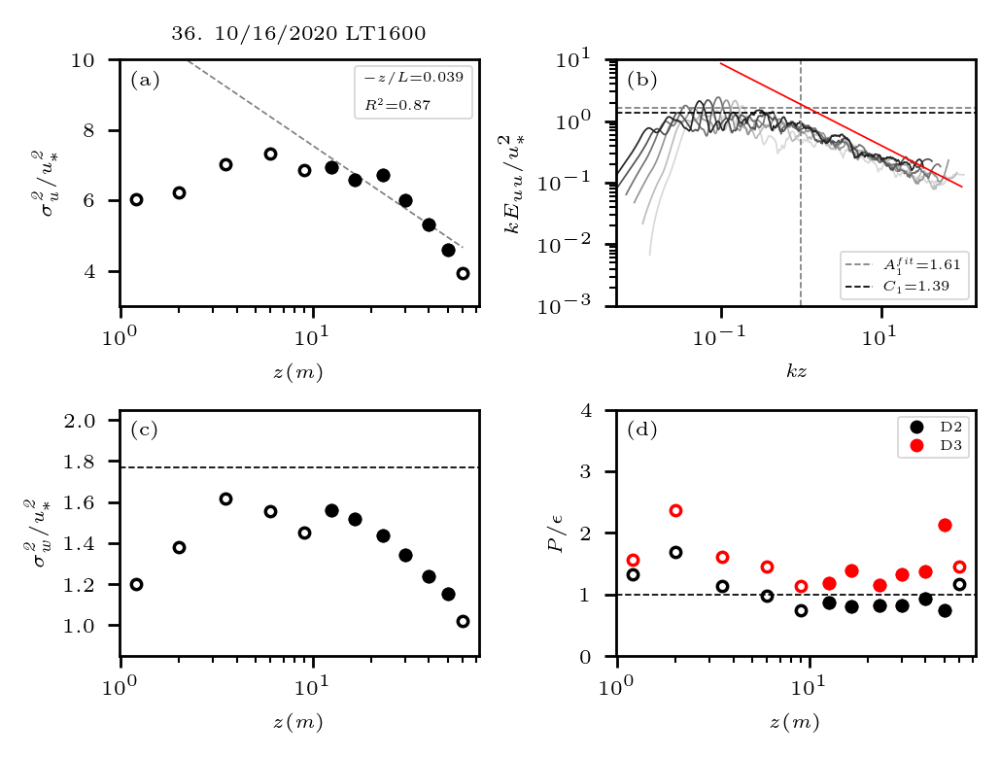

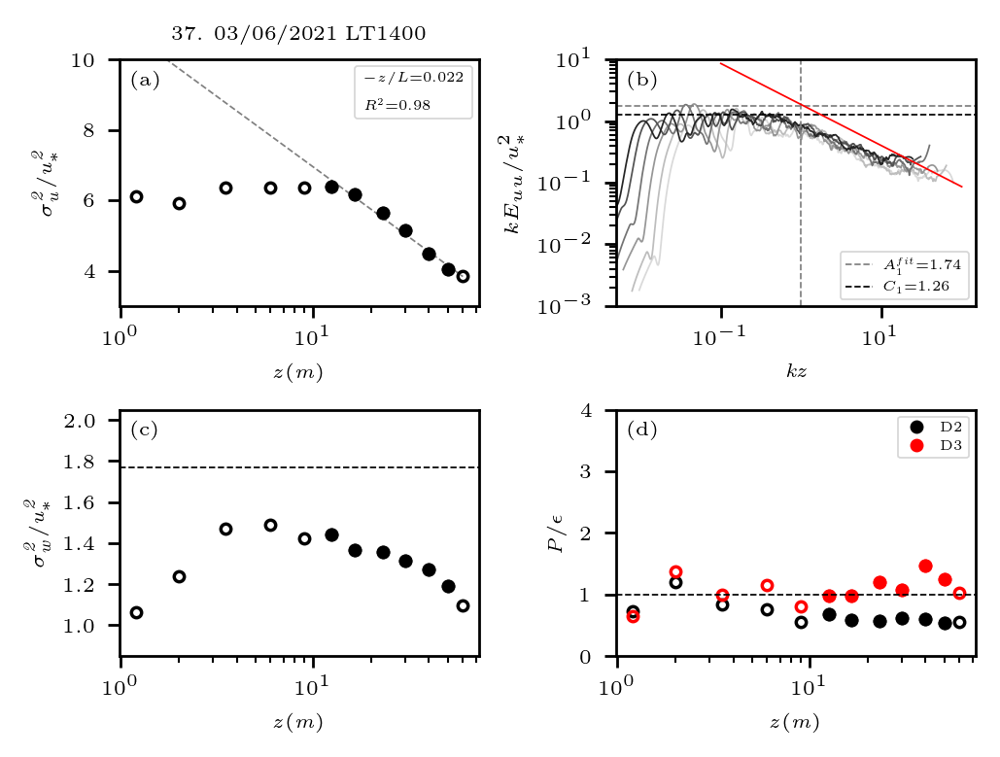

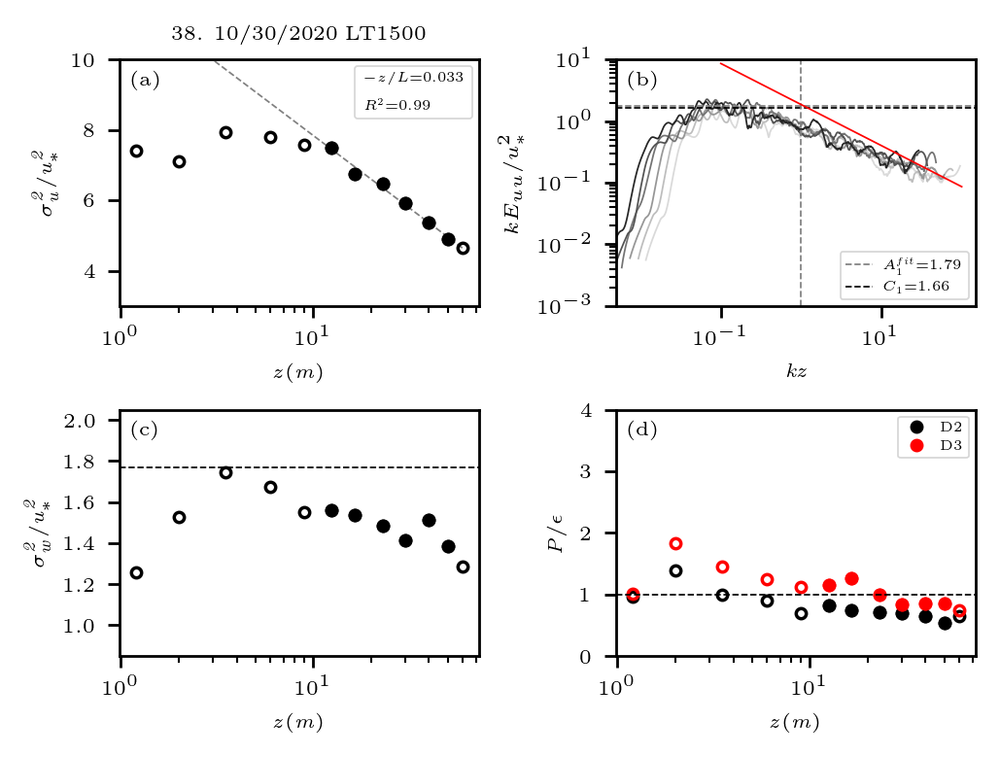

In [173]:
for i in range(len(group2)):
    plot_group(group2[i])
    plt.savefig(OUT_PLOT_DIR+f'combined_smoothed_ustd_Euu_wstd_tke_case{group2[i]+1}_group2.jpg',dpi=250, bbox_inches='tight')
    # plot_extra_group(group2[i])
    plt.show()

## Group3

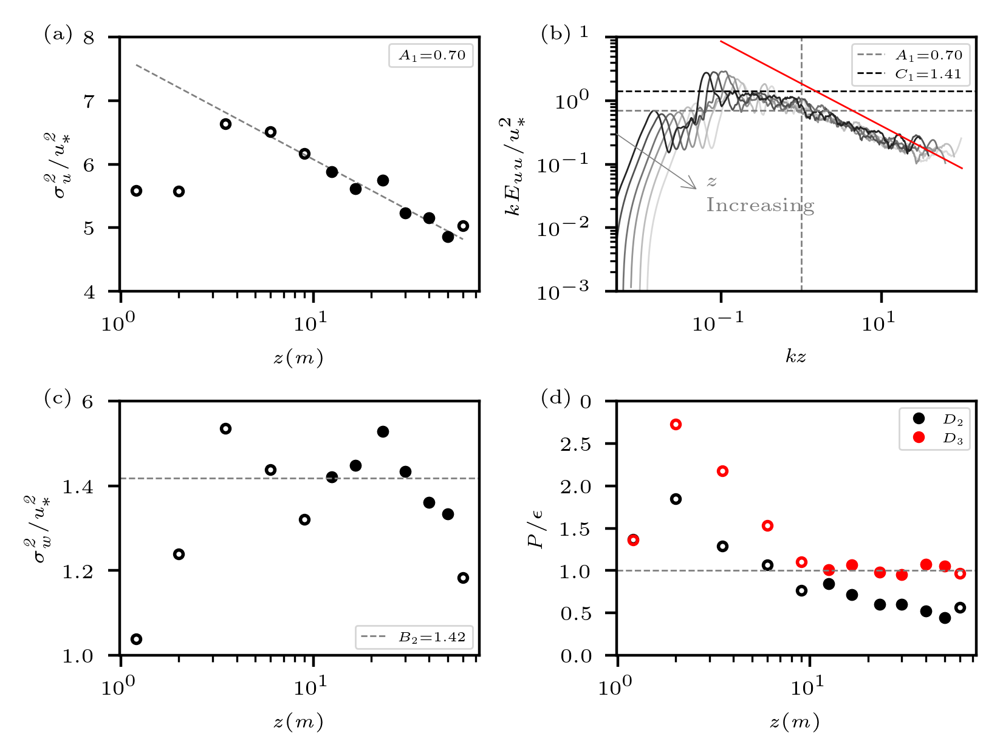

In [129]:
def plot_group_without_title(index_):
    subplot = [['1', '2'],
              ['3', '4']] 
    global text_loc
    text_loc = [-0.02, 0.9]
    fig, axes = plt.subplot_mosaic(subplot, constrained_layout=True)
    global trans
    trans = mtransforms.ScaledTranslation(-20/72, 7/72, fig.dpi_scale_trans)
    fig.set_size_inches(4,3)
    fig.set_dpi(400)
    plot_u_std_prof('(a)',axes['1'],index_,(4,8))
    # axes['1'].set_title(f'{index_+1}. '+ datetime_sort[index_][0].strftime("%m/%d/%Y")+' LT'+f"{datetime_sort[index_][1]:02}00",
    #       fontsize = font_size)
    plot_kEuu_sort('(b)',axes['2'],index_)
    plot_w_std_prof('(c)',axes['3'],index_,(1,1.6))
    plot_P_D_ratio('(d)',axes['4'],index_,(0,3))
    # Adjust spacing
    fig.subplots_adjust(wspace=0.5)  # Adjust the width space between subplots
    fig.subplots_adjust(hspace=0.4)  # Adjust the height space between subplots

plot_group_without_title(group3[0])
plt.savefig(OUT_PLOT_DIR+f'combined_smoothed_ustd_Euu_wstd_tke_G3_20201010_LT1600.jpg',dpi=400, bbox_inches='tight')

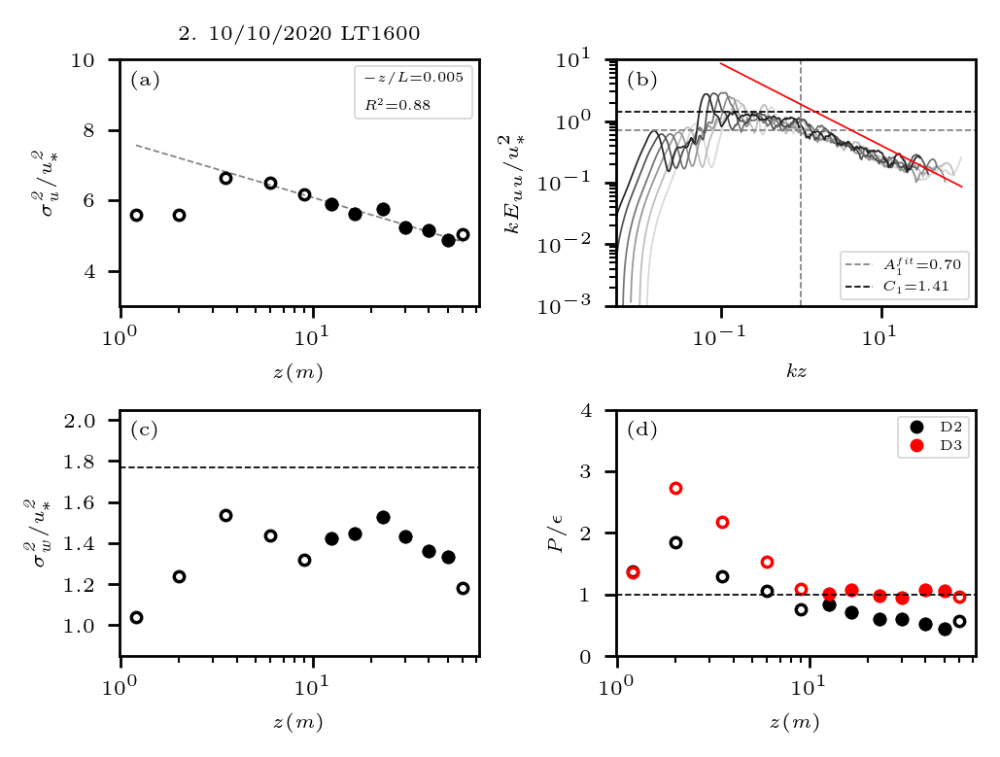

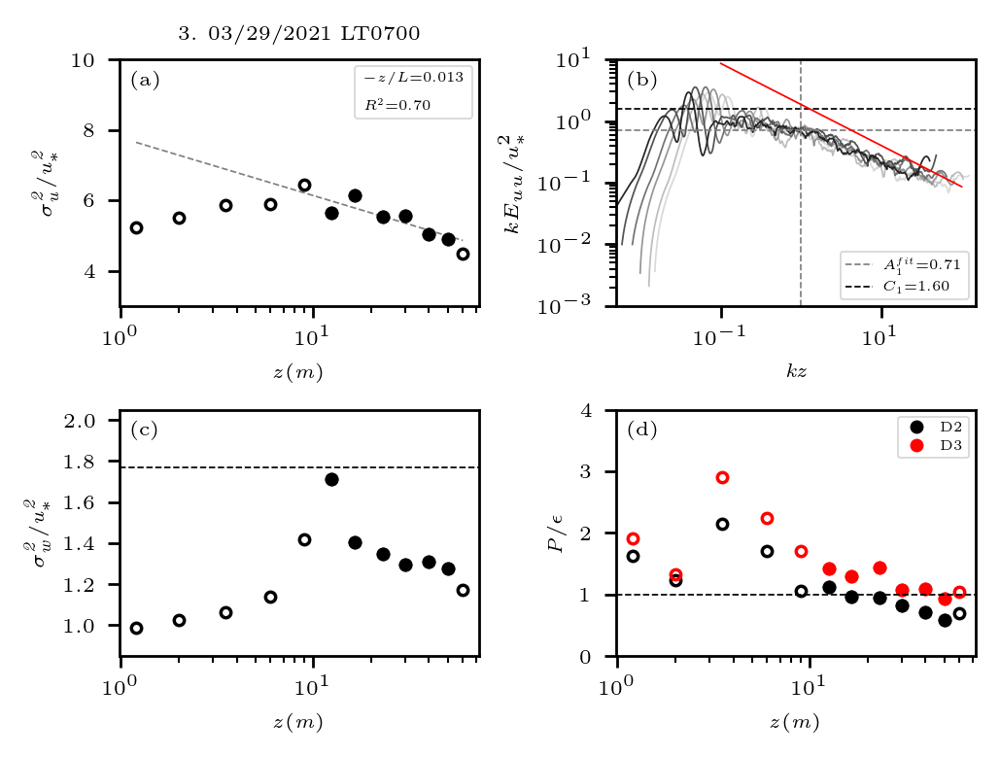

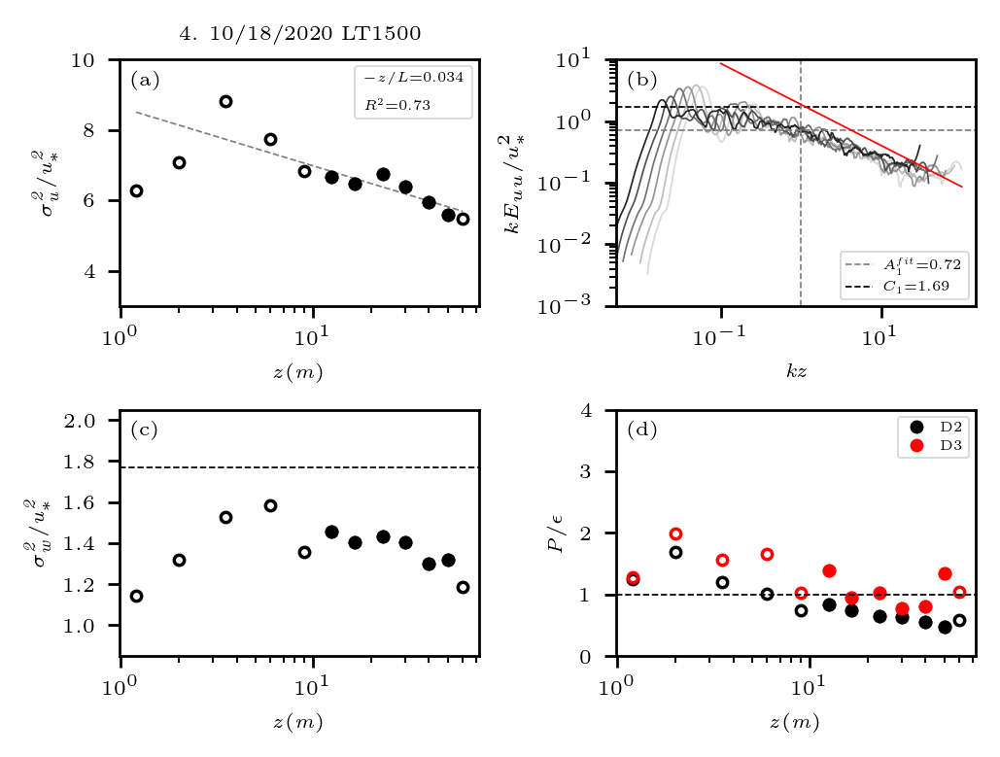

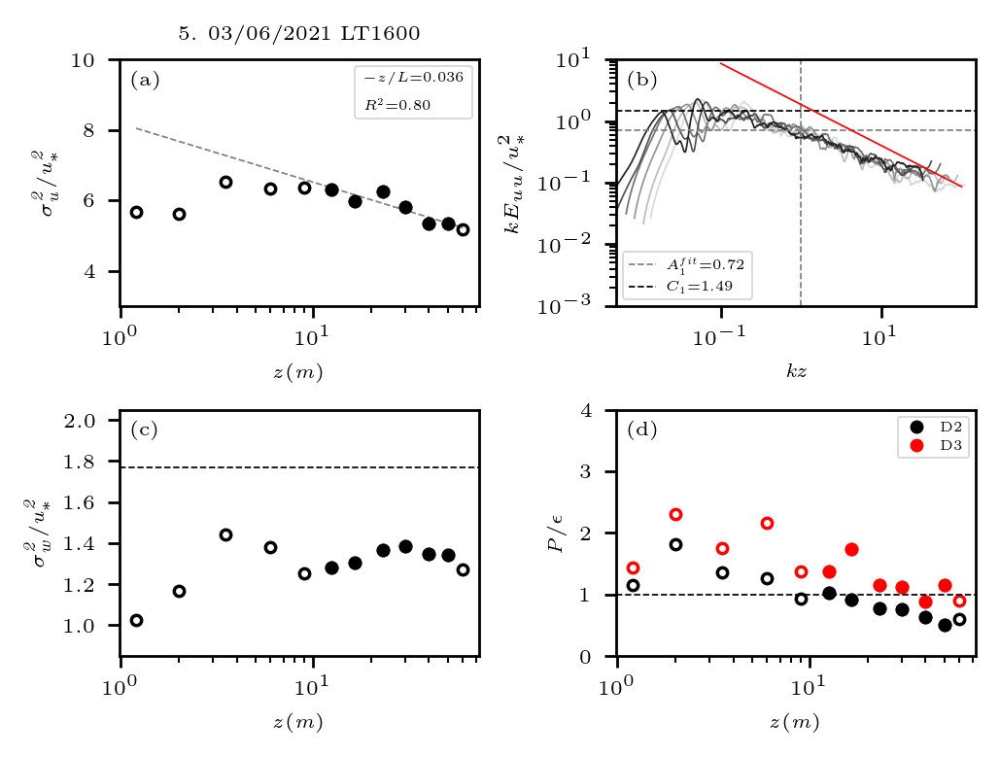

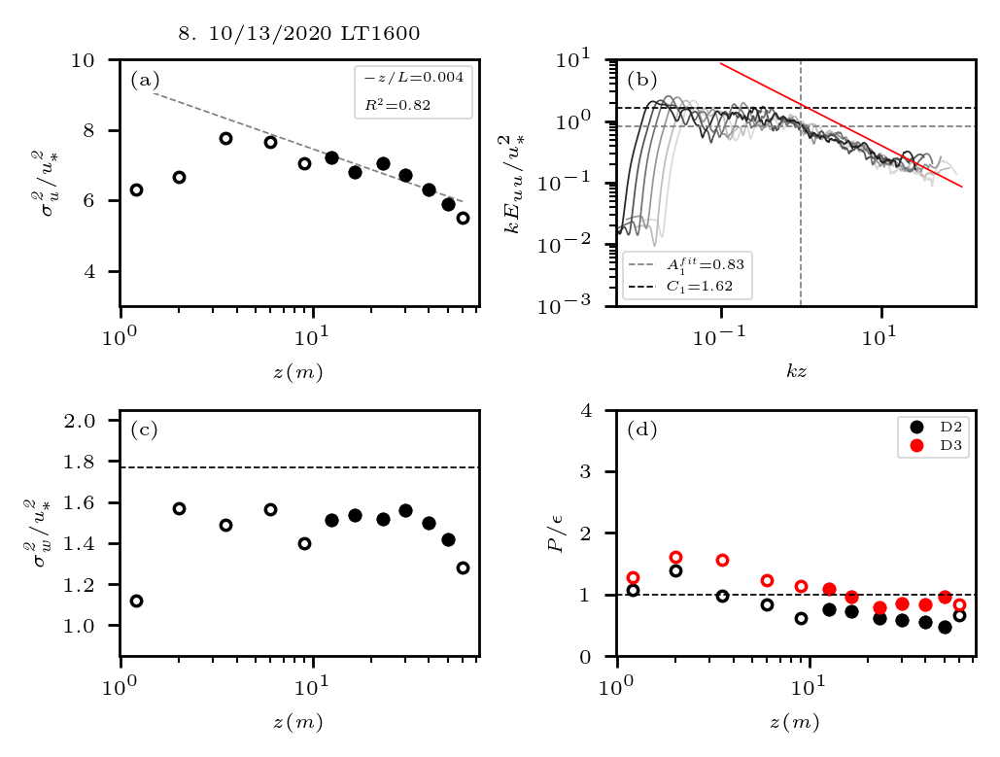

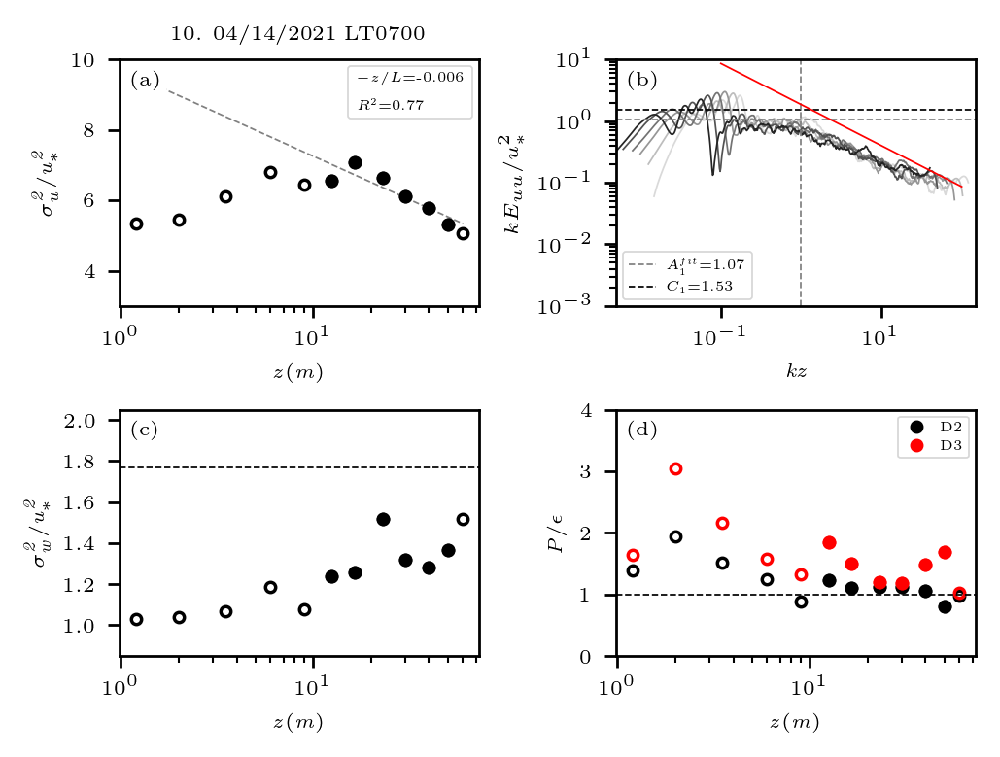

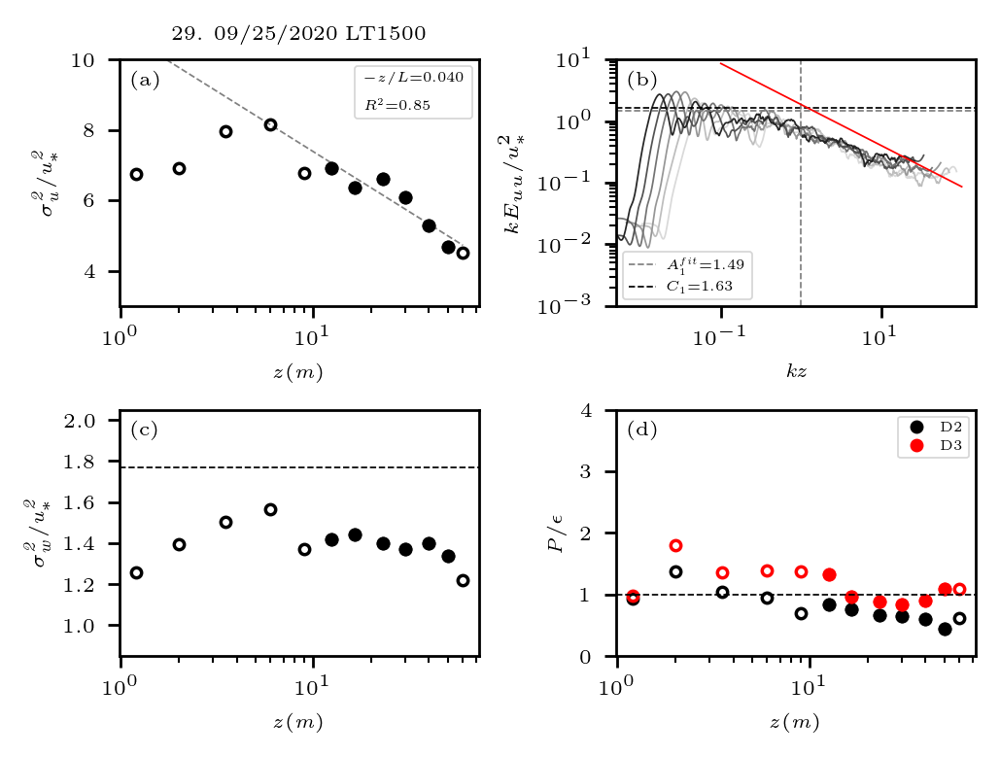

In [174]:
for i in range(len(group3)):
    plot_group(group3[i])
    plt.savefig(OUT_PLOT_DIR+f'combined_smoothed_ustd_Euu_wstd_tke_case{group3[i]+1}_group3.jpg',dpi=250, bbox_inches='tight')
    # plot_extra_group(group3[i])
    plt.show()

## Group4

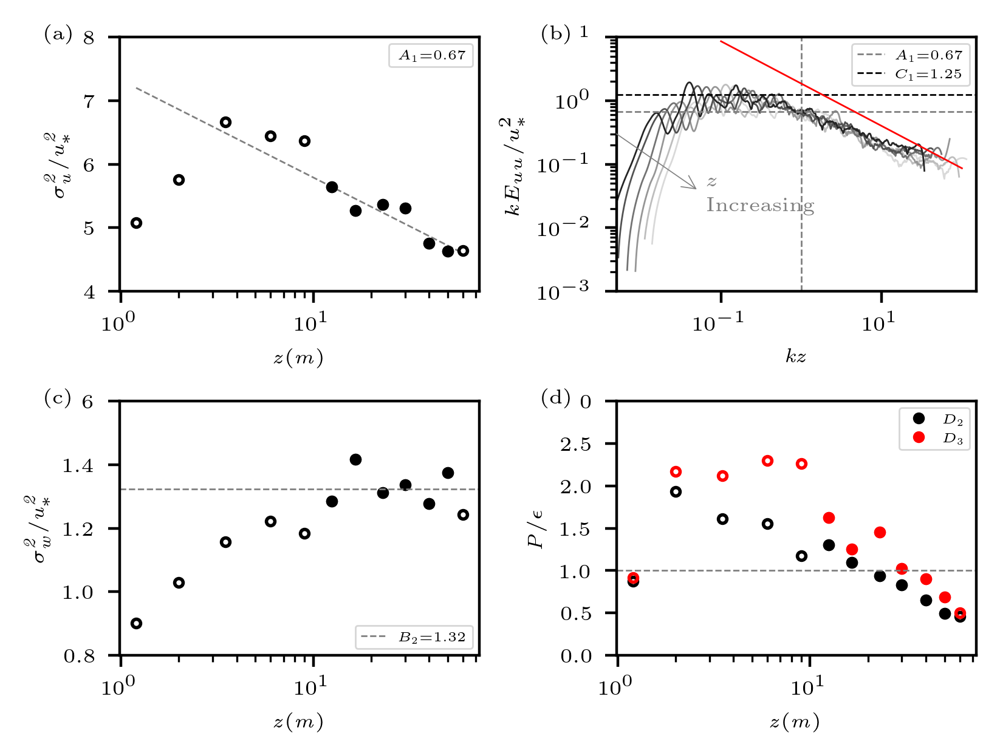

In [128]:
def plot_group_without_title(index_):
    subplot = [['1', '2'],
              ['3', '4']] 
    global text_loc
    text_loc = [-0.02, 0.9]
    fig, axes = plt.subplot_mosaic(subplot, constrained_layout=True)
    global trans
    trans = mtransforms.ScaledTranslation(-20/72, 7/72, fig.dpi_scale_trans)
    fig.set_size_inches(4,3)
    fig.set_dpi(400)
    plot_u_std_prof('(a)',axes['1'],index_,(4,8))
    # axes['1'].set_title(f'{index_+1}. '+ datetime_sort[index_][0].strftime("%m/%d/%Y")+' LT'+f"{datetime_sort[index_][1]:02}00",
    #       fontsize = font_size)
    plot_kEuu_sort('(b)',axes['2'],index_)
    plot_w_std_prof('(c)',axes['3'],index_,(0.8,1.6))
    plot_P_D_ratio('(d)',axes['4'],index_,(0,3))
    # Adjust spacing
    fig.subplots_adjust(wspace=0.5)  # Adjust the width space between subplots
    fig.subplots_adjust(hspace=0.4)  # Adjust the height space between subplots

plot_group_without_title(group4[0])
plt.savefig(OUT_PLOT_DIR+f'combined_smoothed_ustd_Euu_wstd_tke_G4_20201119_LT1400.jpg',dpi=400, bbox_inches='tight')

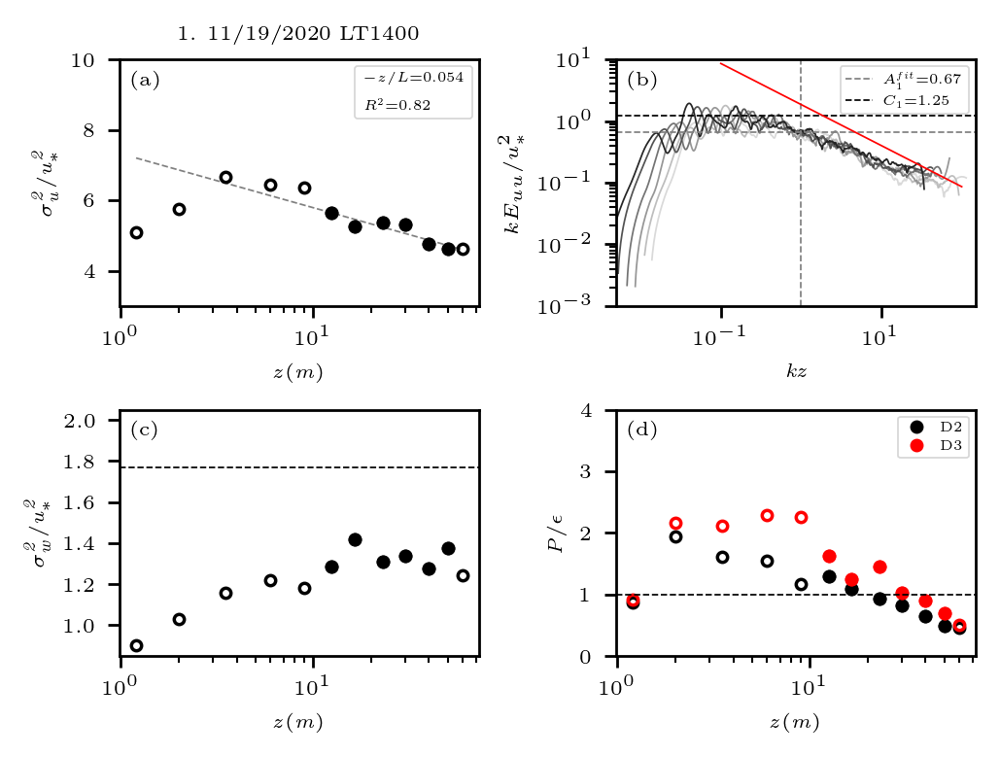

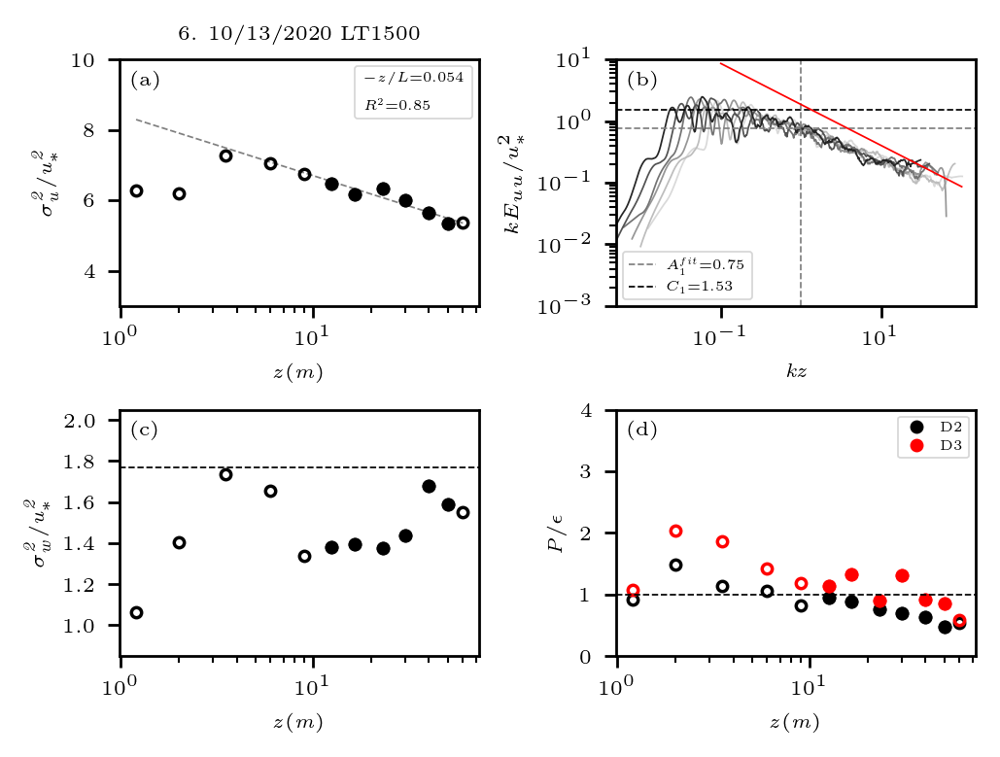

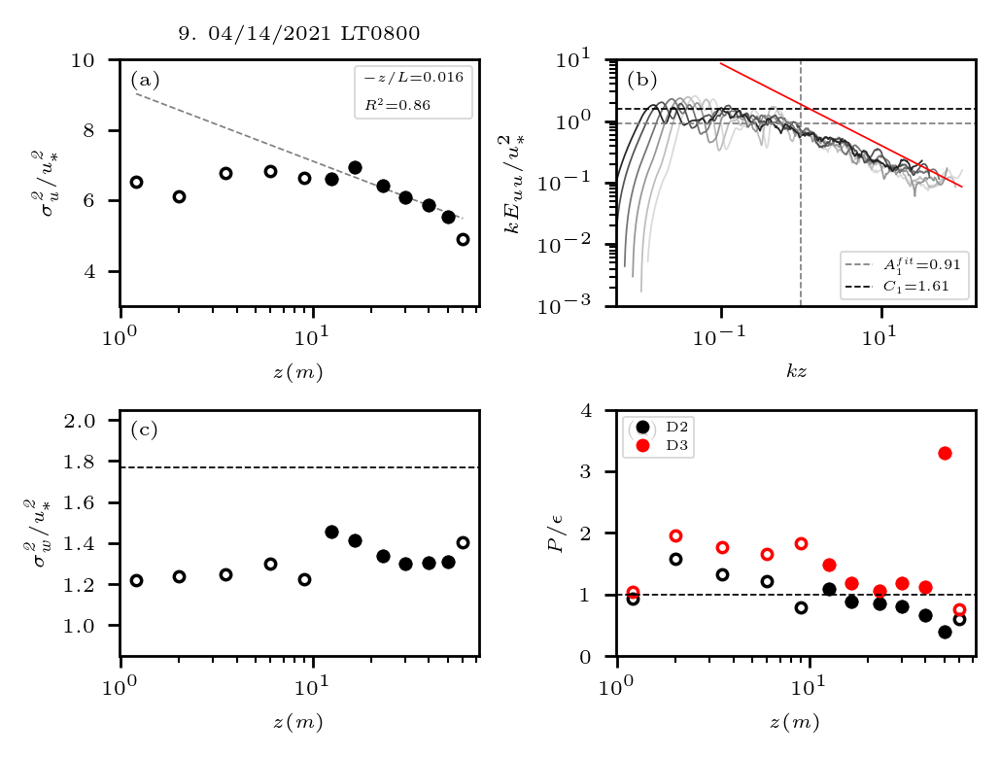

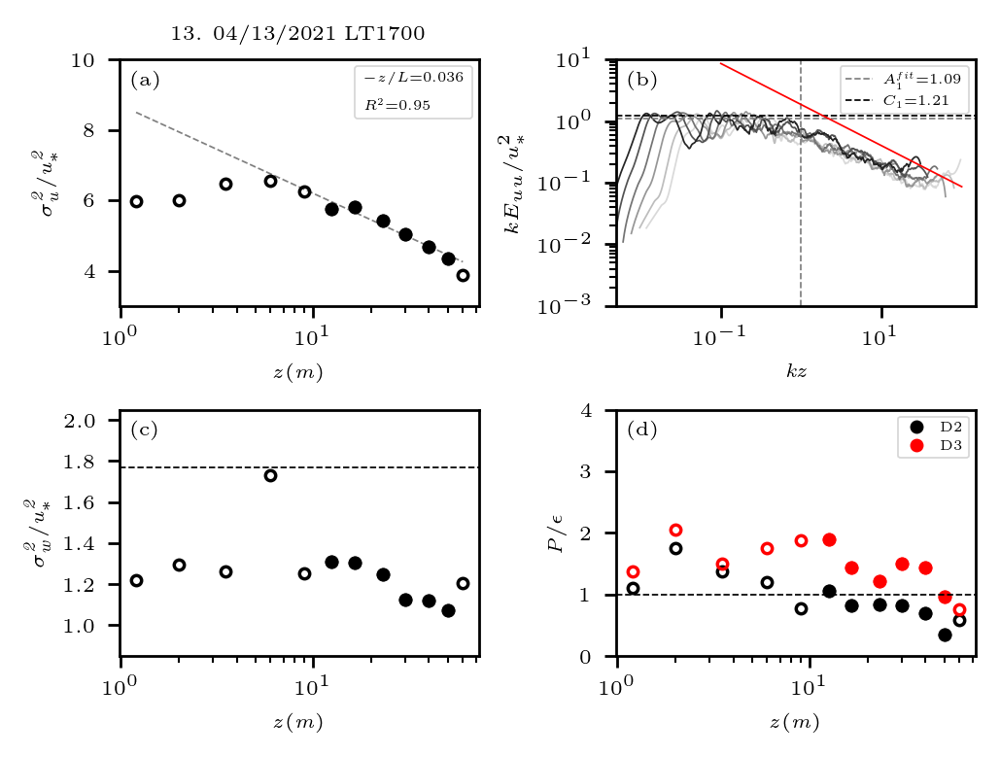

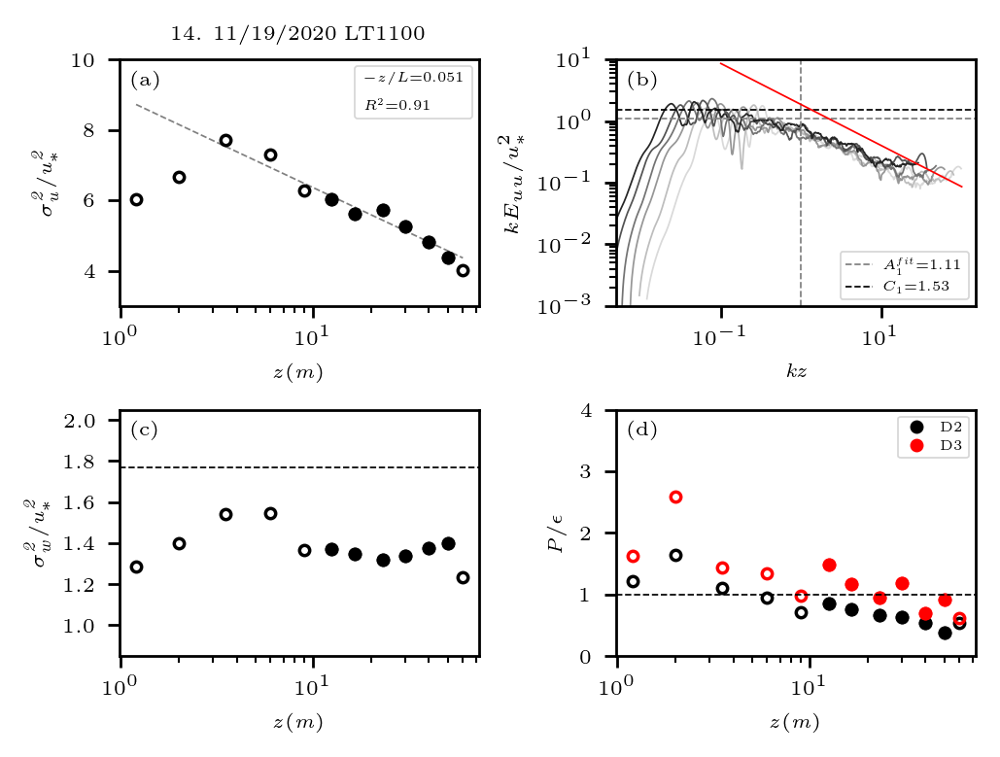

In [175]:
for i in range(len(group4)):
    plot_group(group4[i])
    plt.savefig(OUT_PLOT_DIR+f'combined_smoothed_ustd_Euu_wstd_tke_case{group4[i]+1}_group4.jpg',dpi=250, bbox_inches='tight')
    # plot_extra_group(group4[i])
    plt.show()

## Group5

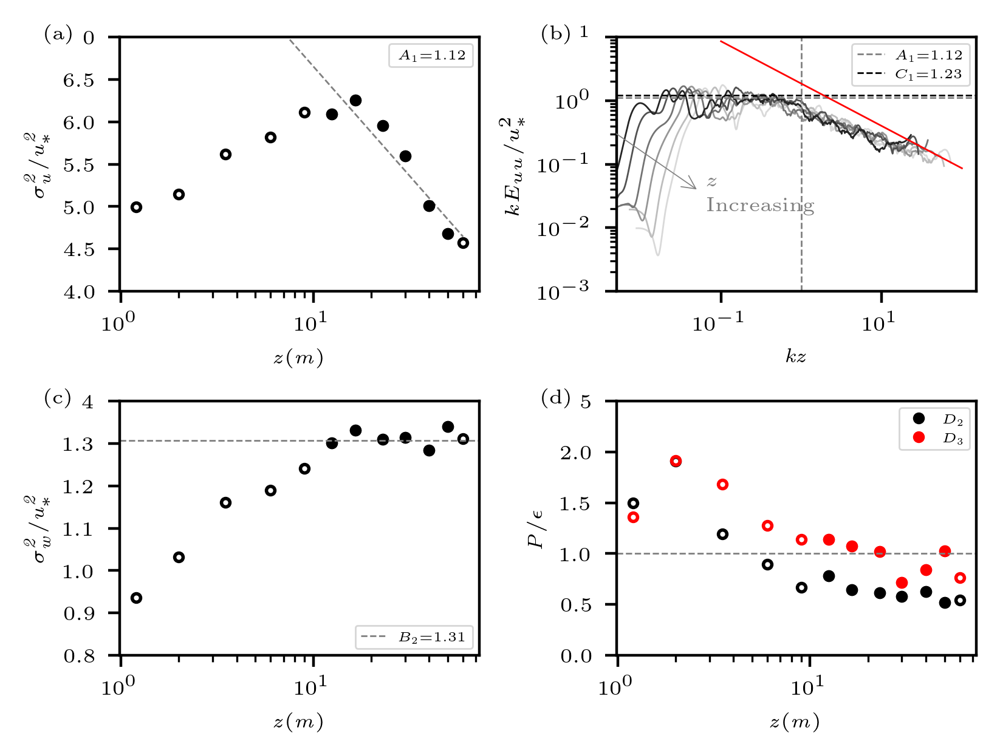

In [127]:
def plot_group_without_title(index_):
    subplot = [['1', '2'],
              ['3', '4']] 
    global text_loc
    text_loc = [-0.02, 0.9]
    fig, axes = plt.subplot_mosaic(subplot, constrained_layout=True)
    global trans
    trans = mtransforms.ScaledTranslation(-20/72, 7/72, fig.dpi_scale_trans)
    fig.set_size_inches(4,3)
    fig.set_dpi(400)
    plot_u_std_prof('(a)',axes['1'],index_,(4,7))
    # axes['1'].set_title(f'{index_+1}. '+ datetime_sort[index_][0].strftime("%m/%d/%Y")+' LT'+f"{datetime_sort[index_][1]:02}00",
    #       fontsize = font_size)
    plot_kEuu_sort('(b)',axes['2'],index_)
    plot_w_std_prof('(c)',axes['3'],index_,(0.8,1.4))
    plot_P_D_ratio('(d)',axes['4'],index_,(0,2.5))
    # Adjust spacing
    fig.subplots_adjust(wspace=0.5)  # Adjust the width space between subplots
    fig.subplots_adjust(hspace=0.4)  # Adjust the height space between subplots

plot_group_without_title(group5[0])
plt.savefig(OUT_PLOT_DIR+f'combined_smoothed_ustd_Euu_wstd_tke_20210329_LT0400.jpg',dpi=400, bbox_inches='tight')

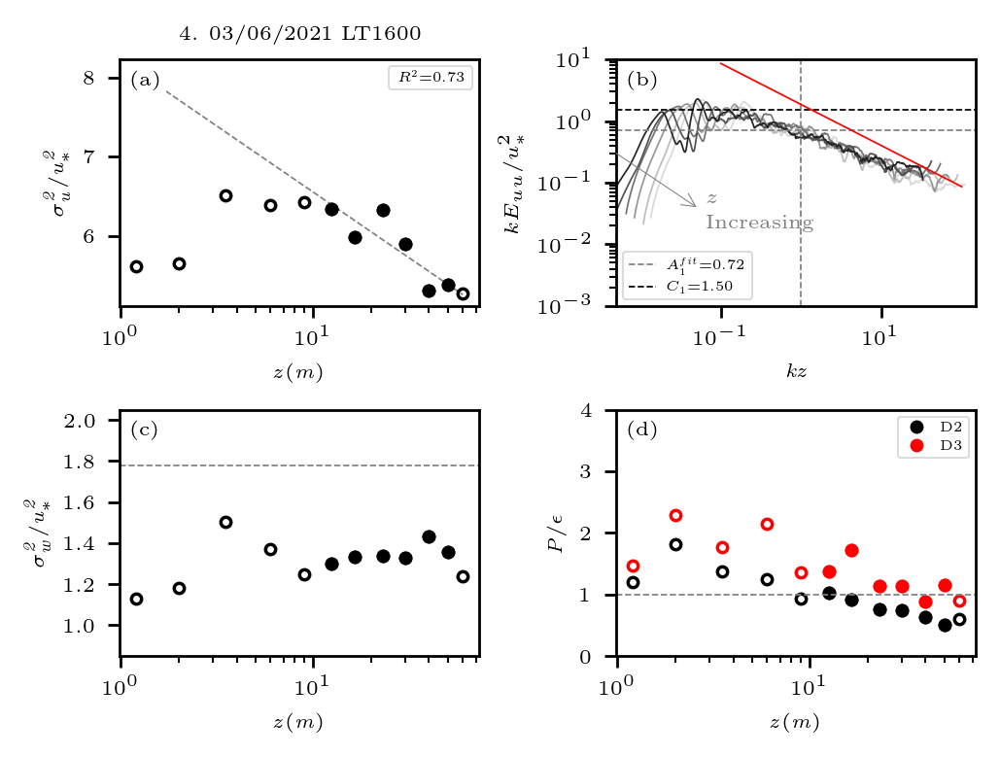

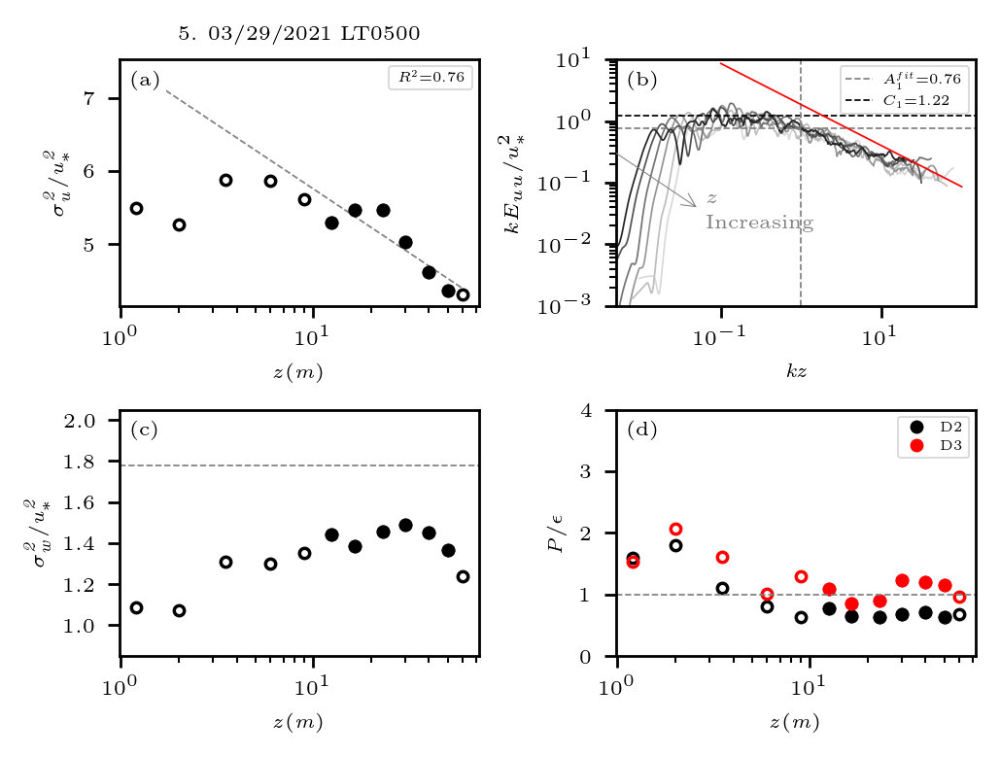

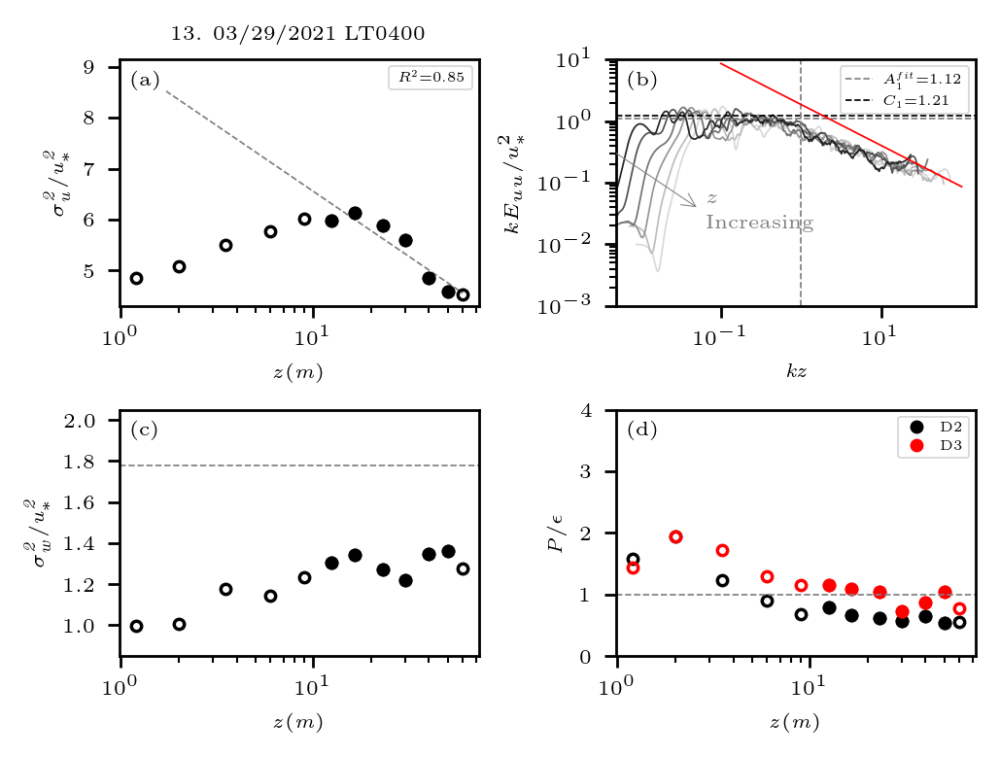

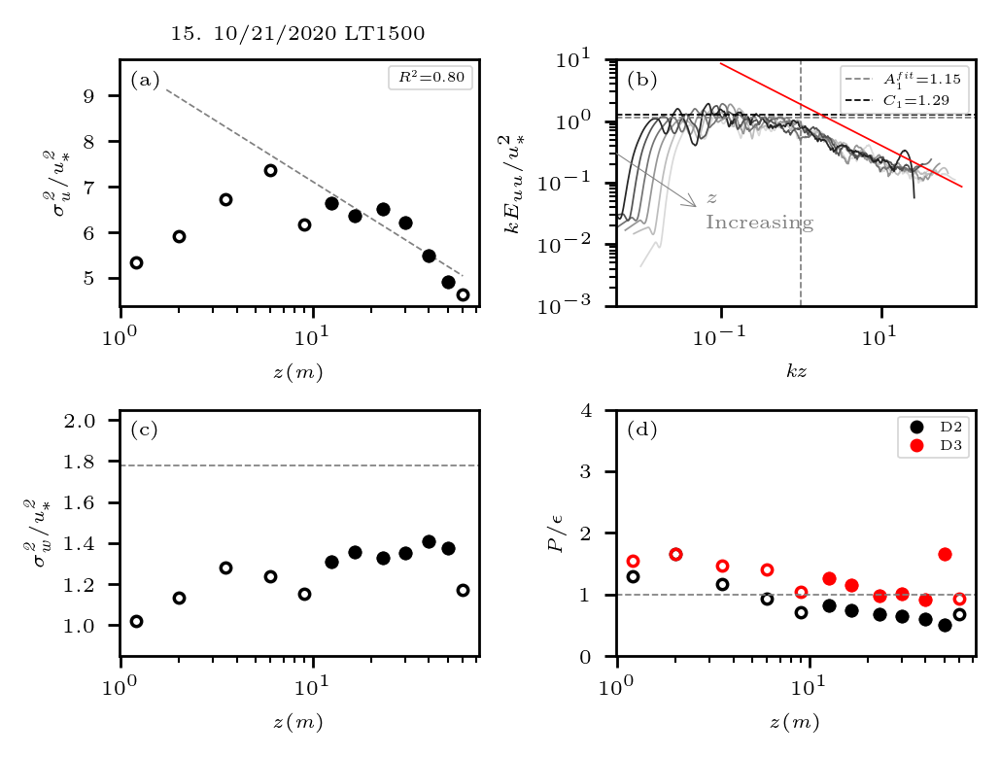

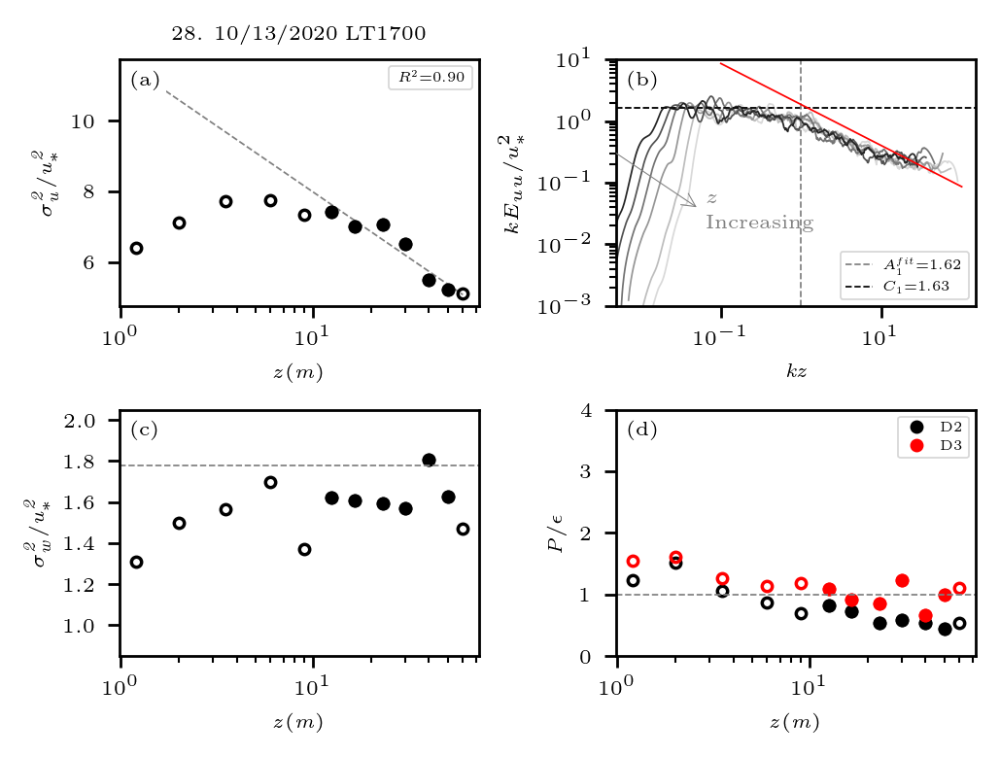

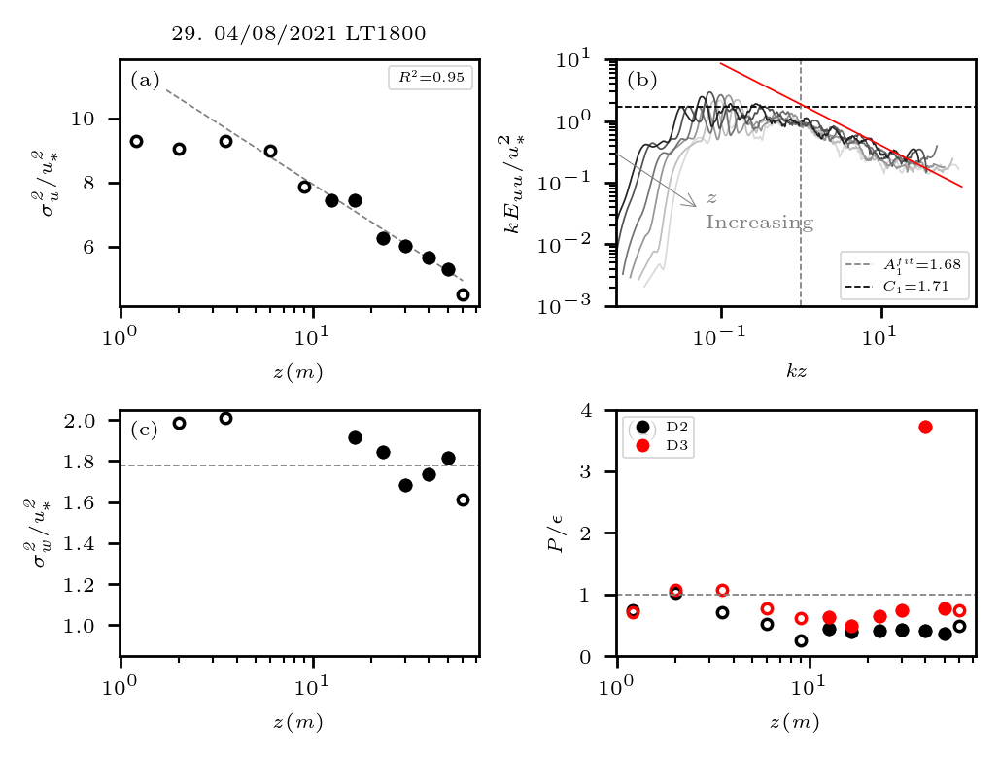

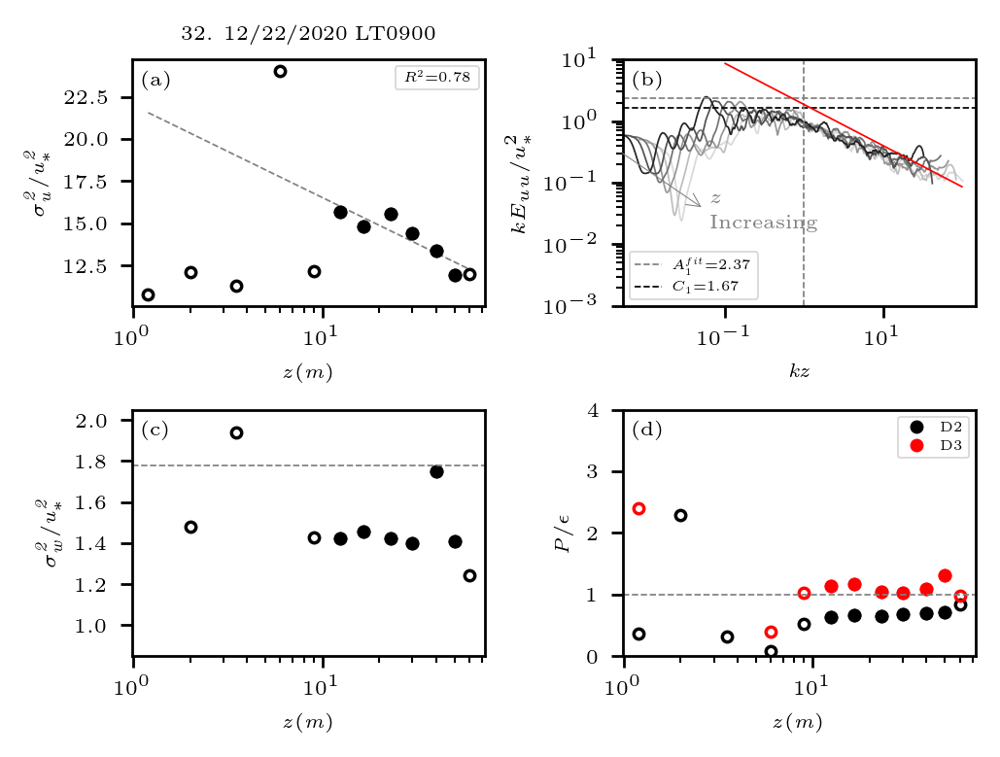

In [399]:
for i in range(len(group5)):
    plot_group(group5[i])
    # plt.savefig(OUT_PLOT_DIR+f'combined_smoothed_ustd_Euu_wstd_tke_case{group5[i]+1}_group5.jpg',dpi=250, bbox_inches='tight')
    # plot_extra_group(group4[i])
    plt.show()

# Statistics of A1, C1

In [427]:
# Assuming A1_sort and Euu_95_mean_sort are your arrays and group1, group2, ... group5 are your group indices
groups = [group1, group2, group3, group4, group5]

for i, group in enumerate(groups, start=1):
    A1_mean = np.nanmean(A1_sort[group])
    A1_std = np.nanstd(A1_sort[group])
    A1_min = np.nanmin(A1_sort[group])
    A1_max = np.nanmax(A1_sort[group])

    Euu_mean = np.nanmean(Euu_95_mean_sort[group])
    Euu_std = np.nanstd(Euu_95_mean_sort[group])
    Euu_min = np.nanmin(Euu_95_mean_sort[group])
    Euu_max = np.nanmax(Euu_95_mean_sort[group])
    
    correlation = np.corrcoef(A1_sort[group], Euu_95_mean_sort[group])[0, 1]

    print(f'Group{i}:')
    print(f'  A1: mean={A1_mean:.2f}, std={A1_std:.2f}, min={A1_min:.2f}, max={A1_max:.2f}')
    print(f'  C1: mean={Euu_mean:.2f}, std={Euu_std:.2f}, min={Euu_min:.2f}, max={Euu_max:.2f}')
    print(f'  Correlation: {correlation:.2f}')

# Calculating statistics and correlation for all data combined
A1_mean_all = np.nanmean(A1_sort)
A1_std_all = np.nanstd(A1_sort)
A1_min_all = np.nanmin(A1_sort)
A1_max_all = np.nanmax(A1_sort)

Euu_mean_all = np.nanmean(Euu_95_mean_sort)
Euu_std_all = np.nanstd(Euu_95_mean_sort)
Euu_min_all = np.nanmin(Euu_95_mean_sort)
Euu_max_all = np.nanmax(Euu_95_mean_sort)

correlation_all = np.corrcoef(A1_sort, Euu_95_mean_sort)[0, 1]

print('All data:')
print(f'  A1: mean={A1_mean_all:.2f}, std={A1_std_all:.2f}, min={A1_min_all:.2f}, max={A1_max_all:.2f}')
print(f'  C1: mean={Euu_mean_all:.2f}, std={Euu_std_all:.2f}, min={Euu_min_all:.2f}, max={Euu_max_all:.2f}')
print(f'  Correlation: {correlation_all:.2f}')

Group1:
  A1: mean=1.34, std=0.18, min=1.08, max=1.48
  C1: mean=1.58, std=0.29, min=1.17, max=1.80
  Correlation: -0.40
Group2:
  A1: mean=1.42, std=0.26, min=0.77, max=1.79
  C1: mean=1.37, std=0.17, min=1.14, max=1.67
  Correlation: 0.41
Group3:
  A1: mean=0.89, std=0.27, min=0.70, max=1.49
  C1: mean=1.57, std=0.09, min=1.41, max=1.69
  Correlation: 0.26
Group4:
  A1: mean=0.90, std=0.18, min=0.67, max=1.11
  C1: mean=1.42, std=0.16, min=1.21, max=1.61
  Correlation: 0.06
Group5:
  A1: mean=1.28, std=0.23, min=1.12, max=1.83
  C1: mean=1.35, std=0.11, min=1.21, max=1.58
  Correlation: 0.16
All data:
  A1: mean=1.22, std=0.33, min=0.67, max=1.83
  C1: mean=1.43, std=0.18, min=1.14, max=1.80
  Correlation: -0.07


In [54]:
correlation

0.41961244751712046

# Plot A1, C1 against Re_b

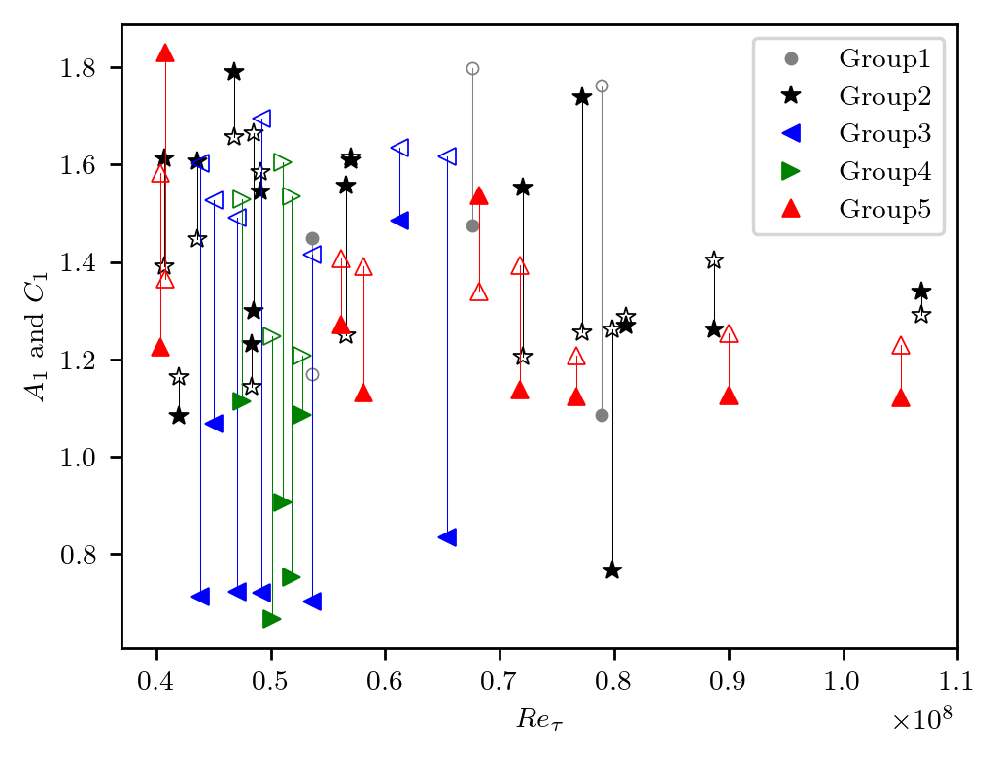

In [424]:
font_size = 8
mark_size = 5
line_width = 0.5
subplot = [['1']]
def plot_fig_group(group,marker,color,label,mark_size,ax_):
    ax_.plot(Re_b_sort[group],A1_sort[group],marker,color = color, 
               markersize=mark_size, markeredgewidth=line_width, label=label)
    ax_.plot(Re_b_sort[group],Euu_95_mean_sort[group],marker,color = color, 
               markersize=mark_size, markeredgewidth=line_width, markerfacecolor='none')
    # Add lines connecting the closed and open symbols
    for x, y1, y2 in zip(Re_b_sort[group], A1_sort[group], Euu_95_mean_sort[group]):
        ax_.plot([x, x], [y1, y2], color=color, linewidth=0.3)
    
    ax_.set_ylabel(r'$A_1$ and $C_1$', fontsize=font_size)
    # ax_.text(text_loc[0], text_loc[1], fig_lbl, transform=ax_.transAxes + trans,
    #             fontsize=font_size, zorder=2, 
    #             bbox={'facecolor': 'white', 'edgecolor': 'none', 'pad': 1})
    # ax_.set_ylim((-2,5))
    # ax_.legend(fontsize=font_size)

# y_temp = A1_filt
fig, axes = plt.subplot_mosaic(subplot, constrained_layout=True)
trans = mtransforms.ScaledTranslation(-20/72, 7/72, fig.dpi_scale_trans)
fig.set_size_inches(4,3)
fig.set_dpi(250)

plot_fig_group(group1,'.','grey', 'Group1',mark_size+2,axes['1'])
plot_fig_group(group2,'*','black', 'Group2',mark_size+1, axes['1'])
plot_fig_group(group3,'<','blue', 'Group3',mark_size, axes['1'])
plot_fig_group(group4,'>','green', 'Group4',mark_size, axes['1'])
plot_fig_group(group5,'^','red', 'Group5',mark_size, axes['1'])
axes['1'].set_xlabel(r'${{Re}_{\tau}}$', fontsize=font_size)
plt.legend(fontsize = font_size)
# axes['1'].set_ylim((0.6,2.5))
axes['1'].set_xlim((37000000,110000000))
plt.savefig(OUT_PLOT_DIR+f'grouped_C1_A1_vs_Reb.jpg',dpi=400, bbox_inches='tight')

## Combine them into 1 figure

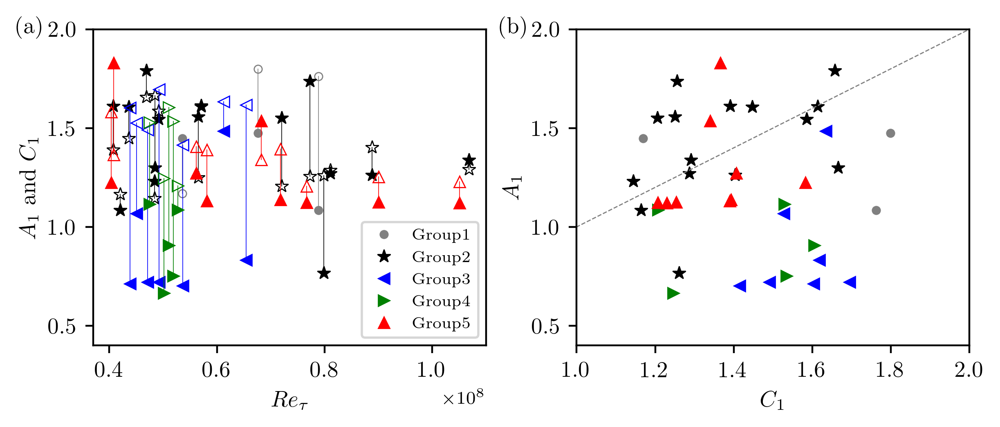

In [162]:
mark_size = 5
line_width = 0.5
font_size=10
text_loc = [-0.08, 0.92]
# Plotting function
def plot_fig_group(group, marker, color, label, mark_size, ax_):
    ax_.plot(Re_b_sort[group], A1_sort[group], marker, color=color, 
             markersize=mark_size, markeredgewidth=0.5, label=label)
    ax_.plot(Re_b_sort[group], Euu_95_mean_sort[group], marker, color=color, 
             markersize=mark_size, markeredgewidth=0.5, markerfacecolor='none')
    # Add lines connecting the closed and open symbols
    for x, y1, y2 in zip(Re_b_sort[group], A1_sort[group], Euu_95_mean_sort[group]):
        ax_.plot([x, x], [y1, y2], color=color, linewidth=0.3)
    ax_.set_ylabel(r'$A_1$ and $C_1$', fontsize=font_size)

# Set up the 1x2 figure layout
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(6, 2.5), dpi=400, constrained_layout=True)

# Plotting the first subplot
plot_fig_group(group1, '.', 'grey', 'Group1', 7, ax1)
plot_fig_group(group2, '*', 'black', 'Group2', 6, ax1)
plot_fig_group(group3, '<', 'blue', 'Group3', 5, ax1)
plot_fig_group(group4, '>', 'green', 'Group4', 5, ax1)
plot_fig_group(group5, '^', 'red', 'Group5', 5, ax1)
ax1.set_xlabel(r'${{Re}_{\tau}}$', fontsize=font_size)
ax1.set_xlim((37000000, 110000000))
ax1.set_ylim(0.4, 2)
ax1.tick_params(axis='both', labelsize=font_size)
ax1.legend(fontsize=7)
ax1.text(text_loc[0], text_loc[1], '(a)', transform=ax1.transAxes + trans,
                fontsize=font_size, va='bottom')

# Plotting the second subplot
# mark_size = 3
# line_width = 0.5
correlation = np.corrcoef(A1_sort[group1], Euu_95_mean_sort[group1])[0, 1]
ax2.plot(Euu_95_mean_sort[group1], A1_sort[group1], '.', color='grey', 
         markersize=7, markeredgewidth=line_width, label=f"R={correlation:.2f}")
correlation = np.corrcoef(A1_sort[group2], Euu_95_mean_sort[group2])[0, 1]
ax2.plot(Euu_95_mean_sort[group2], A1_sort[group2], '*', color='black', 
         markersize=6, markeredgewidth=line_width, label=f"R={correlation:.2f}")
correlation = np.corrcoef(A1_sort[group3], Euu_95_mean_sort[group3])[0, 1]
ax2.plot(Euu_95_mean_sort[group3], A1_sort[group3], '<', color='blue', 
         markersize=5, markeredgewidth=line_width, label=f"R={correlation:.2f}")
correlation = np.corrcoef(A1_sort[group4], Euu_95_mean_sort[group4])[0, 1]
ax2.plot(Euu_95_mean_sort[group4], A1_sort[group4], '>', color='green', 
         markersize=5, markeredgewidth=line_width, label=f"R={correlation:.2f}")
correlation = np.corrcoef(A1_sort[group5], Euu_95_mean_sort[group5])[0, 1]
ax2.plot(Euu_95_mean_sort[group5], A1_sort[group5], '^', color='red', 
         markersize=5, markeredgewidth=line_width, label=f"R={correlation:.2f}")
ax2.set_xlabel(r'$C_1$', fontsize=font_size)
ax2.set_ylabel(r'$A_1$', fontsize=font_size)
ax2.set_xlim(1, 2)
ax2.set_ylim(0.4, 2)
ax2.tick_params(axis='both', labelsize=font_size)
ax2.plot([0, 2], [0, 2], '--', color='gray', linewidth=line_width)
ax2.text(text_loc[0], text_loc[1], '(b)', transform=ax2.transAxes + trans,
                fontsize=font_size, va='bottom')
# fig.subplots_adjust(wspace=1)
plt.savefig(OUT_PLOT_DIR+'grouped_C1_A1_vs_Reb_combined.jpg', dpi=400, bbox_inches='tight')
plt.show()

# Plot C1,95 perc against A1,fit

In [53]:
A1_sort[group5]

array([0.69055699, 0.91102533, 1.03138458, 1.05920194, 1.10230385,
       1.12613899, 1.14565512, 1.16345878, 1.22498013, 1.28398953,
       1.51964008, 1.58291949, 1.59139346, 1.59358717, 1.61783519,
       1.87680322])

In [106]:
OUT_PLOT_DIR

'/projectnb/urbanclimate/yueqin/idaho_ec_jupyter/save_fig_2rot/'

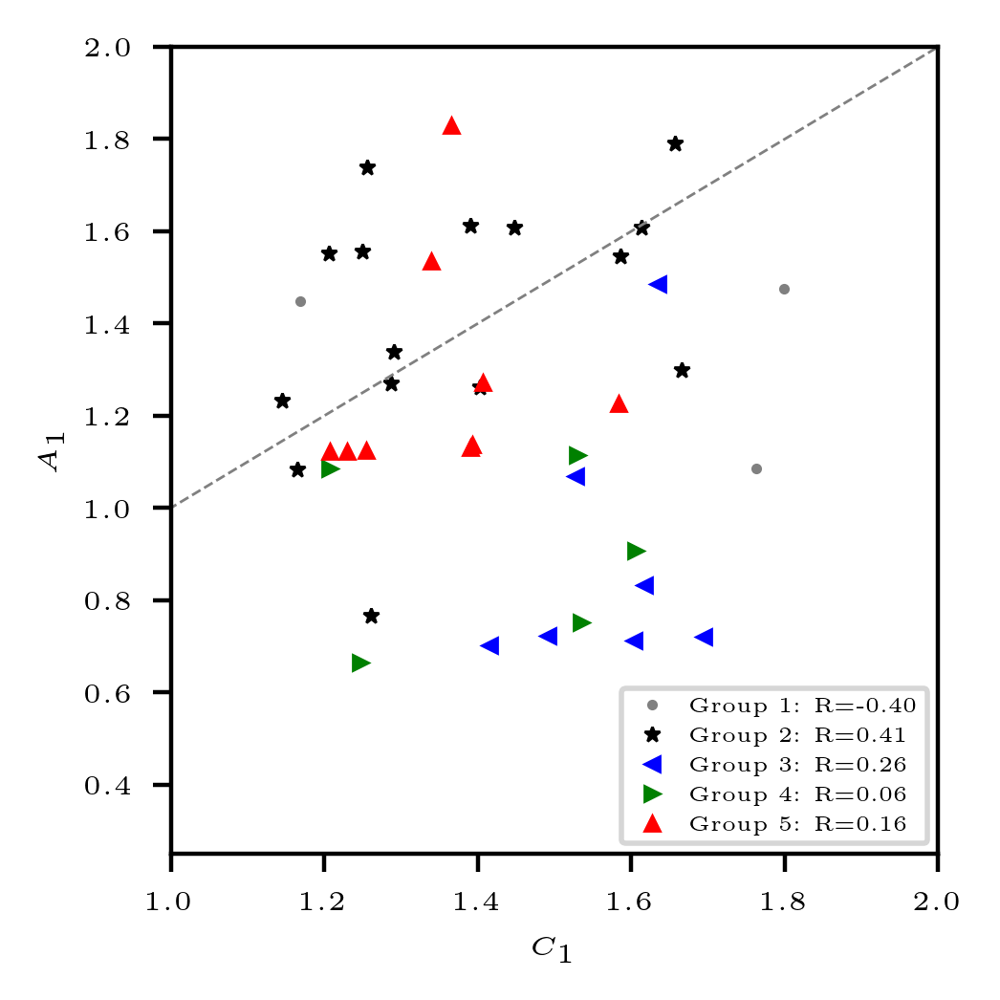

In [27]:
font_size = 5
mark_size = 3
line_width = 0.5
subplot = [['1']]
fig, axes = plt.subplot_mosaic(subplot, constrained_layout=True)
trans = mtransforms.ScaledTranslation(-20/72, 7/72, fig.dpi_scale_trans)
fig.set_size_inches(2.5,2.5)
fig.set_dpi(400)
# axes['1'].plot(A1,Euu_95_mean,'+',color = 'black', markersize=mark_size, markeredgewidth=line_width)
correlation = np.corrcoef(A1_sort[group1], Euu_95_mean_sort[group1])[0, 1]
axes['1'].plot(Euu_95_mean_sort[group1],A1_sort[group1],'.',color = 'grey', 
               markersize=mark_size, markeredgewidth=line_width, label=f"Group 1: R={correlation:.2f}")
correlation = np.corrcoef(A1_sort[group2], Euu_95_mean_sort[group2])[0, 1]
axes['1'].plot(Euu_95_mean_sort[group2],A1_sort[group2],'*',color = 'black', 
               markersize=mark_size, markeredgewidth=line_width, label=f"Group 2: R={correlation:.2f}")
correlation = np.corrcoef(A1_sort[group3], Euu_95_mean_sort[group3])[0, 1]
axes['1'].plot(Euu_95_mean_sort[group3],A1_sort[group3],'<',color = 'blue', 
               markersize=mark_size, markeredgewidth=line_width, label=f"Group 3: R={correlation:.2f}")
correlation = np.corrcoef(A1_sort[group4], Euu_95_mean_sort[group4])[0, 1]
axes['1'].plot(Euu_95_mean_sort[group4],A1_sort[group4],'>',color = 'green', 
               markersize=mark_size, markeredgewidth=line_width, label=f"Group 4: R={correlation:.2f}")
correlation = np.corrcoef(A1_sort[group5], Euu_95_mean_sort[group5])[0, 1]
axes['1'].plot(Euu_95_mean_sort[group5],A1_sort[group5],'^',color = 'red', 
               markersize=mark_size, markeredgewidth=line_width, label=f"Group 5: R={correlation:.2f}")
axes['1'].set_xlabel(r'$C_1$', fontsize = font_size)
axes['1'].set_ylabel(r'$A_1$', fontsize = font_size)
axes['1'].set_xlim(1,2)
axes['1'].set_ylim(0.25,2)
axes['1'].tick_params(axis='both', labelsize=font_size)
plt.plot([0, 2], [0, 2],'--',color = 'gray',linewidth=line_width)
legend = axes['1'].legend(loc='lower right',fontsize=font_size-1)
# plt.title("Without de-spiking, Planar fit",fontsize=font_size+2)
plt.savefig(OUT_PLOT_DIR+f'grouped_C1_95th_vs_A1.jpg',dpi=400, bbox_inches='tight')

In [17]:
# Calculating correlation for each group
for i, group in enumerate(groups, start=1):
    correlation = np.corrcoef(A1_sort[group], Euu_95_mean_sort[group])[0, 1]
    print(f'Group{i} correlation: {correlation:.2f}')

# Calculating correlation for all data combined
correlation_all = np.corrcoef(A1_sort, Euu_95_mean_sort)[0, 1]
print(f'All data correlation: {correlation_all:.2f}')

Group1 correlation: -0.38
Group2 correlation: -0.18
Group3 correlation: -0.14
Group4 correlation: -0.35
Group5 correlation: 0.72
All data correlation: -0.06


In [113]:
len(group1),len(group2),len(group3),len(group4),len(group5)

(5, 11, 9, 7, 9)

# ***** sigma_w^2/u_*^2 vs A1 and kappa

In [22]:
A1_sort.shape

(39,)

In [90]:
# Calculate the mean sigma_w^2/u_*^2 of the inertial sublayer
w_std_plus_sort_mean = np.nanmean(w_std_plus_sort[:,list_sel],axis=1)
w_std_plus_sort_ldtr_mean = np.nanmean(w_std_plus_ldtr_sort[:,list_sel],axis=1)
w_std_plus_sort_ldtr2_mean = np.nanmean(w_std_plus_ldtr2_sort[:,list_sel],axis=1)
w_std_plus_sort_mean.shape

(39,)

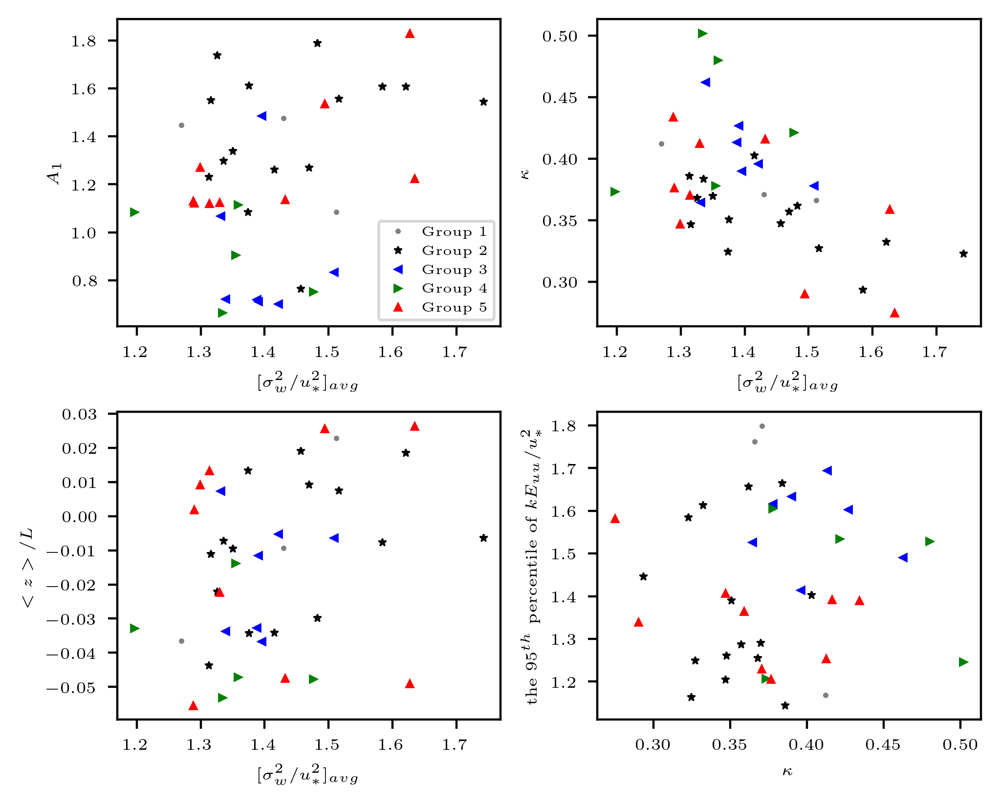

In [91]:
font_size = 6
mark_size = 3
line_width = 0.5
subplot = [['1','2'],['3','4']]
fig, axes = plt.subplot_mosaic(subplot, constrained_layout=True)
trans = mtransforms.ScaledTranslation(-20/72, 7/72, fig.dpi_scale_trans)
fig.set_size_inches(5,4)
fig.set_dpi(400)
# axes['1'].plot(A1,Euu_95_mean,'+',color = 'black', markersize=mark_size, markeredgewidth=line_width)
axes['1'].plot(w_std_plus_sort_mean[group1],A1_sort[group1],'.',color = 'grey', 
               markersize=mark_size, markeredgewidth=line_width, label='Group 1')
axes['1'].plot(w_std_plus_sort_mean[group2],A1_sort[group2],'*',color = 'black', 
               markersize=mark_size, markeredgewidth=line_width, label='Group 2')
axes['1'].plot(w_std_plus_sort_mean[group3],A1_sort[group3],'<',color = 'blue', 
               markersize=mark_size, markeredgewidth=line_width, label='Group 3')
axes['1'].plot(w_std_plus_sort_mean[group4],A1_sort[group4],'>',color = 'green', 
               markersize=mark_size, markeredgewidth=line_width, label='Group 4')
axes['1'].plot(w_std_plus_sort_mean[group5],A1_sort[group5],'^',color = 'red', 
               markersize=mark_size, markeredgewidth=line_width, label='Group 5')
axes['1'].set_xlabel(r'$[\sigma_w^2/u_*^2]_{avg}$', fontsize = font_size)
axes['1'].set_ylabel(r'$A_1$', fontsize = font_size)
axes['1'].tick_params(axis='both', labelsize=font_size)
# plt.plot([0, 2], [0, 2],'--',color = 'gray',linewidth=line_width)
legend = axes['1'].legend(loc='lower right',fontsize=font_size-1)

axes['2'].plot(w_std_plus_sort_mean[group1],kappa_sort[group1],'.',color = 'grey', 
               markersize=mark_size, markeredgewidth=line_width, label='Group 1')
axes['2'].plot(w_std_plus_sort_mean[group2],kappa_sort[group2],'*',color = 'black', 
               markersize=mark_size, markeredgewidth=line_width, label='Group 2')
axes['2'].plot(w_std_plus_sort_mean[group3],kappa_sort[group3],'<',color = 'blue', 
               markersize=mark_size, markeredgewidth=line_width, label='Group 3')
axes['2'].plot(w_std_plus_sort_mean[group4],kappa_sort[group4],'>',color = 'green', 
               markersize=mark_size, markeredgewidth=line_width, label='Group 4')
axes['2'].plot(w_std_plus_sort_mean[group5],kappa_sort[group5],'^',color = 'red', 
               markersize=mark_size, markeredgewidth=line_width, label='Group 5')
axes['2'].set_xlabel(r'$[\sigma_w^2/u_*^2]_{avg}$', fontsize = font_size)
axes['2'].set_ylabel(r'$\kappa$', fontsize = font_size)
axes['2'].tick_params(axis='both', labelsize=font_size)
plt.savefig(OUT_PLOT_DIR+f'sigmaw_vs_A1_kappa.jpg',dpi=400, bbox_inches='tight')
axes['3'].plot(w_std_plus_sort_mean[group1],zol_sort[group1],'.',color = 'grey', 
               markersize=mark_size, markeredgewidth=line_width, label='Group 1')
axes['3'].plot(w_std_plus_sort_mean[group2],zol_sort[group2],'*',color = 'black', 
               markersize=mark_size, markeredgewidth=line_width, label='Group 2')
axes['3'].plot(w_std_plus_sort_mean[group3],zol_sort[group3],'<',color = 'blue', 
               markersize=mark_size, markeredgewidth=line_width, label='Group 3')
axes['3'].plot(w_std_plus_sort_mean[group4],zol_sort[group4],'>',color = 'green', 
               markersize=mark_size, markeredgewidth=line_width, label='Group 4')
axes['3'].plot(w_std_plus_sort_mean[group5],zol_sort[group5],'^',color = 'red', 
               markersize=mark_size, markeredgewidth=line_width, label='Group 5')
axes['3'].set_xlabel(r'$[\sigma_w^2/u_*^2]_{avg}$', fontsize = font_size)
axes['3'].set_ylabel(r'$<z>/L$', fontsize = font_size)
axes['3'].tick_params(axis='both', labelsize=font_size)

axes['4'].plot(kappa_sort[group1],Euu_95_mean_sort[group1],'.',color = 'grey', 
               markersize=mark_size, markeredgewidth=line_width, label='Group 1')
axes['4'].plot(kappa_sort[group2],Euu_95_mean_sort[group2],'*',color = 'black', 
               markersize=mark_size, markeredgewidth=line_width, label='Group 2')
axes['4'].plot(kappa_sort[group3],Euu_95_mean_sort[group3],'<',color = 'blue', 
               markersize=mark_size, markeredgewidth=line_width, label='Group 3')
axes['4'].plot(kappa_sort[group4],Euu_95_mean_sort[group4],'>',color = 'green', 
               markersize=mark_size, markeredgewidth=line_width, label='Group 4')
axes['4'].plot(kappa_sort[group5],Euu_95_mean_sort[group5],'^',color = 'red', 
               markersize=mark_size, markeredgewidth=line_width, label='Group 5')
axes['4'].set_xlabel(r'$\kappa$', fontsize = font_size)
axes['4'].set_ylabel(r'the $95^{th}$ percentile of $kE_{uu}/u_*^2$', fontsize = font_size)
axes['4'].tick_params(axis='both', labelsize=font_size)

# Plot sigma_w (filt vs ldtr)

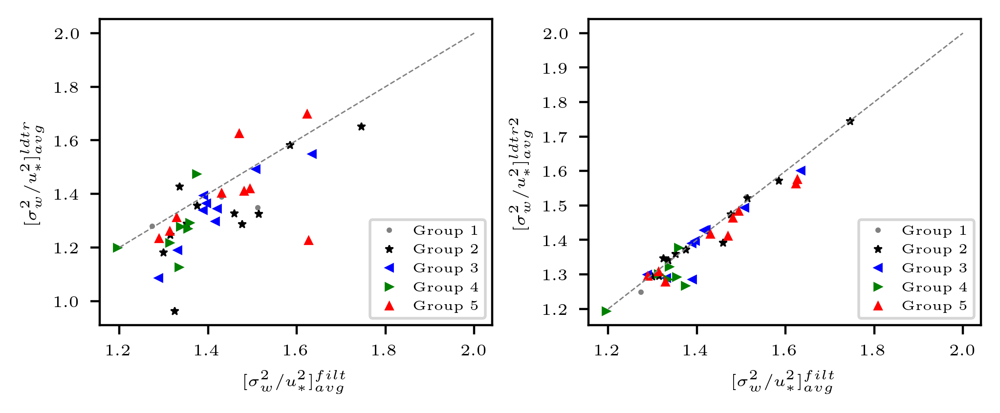

In [49]:
font_size = 6
mark_size = 3
line_width = 0.5
subplot = [['1','2']]
fig, axes = plt.subplot_mosaic(subplot, constrained_layout=True)
trans = mtransforms.ScaledTranslation(-20/72, 7/72, fig.dpi_scale_trans)
fig.set_size_inches(5,2)
fig.set_dpi(400)
# axes['1'].plot(A1,Euu_95_mean,'+',color = 'black', markersize=mark_size, markeredgewidth=line_width)
axes['1'].plot(w_std_plus_sort_mean[group1],w_std_plus_sort_ldtr_mean[group1],'.',color = 'grey', 
               markersize=mark_size, markeredgewidth=line_width, label='Group 1')
axes['1'].plot(w_std_plus_sort_mean[group2],w_std_plus_sort_ldtr_mean[group2],'*',color = 'black', 
               markersize=mark_size, markeredgewidth=line_width, label='Group 2')
axes['1'].plot(w_std_plus_sort_mean[group3],w_std_plus_sort_ldtr_mean[group3],'<',color = 'blue', 
               markersize=mark_size, markeredgewidth=line_width, label='Group 3')
axes['1'].plot(w_std_plus_sort_mean[group4],w_std_plus_sort_ldtr_mean[group4],'>',color = 'green', 
               markersize=mark_size, markeredgewidth=line_width, label='Group 4')
axes['1'].plot(w_std_plus_sort_mean[group5],w_std_plus_sort_ldtr_mean[group5],'^',color = 'red', 
               markersize=mark_size, markeredgewidth=line_width, label='Group 5')
axes['1'].set_xlabel(r'$[\sigma_w^2/u_*^2]_{avg}^{filt}$', fontsize = font_size)
axes['1'].set_ylabel(r'$[\sigma_w^2/u_*^2]_{avg}^{ldtr}$', fontsize = font_size)
axes['1'].tick_params(axis='both', labelsize=font_size)
axes['1'].plot([1.2,2], [1.2, 2],'--',color = 'gray',linewidth=line_width)
legend = axes['1'].legend(loc='lower right',fontsize=font_size-1)

axes['2'].plot(w_std_plus_sort_mean[group1],w_std_plus_sort_ldtr2_mean[group1],'.',color = 'grey', 
               markersize=mark_size, markeredgewidth=line_width, label='Group 1')
axes['2'].plot(w_std_plus_sort_mean[group2],w_std_plus_sort_ldtr2_mean[group2],'*',color = 'black', 
               markersize=mark_size, markeredgewidth=line_width, label='Group 2')
axes['2'].plot(w_std_plus_sort_mean[group3],w_std_plus_sort_ldtr2_mean[group3],'<',color = 'blue', 
               markersize=mark_size, markeredgewidth=line_width, label='Group 3')
axes['2'].plot(w_std_plus_sort_mean[group4],w_std_plus_sort_ldtr2_mean[group4],'>',color = 'green', 
               markersize=mark_size, markeredgewidth=line_width, label='Group 4')
axes['2'].plot(w_std_plus_sort_mean[group5],w_std_plus_sort_ldtr2_mean[group5],'^',color = 'red', 
               markersize=mark_size, markeredgewidth=line_width, label='Group 5')
axes['2'].set_xlabel(r'$[\sigma_w^2/u_*^2]_{avg}^{filt}$', fontsize = font_size)
axes['2'].set_ylabel(r'$[\sigma_w^2/u_*^2]_{avg}^{ldtr2}$', fontsize = font_size)
axes['2'].tick_params(axis='both', labelsize=font_size)
axes['2'].plot([1.2,2], [1.2, 2],'--',color = 'gray',linewidth=line_width)
legend = axes['2'].legend(loc='lower right',fontsize=font_size-1)

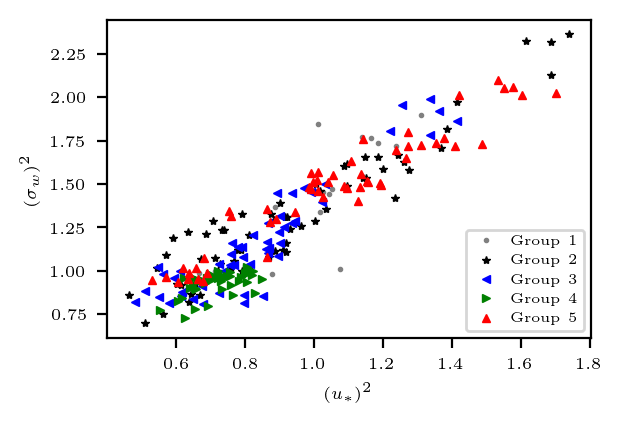

Slope (All Data): 1.24, R^2: 0.87, p-value: 8.93e-106
Slope (Group 1): 1.50, R^2: 0.71, p-value: 1.30e-05
Slope (Group 2): 1.17, R^2: 0.89, p-value: 1.16e-32
Slope (Group 3): 1.34, R^2: 0.85, p-value: 2.61e-23
Slope (Group 4): 0.55, R^2: 0.33, p-value: 6.05e-05
Slope (Group 5): 1.05, R^2: 0.91, p-value: 2.21e-29


In [165]:

# Assuming w_std_filt_sort, u_star_filt_sort, group1, group2, group3, group4, group5, and list_sel are defined

# Plot settings
font_size = 6
mark_size = 3
line_width = 0.5
subplot = [['1']]
fig, axes = plt.subplot_mosaic(subplot, constrained_layout=True)
trans = mtransforms.ScaledTranslation(-20 / 72, 7 / 72, fig.dpi_scale_trans)
fig.set_size_inches(3, 2)
fig.set_dpi(200)

# Function to calculate slope using linear regression
def calculate_slope(u_star_flat, w_std_flat):
    slope, intercept, r_value, p_value, std_err = stats.linregress(u_star_flat, w_std_flat)
    return slope, intercept, r_value**2, p_value

# Flatten and square the arrays after applying the group masks and list selection
w_std_flat_group1 = (w_std_filt_sort[group1, :][:, list_sel]**2).flatten()
u_star_flat_group1 = (u_star_filt_sort[group1, :][:, list_sel]**2).flatten()

w_std_flat_group2 = (w_std_filt_sort[group2, :][:, list_sel]**2).flatten()
u_star_flat_group2 = (u_star_filt_sort[group2, :][:, list_sel]**2).flatten()

w_std_flat_group3 = (w_std_filt_sort[group3, :][:, list_sel]**2).flatten()
u_star_flat_group3 = (u_star_filt_sort[group3, :][:, list_sel]**2).flatten()

w_std_flat_group4 = (w_std_filt_sort[group4, :][:, list_sel]**2).flatten()
u_star_flat_group4 = (u_star_filt_sort[group4, :][:, list_sel]**2).flatten()

w_std_flat_group5 = (w_std_filt_sort[group5, :][:, list_sel]**2).flatten()
u_star_flat_group5 = (u_star_filt_sort[group5, :][:, list_sel]**2).flatten()

# Combine all data to calculate the slope for the entire dataset
w_std_all = np.concatenate([w_std_flat_group1, w_std_flat_group2, w_std_flat_group3, w_std_flat_group4, w_std_flat_group5])
u_star_all = np.concatenate([u_star_flat_group1, u_star_flat_group2, u_star_flat_group3, u_star_flat_group4, u_star_flat_group5])

# Calculate slopes for each group and all data
slope_all, intercept_all, r2_all, p_value_all = calculate_slope(u_star_all, w_std_all)
slope_group1, intercept_group1, r2_group1, p_value_group1 = calculate_slope(u_star_flat_group1, w_std_flat_group1)
slope_group2, intercept_group2, r2_group2, p_value_group2 = calculate_slope(u_star_flat_group2, w_std_flat_group2)
slope_group3, intercept_group3, r2_group3, p_value_group3 = calculate_slope(u_star_flat_group3, w_std_flat_group3)
slope_group4, intercept_group4, r2_group4, p_value_group4 = calculate_slope(u_star_flat_group4, w_std_flat_group4)
slope_group5, intercept_group5, r2_group5, p_value_group5 = calculate_slope(u_star_flat_group5, w_std_flat_group5)

# Plot Group 1 to Group 5 using the flattened and squared arrays
axes['1'].plot(u_star_flat_group1, w_std_flat_group1, '.', color='grey', markersize=mark_size, markeredgewidth=line_width, label='Group 1')
axes['1'].plot(u_star_flat_group2, w_std_flat_group2, '*', color='black', markersize=mark_size, markeredgewidth=line_width, label='Group 2')
axes['1'].plot(u_star_flat_group3, w_std_flat_group3, '<', color='blue', markersize=mark_size, markeredgewidth=line_width, label='Group 3')
axes['1'].plot(u_star_flat_group4, w_std_flat_group4, '>', color='green', markersize=mark_size, markeredgewidth=line_width, label='Group 4')
axes['1'].plot(u_star_flat_group5, w_std_flat_group5, '^', color='red', markersize=mark_size, markeredgewidth=line_width, label='Group 5')

# Set axis labels to represent the squared values
axes['1'].set_xlabel(r'$(u_*)^2$', fontsize=font_size)
axes['1'].set_ylabel(r'$(\sigma_w)^2$', fontsize=font_size)
axes['1'].tick_params(axis='both', labelsize=font_size)

# Add legend
legend = axes['1'].legend(loc='lower right', fontsize=font_size-1)

# Show the plot
plt.show()

# Print the calculated slopes and R^2 values for all data and each group
print(f"Slope (All Data): {slope_all:.2f}, R^2: {r2_all:.2f}, p-value: {p_value_all:.2e}")
print(f"Slope (Group 1): {slope_group1:.2f}, R^2: {r2_group1:.2f}, p-value: {p_value_group1:.2e}")
print(f"Slope (Group 2): {slope_group2:.2f}, R^2: {r2_group2:.2f}, p-value: {p_value_group2:.2e}")
print(f"Slope (Group 3): {slope_group3:.2f}, R^2: {r2_group3:.2f}, p-value: {p_value_group3:.2e}")
print(f"Slope (Group 4): {slope_group4:.2f}, R^2: {r2_group4:.2f}, p-value: {p_value_group4:.2e}")
print(f"Slope (Group 5): {slope_group5:.2f}, R^2: {r2_group5:.2f}, p-value: {p_value_group5:.2e}")


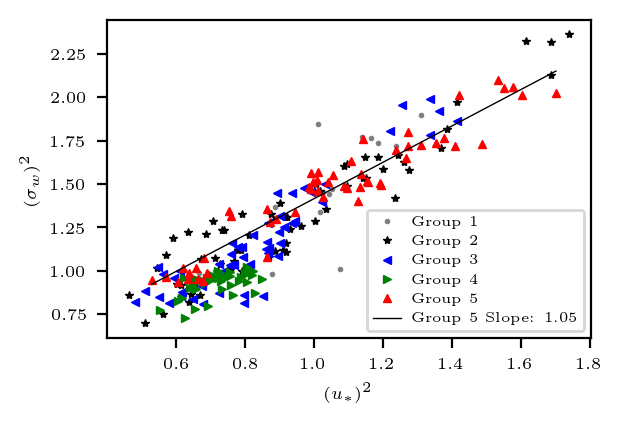

Slope (All Data): 1.24, R^2: 0.87, p-value: 8.93e-106
Slope (Group 1): 1.50, R^2: 0.71, p-value: 1.30e-05
Slope (Group 2): 1.17, R^2: 0.89, p-value: 1.16e-32
Slope (Group 3): 1.34, R^2: 0.85, p-value: 2.61e-23
Slope (Group 4): 0.55, R^2: 0.33, p-value: 6.05e-05
Slope (Group 5): 1.05, R^2: 0.91, p-value: 2.21e-29


In [171]:

# Assuming w_std_filt_sort, u_star_filt_sort, group1, group2, group3, group4, group5, and list_sel are defined

# Plot settings
font_size = 6
mark_size = 3
line_width = 0.5
subplot = [['1']]
fig, axes = plt.subplot_mosaic(subplot, constrained_layout=True)
trans = mtransforms.ScaledTranslation(-20 / 72, 7 / 72, fig.dpi_scale_trans)
fig.set_size_inches(3, 2)
fig.set_dpi(200)

# Function to calculate slope using linear regression on squared and sorted data
def calculate_slope(u_star, w_std):
    # Square the values
    u_star_squared = u_star**2
    w_std_squared = w_std**2
    
    # Sort u_star and reorder w_std accordingly
    sorted_indices = np.argsort(u_star_squared)
    u_star_sorted = u_star_squared[sorted_indices]
    w_std_sorted = w_std_squared[sorted_indices]
    
    # Perform linear regression
    slope, intercept, r_value, p_value, std_err = stats.linregress(u_star_sorted, w_std_sorted)
    return slope, intercept, r_value**2, p_value, u_star_sorted, w_std_sorted

# Flatten, square, and sort the arrays after applying the group masks and list selection
w_std_flat_group1 = w_std_filt_sort[group1, :][:, list_sel].flatten()
u_star_flat_group1 = u_star_filt_sort[group1, :][:, list_sel].flatten()

w_std_flat_group2 = w_std_filt_sort[group2, :][:, list_sel].flatten()
u_star_flat_group2 = u_star_filt_sort[group2, :][:, list_sel].flatten()

w_std_flat_group3 = w_std_filt_sort[group3, :][:, list_sel].flatten()
u_star_flat_group3 = u_star_filt_sort[group3, :][:, list_sel].flatten()

w_std_flat_group4 = w_std_filt_sort[group4, :][:, list_sel].flatten()
u_star_flat_group4 = u_star_filt_sort[group4, :][:, list_sel].flatten()

w_std_flat_group5 = w_std_filt_sort[group5, :][:, list_sel].flatten()
u_star_flat_group5 = u_star_filt_sort[group5, :][:, list_sel].flatten()

# Combine all data to calculate the slope for the entire dataset
w_std_all = np.concatenate([w_std_flat_group1, w_std_flat_group2, w_std_flat_group3, w_std_flat_group4, w_std_flat_group5])
u_star_all = np.concatenate([u_star_flat_group1, u_star_flat_group2, u_star_flat_group3, u_star_flat_group4, u_star_flat_group5])

# Calculate slopes for each group and all data (squared and sorted)
slope_all, intercept_all, r2_all, p_value_all, u_star_sorted_all, w_std_sorted_all = calculate_slope(u_star_all, w_std_all)
slope_group1, intercept_group1, r2_group1, p_value_group1, u_star_sorted_group1, w_std_sorted_group1 = calculate_slope(u_star_flat_group1, w_std_flat_group1)
slope_group2, intercept_group2, r2_group2, p_value_group2, u_star_sorted_group2, w_std_sorted_group2 = calculate_slope(u_star_flat_group2, w_std_flat_group2)
slope_group3, intercept_group3, r2_group3, p_value_group3, u_star_sorted_group3, w_std_sorted_group3 = calculate_slope(u_star_flat_group3, w_std_flat_group3)
slope_group4, intercept_group4, r2_group4, p_value_group4, u_star_sorted_group4, w_std_sorted_group4 = calculate_slope(u_star_flat_group4, w_std_flat_group4)
slope_group5, intercept_group5, r2_group5, p_value_group5, u_star_sorted_group5, w_std_sorted_group5 = calculate_slope(u_star_flat_group5, w_std_flat_group5)

# Plot Group 1 to Group 5 using the flattened, squared, and sorted arrays
axes['1'].plot(u_star_sorted_group1, w_std_sorted_group1, '.', color='grey', markersize=mark_size, markeredgewidth=line_width, label='Group 1')
axes['1'].plot(u_star_sorted_group2, w_std_sorted_group2, '*', color='black', markersize=mark_size, markeredgewidth=line_width, label='Group 2')
axes['1'].plot(u_star_sorted_group3, w_std_sorted_group3, '<', color='blue', markersize=mark_size, markeredgewidth=line_width, label='Group 3')
axes['1'].plot(u_star_sorted_group4, w_std_sorted_group4, '>', color='green', markersize=mark_size, markeredgewidth=line_width, label='Group 4')
axes['1'].plot(u_star_sorted_group5, w_std_sorted_group5, '^', color='red', markersize=mark_size, markeredgewidth=line_width, label='Group 5')

# Plot the regression line for Group 5
# Generate y-values using the slope and intercept from the linear regression
regression_line_group5 = slope_group5 * u_star_sorted_group5 + intercept_group5
axes['1'].plot(u_star_sorted_group5, regression_line_group5, '-', color='black', linewidth=line_width, label=f'Group 5 Slope: {slope_group5:.2f}')


# Set axis labels to represent the squared values
axes['1'].set_xlabel(r'$(u_*)^2$', fontsize=font_size)
axes['1'].set_ylabel(r'$(\sigma_w)^2$', fontsize=font_size)
axes['1'].tick_params(axis='both', labelsize=font_size)

# Add legend
legend = axes['1'].legend(loc='lower right', fontsize=font_size-1)

# Show the plot
plt.show()

# Print the calculated slopes and R^2 values for all data and each group
print(f"Slope (All Data): {slope_all:.2f}, R^2: {r2_all:.2f}, p-value: {p_value_all:.2e}")
print(f"Slope (Group 1): {slope_group1:.2f}, R^2: {r2_group1:.2f}, p-value: {p_value_group1:.2e}")
print(f"Slope (Group 2): {slope_group2:.2f}, R^2: {r2_group2:.2f}, p-value: {p_value_group2:.2e}")
print(f"Slope (Group 3): {slope_group3:.2f}, R^2: {r2_group3:.2f}, p-value: {p_value_group3:.2e}")
print(f"Slope (Group 4): {slope_group4:.2f}, R^2: {r2_group4:.2f}, p-value: {p_value_group4:.2e}")
print(f"Slope (Group 5): {slope_group5:.2f}, R^2: {r2_group5:.2f}, p-value: {p_value_group5:.2e}")

## Force linear regression to pass origin

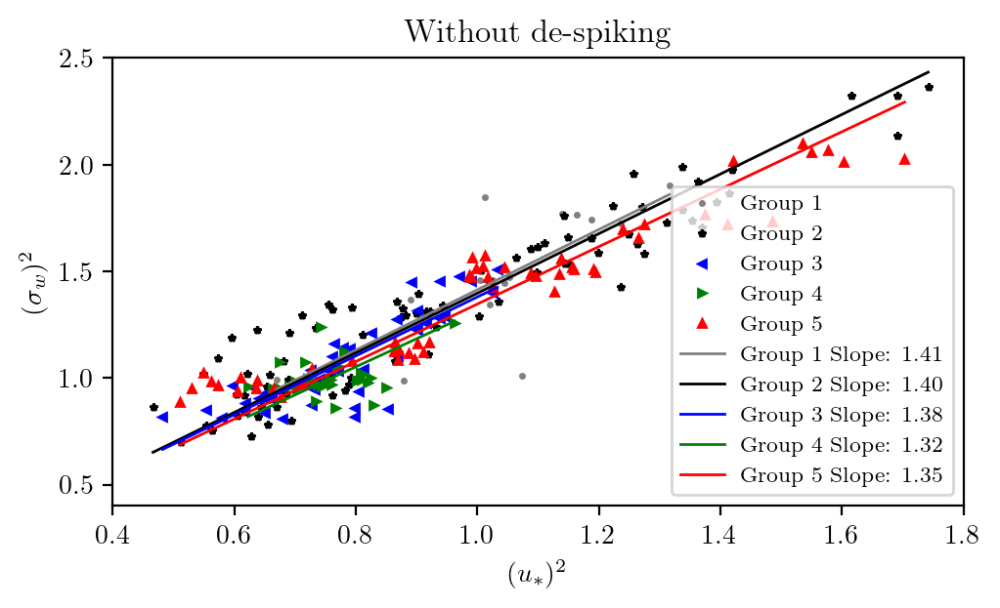

Slope (Group 1): 1.41
Slope (Group 2): 1.40
Slope (Group 3): 1.38
Slope (Group 4): 1.32
Slope (Group 5): 1.35


In [157]:
# Assuming w_std_filt_sort, u_star_filt_sort, group1, group2, group3, group4, group5, and list_sel are defined

# Plot settings
font_size = 10
mark_size = 3
line_width = 1
subplot = [['1']]
fig, axes = plt.subplot_mosaic(subplot, constrained_layout=True)
trans = mtransforms.ScaledTranslation(-20 / 72, 7 / 72, fig.dpi_scale_trans)
fig.set_size_inches(5, 3)  # Increased the size to fit all groups
fig.set_dpi(200)

# Function to calculate slope with intercept forced to 0
def calculate_slope_through_origin(u_star, w_std):
    # Square the values
    u_star_squared = u_star**2
    w_std_squared = w_std**2
    
    # Sort u_star and reorder w_std accordingly
    sorted_indices = np.argsort(u_star_squared)
    u_star_sorted = u_star_squared[sorted_indices]
    w_std_sorted = w_std_squared[sorted_indices]
    
    # Perform linear regression through the origin (force intercept = 0)
    slope = np.sum(u_star_sorted * w_std_sorted) / np.sum(u_star_sorted ** 2)  # Least squares fit through (0,0)
    
    return slope, u_star_sorted, w_std_sorted

# Flatten and sort the arrays for each group after applying the group masks and list selection
w_std_flat_group1 = w_std_filt_sort[group1, :][:, list_sel].flatten()
u_star_flat_group1 = u_star_filt_sort[group1, :][:, list_sel].flatten()

w_std_flat_group2 = w_std_filt_sort[group2, :][:, list_sel].flatten()
u_star_flat_group2 = u_star_filt_sort[group2, :][:, list_sel].flatten()

w_std_flat_group3 = w_std_filt_sort[group3, :][:, list_sel].flatten()
u_star_flat_group3 = u_star_filt_sort[group3, :][:, list_sel].flatten()

w_std_flat_group4 = w_std_filt_sort[group4, :][:, list_sel].flatten()
u_star_flat_group4 = u_star_filt_sort[group4, :][:, list_sel].flatten()

w_std_flat_group5 = w_std_filt_sort[group5, :][:, list_sel].flatten()
u_star_flat_group5 = u_star_filt_sort[group5, :][:, list_sel].flatten()

# Calculate slopes for each group with intercept forced to (0, 0)
slope_group1, u_star_sorted_group1, w_std_sorted_group1 = calculate_slope_through_origin(u_star_flat_group1, w_std_flat_group1)
slope_group2, u_star_sorted_group2, w_std_sorted_group2 = calculate_slope_through_origin(u_star_flat_group2, w_std_flat_group2)
slope_group3, u_star_sorted_group3, w_std_sorted_group3 = calculate_slope_through_origin(u_star_flat_group3, w_std_flat_group3)
slope_group4, u_star_sorted_group4, w_std_sorted_group4 = calculate_slope_through_origin(u_star_flat_group4, w_std_flat_group4)
slope_group5, u_star_sorted_group5, w_std_sorted_group5 = calculate_slope_through_origin(u_star_flat_group5, w_std_flat_group5)

# Plot each group's data and regression line (with intercept forced to (0,0))
axes['1'].plot(u_star_sorted_group1, w_std_sorted_group1, '.', color='grey', markersize=mark_size, markeredgewidth=line_width, label='Group 1')
axes['1'].plot(u_star_sorted_group2, w_std_sorted_group2, '*', color='black', markersize=mark_size, markeredgewidth=line_width, label='Group 2')
axes['1'].plot(u_star_sorted_group3, w_std_sorted_group3, '<', color='blue', markersize=mark_size, markeredgewidth=line_width, label='Group 3')
axes['1'].plot(u_star_sorted_group4, w_std_sorted_group4, '>', color='green', markersize=mark_size, markeredgewidth=line_width, label='Group 4')
axes['1'].plot(u_star_sorted_group5, w_std_sorted_group5, '^', color='red', markersize=mark_size, markeredgewidth=line_width, label='Group 5')

# Plot regression lines for each group (with intercept forced to 0)
axes['1'].plot(u_star_sorted_group1, slope_group1 * u_star_sorted_group1, '-', color='grey', linewidth=line_width, label=f'Group 1 Slope: {slope_group1:.2f}')
axes['1'].plot(u_star_sorted_group2, slope_group2 * u_star_sorted_group2, '-', color='black', linewidth=line_width, label=f'Group 2 Slope: {slope_group2:.2f}')
axes['1'].plot(u_star_sorted_group3, slope_group3 * u_star_sorted_group3, '-', color='blue', linewidth=line_width, label=f'Group 3 Slope: {slope_group3:.2f}')
axes['1'].plot(u_star_sorted_group4, slope_group4 * u_star_sorted_group4, '-', color='green', linewidth=line_width, label=f'Group 4 Slope: {slope_group4:.2f}')
axes['1'].plot(u_star_sorted_group5, slope_group5 * u_star_sorted_group5, '-', color='red', linewidth=line_width, label=f'Group 5 Slope: {slope_group5:.2f}')

# Set axis labels to represent the squared values
axes['1'].set_xlabel(r'$(u_*)^2$', fontsize=font_size)
axes['1'].set_ylabel(r'$(\sigma_w)^2$', fontsize=font_size)
axes['1'].tick_params(axis='both', labelsize=font_size)

axes['1'].set_xlim((0.4,1.8))
axes['1'].set_ylim((0.4,2.5))

# Add legend
legend = axes['1'].legend(fontsize=font_size-2)
plt.title('Without de-spiking', fontsize = font_size+2)
# Show the plot
plt.show()

# Print the calculated slopes for all groups (with intercept forced to 0)
print(f"Slope (Group 1): {slope_group1:.2f}")
print(f"Slope (Group 2): {slope_group2:.2f}")
print(f"Slope (Group 3): {slope_group3:.2f}")
print(f"Slope (Group 4): {slope_group4:.2f}")
print(f"Slope (Group 5): {slope_group5:.2f}")

In [161]:
w_std_filt_sort[group1, :][:, list_sel].flatten()

array([1.31135636, 1.31801086, 1.32787221, 1.33043086, 1.35878095,
       1.37799432, 0.99843101, 1.00408796, 0.99239938, 0.98440853,
       0.99514379, 1.00109471, 1.21366023, 1.2077808 , 1.20695977,
       1.20068003, 1.16865583, 1.15646632])

In [162]:
group1

[10, 26, 27]